README:  
Introcuction: This script is for figure 2 in fullscope analysis(spatial DTU analysis)  
Author: Y0NEKO  
Time: 2024.03.28  

In [ ]:
#load package
.libPaths(c("/cluster/home/liuhengxin/software/miniconda3_2/envs/r-kernel/lib/R/library",
           "/cluster/home/liuhengxin/software/miniconda3/envs/r4.1.2/lib/R/library",
           "/cluster/home/liuhengxin/software/miniconda3_2/envs/Rsplot/lib/R/library"))
library(data.table)
library(qs)
library(GenomicRanges)
library(GenomicFeatures)
library(rtracklayer)
library(dplyr)
library(ggbio)
library(reshape2)
library(ggsci)
library(viridis)
library(ggpubr)
library(ggh4x)
library(ggtranscript)
library(khroma)
library(bambu)
library(ggdensity)
library(Seurat)
library(ggsignif) # Significance Brackets for 'ggplot2'
library(gghalves) # Compose Half-Half Plots Using Your Favourite Geoms
library(randomcoloR)
library(ComplexHeatmap)
library(ggvenn)

qs 0.25.5

Loading required package: stats4

Loading required package: BiocGenerics

Warning message:
“package ‘BiocGenerics’ was built under R version 4.3.2”

Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Loading required package: S4Vectors

Warning message:
“package ‘S4Vectors’ was built under R version 4.3.3”

Attaching package: ‘S4Vectors’


The following objects are masked from ‘pac

In [ ]:
library(Seurat)

In [ ]:
#load data
setwd("/cluster/home/liuhengxin/P1_brain_nanopore/downstream_analysis/")
MySplit = function(str,sep, n){
  return(unlist(lapply(strsplit(str,sep),"[[",n)))
}
cellan = read.csv("../ref/cell_type_type20230220-macaque1-contour2_v1.csv")
cellan = unique(cellan[,c("subclass","class")])
areaan = read.csv("../ref/area_annotation.csv")
gtf = rtracklayer::import("ref/bambu_extended_annotations_novelname.gtf")
areaan = unique(areaan[c("L0","L3")])
colnames(areaan) = c("lobe","area")
areaan[areaan$area == "1/2",]$area = "1|2"

In [4]:
#transtls = qread("data/reads_full_anotation/read_trans_stat_list_dedup_fsrawdp_24_08_22.qs")
#fsrawdp = qread("data/reads_full_anotation/main_data_read_total_annotation_dedup_24_09_04.qs")
#srtt = qread("data/meta_cell_ngs/umap_srt_combined_24_04")
#fsrawdp = fsrawdp[fsrawdp$layer %in% paste0("l",1:6),]
# fsraw = qread("data/reads_full_anotation/main_data_read_total_annotation_24_08_22.qs")
# head(fsraw)

lobeorder = c('cingulate','somatosensory','parietal','auditory','temporal','occipital')

In [5]:
#fsraw.cor = fsraw %>% group_by(readid) %>% filter(length(unique(transcript_id)) == 1)
#qsave(fsraw.cor,"data/reads_full_anotation/main_data_read_total_annotation_delete_multiread_24_08_22.qs")
isosigls = qread(file = "data/dtu_analysis/dtu_isoform_ls_fsraw_cor_24_09_04.qs")
#isosigls$layer$areatr = paste0("layer",substr(isosigls$layer$areatr,2,2))

In [6]:
fsraw.cor = qread("data/reads_full_anotation/main_data_read_total_annotation_delete_multiread_24_09_04.qs")
#fsraw.cor = fsraw.cor[fsraw.cor$layer %in% paste0("l",1:6),]

In [108]:
#longbed = import("ref/long_read_mapping_total_rawnano_pac2_24_03_29.bed", format = "BED")
#qsave(longbed,"ref/long_read_mapping_total_rawnano_pac2_24_03_29.qs")
#length(longbed)
#longbed = longbed[longbed$name %in% fsraw$readid,]
#length(longbed)
#qsave(longbed,"ref/long_read_mapping_total_rawnano_pac2_fil_24_03_29.qs")
longbed = qread("ref/long_read_mapping_total_rawnano_total_fil_24_04_20.qs")

In [7]:
mkls = qread("result/figure2/gene_marker_list_24_12_05.qs")

In [5]:
spdatals = list()

In [5]:
theme_presentation<- function(base_size = 16, base_family = "") {
  # Starts with theme_grey and then modify some parts
  theme_bw(base_size = base_size, base_family = base_family) %+replace%
    theme(
      strip.background = element_blank(),
      strip.text.x = element_text(size=16,colour="white"),
      strip.text.y = element_text(size=16,colour="white"),
      axis.text.x = element_blank(),
      axis.text.y = element_blank(),
      axis.ticks =  element_blank(), 
      axis.title.x= element_blank(),
      axis.title.y= element_blank(),
      panel.background = element_rect(fill="black"), 
      panel.border =element_blank(),  
      panel.grid.major = element_blank(), 
      panel.grid.minor = element_blank(), 
      panel.margin = unit(1.0, "lines"), 
      plot.background = element_rect(fill="black"), 
      plot.title =element_text(size=16,colour="white"), 
      # plot.margin = unit(c(1,  1, 1, 1), "lines"),
      legend.background=element_rect(fill='black'),
      legend.title=element_text(size=12,colour="white"),
      legend.text=element_text(size=12,colour="white"),
      legend.key = element_rect( fill = 'black'),
      # legend.key.size = unit(c(0, 0), "lines"),
      axis.line.x = element_blank(),
      axis.line.y = element_blank()
    )
}


### Case Plot function

In [142]:
#case plot
BuildPlotBed = function(npclf,nanobed,groupname,geneex,sigtr = NULL){
    readgroup = npclf[npclf$gene_id == geneex,]
    # readgroup = readgroup[readgroup$arealayer %in% paste0("l",1:6),]
    readgroup = unique(readgroup[c("readid","transcript_id","gene_id",
                                   groupname)])
    # readgroup = readgroup %>% group_by(readid) %>% 
    #   mutate(transgroup = 
    #            paste(unique(transcript_id)[order(unique(transcript_id))],
    #                              collapse = "|"))
    readgrt = nanobed[nanobed$name %in% readgroup$readid,]
    readgrt$group = readgroup[match(readgrt$name,
                                    readgroup$readid),
                              groupname]
    # readgrt$transcript_id = readgroup[match(readgrt$name,readgroup$readid),
    #                                   "transcript_id"]
    # readgrt$transgroup = readgroup[match(readgrt$name,readgroup$readid),
    #                                   "transgroup"]
    
    grtdfl = as.data.frame(readgrt)
    colnames(grtdfl)[ncol(grtdfl)] = "group"
    colnames(grtdfl)[6] = "readid"
    grtdfl = merge(grtdfl,readgroup[c("readid",
                              "transcript_id")],
          by = "readid")
    grtdfl = grtdfl[order(grtdfl$transcript_id,
                          grtdfl$start,grtdfl$end),]
    grtdfl = grtdfl[!is.na(grtdfl$group) &
                      grtdfl$group != "",]
    grtdfl
    grtdfl$readord = paste0(grtdfl$transcript_id,"-",grtdfl$readid)
    grtdfl = grtdfl %>% group_by(group) %>% 
      mutate(orid = as.numeric(factor(readord,
                                      levels = unique(readord)))) %>%
      mutate(oridnorm = orid/max(orid))
    grtdfl$sig = "black"
    grtdfl[grtdfl$group %in% sigtr, "sig"] = "red"
    return(grtdfl)
}

IsoformReadPlot = function(gtfp, grtdfl, geneex, onlyhub = T,mycolor = NULL){
    library(randomcoloR)
    library(ggbio)
    library(ggtranscript)
    tartrans = gtfp[which(gtfp$gene_id == geneex),]
    tartrans = as.data.frame(tartrans)
    tartrans = tartrans[tartrans$type == "exon",]
    tartrans = tartrans[order(tartrans$transcript_id),]
    tartrans$orid = as.numeric(factor(tartrans$transcript_id,levels = unique(tartrans$transcript_id)))
    tartrans$group = NA
    if(onlyhub){
      grtdfl = grtdfl %>% group_by(readid) %>% filter(length(unique(transcript_id)) == 1)
      grtdfl$readord = paste0(grtdfl$transcript_id,"-",grtdfl$readid)
      grtdfl = grtdfl %>% group_by(group) %>% 
        mutate(orid = as.numeric(factor(readord,
                                        levels = unique(readord)))) %>%
        mutate(oridnorm = orid/max(orid))
      tartrans = tartrans[tartrans$transcript_id %in% grtdfl$transcript_id,]
    }
    # tartrans = merge(tartrans,unique(grtdfl[c("transcript_id",
    #                                           "transgroup")]),
    #                  by = "transcript_id")
    tartranstx = tartrans %>% group_by(transcript_id,orid) %>% 
      summarise(start = min(start),end = max(end))
    tartranstx$group = NA
    mylim = c(min(tartranstx$start)-1000,max(tartranstx$end)+1000)
    library(ggh4x)
    
    #facetcol = list()
    #facetcoldf = unique(grtdfl[c("group","sig")])
    #facetcoldf = facetcoldf[order(facetcoldf$group,decreasing = F),]
    #for (i in 1:nrow(facetcoldf)) {
    #  facetcol[[i]] = element_text(color = facetcoldf[i,]$sig)
    #}
    #facetcol[[nrow(facetcoldf)+1]] = element_text(color = "black")
    grtdflin = to_intron(grtdfl,
                     "readord")
    no_of_colors = length(unique(grtdfl$transcript_id)) 
    colorful_palette = distinctColorPalette(no_of_colors) 
    names(colorful_palette) = unique(grtdfl$transcript_id)
    if(!is.null(mycolor)){
        colorful_palette = mycolor
    }

    
    pc = ggplot(grtdfl,aes(x = start,xend = end,
                      y = orid,
                      yend = orid,
                      fill = transcript_id,color = transcript_id)) +
      geom_segment(size = 0.5) +
      geom_segment(data = grtdflin,
                   aes(x = start,xend = end,
                       y = orid,
                       yend = orid),
                   size = 0.03,alpha = 0.5,color = "grey") +
      geom_range(data = tartrans,
                 aes(xstart = start,xend = end,
                     y = orid,
                     fill = transcript_id,color = transcript_id),
                 size = 0.2) +
      geom_intron(data = to_intron(tartrans,
                                   "transcript_id"),
                  aes(xstart = start,xend = end,strand = strand),
                  size = 0.2,
                  arrow.min.intron.length = 200,
                  arrow = arrow(length=unit(0.3,"cm"))) +
      geom_text(data = tartranstx,
                aes(x = (start + end) / 2,y = orid,
                    label = transcript_id),
                size = 3, vjust = -0.1, color = "black") +
     # facet_grid2(group~.,scales = "free",
     #             strip = strip_themed(
     #               text_y = facetcol
    #            )) +
      facet_wrap(group~.,scales = "free",ncol = 1,strip.position = "top") +
      scale_x_continuous(limits = mylim)+
      scale_color_manual(values = colorful_palette) +
      scale_fill_manual(values = colorful_palette) +
      # scale_fill_discreterainbow() +
      # scale_color_discreterainbow() +
      theme_void() + 
      ggtitle(geneex) +
      theme(legend.position = "none",
            panel.spacing = unit(0,'lines'),
            strip.background = element_rect(fill = NA,color = NA),
           strip.placement = "outside",
           plot.title = element_text(hjust = 0.5))
    pc
    
    return(pc)
}
#fsraw.cor = fsraw[fsraw$layer %in% paste0("l",1:6),]
#
IsoformReadPlotTotal = function(fsraw,isosigi,longbed,gtf,geneex,hubtrans = NULL,onlyhub = F,mycolors =NULL){
    transname = unique(isosigi[isosigi$gene_id %in% geneex,]$transcript_id)
    if(!is.null(hubtrans)){
        transname = hubtrans
    }
    if(is.null(mycolors)){
        mycolors = distinctColorPalette(length(transname))
        names(mycolors) = transname
    }
    grtdfl = BuildPlotBed(fsraw,longbed,'areatr',geneex,NULL)
    grtdfl = grtdfl[grtdfl$transcript_id %in% transname,]
    
    pci1 = IsoformReadPlot(gtf, grtdfl, geneex,onlyhub,mycolors)
    pci1
    return(pci1)
}

CaseCountPlotBox = function(fsraw,geneex,transname,mycolors = NULL){
    npcase1 = fsraw[fsraw$gene_id == geneex,]
    npcase1 = npcase1[npcase1$transcript_id %in% transname,]
    if(is.null(mycolors)){
        mycolors = distinctColorPalette(length(unique(npcase1$transcript_id)))
    }
    npcase1 = npcase1 %>% 
        group_by(areatr,chunk) %>%
        mutate(genecount = length(unique(readid))) %>% 
        filter(genecount > 10) %>%
        group_by(areatr,chunk,transcript_id) %>%
        summarise(count = length(unique(readid)),genecount = genecount[1])
    npcase1 = npcase1[npcase1$areatr != "",]
    
    npcase1$rate = npcase1$count/npcase1$genecount

    npcase1$transid = as.numeric(as.factor(npcase1$transcript_id))
    npcase1$cmpgroup = paste0(substr(npcase1$transid,1,1),
                            "-",npcase1$areatr)
    comparisons = list()
    classid = as.character(unique(npcase1$areatr))
    n = 1
    for(i in 1:length(classid)){
        for(j in (i+1):length(classid)){
            comparisons[[n]] = c(classid[i],classid[j])
            n = n + 1
        }
    }
    
    npcase1m = npcase1 %>% group_by(areatr,transcript_id) %>% summarise(mean = mean(rate))
    
    pci2 = ggplot(npcase1,
                  aes(x = areatr, y = rate, color = transcript_id)) +
      geom_boxplot() +
      geom_point(data = npcase1m,aes(x = areatr, y = mean,
                                    color = transcript_id),
                 position = position_dodge(0.75)) +
      # geom_line(data = npcase1m,aes(x = areatr, y = mean,
      #                              group = transcript_id),
      #           position = position_dodge(0.75)) +
      stat_compare_means(label = "p.signif",hide.ns = T,method = "t.test",vjust = 0.7,ref.group = ".all.") + 
      scale_color_manual(values = mycolors) +
      theme_pubr() + 
    theme(axis.text.x = element_text(angle = 45,vjust = 0.5)) +
    xlab("") + ylab("Isoform read ratio")
    return(pci2)
}

CasePlotTotalClass = function(fsraw,isosigi,gtf,geneex,hubtrans = NULL,markdfb,edgesdf){
    transname = unique(isosigi[isosigi$gene_id %in% geneex,]$transcript_id)
    if(!is.null(hubtrans)){
        transname = hubtrans
    }
    mycolors = distinctColorPalette(length(transname))
    print(mycolors)
    names(mycolors) = transname
    grtdfl = BuildPlotBed(fsraw,longbed,'areatr',geneex,NULL)
    print(head(grtdfl))
    grtdfl = grtdfl[grtdfl$transcript_id %in% transname,]
    
    pci1 = IsoformReadPlot(gtf, grtdfl, geneex,onlyhub = F,mycolors)
    pci1
#ggexport(p0c1,filename = "processed/figures/f3/bambu_cell_case_NNvsNeuron_CDC42.pdf",
#           width = 6,height = 5)

    npcase1 = fsraw[fsraw$gene_id == geneex,]
    npcase1 = npcase1 %>% 
        group_by(areatr,chunk) %>%
        mutate(genecount = length(unique(readid))) %>% 
        filter(genecount > 10) %>%
        group_by(areatr,chunk,transcript_id) %>%
        summarise(count = length(unique(readid)),genecount = genecount[1])
    npcase1 = npcase1[npcase1$areatr != "",]
    npcase1 = npcase1[npcase1$transcript_id %in% transname,]
    npcase1$rate = npcase1$count/npcase1$genecount

    npcase1$transid = as.numeric(as.factor(npcase1$transcript_id))
    npcase1$cmpgroup = paste0(substr(npcase1$transid,1,1),
                            "-",npcase1$areatr)
    comparisons = list()
    classid = as.character(unique(npcase1$areatr))
    n = 1
    for(i in 1:length(classid)){
        for(j in (i+1):length(classid)){
            comparisons[[n]] = c(classid[i],classid[j])
            n = n + 1
        }
    }


    
    npcase1m = npcase1 %>% group_by(areatr,transcript_id) %>% summarise(mean = mean(rate))
    
#library(ggstatsplot)

    pci2 = ggplot(npcase1,
                  aes(x = areatr, y = rate, color = transcript_id)) +
      geom_boxplot() +
      geom_point(data = npcase1m,aes(x = areatr, y = mean,
                                    color = transcript_id),
                 position = position_dodge(0.75)) +
      geom_line(data = npcase1m,aes(x = areatr, y = mean,
                                   group = transcript_id),
                position = position_dodge(0.75)) +
      stat_compare_means(label = "p.signif",hide.ns = T,method = "t.test",vjust = 0.7,ref.group = ".all.") + 
      scale_color_manual(values = mycolors) +
      theme_pubr() + xlab("") + ylab("Isoform read ratio")
    
#     pci2 = ggbarplot(npcase1,
#                     x = "areatr", y = "rate", 
#                     fill = "areatr",size = 0.5,
#                     width = 0.7,facet.by = "transcript_id",
#                     add = c("mean_se")) +
#         geom_jitter(data = npcase1,
#                 aes(x = areatr, y = rate),size = 0.3,
#                     width = 0.25) +
#         scale_fill_flatui() +
# #        scale_fill_manual(values = mycolors) +
#         stat_compare_means(label = "p.signif",hide.ns = T,method = "t.test",vjust = 0.7,
#                            ref.group = ".all.") + 
#         xlab("") + ylab("Isoform ratio") + labs(fill = "") +
#         theme_pubr() + 
#     theme(axis.text.x = element_blank(),
#          axis.ticks.x = element_blank(),
#           legend.position = "bottom")
#     pci2
    pci3 = MarkerSpPlot(fsraw.cor,markdfb,geneex,hubtrans,edgesdf,200)
    #pci3 = MarkerSpPlot(fsrawdp.cell,fsrawdp.cellb,geneex,mycolors,hubtrans)
    
    pci = ggarrange(ggarrange(pci1,pci2,widths = c(1.5,2),ncol = 1),pci3,nrow = 1)
    return(pci)
}


In [143]:
#case plot function
MarkerSpPlot = function(fsrawdp,markdfb,geneex,transid,edgesdf,ra){
    #ra = 200   
    markdf = fsrawdp[fsrawdp$gene_id == geneex,]
    markdf$xid = as.integer(markdf$x/(ra*2)) * ra * 2 + ra
    markdf$yid = as.integer(markdf$y/(ra*2)) * ra * 2 + ra
    markdf$blockid = paste0(markdf$xid,"_", markdf$yid)
    
    markdf = markdf %>% group_by(xid,yid,blockid) %>% 
      mutate(genecount = length(unique(readid))) %>%
      group_by(xid,yid,blockid,transcript_id) %>% 
      summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)


    pmkptls = list()
    for(i in 1:length(transid)){
        transi = transid[i]
        markdfi = markdf[markdf$transcript_id == transi,]
        markdfb = markdfb[!markdfb$blockid %in% markdfi$blockid,]
        markdfb$transcript_id = transi
        markdfb$rate = 0
        edgesdf$transcript_id = unique(markdfi$transcript_id)
        cml = intersect(colnames(markdfb),colnames(markdfi))
        markdfi = rbind(markdfb[,cml],markdfi[,cml])
        pmkpti = ggplot() +
          geom_tile(data = markdfi,
                 aes(xid,yid,fill = rate)) + 
        geom_segment(data = edgesdf, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 0.1,
                   color = "grey") + theme_void() +
      #scale_size(range = c(0.05,0.1)) +
      #facet_wrap(~transcript_id,nrow = 2) +
          theme_void() + 
          ggtitle(transi) +
      #scale_color_manual(values = mycolor) +
      #scale_fill_gradient(low = "blue", high = "red")+
          scale_fill_viridis() +
          theme_presentation() + 
          theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 10)) +
          guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
          scale_y_reverse() + scale_x_reverse()
        pmkptls[[i]] = pmkpti
    }
    pmkpt = ggarrange(plotlist = pmkptls,nrow = 1,common.legend = T)
    return(pmkpt)

}

In [144]:
#spatial point plot
MarkerSpPlotBin1 = function(fsraw,backpt,geneex,mycolor = NULL,hubtrans = NULL,ptsize = 0.5){
    markdfb = backpt
    markdf = fsraw[fsraw$gene_id == geneex,]
    if(!is.null(hubtrans)){
        markdf = markdf[markdf$transcript_id %in% hubtrans,]
    }else{
        transt = markdf
        transt$genecount = length(unique(transt$readid))
        transt = transt %>% group_by(transcript_id) %>% 
          summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)
        transtf = transt[transt$rate > 0.05,]
        markdf = markdf[markdf$transcript_id %in% transtf$transcript_id,]
    }

    
    markdf = markdf %>% group_by(x,y) %>% 
      mutate(genecount = length(unique(readid))) %>%
      group_by(x,y,transcript_id) %>% 
      summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)
    markdf = markdf %>% group_by(x,y) %>% filter(rate == max(rate))


    if(is.null(mycolor)){
        mycolor = distinctColorPalette(length(unique(markdf$transcript_id)))
    }
    if(length(mycolor) == 1) mycolor = "#C894B6"
   
    
    pmkpti = ggplot() +
      scattermore::geom_scattermore(
        data = markdfb,
        aes(x,y),
        color = "white",
        # pixels = raster.dpi,
        pointsize = 0.1
      ) +
      geom_point(data = markdf,
                 aes(x,y,color = transcript_id),
                 size = ptsize) + 
      # facet_wrap(~gene_id,nrow = 2) +
      theme_void() + 
      scale_color_manual(values = mycolor) +
      theme_presentation() + 
      theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 10)) +
      guides(color = guide_legend(override.aes = list(size=8),
                                  nrow = 2),
            size = "none") +
      scale_y_reverse() + scale_x_reverse()
    pmkpti
    return(pmkpti)
}

MarkerSpPlotCell = function(npclfdp.cell,npclfdp.cellb,geneex,mycolor = NULL,hubtrans = NULL){
    markdf = npclfdp.cell[npclfdp.cell$gene_id %in% geneex,]
    if(!is.null(hubtrans)){
        markdf = markdf[markdf$transcript_id %in% hubtrans,]
    }
    markdfb = npclfdp.cellb[!npclfdp.cellb$cell_id %in% markdf$cell_id,]
    markdf = markdf %>% group_by(cell_id,gene_id) %>% mutate(readrate = readnum/sum(readnum))
    markdf = markdf[markdf$readrate > 0.5,]
    markdfst = markdf %>% group_by(transcript_id) %>% summarise(cellnum = length(cell_id))
    markdfst$cellpop = markdfst$cellnum/sum(markdfst$cellnum)
    markdfst = markdfst[markdfst$cellpop > 0.01,]
    markdf = markdf[markdf$transcript_id %in% markdfst$transcript_id,]

    if(is.null(mycolor)){
        mycolor = distinctColorPalette(length(unique(markdf$transcript_id)))
    }
    
    pmkpti = ggplot() +
      scattermore::geom_scattermore(
        data = markdfb,
        aes(x,y),
        color = "white",
        # pixels = raster.dpi,
        pointsize = 0.05
      ) +
      geom_point(data = markdf,
                 aes(x,y,color = transcript_id,size = readnum)) + 
      scale_size(range = c(0.05,0.1)) +
      # facet_wrap(~gene_id,nrow = 2) +
      theme_void() + 
      scale_color_manual(values = mycolor) +
      theme_presentation() + 
      theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 6)) +
      guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
      scale_y_reverse() + scale_x_reverse()
    pmkpti
    return(pmkpti)
}
  # selectedhub  = c("APOE","CALB1","NEFM","SCN1B","SMYD2","PLP1")
MarkerSpPlotDensity = function(fsrawdp,markdfb,geneex,transid,edgesdf,ra){
    #ra = 200   
    markdf = fsrawdp[fsrawdp$gene_id == geneex,]
    markdf$xid = as.integer(markdf$x/(ra*2)) * ra * 2 + ra
    markdf$yid = as.integer(markdf$y/(ra*2)) * ra * 2 + ra
    markdf$blockid = paste0(markdf$xid,"_", markdf$yid)
    
    markdf = markdf %>% 
      group_by(xid,yid,blockid,transcript_id) %>% 
      summarise(count = length(unique(readid)))

    pmkptls = list()
    for(i in 1:length(transid)){
        transi = transid[i]
        markdfi = markdf[markdf$transcript_id == transi,]
        markdfb = markdfb[!markdfb$blockid %in% markdfi$blockid,]
        markdfb$transcript_id = transi
        markdfb$count = 0
        edgesdf$transcript_id = unique(markdfi$transcript_id)
        cml = intersect(colnames(markdfb),colnames(markdfi))
        markdfi = rbind(markdfb[,cml],markdfi[,cml])
        pmkpti = ggplot() +
          geom_tile(data = markdfi,
                 aes(xid,yid,fill = log(count+1))) + 
        geom_segment(data = edgesdf, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 0.1,
                   color = "grey") + theme_void() +
      #scale_size(range = c(0.05,0.1)) +
      #facet_wrap(~transcript_id,nrow = 2) +
          theme_void() + 
          ggtitle(transi) +
      #scale_color_manual(values = mycolor) +
      #scale_fill_gradient(low = "blue", high = "red")+
          scale_fill_viridis() +
          theme_presentation() + 
          theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 10)) +
          guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
          scale_y_reverse() + scale_x_reverse()
        pmkptls[[i]] = pmkpti
    }
    pmkpt = ggarrange(plotlist = pmkptls,nrow = 1,common.legend = T)
    return(pmkpt)

}

In [148]:
backpt = qread("longread_cell_isoform_without_subcortical_24_04_29.qs")

### Calculate spatial marker gene

In [7]:
ngscount = fread("/cluster/home/xiliyuan/T44_info/total_gene_T44_macaque_f001_2D_macaque1-20230306.txt")
head(ngscount)
regionan = read.csv("/cluster/home/liuhengxin/P1_brain_nanopore/ref/regions-macaque1-20230306.csv")
regionan = regionan[,c("global_region_id","origin_name")]

gene,x,y,umi_count,cell_label,gene_area,rx,ry
<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
SPARCL1,10204,26115,2,0,0,56131,12632
DNAH7,10204,26115,1,0,0,56131,12632
ANAPC15,10204,26115,1,0,0,56131,12632
MOB4,10205,26115,1,0,0,56130,12632
OPCML,10205,26115,1,0,0,56130,12632
NGEF,10206,26116,2,0,0,56129,12633


In [8]:
ra = 200
ngscount$xid = as.integer(ngscount$x/(ra*2)) * ra * 2 + ra
ngscount$yid = as.integer(ngscount$y/(ra*2)) * ra * 2 + ra
ngscount$blockid = paste0(ngscount$xid,"_",ngscount$yid)
#ngscount.st = ngscount %>% group_by(blockid) %>% summarise(count = sum(umi_count))

In [13]:
ngscount = ngscount[ngscount$gene_area != 0, ] %>% group_by(gene_area,gene,blockid) %>% summarise(genecount = sum(umi_count))
ngscount = merge(ngscount,regionan,by.x = "gene_area",by.y = "global_region_id")

ngscount$layer = MySplit(ngscount$origin_name,'-',3)
ngscount$region = MySplit(ngscount$origin_name,'-',2)

,gene_area,gene,blockid,genecount,origin_name
,<int>,<chr>,<chr>,<int>,<chr>
1,102,A2M,10200_26200,3,L-1|2-l1
2,102,A2M,10200_26600,7,L-1|2-l1
3,102,A2M,10200_41000,9,L-1|2-l1
4,102,A2M,10600_26200,1,L-1|2-l1
5,102,A2M,10600_26600,1,L-1|2-l1
6,102,A2M,10600_41000,5,L-1|2-l1


In [15]:
groupan = data.frame("abv" = c("cb","cortex","HC","mb","p","str","v"),
                       "ano" = c("Cerebellum","Cortex","Hippocampus","Midbrain",
                                 "Pons","Striatum","Ventricle"))
ngscount$subcortical = ngscount$layer
ngscount[ngscount$subcortical %in% paste0("l",1:6),]$subcortical = "cortex"
ngscount = ngscount[ngscount$subcortical != "c",]
ngscount$subcortical = groupan[match(ngscount$subcortical,groupan$abv),]$ano
head(ngscount)
qsave(ngscount,file = "data/spatial_genecount_ngs_bin200_fs_total_25_04_14.qs")

,gene_area,gene,blockid,genecount,origin_name,layer,region,subcortical
,<int>,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>
1,102,A2M,10200_26200,3,L-1|2-l1,l1,1|2,Cortex
2,102,A2M,10200_26600,7,L-1|2-l1,l1,1|2,Cortex
3,102,A2M,10200_41000,9,L-1|2-l1,l1,1|2,Cortex
4,102,A2M,10600_26200,1,L-1|2-l1,l1,1|2,Cortex
5,102,A2M,10600_26600,1,L-1|2-l1,l1,1|2,Cortex
6,102,A2M,10600_41000,5,L-1|2-l1,l1,1|2,Cortex


In [17]:
nrow(ngscount)
ngscount = merge(ngscount,areaan,by.x = "region",by.y = "area",all = TRUE)
nrow(ngscount)
qsave(ngscount,file = "data/spatial_genecount_ngs_bin200_fs_25_01_03.qs")

[1] 128343848

[1] 128343961

In [22]:
fsraw.cor$xid = as.integer(fsraw.cor$x/(ra*2)) * ra * 2 + ra
fsraw.cor$yid = as.integer(fsraw.cor$y/(ra*2)) * ra * 2 + ra
fsraw.cor$blockid = paste0(fsraw.cor$xid,"_",fsraw.cor$yid)
fscount = fsraw.cor %>% group_by(layer,lobe,region,blockid,subcortical,gene_id) %>% summarise(genecount = length(unique(readid))) 
ngscount = ngscount[,c("gene","layer","region","lobe","subcortical","blockid","genecount")]
colnames(ngscount)[1] = "gene_id"
gcount = rbind(fscount,ngscount)
head(gcount)
qsave(gcount,file = "data/spatial_genecount_ngs_combine_bin200_fs_25_04_14.qs")

`summarise()` has grouped output by 'layer', 'lobe', 'region', 'blockid',
'subcortical'. You can override using the `.groups` argument.


layer,lobe,region,blockid,subcortical,gene_id,genecount
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
HC,NA,CA1,26600_82600,Hippocampus,AARSD1,1
HC,NA,CA1,26600_82600,Hippocampus,ACAA1,1
HC,NA,CA1,26600_82600,Hippocampus,ACHE,1
HC,NA,CA1,26600_82600,Hippocampus,ACP1,1
HC,NA,CA1,26600_82600,Hippocampus,ACP6,1
HC,NA,CA1,26600_82600,Hippocampus,ACTB,2


In [23]:
gcount$metacell = paste0(gcount$layer,"-",gcount$region,"-",gcount$lobe,"-",gcount$subcortical,"-",gcount$blockid)
head(gcount)

layer,lobe,region,blockid,subcortical,gene_id,genecount,metacell
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>
HC,NA,CA1,26600_82600,Hippocampus,AARSD1,1,HC-CA1-NA-Hippocampus-26600_82600
HC,NA,CA1,26600_82600,Hippocampus,ACAA1,1,HC-CA1-NA-Hippocampus-26600_82600
HC,NA,CA1,26600_82600,Hippocampus,ACHE,1,HC-CA1-NA-Hippocampus-26600_82600
HC,NA,CA1,26600_82600,Hippocampus,ACP1,1,HC-CA1-NA-Hippocampus-26600_82600
HC,NA,CA1,26600_82600,Hippocampus,ACP6,1,HC-CA1-NA-Hippocampus-26600_82600
HC,NA,CA1,26600_82600,Hippocampus,ACTB,2,HC-CA1-NA-Hippocampus-26600_82600


In [26]:
#gcount$metacell = paste0(gcount$layer,"-",gcount$region,"-",gcount$lobe,"-",gcount$blockid)
gcount = gcount %>% group_by(layer,lobe,region,subcortical,gene_id,blockid,metacell)%>% summarise(genecount = sum(genecount)) 
qsave(gcount,file = "data/spatial_genecount_ngs_combine_fs_25_04_14.qs")

`summarise()` has grouped output by 'layer', 'lobe', 'region', 'subcortical',
'gene_id', 'blockid'. You can override using the `.groups` argument.


In [43]:
dim(gcountmx)
gcountmx = gcountmx[,colnames(gcountmx)!= "NA"]
dim(gcountmx)

[1] 26543 18685

[1] 26543 18684

In [44]:
# gcountf = gcount[substr(gcount$gene_id,1,5) != "Bambu",]
# gcountmx = dcast(gcountf,gene_id~metacell,
#                    value.var = "genecount",fun.aggregate = sum)
# dim(gcountmx)
# gcountmx = gcountmx[!is.na(gcountmx$gene_id),]
# dim(gcountmx)
#rownames(gcountmx) = gcountmx$gene_id;gcountmx = gcountmx[-1]
#length(unique(transt.sp[transt.sp$gene_id %in% genemk,]$transcript_id))
#gcountmx = gcountmx[,colnames(gcountmx)!= "NA"]

SrtBuild = function(gcountmx){
    srtt = CreateSeuratObject(gcountmx)
    srtt = NormalizeData(srtt)
    srtt = ScaleData(srtt)
    srtt <- FindVariableFeatures(srtt, selection.method = "vst",
                                 nfeatures = 2000)
    srtt <- RunPCA(srtt,
                   features = VariableFeatures(object = srtt))
    srtt <- FindNeighbors(srtt, dims = 1:20)
    srtt <- FindClusters(srtt, resolution = 0.5)
    srtt <- RunUMAP(srtt, dims = 1:10)
    return(srtt)
}
srt.sp = SrtBuild(gcountmx)



Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

PC_ 1 
Positive:  CCR9, SPATA8, LOC102141360, LOC107130656, OR5P2, LOC107130108, LOC102124856, OR12D3, SLC25A52, LOC107127908 
	   LOC102117884, CAPNS2, LOC107131089, FAM218A, LOC102129369, HOXD9, LOC107130322, LOC107127629, LOC107127396, LOC102121356 
	   LOC102143453, LOC107126726, GUCA2B, LOC102139821, LOC107128308, LOC102142738, LOC107130238, LOC107129298, LOC107126546, LOC102144343 
Negative:  GRID2, CBLN1, ZIC1, GABRA6, NBEA, ITM2B, FGF14, CBLN3, SYNE1, KCND2 
	   NRXN3, PRDX5, CHGB, ZIC4, TRPM3, DPP6, TIAM1, PCP2, GRM4, EN2 
	   MRLN, RBFOX1, NREP, WWOX, SNRPN, RPL3, PCP4, CDR1, GRIK2, NDUFB4 
PC_ 2 
Positive:  PRLR, FOLR1, KCNJ13, TGFBI, CCDC153, C13H2orf40, F5, GSTA5, FOXJ1, CP 
	   MSX1, KL, CAPSL, PIFO, SLC13A4

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 18684
Number of edges: 731077

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9117
Number of communities: 15
Elapsed time: 2 seconds


21:23:47 UMAP embedding parameters a = 0.9922 b = 1.112

21:23:47 Read 18684 rows and found 10 numeric columns

21:23:47 Using Annoy for neighbor search, n_neighbors = 30

21:23:47 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:23:50 Writing NN index file to temp file /tmp/Rtmp0ihbZZ/file688a5c7dc1ed

21:23:50 Searching Annoy index using 1 thread, search_k = 3000

21:23:57 Annoy recall = 99.29%

21:24:37 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

21:24:37 166 smooth knn distance failures

21:25:39 Initializing from normalized Laplacian + noise (using RSpectra)

21:25:40 Commencing optimization for 200 epochs, with 801244 positive edges

21:25:40 Using rng type: pcg

21:26:48 Optimization finished



In [45]:
ansubcor = MySplit(colnames(srt.sp),"-",4)
names(ansubcor) = colnames(srt.sp)
srt.sp$subcortical = ansubcor
Idents(srt.sp) = srt.sp$subcortical
qsave(srt.sp,file = "data/spatial_genecount_ngs_combine_fs_srt_25_04_14.qs")

ERROR: Error in substr(srt.sp, idents = "Cortex"): unused argument (idents = "Cortex")


In [47]:
srt.sp.sub = subset(srt.sp,idents = "Cortex")

In [48]:
anlayer = MySplit(colnames(srt.sp.sub),"-",1)
anarea = MySplit(colnames(srt.sp.sub),"-",2)
anlobe = MySplit(colnames(srt.sp.sub),"-",3)
ansubcor = MySplit(colnames(srt.sp.sub),"-",4)
names(anlayer) = names(anarea) = names(anlobe) = colnames(srt.sp.sub)
srt.sp.sub$layer = anlayer
srt.sp.sub$region = anarea
srt.sp.sub$lobe = anlobe
Idents(srt.sp.sub) = srt.sp.sub$layer

In [49]:
Idents(srt.sp) = srt.sp$subcortical
mk.subcor =  FindAllMarkers(srt.sp)

Idents(srt.sp.sub) = srt.sp.sub$layer
mk.layer =  FindAllMarkers(srt.sp.sub)
#region markers
Idents(srt.sp.sub) = srt.sp.sub$lobe
mk.lobe =  FindAllMarkers(srt.sp.sub)

Idents(srt.sp.sub) = srt.sp.sub$region
mk.region =  FindAllMarkers(srt.sp.sub)

mkls = list("layer" = mk.layer,"lobe" = mk.lobe,"region" = mk.region,"subcortical" = mk.subcor)
qsave(mkls,file = "result/figure2/gene_marker_list_25_04_14.qs")


Calculating cluster Cerebellum

Calculating cluster Hippocampus

Calculating cluster Cortex

Calculating cluster Midbrain

Calculating cluster Pons

Calculating cluster Striatum

Calculating cluster Ventricle

Calculating cluster l1

Calculating cluster l2

Calculating cluster l3

Calculating cluster l4

Calculating cluster l5

Calculating cluster l6

Calculating cluster somatosensory

Calculating cluster cingulate

Calculating cluster parietal

Calculating cluster auditory

Calculating cluster temporal

Calculating cluster occipital

Calculating cluster 1|2

Calculating cluster 23a

Calculating cluster 23b

Calculating cluster 23c

Calculating cluster 29

Calculating cluster 30

Calculating cluster 31

Calculating cluster 7op

Calculating cluster AI

Calculating cluster CL

Calculating cluster CM

Calculating cluster CPB

Calculating cluster FST

Calculating cluster LIPd

Calculating cluster LIPv

Calculating cluster PE

Calculating cluster PEa

Calculating cluster PG

Calculating clu

In [50]:
tranrate = fsraw.cor %>% group_by(gene_id,transcript_id) %>% 
    summarise(count = length(readid)) %>% group_by(gene_id) %>% 
    mutate(genecount = sum(count),rate = count/genecount)
tranrate = tranrate[tranrate$rate > 0.05,]
tranrate = tranrate[tranrate$genecount > 20,]
trannumst = tranrate %>% group_by(gene_id) %>% summarise(transnum = length(unique(transcript_id)))

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.


In [52]:
mkgenet = NULL
for(i in 1:length(mkls)){
    mklsi = mkls[[i]]
    colnames(mklsi)[6:7] = c("areaid","gene_id")
    mklsi = mklsi[mklsi$avg_log2FC > 1 & mklsi$p_val_adj < 0.05 & mklsi$pct.1 > 0.1, ]
    mkgenet = c(mkgenet,unique(mklsi$gene_id))
}
mkgenet = unique(mkgenet)
length(mkgenet)

[1] 4579

In [ ]:

mkls.layer.st = trannumst[trannumst$gene_id %in% mkgenet,] %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.layer.st$transnum = as.character(mkls.layer.st$transnum)
mkls.layer.st$prop = mkls.layer.st$genenum / sum(mkls.layer.st$genenum)

In [92]:
mkls.layer = mkls$layer
colnames(mkls.layer)[6:7] = c("layer","gene_id")
mkls.layer = mkls.layer[mkls.layer$avg_log2FC > 1 & mkls.layer$p_val_adj < 0.05 & mkls.layer$pct.1 > 0.1, ]
length(unique(mkls.layer$gene_id))

mkls.lobe = mkls$lobe
colnames(mkls.lobe)[6:7] = c("lobe","gene_id")
mkls.lobe = mkls.lobe[mkls.lobe$avg_log2FC > 0.5 & mkls.lobe$p_val_adj < 0.05 & mkls.lobe$pct.1 > 0.1, ]
length(unique(mkls.lobe$gene_id))

mkls.region = mkls$region
colnames(mkls.region)[6:7] = c("region","gene_id")
mkls.region = mkls.region[mkls.region$avg_log2FC > 0.5 & mkls.region$p_val_adj < 0.05 & mkls.region$pct.1 > 0.1, ]
length(unique(mkls.region$gene_id))

[1] 1950

[1] 126

[1] 1378

transnum,genenum,prop,proplabel,group
<chr>,<int>,<dbl>,<chr>,<chr>
1,1070,0.616359447,61.6%,layer
2,457,0.263248848,26.3%,layer
3,144,0.082949309,8.3%,layer
4,41,0.023617512,2.4%,layer
5,19,0.010944700,1.1%,layer
6,3,0.001728111,0.2%,layer
7,2,0.001152074,0.1%,layer
1,20,0.645161290,64.5%,lobe
2,9,0.290322581,29%,lobe


file saved to result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_12_05.pdf



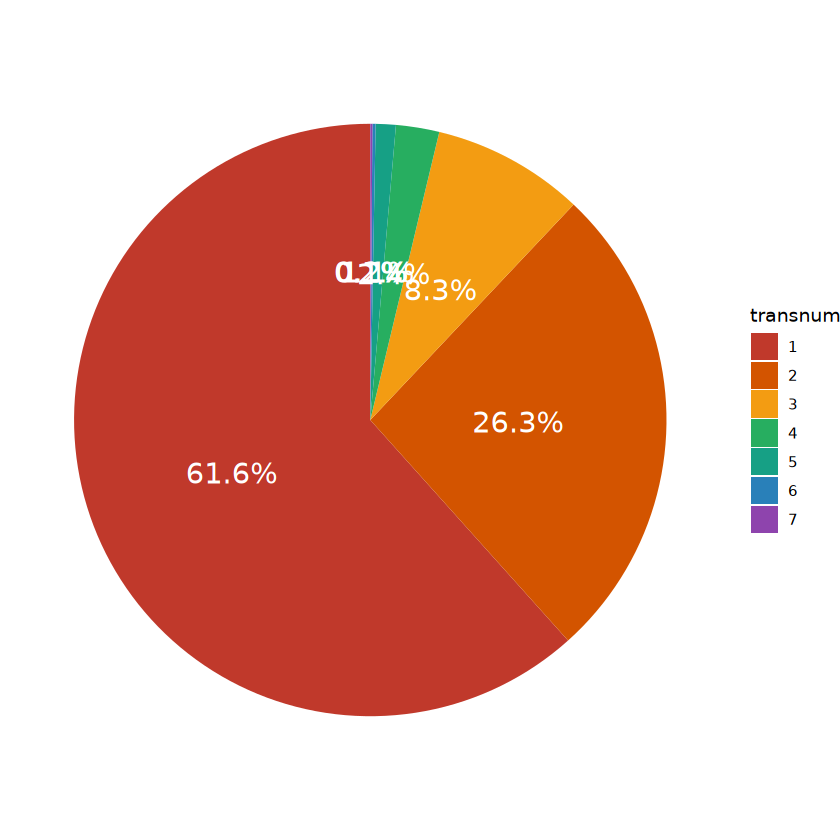

In [93]:
#pie plot
mkls.layer = merge(mkls.layer,trannumst,by = "gene_id")
mkls.layer.st = mkls.layer %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.layer.st$transnum = as.character(mkls.layer.st$transnum)
mkls.layer.st$prop = mkls.layer.st$genenum / sum(mkls.layer.st$genenum)
mkls.layer.st$proplabel = paste0(round(mkls.layer.st$prop*100,1),"%")
mkls.layer.st$group = "layer"

mkls.lobe = merge(mkls.lobe,trannumst,by = "gene_id")
mkls.lobe.st = mkls.lobe %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.lobe.st$transnum = as.character(mkls.lobe.st$transnum)
mkls.lobe.st$prop = mkls.lobe.st$genenum / sum(mkls.lobe.st$genenum)
mkls.lobe.st$proplabel = paste0(round(mkls.lobe.st$prop*100,1),"%")
mkls.lobe.st$group = "lobe"

mkls.region = merge(mkls.region,trannumst,by = "gene_id")
mkls.region.st = mkls.region %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.region.st$transnum = as.character(mkls.region.st$transnum)
mkls.region.st$prop = mkls.region.st$genenum / sum(mkls.region.st$genenum)
mkls.region.st$proplabel = paste0(round(mkls.region.st$prop*100,1),"%")
mkls.region.st$group = "region"

mkls.transt = rbind(mkls.layer.st,mkls.lobe.st,mkls.region.st)
mkls.transt
p1.4 = ggplot(mkls.transt[mkls.transt$group == "layer",], aes(x=group, y=prop, fill=transnum)) +
  geom_bar(stat="identity", width = 0.5, color= NA) +
  coord_polar("y", start=0) +
  geom_text(aes(label = proplabel),position = position_stack(0.5), color = "white", size=6) +
  scale_fill_flatui() + theme_void()
p1.4
write.csv(mkls.transt,file = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_12_05.csv")
ggexport(p1.4,filename = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_12_05.pdf",width = 4,height = 5)


### isoform diversity discribe

In [8]:
genest = fsraw.cor %>% group_by(gene_id,lobe,layer) %>% 
    summarise(count = length(readid))
genestf = genest[genest$count > 100,]
genestf.st = genestf %>% group_by(lobe,region) %>% summarise(genen = length(unique(gene_id)),readm = mean(count))
summary(genestf.st$genen)
summary(genestf.st$readm)

`summarise()` has grouped output by 'gene_id', 'lobe'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    243    1050    1988    2862    4334   10098 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  251.2   301.0   354.2   413.3   486.5  1161.4 

In [1]:
tranrate = fsraw.cor %>% group_by(gene_id,transcript_id) %>% 
    summarise(count = length(readid))
tranrate = tranrate %>% group_by(gene_id) %>% 
    mutate(genecount = sum(count),rate = count/genecount)
length(unique(tranrate$transcript_id))
tranrate = tranrate[tranrate$rate > 0.1,]
length(unique(tranrate$transcript_id))

transt = fsraw.cor %>% group_by(gene_id,transcript_id,lobe,region) %>% 
    summarise(count = length(readid))
transtf = transt[transt$transcript_id %in% tranrate$transcript_id,]
transt = transt %>% group_by(gene_id,lobe,region) %>% 
mutate(genecount = sum(count),rate = count/genecount,
       transnum = length(unique(transcript_id)))
length(unique(transtf$transcript_id))

ERROR: Error in fsraw.cor %>% group_by(gene_id, transcript_id) %>% summarise(count = length(readid)): could not find function "%>%"


In [38]:
transtf.top = transtf %>% group_by(lobe,layer) %>% top_n(500, wt = genecount)
transtf.st = transtf.top %>% group_by(lobe,layer) %>% summarise(transnum = mean(transnum),count = mean(genecount))
ggplot(transtf.st,aes(x = layer,y = lobe)) + geom_point(aes(size = count,color = transnum)) + scale_color_viridis()
ggplot(transtf.st,aes(x = count,y = transnum)) + geom_point()

gene_id,transcript_id,count,genecount,rate
<chr>,<chr>,<int>,<int>,<dbl>
A1BG,XM_015441069.1,1,1,1.0000000
A2ML1,XM_005570054.2,11,15,0.7333333
A2ML1,XM_015430339.1,4,15,0.2666667
A3GALT2,XM_005544050.2,39,39,1.0000000
A4GALT,XM_015457101.1,64,68,0.9411765
AAAS,AAAS-WeiLab-1,114,832,0.1370192


gene_id,transcript_id,lobe,layer,count,genecount,rate,transnum
<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<int>
AAK1,XM_005575681.2,temporal,l3,1871,1908,0.9806080,3
AAMDC,AAMDC-WeiLab-1,temporal,l3,216,1169,0.1847733,3
AAMDC,NM_001283690.1,temporal,l3,187,1169,0.1599658,3
AAMDC,XM_005579175.2,temporal,l3,766,1169,0.6552609,3
AARS,XM_005592535.2,temporal,l3,1829,1832,0.9983624,2
AASDHPPT,XM_005579510.2,parietal,l3,1157,1157,1.0000000,1
AASDHPPT,XM_005579510.2,temporal,l3,1881,1881,1.0000000,1
ABAT,XM_005591210.2,temporal,l3,1355,1472,0.9205163,4
ABCA2,XM_005580359.2,temporal,l3,1472,1472,1.0000000,1


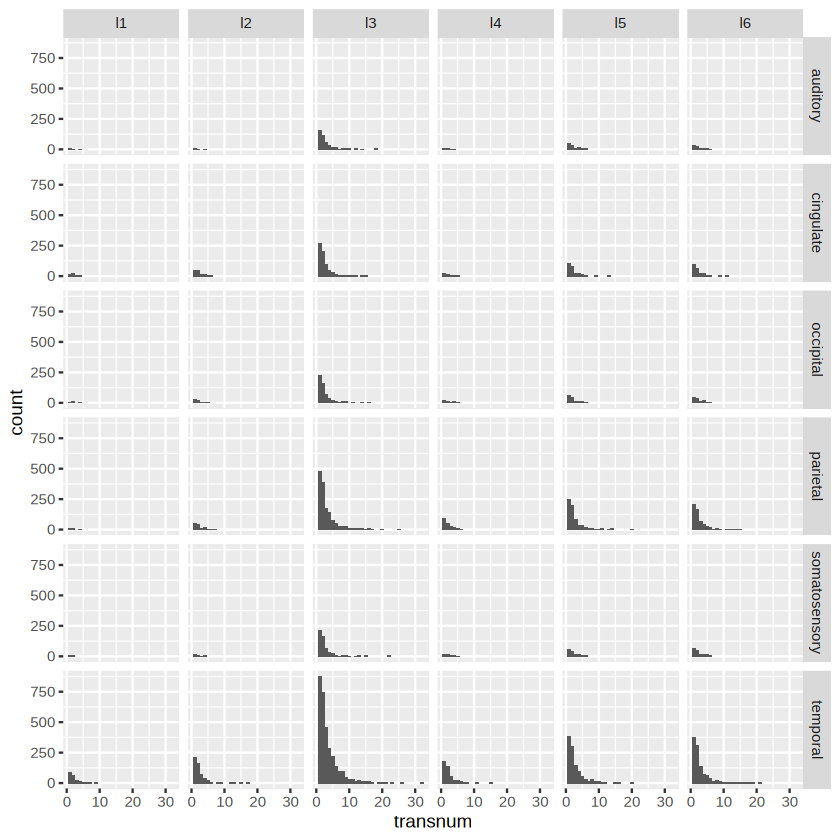

In [39]:
transtf = transtf[transtf$genecount > 100,]
transtf
ggplot(transtf,aes(x = transnum)) + 
geom_bar(stat = "count") +
facet_grid(lobe~layer) +
scale_fill_viridis(discrete = T)

#### Calculate marker gene

In [ ]:
ra = 200
fsraw.cor$xid = as.integer(fsraw.cor$x/(ra*2)) * ra * 2 + ra
fsraw.cor$yid = as.integer(fsraw.cor$y/(ra*2)) * ra * 2 + ra
fsraw.cor$blockid = paste0(fsraw.cor$xid,"_", fsraw.cor$yid)
fsraw.cor$metacell = paste0(fsraw.cor$layer,"-",fsraw.cor$region,"-",fsraw.cor$blockid)
fsraw.corf = fsraw.cor[fsraw.cor$layer %in% paste0("l",1:6),] 
genect = fsraw.corf %>% group_by(metacell,gene_id) %>% 
    summarise(count = length(readid))
transct = fsraw.corf %>% group_by(metacell,transcript_id) %>% 
    summarise(count = length(readid))
head(transct)

In [6]:
isomx = dcast.data.table(setDT(transct), transcript_id~metacell,  value.var = "count",fill = 0)
isomx = as.data.frame(isomx)
rownames(isomx) = isomx$transcript_id;isomx = isomx[-1]

genemx = dcast.data.table(setDT(genect), gene_id~metacell,  value.var = "count",fill = 0)
genemx = as.data.frame(genemx)
rownames(genemx) = genemx$gene_id;genemx = genemx[-1]


In [7]:
cellidan = data.frame(cell_id = colnames(genemx))
cellidan$layer = MySplit(cellidan$cell_id,"-",1)
cellidan$region = MySplit(cellidan$cell_id,"-",2)
head(cellidan)

,cell_id,layer,region
,<chr>,<chr>,<chr>
1,l1-1|2-10200_26200,l1,1|2
2,l1-1|2-10200_26600,l1,1|2
3,l1-1|2-10200_41000,l1,1|2
4,l1-1|2-10600_26200,l1,1|2
5,l1-1|2-10600_26600,l1,1|2
6,l1-1|2-10600_41000,l1,1|2


In [8]:
ProcessSrtUmapSingle = function(genemx,cellidan){
    srtt = CreateSeuratObject(genemx)
    srtt = NormalizeData(srtt)
    # srtt = SCTransform(srtt,new.assay.name = "SCT_GENE")
    srtt = ScaleData(srtt)
    areaan = cellidan$region
    names(areaan) = cellidan$cell_id
    layeran = cellidan$layer
    names(layeran) = cellidan$cell_id
    
    srtt$layer = layeran
    srtt$region = areaan
    # srtt$region = MySplit(colnames(srtt),"-",1)
    # names(srtt$region) = colnames(srtt)
    # srtt$layer = MySplit(colnames(srtt),"-",2)
    # names(srtt$layer) = colnames(srtt)
    # srtt$class = MySplit(colnames(srtt),"-",3)
    # names(srtt$class) = colnames(srtt)
    # srtt$subclass = MySplit(colnames(srtt),"-",4)
    # names(srtt$subclass) = colnames(srtt)
    
    # VariableFeatures(srtt) = c(VariableFeatures(srtg),sigtrangroup)
    srtt <- FindVariableFeatures(srtt, selection.method = "vst",
                                 nfeatures = 2000)
    VariableFeatures(srtt) = c(VariableFeatures(srtt))
    srtt <- RunPCA(srtt,
                   # assay =  "SCT_GENE",
                   features = VariableFeatures(object = srtt))
    srtt <- FindNeighbors(srtt, dims = 1:20)
    srtt <- FindClusters(srtt, resolution = 0.5)
    srtt <- RunUMAP(srtt, dims = 1:10)
    DimPlot(srtt)
    
    return(srtt)
}
library(Seurat)
srtg = ProcessSrtUmapSingle(genemx,cellidan)
srti = ProcessSrtUmapSingle(isomx,cellidan)

#layer markers
Idents(srtg) = srtg$layer
mk.layer =  FindAllMarkers(srtg)
#region markers
Idents(srtg) = srtg$region
mk.area =  FindAllMarkers(srtg)

#layer markers
Idents(srti) = srti$layer
mk.layer.iso =  FindAllMarkers(srti)
#region markers
Idents(srti) = srti$region
mk.area.iso =  FindAllMarkers(srti)
mkls = list("layer" = mk.layer,"area" = mk.area,"layer.iso" = mk.layer.iso,"area.iso" = mk.area.iso)
qsave(mkls,file = "result/figure2/gene_marker_list_24_08_25.qs")
mkls.layer = mkls$layer
colnames(mkls.layer)[6:7] = c("layer","gene_id")
mkls.layer = mkls.layer[mkls.layer$avg_log2FC > 0.5 & mkls.layer$p_val_adj < 0.05 & mkls.layer$pct.1 > 0.1, ]
length(unique(mkls.layer$gene))

mkls.layer.iso = mkls$layer.iso
colnames(mkls.layer.iso)[6:7] = c("layer","transcript_id")
mkls.layer.iso = mkls.layer.iso[mkls.layer.iso$avg_log2FC > 0.5 & mkls.layer.iso$p_val_adj < 0.05 & mkls.layer.iso$pct.1 > 0.1, ]
length(unique(mkls.layer.iso$transcript_id))


Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

PC_ 1 
Positive:  CALM1, MIF, ENC1, SNCG, RPS7, SST, LOC102124736, LOC102138191, PCP4, HPCAL1 
	   LOC102135846, NPY, NUDT3, LOC101925898, UBQLN1, MBP, WFDC2, TSR2, GPS2, RALBP1 
	   CPLX2, VIMP, LOC102122634, APOC1, KRT17, PENK, TPM4, C1H1orf35, NSRP1, ATXN7L3B 
Negative:  APLNR, SEMA3B, MYOC, COL1A2, LOC102115399, BambuGene74767, LOC107129559, BambuGene53464, LOC107130656, LRRC74B 
	   LOC102118389, BambuGene39231, ELN, LOC107131004, BambuGene144816, SPATA8, BambuGene97800, BambuGene134272, EGF, BambuGene106636 
	   BambuGene70340, LOC102143571, BambuGene42651, LOC102143453, BambuGene29388, LOC107130112, BambuGene17979, BambuGene100790, BambuGene91263, BambuGene81471 
PC_ 2 
Positive:  KRT17, MBP, PCP4, LOC102135846, DR

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 15228
Number of edges: 694226

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6167
Number of communities: 5
Elapsed time: 2 seconds


1 singletons identified. 4 final clusters.

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
21:53:04 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

21:53:04 Read 15228 rows and found 10 numeric columns

21:53:04 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

21:53:04 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 15228
Number of edges: 675173

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6251
Number of communities: 5
Elapsed time: 2 seconds


21:59:57 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

21:59:57 Read 15228 rows and found 10 numeric columns

21:59:57 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

21:59:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:59:59 Writing NN index file to temp file /tmp/RtmpgkdXb7/file8e5d32a4a5b9

21:59:59 Searching Annoy index using 1 thread, search_k = 3000

22:00:06 Annoy recall = 95.19%

22:00:32 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

22:00:33 799 smooth knn distance failures

22:01

In [14]:
#compare gene marker and isoform marker
mkls.layer = mkls$layer
colnames(mkls.layer)[6:7] = c("layer","gene_id")
mkls.layer = mkls.layer[mkls.layer$avg_log2FC > 0.5 & mkls.layer$p_val_adj < 0.05 & mkls.layer$pct.1 > 0.1, ]
length(unique(mkls.layer$gene))

mkls.layer.iso = mkls$layer.iso
colnames(mkls.layer.iso)[6:7] = c("layer","transcript_id")
mkls.layer.iso = mkls.layer.iso[mkls.layer.iso$avg_log2FC > 0.5 & mkls.layer.iso$p_val_adj < 0.05 & mkls.layer.iso$pct.1 > 0.1, ]
length(unique(mkls.layer.iso$transcript_id))



[1] 1159

[1] 1169

In [177]:
#Calculate Marker gene
#known marker genes:
#srtt = qread(file = "data/meta_cell_ngs/umap_srt_combined_24_03_28.qs")
DefaultAssay(srtt) = "RNA"
#layer markers
Idents(srtt) = srtt$layer
mk.layer =  FindAllMarkers(srtt)

#region markers
Idents(srtt) = srtt$area
mk.area =  FindAllMarkers(srtt)

#class
Idents(srtt) = srtt$class
mk.class =  FindAllMarkers(srtt)

#subclass
Idents(srtt) = srtt$subclass
mk.subclass =  FindAllMarkers(srtt)
mkls = list("layer" = mk.layer,"area" = mk.area,"class" = mk.class,"subclass" = mk.subclass)

qsave(mkls,file = "result/figure2/gene_marker_list_24_03_28.qs")
#mkls = qread("result/figure2/gene_marker_list_24_01_14.qs")


Calculating cluster l1

Calculating cluster l2

Calculating cluster l3

Calculating cluster l4

Calculating cluster l5

Calculating cluster l6

Calculating cluster 1|2

Calculating cluster 7op

Calculating cluster CPB

Calculating cluster V3v

Calculating cluster FST

Calculating cluster PE

Calculating cluster PEa

Calculating cluster TEO

Calculating cluster TEpv

Calculating cluster TFO

Calculating cluster TPO

Calculating cluster V4

Calculating cluster v23b

Calculating cluster 23a

Calculating cluster 23b

Calculating cluster 23c

Calculating cluster 31

Calculating cluster AI

Calculating cluster CL

Calculating cluster CM

Calculating cluster LIPd

Calculating cluster PG

Calculating cluster PGa

Calculating cluster TEpd

Calculating cluster V2

Calculating cluster V4t

Calculating cluster VIP

Calculating cluster LIPv

Calculating cluster 29

Calculating cluster 30

Calculating cluster GABA

Calculating cluster GLU

Calculating cluster NonNeuron

Calculating cluster LAMP5

Ca

In [80]:
srtt = qread("data/meta_cell_ngs/umap_srt_combined_24_03_28.qs")
srtt

An object of class Seurat 
56746 features across 18558 samples within 1 assay 
Active assay: RNA (56746 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

In [82]:
srtt$lobe = areaan[match(srtt$area,areaan$area),]$lobe
srtt$lobe

GABA-LAMP5-l1-1|2-1       GABA-LAMP5-l1-7op-1       GABA-LAMP5-l1-CPB-1 
          "somatosensory"                "parietal"                "auditory" 
      GABA-LAMP5-l1-V3v-1       GABA-LAMP5-l2-1|2-2       GABA-LAMP5-l2-1|2-3 
              "occipital"           "somatosensory"           "somatosensory" 
      GABA-LAMP5-l2-CPB-1       GABA-LAMP5-l2-FST-2        GABA-LAMP5-l2-PE-3 
               "auditory"                "temporal"                "parietal" 
      GABA-LAMP5-l2-PEa-1       GABA-LAMP5-l2-TEO-4      GABA-LAMP5-l2-TEpv-1 
               "parietal"                "temporal"                "temporal" 
      GABA-LAMP5-l2-TFO-2       GABA-LAMP5-l2-TPO-2       GABA-LAMP5-l2-TPO-3 
               "temporal"                "temporal"                "temporal" 
       GABA-LAMP5-l2-V4-1      GABA-LAMP5-l2-v23b-3      GABA-LAMP5-l2-v23b-4 
              "occipital"               "cingulate"               "cingulate" 
     GABA-LAMP5-l3-1|2-11      GABA-LAMP5-l3-1|2-14       GABA-LAMP5-l3-1|2-4 
          "somatosensory"           "somatosensory"           "somatosensory" 
      GABA-LAMP5-l3-1|2-5       GABA-LAMP5-l3-1|2-7       GABA-LAMP5-l3-1|2-8 
          "somatosensory"           "somatosensory"           "somatosensory" 
      GABA-LAMP5-l3-23a-1       GABA-LAMP5-l3-23b-2       GABA-LAMP5-l3-23b-3 
              "cingulate"               "cingulate"               "cingulate" 
      GABA-LAMP5-l3-23c-3       GABA-LAMP5-l3-23c-6        GABA-LAMP5-l3-31-2 
              "cingulate"               "cingulate"               "cingulate" 
      GABA-LAMP5-l3-7op-2       GABA-LAMP5-l3-7op-6       GABA-LAMP5-l3-7op-7 
               "parietal"                "parietal"                "parietal" 
       GABA-LAMP5-l3-AI-4        GABA-LAMP5-l3-CL-3        GABA-LAMP5-l3-CM-1 
               "auditory"                "auditory"                "auditory" 
      GABA-LAMP5-l3-CPB-2       GABA-LAMP5-l3-CPB-4       GABA-LAMP5-l3-FST-2 
               "auditory"                "auditory"                "temporal" 
      GABA-LAMP5-l3-FST-3       GABA-LAMP5-l3-FST-4      GABA-LAMP5-l3-LIPd-6 
               "temporal"                "temporal"                "parietal" 
       GABA-LAMP5-l3-PE-2        GABA-LAMP5-l3-PE-3        GABA-LAMP5-l3-PE-4 
               "parietal"                "parietal"                "parietal" 
       GABA-LAMP5-l3-PE-5        GABA-LAMP5-l3-PE-7        GABA-LAMP5-l3-PE-9 
               "parietal"                "parietal"                "parietal" 
      GABA-LAMP5-l3-PEa-4       GABA-LAMP5-l3-PEa-5       GABA-LAMP5-l3-PEa-7 
               "parietal"                "parietal"                "parietal" 
      GABA-LAMP5-l3-PEa-8        GABA-LAMP5-l3-PG-6       GABA-LAMP5-l3-PGa-2 
               "parietal"                "parietal"                "temporal" 
     GABA-LAMP5-l3-TEO-10       GABA-LAMP5-l3-TEO-3       GABA-LAMP5-l3-TEO-4 
               "temporal"                "temporal"                "temporal" 
      GABA-LAMP5-l3-TEO-6       GABA-LAMP5-l3-TEO-8      GABA-LAMP5-l3-TEpd-1 
               "temporal"                "temporal"                "temporal" 
     GABA-LAMP5-l3-TEpd-2      GABA-LAMP5-l3-TEpd-3     GABA-LAMP5-l3-TEpv-12 
               "temporal"                "temporal"                "temporal" 
     GABA-LAMP5-l3-TEpv-2      GABA-LAMP5-l3-TEpv-4      GABA-LAMP5-l3-TEpv-6 
               "temporal"                "temporal"                "temporal" 
     GABA-LAMP5-l3-TEpv-9       GABA-LAMP5-l3-TFO-4       GABA-LAMP5-l3-TFO-5 
               "temporal"                "temporal"                "temporal" 
      GABA-LAMP5-l3-TFO-8       GABA-LAMP5-l3-TPO-2       GABA-LAMP5-l3-TPO-4 
               "temporal"                "temporal"                "temporal" 
      GABA-LAMP5-l3-TPO-5       GABA-LAMP5-l3-TPO-7        GABA-LAMP5-l3-V2-1 
               "temporal"                "temporal"               "occipital" 
      GABA-LAMP5-l3-V3v-2        GABA-LAMP5-l3-V4-3     

In [83]:
Idents(srtt) = srtt$lobe
mk.lobe =  FindAllMarkers(srtt)
mkls$lobe = mk.lobe
qsave(mkls,file = "result/figure2/gene_marker_list_24_03_28.qs")

Calculating cluster somatosensory

Calculating cluster parietal

Calculating cluster auditory

Calculating cluster occipital

Calculating cluster temporal

Calculating cluster cingulate



#### layer level

##### build analysis data structure

In [87]:
#isoform gene markers load
mkls = qread("result/figure2/gene_marker_list_24_03_28.qs")
head(mkls)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
SNAP25,1.192707e-305,-2.037332,0.965,1.000,6.768136e-301,l1,SNAP25
GFAP,1.988980e-250,3.325589,0.962,0.791,1.128667e-245,l1,GFAP
LOC102130415,5.406137e-250,3.319324,0.962,0.796,3.067766e-245,l1,LOC102130415
BambuGene90232,1.985125e-235,-2.006152,0.797,0.994,1.126479e-230,l1,BambuGene90232
CHN1,2.483550e-231,-1.868847,0.845,0.996,1.409315e-226,l1,CHN1
LMO4,3.217013e-213,-2.154598,0.505,0.956,1.825526e-208,l1,LMO4
BambuGene3276,1.462688e-210,-2.223499,0.463,0.943,8.300171e-206,l1,BambuGene3276
VSNL1,3.732879e-205,-1.746246,0.775,0.993,2.118260e-200,l1,VSNL1
FABP7,2.304516e-203,3.671088,0.736,0.298,1.307721e-198,l1,FABP7


In [363]:
#marker gene isoform diversity stat
#only consider equal transcript and one most compatible transcript
# fsraw = fsraw %>% group_by(transcript_id) %>% mutate(trancount = length(unique(readid)))
# fsraw$type = factor(fsraw$type,levels = c("equal","compatible"))
# fsraw = fsraw[order(fsraw$readid,fsraw$type,-fsraw$trancount),]
# fsrawdp = fsraw[!duplicated(fsraw$readid),]
# qsave(fsrawdp,file = "data/reads_full_anotation/main_data_read_total_annotation_dedup_24_03_27.qs")
# nrow(fsraw)
# nrow(fsrawdp)

[1] 118133211

[1] 40143717

In [98]:
#marker gene select
#filter isoform and stat diversity
genetrst = fsraw.cor %>% group_by(layer,gene_id) %>% 
    mutate(readnumt = length(unique(readid))) %>% 
    group_by(layer,gene_id,transcript_id)  %>% 
    summarise(readnum = length(unique(readid)),
              readnumt = readnumt[1],
              readrate = readnum/readnumt)
fsgenest = fsraw.cor %>% group_by(layer, gene_id) %>% summarise(readnum = length(unique(readid)))
summary(genetrst$readrate)
genetrstf = genetrst[genetrst$readrate > 0.05,]
genetrstf.st = genetrstf %>% group_by(layer,gene_id) %>% summarise(transnum = length(unique(transcript_id)))

mkls.layer = mkls$layer
colnames(mkls.layer)[6:7] = c("layer","gene_id")
mkls.layer = mkls.layer[mkls.layer$avg_log2FC > 0.5 & mkls.layer$p_val_adj < 0.05 & mkls.layer$pct.1 > 0.25, ]
length(unique(mkls.layer$gene))

genetrstf = genetrstf %>% group_by(layer,gene_id) %>% mutate(transnum = length(unique(transcript_id)))
#head(genetrstf)
mkls.layer.st = merge(mkls.layer,genetrstf, by = c("layer","gene_id"))
mkls.layer.st = mkls.layer.st %>% group_by(layer, gene_id) %>% summarise(mrate = max(readrate),transnum = transnum[1],readnumt = readnumt[1])
mkls.layer.st = mkls.layer.st[order(mkls.layer.st$layer,-mkls.layer.st$readnumt),]
mkls.layer.st$layer = factor(as.character(mkls.layer.st$layer),levels = paste0("l",1:6))
mkls.layer.st = mkls.layer.st %>% group_by(layer) %>% mutate(geneorder = as.numeric(factor(gene_id,levels = unique(gene_id))) )
head(mkls.layer.st)

`summarise()` has grouped output by 'layer', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
0.0000013 0.0555556 0.4666667 0.4956946 1.0000000 1.0000000 

`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


[1] 1398

`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


layer,gene_id,mrate,transnum,readnumt,geneorder
<fct>,<chr>,<dbl>,<int>,<int>,<dbl>
l1,CST3,1.0000000,1,17655,1
l1,PTGDS,0.9977254,1,14508,2
l1,CLU,0.9927260,1,14435,3
l1,GFAP,0.9974909,1,14348,4
l1,APOE,0.6928850,2,10527,5
l1,CPE,1.0000000,1,7001,6


In [94]:
names(mkls)

[1] "layer"    "area"     "class"    "subclass" "lobe"

In [96]:
#marker gene select
#filter isoform and stat diversity
genetrst = fsraw.cor %>% group_by(lobe,gene_id) %>% 
    mutate(readnumt = length(unique(readid))) %>% 
    group_by(lobe,gene_id,transcript_id)  %>% 
    summarise(readnum = length(unique(readid)),
              readnumt = readnumt[1],
              readrate = readnum/readnumt)
summary(genetrst$readrate)
genetrstf = genetrst[genetrst$readrate > 0.05,]
genetrstf.st = genetrstf %>% group_by(lobe,gene_id) %>% summarise(transnum = length(unique(transcript_id)))

mkls.lobe = mkls$lobe
colnames(mkls.lobe)[6:7] = c("lobe","gene_id")
mkls.lobe= mkls.lobe[mkls.lobe$avg_log2FC > 0.5 & mkls.lobe$p_val_adj < 0.05 & mkls.lobe$pct.1 > 0.25, ]
length(unique(mkls.lobe$gene))

# summary(fsgenest$readnum)
# fsgenestf = fsgenest[fsgenest$readnum > 100,]
# summary(fsgenestf$readnum)
# mkls.layerf = mkls.layer[paste0(mkls.layer$layer,mkls.layer$gene) %in% paste0(fsgenestf$layer,fsgenestf$gene_id),]
# length(unique(mkls.layerf$gene))

genetrstf = genetrstf %>% group_by(lobe,gene_id) %>% mutate(transnum = length(unique(transcript_id)))
#head(genetrstf)
mkls.lobe.st = merge(mkls.lobe,genetrstf, by = c("lobe","gene_id"))
mkls.lobe.st = mkls.lobe.st %>% group_by(lobe, gene_id) %>% summarise(mrate = max(readrate),transnum = transnum[1],readnumt = readnumt[1])
mkls.lobe.st = mkls.lobe.st[order(mkls.lobe.st$lobe,-mkls.lobe.st$readnumt),]
mkls.lobe.st = mkls.lobe.st %>% group_by(lobe) %>% mutate(geneorder = as.numeric(factor(gene_id,levels = unique(gene_id))) )

head(mkls.lobe.st)

`summarise()` has grouped output by 'lobe', 'gene_id'. You can override using
the `.groups` argument.


     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
0.0000021 0.0539216 0.4597429 0.4942757 1.0000000 1.0000000 

`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.


[1] 519

`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.


lobe,gene_id,mrate,transnum,readnumt,geneorder
<fct>,<chr>,<dbl>,<int>,<int>,<dbl>
somatosensory,CCK,0.6098906,2,11243,1
somatosensory,PTGDS,0.9980207,1,11115,2
somatosensory,LOC102128139,0.9980983,1,11043,3
somatosensory,LOC102145066,1.0000000,1,8451,4
somatosensory,NDUFA13,1.0000000,1,7289,5
somatosensory,ATP5J2,0.9401346,1,7283,6


##### figure2b. marker gene isoform heterogeneity

1           2           3           4           5          >5 
"#C0392BFF" "#D35400FF" "#F39C12FF" "#27AE60FF" "#16A085FF" "#2980B9FF"

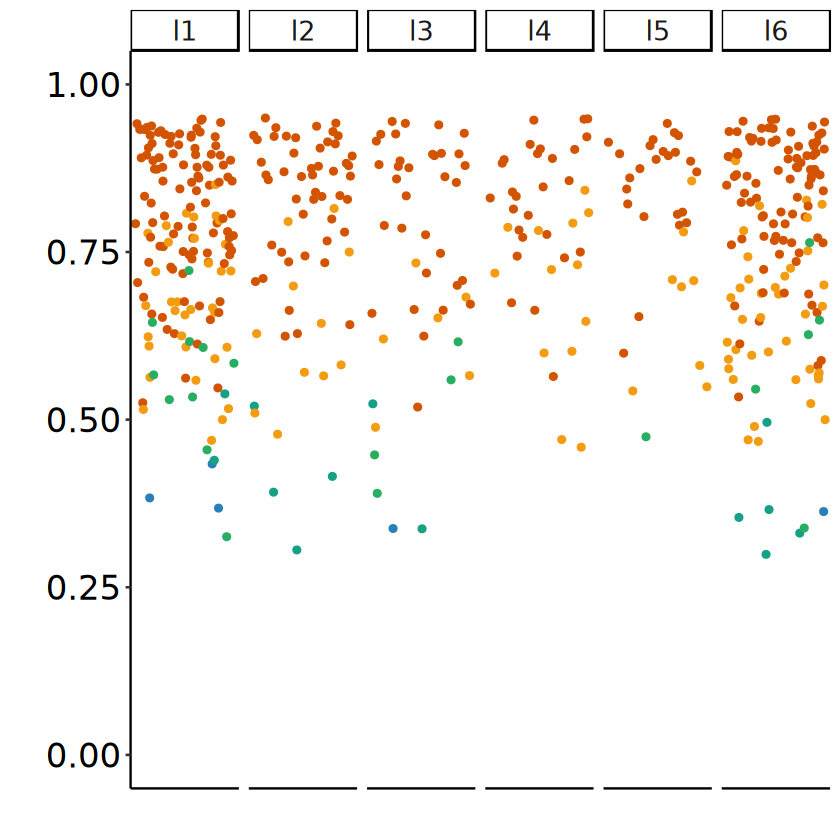

In [221]:
mkls.layer.st$transnumlabel = as.character(mkls.layer.st$transnum)
mkls.layer.st[mkls.layer.st$transnum > 5,]$transnumlabel = ">5"

mycolor = pal_flatui("default")(6)
names(mycolor) = c(as.character(1:5),">5")
mycolor
p1.1 = ggplot(mkls.layer.st[mkls.layer.st$transnum > 1,],aes(x = geneorder,y = mrate,color = transnumlabel)) + geom_point() +
facet_grid(~layer,scales = "free") + theme_pubr() + 
theme(axis.text.x = element_blank(),axis.ticks.x = element_blank(),strip.background = element_rect(fill = NA)) +
scale_y_continuous(limits = c(0,1)) +
scale_color_manual(values = mycolor) + 
#labs(x = "Expression ranking of layer marker gene", y = "Dominant isoform ratio of multiple isoform gene",color = "Isoform diversity") +
labs(x = "",y = "") +
theme(legend.position = "none",text = element_text(size = 20))
p1.1

`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


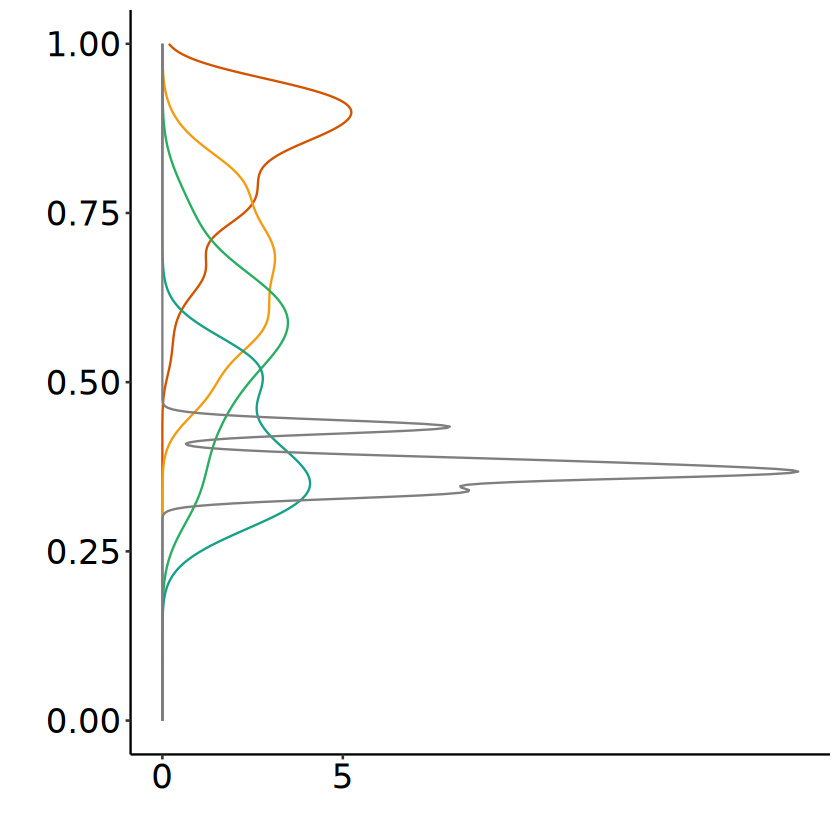

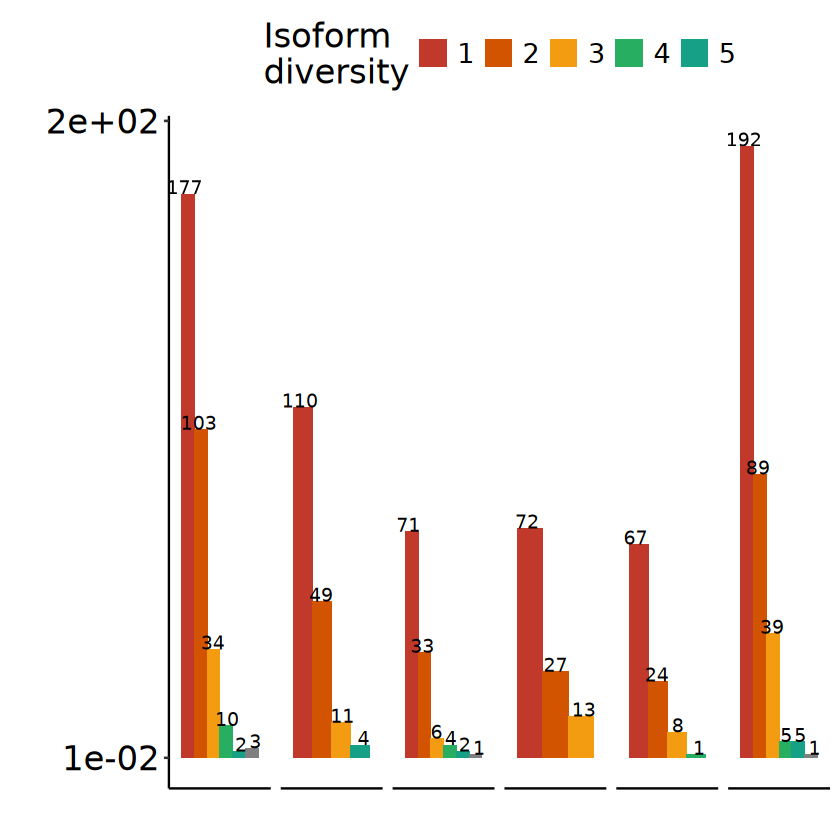

In [222]:
mkls.layer.st$isoformdiv = factor(mkls.layer.st$transnum,levels = 1:max(mkls.layer.st$transnum))
p1.2 = ggplot(mkls.layer.st[mkls.layer.st$transnum > 1,],aes(x = mrate,color = isoformdiv)) + geom_density() + 
scale_color_manual(values = mycolor) + 
theme_pubr() + labs(x = "",y = "",color = "Isoform\ndiversity") + theme(legend.position = "none",text = element_text(size = 20)) + 
 scale_x_continuous(limits = c(0,1)) + scale_y_continuous(breaks = c(0,5)) +
coord_flip()
p1.2
mkls.layer.st2 = mkls.layer.st %>% group_by(layer,transnum) %>% summarise(genenum = length(unique(gene_id)))
p1.3 = ggplot(mkls.layer.st2,
              aes(x = layer,fill = as.character(transnum),y = genenum)) + geom_bar(stat = "identity",position = "dodge") +
geom_text(aes(label = genenum),position = position_dodge(1),vjust = 0) +
scale_fill_manual(values = mycolor) + 
labs(x = "",y = "",fill = "Isoform\ndiversity") +
scale_y_continuous(breaks = c(0.01,200)) +
facet_grid(~layer,scales = "free") +
theme_pubr() + 
theme(legend.position = "top",axis.text.x = element_blank(),axis.ticks.x = element_blank(),
      strip.background = element_rect(fill = NA,color = NA),
      strip.text = element_blank(),text = element_text(size = 20))
p1.3

In [427]:
library("gridExtra")
pdf("result/figure2/gene_marker_isoform_heterogeneity_stat_24_05_01.pdf",width = 8,height = 6)
p1.t = grid.arrange(
  p1.3,p1.1,p1.2,
  widths = c(2, 1),heights = c(3,6),
  layout_matrix = rbind(c(1, NA),
                        c(2, 3))
)
dev.off()
p1.t

Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


png 
  2

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]
3 3 (2-2,2-2) arrange gtable[layout]

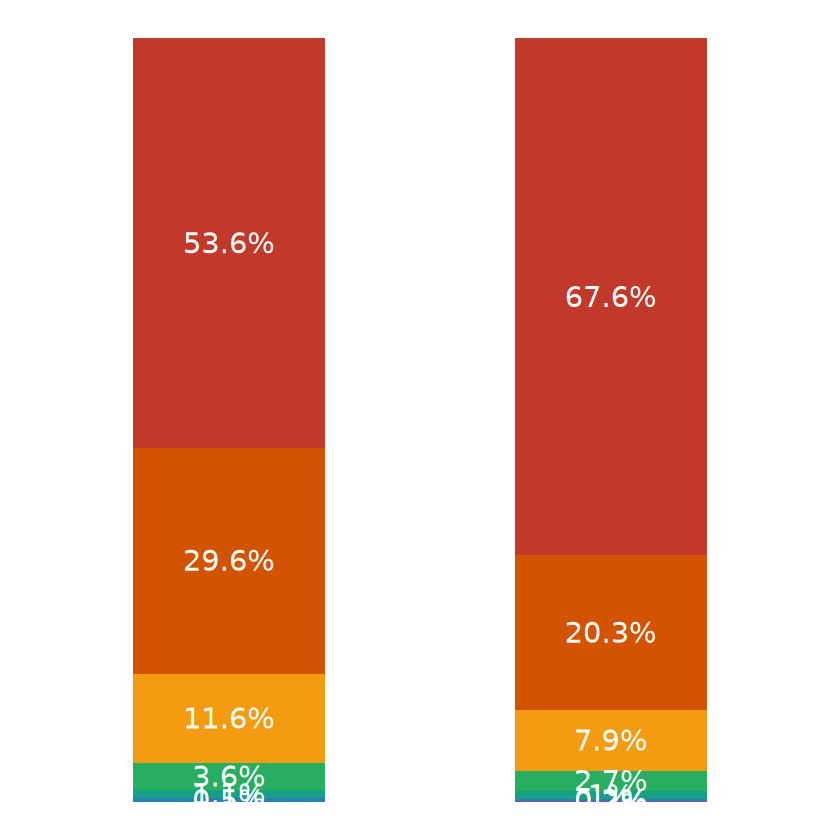

In [104]:
#pie plot

mkls.layer.st3 = mkls.layer.st %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.layer.st3$transnum = as.character(mkls.layer.st3$transnum)
mkls.layer.st3 <- mkls.layer.st3 %>% 
  arrange(desc(transnum)) %>%
  mutate(prop = genenum / sum(mkls.layer.st3$genenum) *100) %>%
  mutate(ypos = cumsum(prop)- 0.5*prop )
mkls.layer.st3$proplabel = paste0(round(mkls.layer.st3$prop,1),"%")
mkls.layer.st3$group = "layer"

mkls.lobe.st3 = mkls.lobe.st %>% group_by(transnum) %>% summarise(genenum = length(unique(gene_id)))
mkls.lobe.st3$transnum = as.character(mkls.lobe.st3$transnum)
mkls.lobe.st3 <- mkls.lobe.st3 %>% 
  arrange(desc(transnum)) %>%
  mutate(prop = genenum / sum(mkls.lobe.st3$genenum) *100) %>%
  mutate(ypos = cumsum(prop)- 0.5*prop )
mkls.lobe.st3$proplabel = paste0(round(mkls.lobe.st3$prop,1),"%")
mkls.lobe.st3$group = "lobe"

mkls.transt = rbind(mkls.layer.st3,mkls.lobe.st3)

p1.4 = ggplot(mkls.transt, aes(x=group, y=prop, fill=transnum)) +
  geom_bar(stat="identity", width = 0.5, color= NA) +
  #coord_polar("y", start=0) +
  geom_text(aes(y = ypos, label = proplabel), color = "white", size=6) +
  scale_fill_flatui() + theme_pubr()
p1.4
write.csv(mkls.layer.st3,file = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_08_25.csv")
ggexport(p1.4,filename = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_08_25.pdf",width = 4,height = 5)


file saved to result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_08_25.pdf



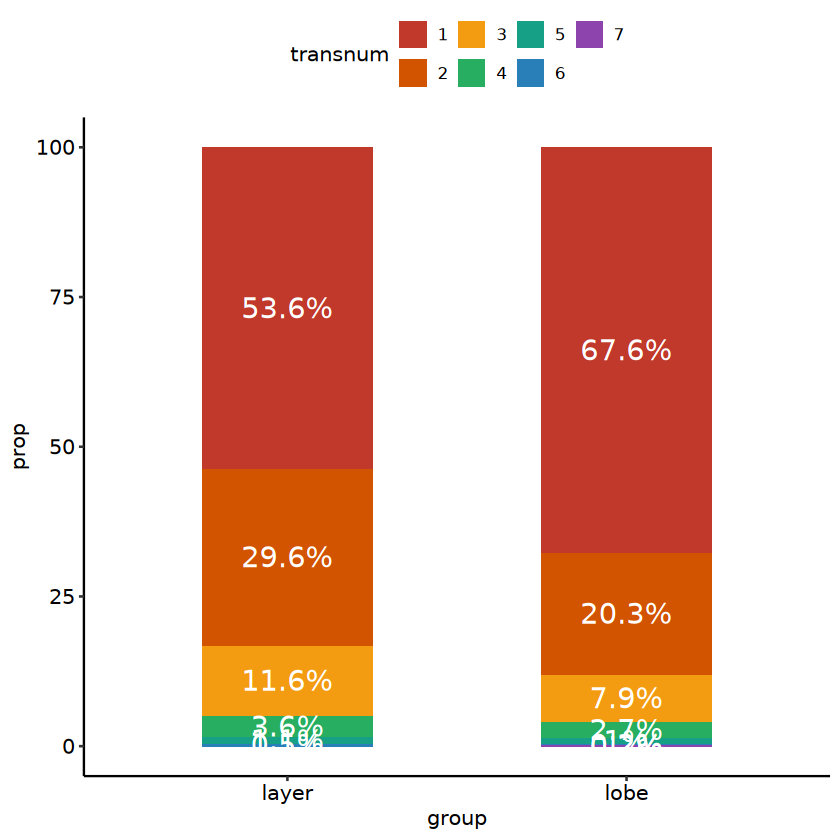

In [108]:
p1.4 = ggplot(mkls.transt, aes(x=group, y=prop, fill=transnum)) +
  geom_bar(stat="identity", width = 0.5, color= NA) +
  #coord_polar("y", start=0) +
  geom_text(aes(y = ypos, label = proplabel), color = "white", size=6) +
  scale_fill_flatui() + theme_pubr()
p1.4
write.csv(mkls.layer.st3,file = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_08_25.csv")
ggexport(p1.4,filename = "result/figure2/gene_marker_isoform_heterogeneity_stat_pie_24_08_25.pdf",width = 4,height = 5)

In [409]:
#plot isoform diversity in different layer/region
#downsample gene read
fsrawdp = fsrawdp[fsrawdp$layer %in% paste0("l",1:6),] %>% group_by(layer,gene_id) %>% mutate(treadnum = length(unique(readid)))
fsrawdpf = fsrawdp[fsrawdp$treadnum > 100,]
fsrawdpf %>% group_by(layer) %>% summarise(genenum = length(unique(gene_id)))
fsrawdpf.down = fsrawdpf %>% group_by(layer,gene_id) %>% 
    mutate(randomid = sample(x = 1:n(),size = n()))
fsrawdpf.down = fsrawdpf.down[fsrawdpf.down$randomid %in% 1:100,]
fsrawdpf.down.st = fsrawdpf.down %>% group_by(gene_id) %>% summarise(areanum = length(unique(layer)))
#commongene = fsrawdpf.down.st[fsrawdpf.down.st$areanum == 6,]$gene_id
#fsrawdpf.down = fsrawdpf.down[fsrawdpf.down$gene_id %in% commongene,]


layer,genenum
<chr>,<int>
l1,3160
l2,5755
l3,11005
l4,5539
l5,8348
l6,8234


In [252]:
genetrst.down = fsrawdpf.down %>% group_by(layer,gene_id) %>% 
    mutate(readnumt = length(unique(readid))) %>% 
    group_by(layer,gene_id,transcript_id)  %>% 
    summarise(readnum = length(unique(readid)),
              readnumt = readnumt[1],
              readrate = readnum/readnumt)
genetrst.down = genetrst.down[paste0(genetrst.down$layer,genetrst.down$gene_id) %in% paste0(mkls.layerf$layer,mkls.layerf$gene_id),]
genetrst.downf = genetrst.down[genetrst.down$readrate > 0.05,]
genetrst.downf.st = genetrst.downf %>% group_by(layer,gene_id) %>% summarise(transnum = length(unique(transcript_id)))

`summarise()` has grouped output by 'layer', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


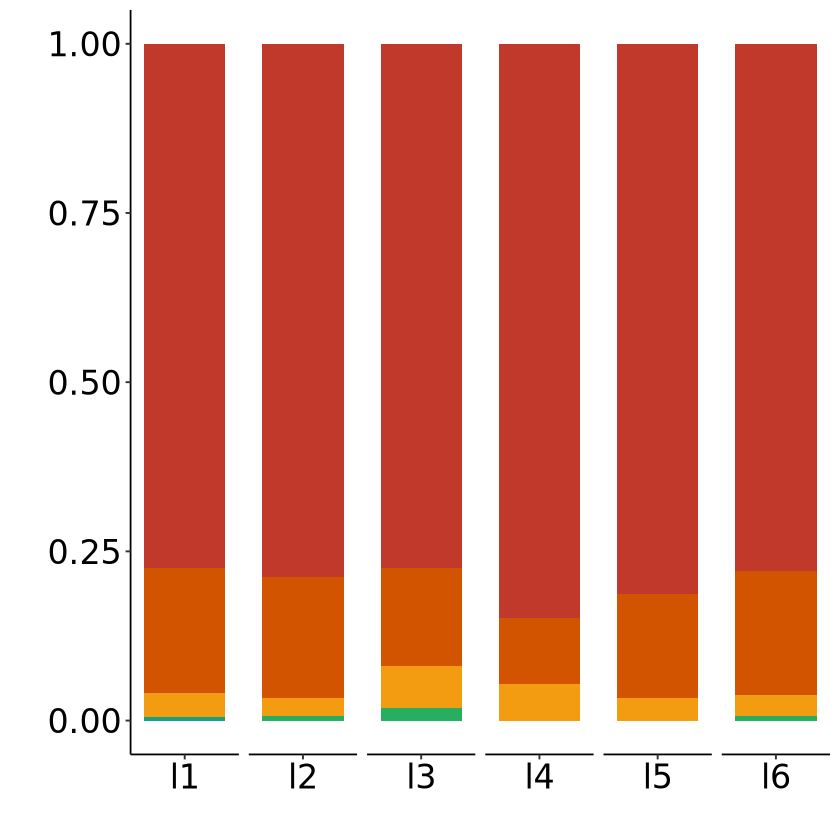

In [253]:
mkls.layer.down.st = genetrst.downf.st %>% group_by(layer,transnum) %>% summarise(genenum = length(unique(gene_id)))
p1.5 = ggplot(mkls.layer.down.st,
              aes(x = layer,fill = as.character(transnum),y = genenum)) + geom_bar(stat = "identity",position = "fill") +
scale_fill_flatui() + labs(x = "",y = "",fill = "Isoform\ndiversity") +
facet_grid(~layer,scales = "free") +
theme_pubr() + 
theme(legend.position = "none",
      strip.background = element_rect(fill = NA,color = NA),
      strip.text = element_blank(),text = element_text(size = 20))
p1.5

#### Lobe Level

In [87]:
#process data
fsrawdp$areatr = fsrawdp$lobe
fsrawdp$chunk = fsrawdp$region
mkls.at = mkls$lobe

mkgan.lobe = MarkerGenePreAna(fsrawdp,mkls.at)
qsave(mkgan.lobe,file = "result/figure2/marker_gene_analysis_datals_lobe_24_03_30.qs")
head(mkgan.lobe$mkls.st)


`summarise()` has grouped output by 'areatr', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk', 'gene_id'. You can
override using the `.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -1.5063"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 0.5063"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric,

areatr,gene_id,mrate,transnum,readnumt,geneorder
<fct>,<chr>,<dbl>,<int>,<int>,<dbl>
somatosensory,LOC102128139,0.9993973,1,6637,1
somatosensory,CCK,0.9230147,2,6183,2
somatosensory,PTGDS,0.9995974,1,4968,3
somatosensory,LOC102145066,1.0000000,1,4034,4
somatosensory,ATP5J2,0.9491779,1,3345,5
somatosensory,OAZ1,1.0000000,1,3251,6


In [499]:
mkgan.lobe = qread("result/figure2/marker_gene_analysis_datals_lobe_24_03_30.qs")

In [90]:
table(mkls.at$cluster)


somatosensory      parietal      auditory     occipital      temporal 
        11416         10006          5749          2038          6815 
    cingulate 
         7844 

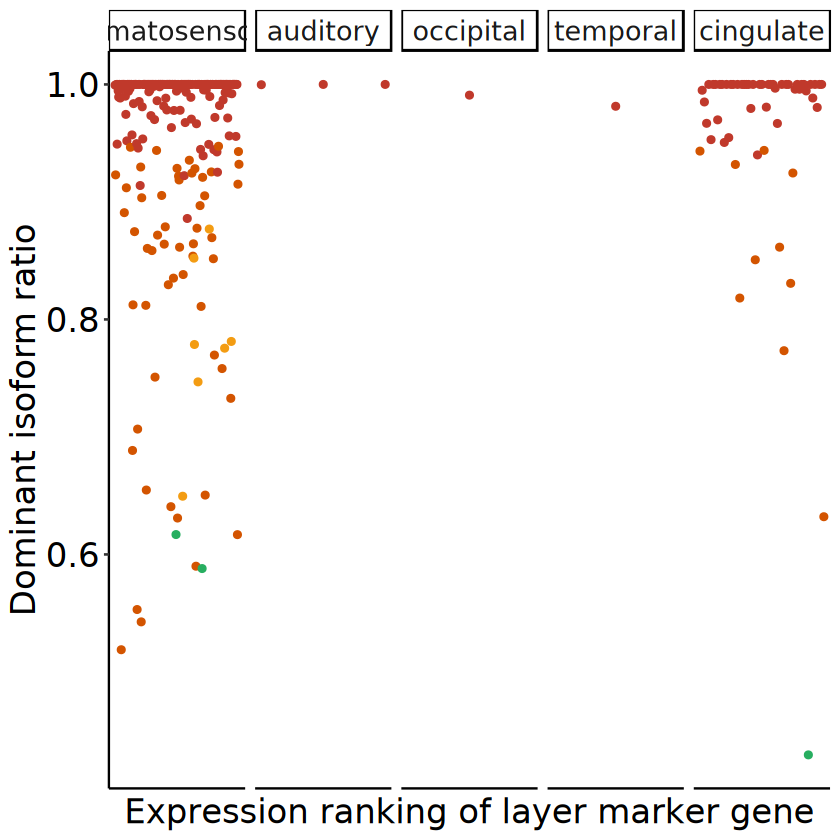

`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.


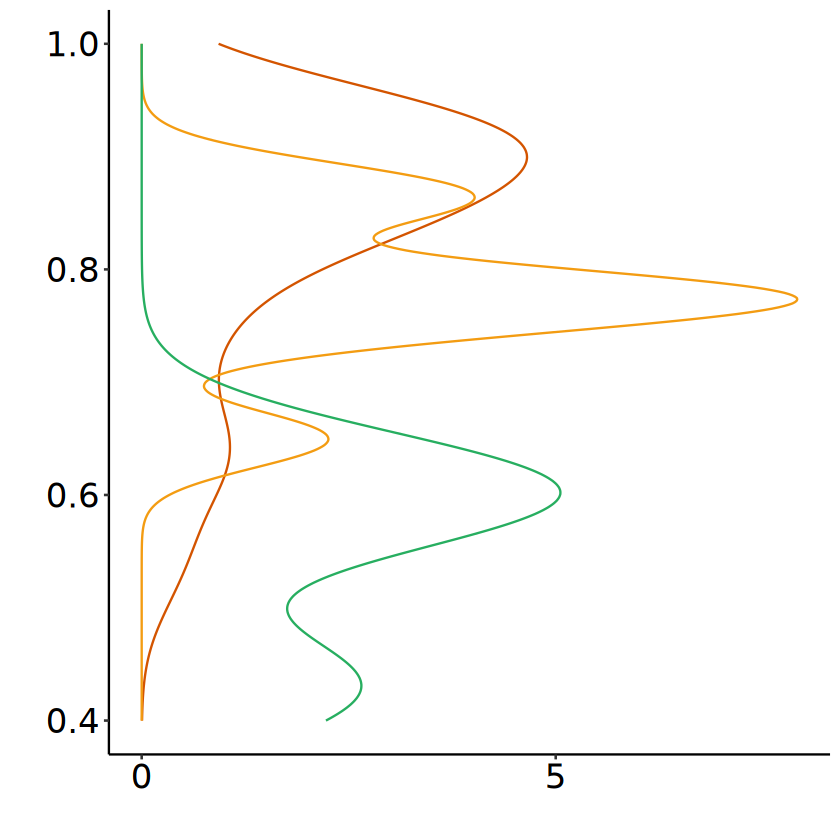

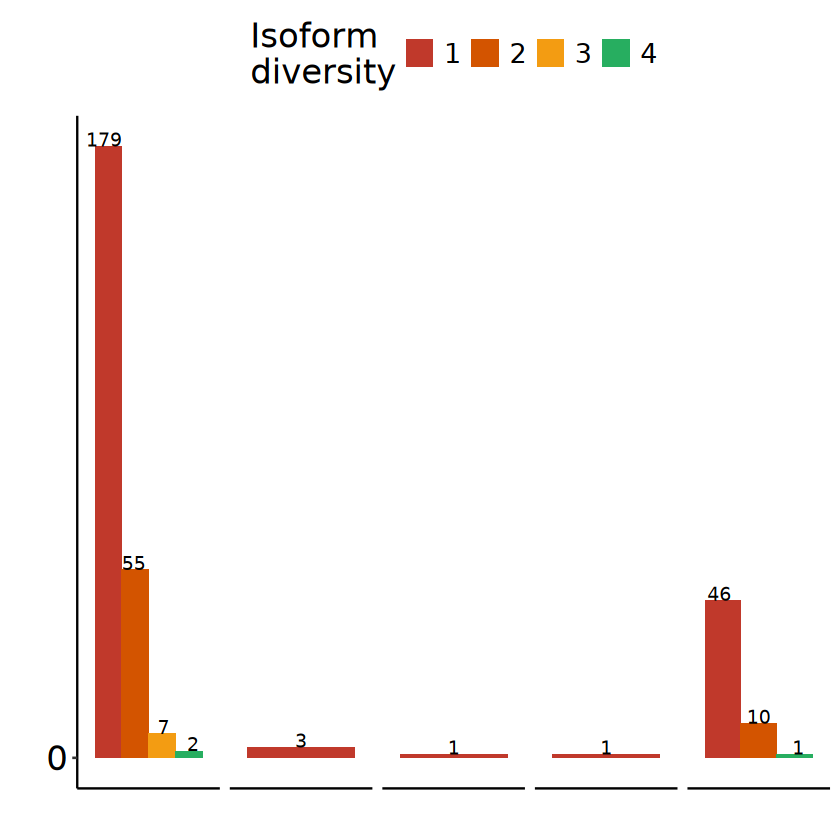

In [500]:
mkls.sti = mkgan.lobe$mkls.st
p1.1 = ggplot(mkls.sti,aes(x = geneorder,y = mrate,color = as.character(transnum))) + geom_point() +
facet_grid(~areatr,scales = "free") + theme_pubr() + 
theme(axis.text.x = element_blank(),axis.ticks.x = element_blank(),strip.background = element_rect(fill = NA)) +
scale_color_flatui() + labs(x = "Expression ranking of layer marker gene", y = "Dominant isoform ratio",color = "Isoform diversity") +
theme(legend.position = "none",text = element_text(size = 20))
p1.1
mkls.sti$isoformdiv = factor(mkls.sti$transnum,levels = 1:max(mkls.sti$transnum))
mycolor = pal_flatui("default")(length(unique(mkls.sti$isoformdiv)))
p1.2 = ggplot(mkls.sti[mkls.sti$transnum > 1,],aes(x = mrate,color = isoformdiv)) + geom_density() + 
scale_color_manual(values = mycolor[-1]) + 
theme_pubr() + labs(x = "",y = "",color = "Isoform\ndiversity") + theme(legend.position = "none",text = element_text(size = 20)) + 
 scale_x_continuous(limits = c(0.4,1)) + scale_y_continuous(breaks = c(0,5)) +
coord_flip()
p1.2
mkls.sti2 = mkls.sti %>% group_by(areatr,transnum) %>% summarise(genenum = length(unique(gene_id)))
p1.3 = ggplot(mkls.sti2,
              aes(x = areatr,fill = as.character(transnum),y = genenum)) + geom_bar(stat = "identity",position = "dodge") +
geom_text(aes(label = genenum),position = position_dodge(1),vjust = 0) +
scale_fill_flatui() + labs(x = "",y = "",fill = "Isoform\ndiversity") +
scale_y_continuous(breaks = c(0,200)) +
facet_grid(~areatr,scales = "free") +
theme_pubr() + 
theme(legend.position = "top",axis.text.x = element_blank(),axis.ticks.x = element_blank(),
      strip.background = element_rect(fill = NA,color = NA),
      strip.text = element_blank(),text = element_text(size = 20))
p1.3

In [501]:
mkls.sti = mkgan.lobe$mkls.st
mklsfi = mkgan.lobe$mklsf

#select top
hubgene = mkls.sti[mkls.sti$transnum > 1 & mkls.sti$mrate < 0.9 & mkls.sti$readnumt > 50 ,]
mklsfi.hub = mklsfi[mklsfi$gene_id %in% hubgene$gene_id,]
mklsfi.hub = mklsfi.hub %>% group_by(areatr) %>% top_n(wt = avg_log2FC, n = 10)
mklsfi.hub



p_val,avg_log2FC,pct.1,pct.2,p_val_adj,areatr,gene_id
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
3.757238e-60,0.8375792,0.872,0.759,2.132082e-55,somatosensory,B2M
6.067310e-57,0.6777459,0.820,0.692,3.442956e-52,somatosensory,ATP5G1
2.497142e-28,0.6288763,0.679,0.563,1.417028e-23,somatosensory,PFKP
1.145216e-15,0.6647419,0.352,0.261,6.498643e-11,somatosensory,LOC101865759
1.608106e-15,0.6764842,0.317,0.230,9.125358e-11,somatosensory,CLUH
2.200921e-14,0.6682486,0.305,0.222,1.248934e-09,somatosensory,MRPL36
4.007467e-14,0.6198127,0.282,0.203,2.274077e-09,somatosensory,BambuGene18705
1.544318e-12,0.6937784,0.359,0.279,8.763386e-08,somatosensory,RNASE1
1.389393e-11,0.7207615,0.295,0.226,7.884250e-07,somatosensory,KLHDC9


Using transid as id variables

Warning message:
"Duplicated aesthetics after name standardisation: size"
Warning message in geom_boxplot(aes(x = areatr, y = value, color = transid), size = 0.3, :
"Ignoring unknown parameters: `drop`"


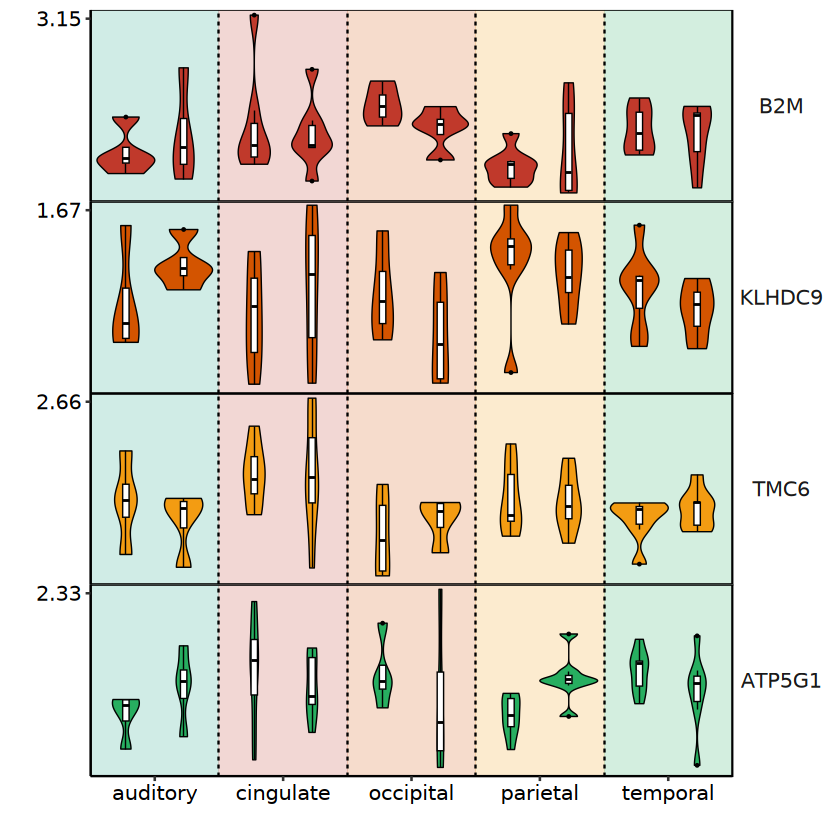

In [505]:
selectedhub = c("B2M","KLHDC9","TMC6","ATP5G1")
transt.spi = mkgan.lobe$transt.sp
srt.spi = mkgan.lobe$srt.sp
genetrstfi = mkgan.lobe$genetrstf

transt.sp.hub = transt.spi[transt.spi$gene_id %in% selectedhub & transt.spi$transcript_id %in% genetrstfi$transcript_id,]
transidsub = unique(transt.sp.hub$transgroup)
transidsub = gsub(transidsub,pattern = "_",replacement = "-")
srt.sp.sub = subset(srt.spi,features = transidsub)
pc.box2 = modify_vlnplot(srt.sp.sub, selectedhub)
pc.box2

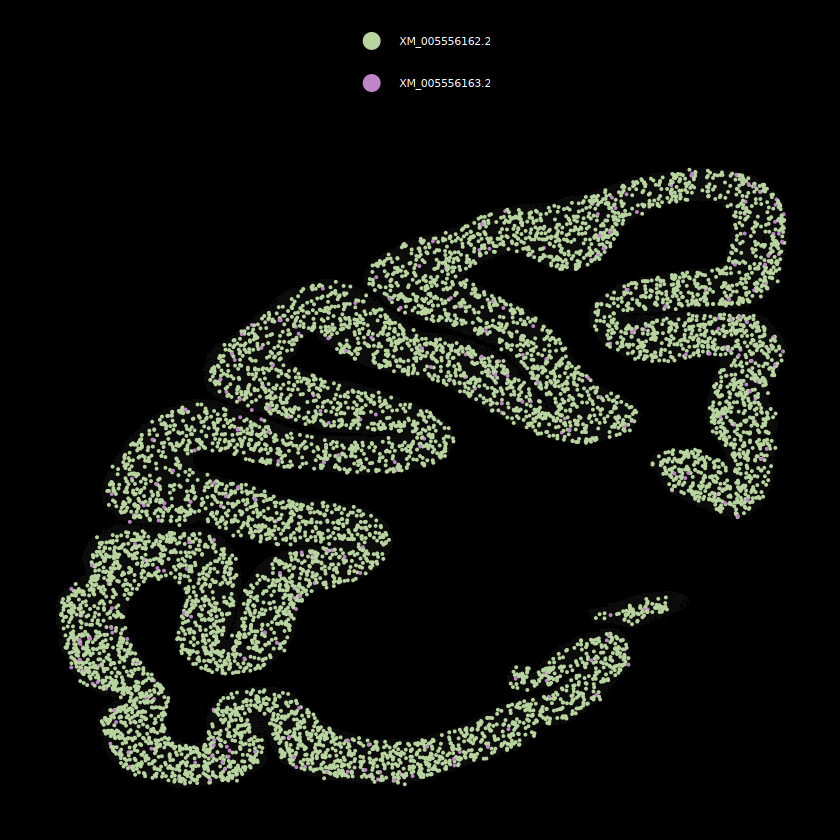

In [518]:
plmkt.spi = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,"GRIA2",NULL,NULL)
plmkt.spi

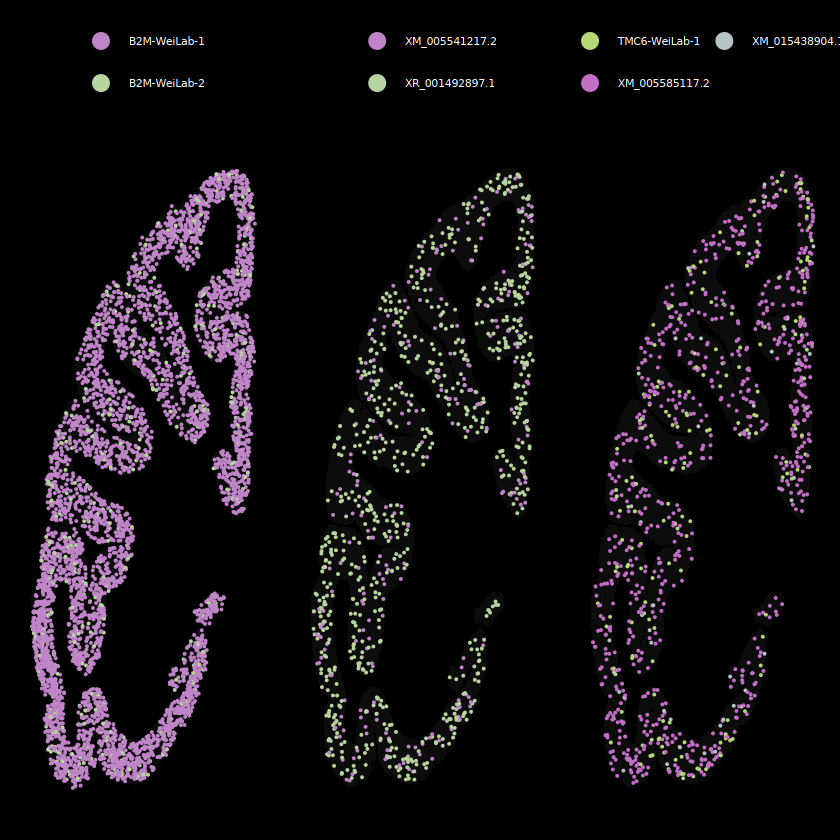

In [503]:
#fsrawdp.cellf = fsrawdp.cell[fsrawdp.cell$transcript_id %in% genetrstf$transcript_id,]
plmkt.sp2 = list()
for (i in 1:length(selectedhub)) {
    plmkt.sp2[[i]] = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,selectedhub[i])
}
plmkt.spt2 = ggarrange(plotlist = plmkt.sp2,nrow = 1)
plmkt.spt2

### Marker Case plot

`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
file saved to result/figure2/Layer_markergene_spatial_plot_24_09_05.pdf



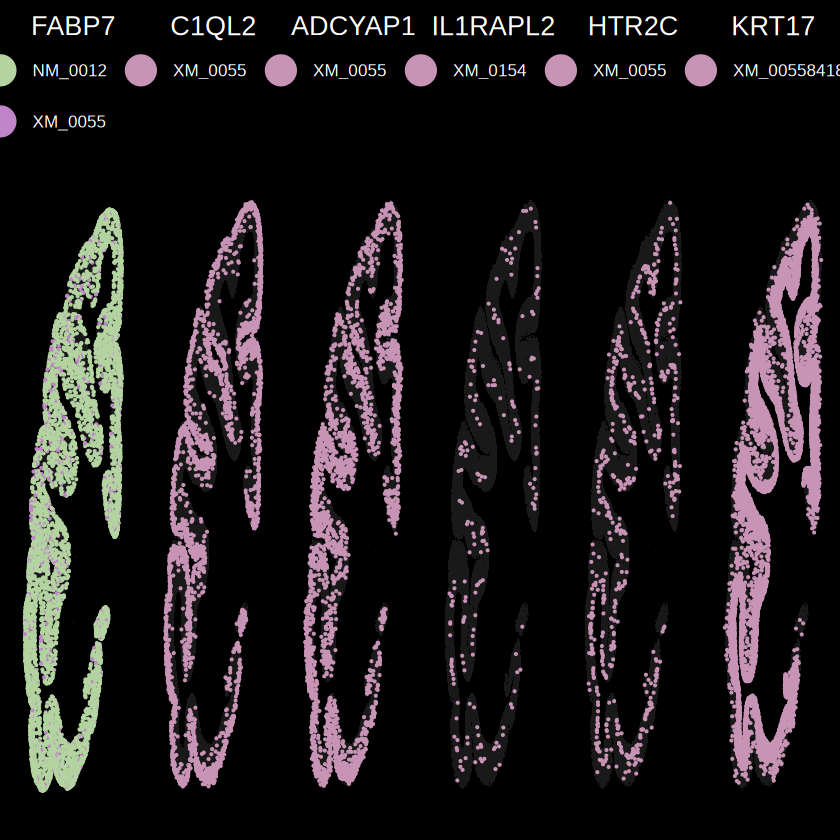

In [445]:
geneexls = c("C1QL2","ADCYAP1","IL1RAPL2","HTR2C","RXFP1")
geneexls = c("FABP7","C1QL2","ADCYAP1","IL1RAPL2","HTR2C","KRT17")
#MarkerSpPlotDensity(fsraw.cor,markdfb,geneexls[4],"XM_005588812.2",edgesdf,100)
# pc1 = MarkerSpPlotBin1(fsraw.cor,backpt,geneexls[2],NULL,NULL,0.2)
# pc1

pcls = list()
for(i in 1:6){
    pcls[[i]] = MarkerSpPlotBin1(fsraw.cor,backpt,geneexls[i],NULL,NULL,0.1)
    pcls[[i]] = pcls[[i]] + ggtitle(geneexls[i])
}
pclst = ggarrange(plotlist = pcls,nrow = 1)
pclst
ggexport(pclst, filename = "result/figure2/Layer_markergene_spatial_plot_24_09_05.pdf", width = 24, height = 6)
# pc1 = MarkerSpPlotBin1(fsraw.cor,backpt,geneexls[5],NULL,NULL,0.2)
# pc1

`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.


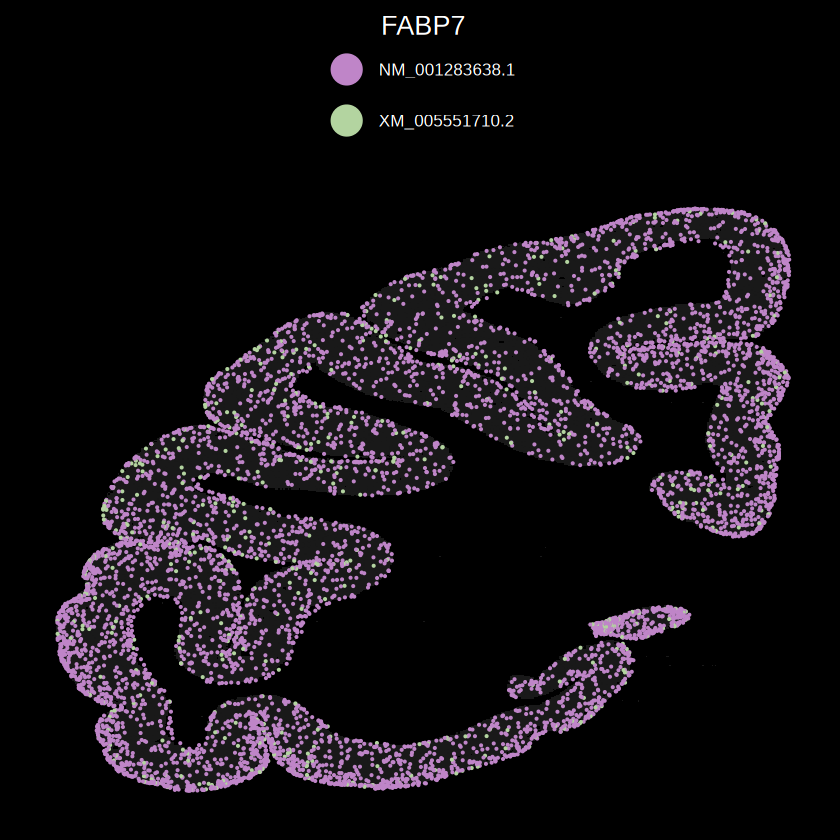

In [450]:
i = 1
pcls[[i]] = MarkerSpPlotBin1(fsraw.cor,backpt,geneexls[i],NULL,NULL,0.1)
pcls[[i]] = pcls[[i]] + ggtitle(geneexls[i])
pcls[[i]]

file saved to result/figure2/Layer_markergene_spatial_plot_24_09_05.pdf



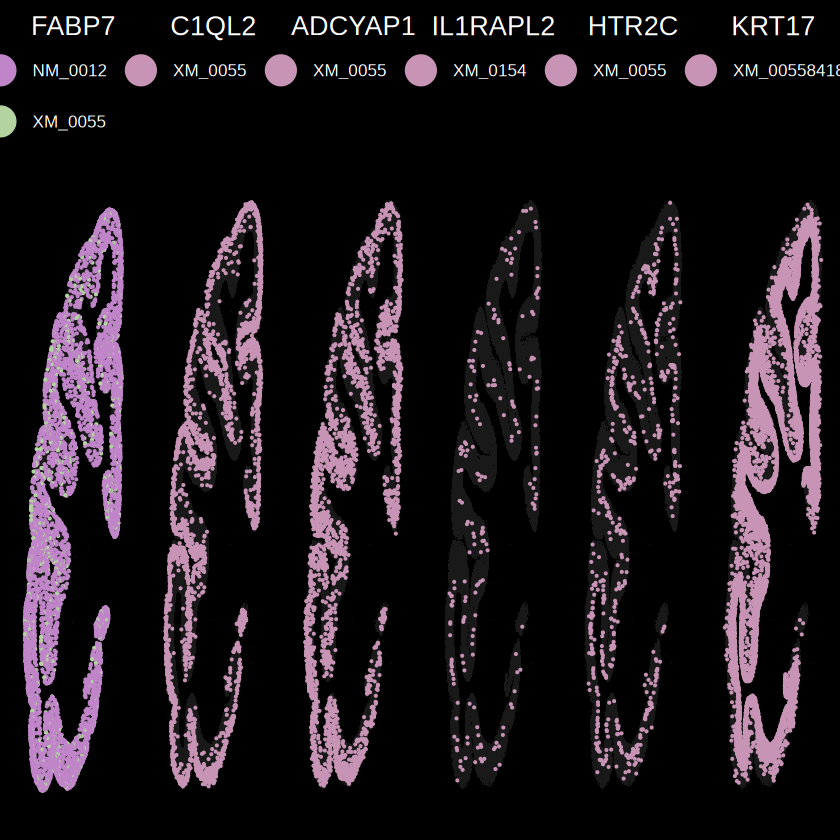

In [451]:
pclst = ggarrange(plotlist = pcls,nrow = 1)
pclst
ggexport(pclst, filename = "result/figure2/Layer_markergene_spatial_plot_24_09_05.pdf", width = 24, height = 6)

##### multiple isoform gene marker case plot

In [105]:
transt.sp = fsraw.cor[fsraw.cor$layer %in% paste0("l",1:6),] %>% group_by(layer, region, gene_id,transcript_id) %>% 
    summarise(transcount = length(unique(readid)))
transt.sp$transgroup = paste0(transt.sp$gene_id,"-",transt.sp$transcript_id)
transt.sp$cellname = paste0(transt.sp$layer,"-",transt.sp$region)

`summarise()` has grouped output by 'layer', 'region', 'gene_id'. You can
override using the `.groups` argument.


In [115]:
head(mkly)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
SNAP25,1.192707e-305,-2.037332,0.965,1.000,6.768136e-301,l1,SNAP25
GFAP,1.988980e-250,3.325589,0.962,0.791,1.128667e-245,l1,GFAP
LOC102130415,5.406137e-250,3.319324,0.962,0.796,3.067766e-245,l1,LOC102130415
BambuGene90232,1.985125e-235,-2.006152,0.797,0.994,1.126479e-230,l1,BambuGene90232
CHN1,2.483550e-231,-1.868847,0.845,0.996,1.409315e-226,l1,CHN1
LMO4,3.217013e-213,-2.154598,0.505,0.956,1.825526e-208,l1,LMO4


In [117]:
transnumst = fsraw.cor %>% group_by(gene_id) %>% summarise(trannum = length(unique(transcript_id)))
transnumst = transnumst[transnumst$trannum > 1,]
mkly = mkls$layer[mkls$layer$gene %in% transnumst$gene_id,]
mkly = mkly[mkly$p_val_adj < 0.05 & mkly$avg_log2FC>1,]
mkly = mkly %>% group_by(gene) %>% filter(length(unique(cluster)) == 1)
write.csv(mkly,file = "result/figure2/layer_markergene_multiple_isoform_list_24_11_29.csv")

In [106]:
#build case plot srt object
transtmx = dcast(transt.sp,transgroup~cellname,
                   value.var = "transcount",fun.aggregate = sum)
rownames(transtmx) = transtmx$transgroup;transtmx = transtmx[-1]
#length(unique(transt.sp[transt.sp$gene_id %in% genemk,]$transcript_id))
  
SrtBuild = function(transtmx){
    srtt = CreateSeuratObject(transtmx)
    srtt = NormalizeData(srtt)
    srtt = ScaleData(srtt)
    srtt <- FindVariableFeatures(srtt, selection.method = "vst",
                                 nfeatures = 2000)
    srtt <- RunPCA(srtt,
                   features = VariableFeatures(object = srtt))
    # srtt <- FindNeighbors(srtt, dims = 1:20)
    # srtt <- FindClusters(srtt, resolution = 0.5)
    # srtt <- RunUMAP(srtt, dims = 1:10)
    return(srtt)
}
srt.sp = SrtBuild(transtmx)
anlayer = MySplit(colnames(srt.sp),"-",1)
anarea = MySplit(colnames(srt.sp),"-",2)
names(anlayer) = names(anarea) = colnames(srt.sp)
srt.sp$layer = anlayer
srt.sp$area = anarea
Idents(srt.sp) = srt.sp$layer

Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

PC_ 1 
Positive:  CALB1-XM-015454768.1, ARPP19-NM-001283415.1, PCDH8-XM-005585934.2, YJEFN3-XM-005595293.2, HS6ST3-XM-005586119.2, ARPP21-XM-005545496.2, TWIST1-XM-015447650.1, MEPE-XM-005555380.2, SERPINE2-XM-005574442.2, CBLN4-XM-005569388.2 
	   CALB1-NM-001284560.1, HOPX-XM-015450433.1, SPON2-XM-005554262.1, RBP4-XM-005565974.2, HOPX-XM-005555222.2, TESPA1-XM-015430992.1, CUX2-XM-015431531.1, RCN1-XM-005578289.2, CARTPT-XM-005557118.1, FAM84A-XM-005576514.2 
	   WFDC2-XM-005569146.2, ARPP21-XM-005545497.2, C1QL2-XM-005572952.2, ADCYAP1-XM-005587082.2, RASGRF2-XM-005557287.2, PENK-XM-005563359.2, FREM3-XM-005555992.2, CST6-XM-005577196.2, HPCAL1-NM-001283164.1, LOC102122770-XR-282357.2 
Negative:  KRT17-XM-005584188.2,

In [107]:
#multiple isoform gene marker case plot
#case plot
modify_vlnplot <- function(srt.sp.sub, selectedhub) {
    features = rownames(srt.sp.sub)
    features = features[MySplit(features,"-",1) %in% selectedhub]
    
    objp = as.data.frame(srt.sp.sub[["RNA"]]$scale.data)
    objp = objp[features,]
    objp$transid = rownames(objp)
    objp = melt(objp)
    objp$geneid = MySplit(objp$transid,"-",1)
    objp$areatr = MySplit(as.character(objp$variable),"-",1)
    objp$geneid = factor(objp$geneid,levels = unique(selectedhub))
    
    objp = objp[!is.na(objp$geneid),]
    objp = objp[order(objp$geneid),]
    objp = objp %>% group_by(geneid, areatr) %>% filter(length(variable) > 2)
#    objp$areatr = gsub("l","L",objp$areatr)

    ylabedf = objp %>% group_by(geneid) %>% summarise(ymin = min(value),ymax = max(value))
    
    ylabels = list()
    for(i in 1:nrow(ylabedf)){
       ylabels[[i]] = scale_y_continuous(breaks = c(round(ylabedf$ymax[i],2) - 0.1),
                                         limits = c(round(ylabedf$ymin[i],2), round(ylabedf$ymax[i],2) - 0.1))
    }
    objprect = data.frame("areatr" = unique(objp$areatr),value = 1)

    if(nrow(objprect) > 10){
        mycolors = viridis_pal(option = "D")(nrow(objprect))
    }else{
        mycolors = pal_flatui("default")(nrow(objprect))
    }
    mycolors = c(mycolors,mycolors)
    names(mycolors) = c(levels(objp$geneid),unique(objp$areatr))
#    print(mycolors)
    vertical.lines = seq(1.5,nrow(objprect)-0.5,1)
    pi = ggplot(objp) +
      geom_rect(data = objprect,
                aes(xmin = as.numeric(as.factor(areatr))-0.5,xmax = as.numeric(as.factor(areatr))+0.5,ymin = -Inf,ymax = Inf,fill = areatr),
                alpha = 0.2) +
      geom_violin(aes(x = areatr,y = value,fill = geneid,color = transid),size = 0.3,drop = FALSE) +
      geom_boxplot(aes(x = areatr,y = value,color = transid),size = 0.3,fill = "white",width=0.1,cex=0.8,outlier.size = 0.3,drop = FALSE,
                   position = position_dodge(0.9)) +
      geom_vline(xintercept = vertical.lines,lty="dashed", color = "black", linewidth = 0.5) +
      #geom_vline(xintercept = 1.5, lty="dashed", color = "black", linewidth = 0.5)+
      #geom_vline(xintercept = 2.5, lty="dashed", color = "black", linewidth = 0.5)+
      #geom_vline(xintercept = 3.5, lty="dashed", color = "black", linewidth = 0.5)+
      #geom_vline(xintercept = 4.5, lty="dashed", color = "black", linewidth = 0.5)+
      #geom_vline(xintercept = 5.5, lty="dashed", color = "black", linewidth = 0.5)+
      #geom_boxplot(fill = "white",color = "black") +
      # geom_jitter(size = 0.1) +
      facet_grid(geneid~.,scales = "free") + 
      facetted_pos_scales(y = ylabels)+
      scale_color_manual(values = rep("black",length(unique(objp$transid)))) +
      scale_fill_manual(values = mycolors) +
      xlab("") + ylab("") +
      scale_x_discrete(
      expand = c(0,0)
      ) +
      # scale_y_continuous(breaks = custom_breaks) +
      theme_pubr() +
      theme(strip.background = element_blank(), 
            strip.text.x = element_blank(), 
            legend.position = "none",
            panel.spacing = unit(0,'lines'),
            panel.border = element_rect(fill = NA),
            strip.text.y = element_text(angle = 0,size = 12),
            axis.text.x = element_text(size = 12))
    pi
    return(pi)
}

In [119]:
head(transt.sp.hub)

layer,region,gene_id,transcript_id,transcount,transgroup,cellname
<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>
l1,1|2,FBXO15,FBXO15-WeiLab-1,9,FBXO15-FBXO15-WeiLab-1,l1-1|2
l1,1|2,FBXO15,XM_005586451.2,1,FBXO15-XM_005586451.2,l1-1|2
l1,1|2,HPCAL1,NM_001283164.1,8,HPCAL1-NM_001283164.1,l1-1|2
l1,1|2,HPCAL1,XM_005576572.2,103,HPCAL1-XM_005576572.2,l1-1|2
l1,1|2,NTNG1,XM_005542544.2,2,NTNG1-XM_005542544.2,l1-1|2
l1,1|2,PLP1,NM_001283166.1,2,PLP1-NM_001283166.1,l1-1|2


[1] "FABP7-NM_001283638.1"   "FABP7-XM_005551710.2"   "FBXO15-FBXO15-WeiLab-1"
 [4] "FBXO15-XM_005586451.2"  "HPCAL1-NM_001283164.1"  "HPCAL1-XM_005576572.2" 
 [7] "MAL-MAL-WeiLab-1"       "MAL-NM_001284558.1"     "NTNG1-XM_005542544.2"  
[10] "SMYD2-SMYD2-WeiLab-1"   "SMYD2-XM_005540829.2"   "NTNG1-XM_005542550.2"

Using transid as id variables

Warning message:
"Duplicated aesthetics after name standardisation: size"
Warning message in geom_boxplot(aes(x = areatr, y = value, color = transid), size = 0.3, :
"Ignoring unknown parameters: `drop`"


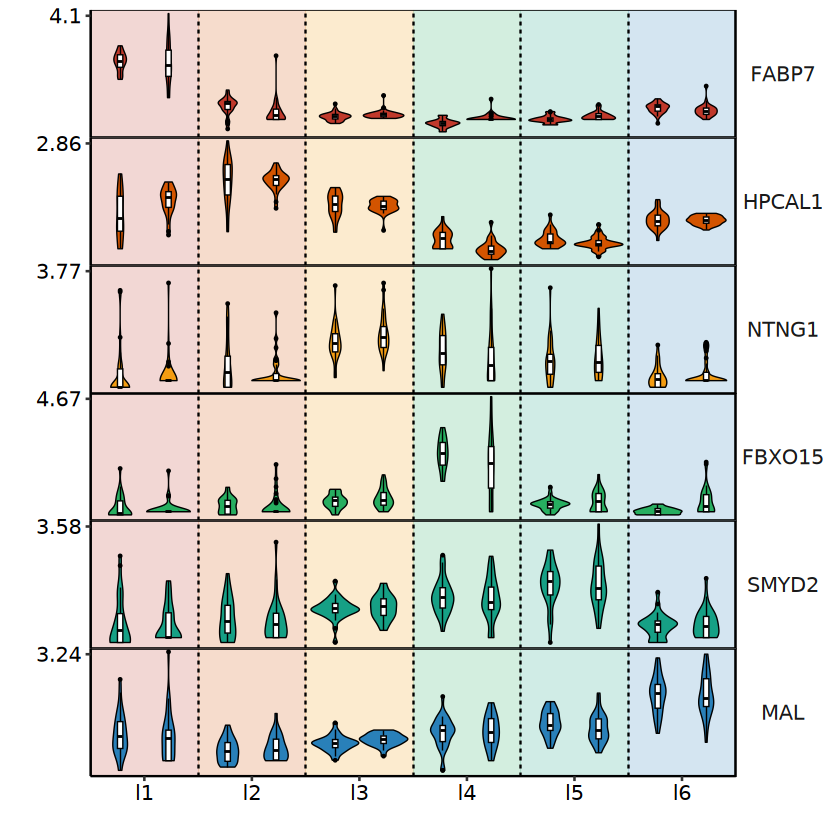

In [133]:
#selectedhub = c("FABP7","CALB1","SNCG","CXXC4","SMYD2","PLP1")
selectedhub = c("FABP7","HPCAL1","NTNG1","FBXO15","SMYD2","MAL")
#"SEMA3B","HPCAL1","NTNG1","FBXO15"
#selectedhub = c("FABP7","C1QL2","ADCYAP1","IL1RAPL2","HTR2C","KRT17")
#selectedhub = c("FABP7","CALB1","SNCG","FBXO15","SMYD2","CNP")
  # selectedhub = c("APOE","CALB1","NEFM","SCN1B","SMYD2","PLP1")
transt.sp.hub = transt.sp[transt.sp$gene_id %in% selectedhub,]
transt.sp.hub = transt.sp.hub %>% group_by(gene_id,transcript_id) %>% 
            mutate(totalt = sum(transcount)) %>% 
            group_by(gene_id) %>% mutate(totalg = sum(transcount),rate = totalt/totalg)
transt.sp.hub = transt.sp.hub[transt.sp.hub$rate > 0.05,]
#transt.sp.hub
transidsub = unique(transt.sp.hub$transgroup)
transidsub
transidsub = gsub(transidsub,pattern = "_",replacement = "-")
srt.sp.sub = subset(srt.sp,features = transidsub)

pc.box = modify_vlnplot(srt.sp.sub, selectedhub)
pc.box
#ggexport(pc.box,filename = "processed/figures/f2/multiple_isoform_marker_case_24_01_28.pdf",width = 6,height = 5)


In [153]:
nrow(fsraw.cor[fsraw.cor$gene_id == "NTNG1",])
transid = unique(fsraw.cor[fsraw.cor$gene_id == "NTNG1",]$transcript_id)
transid = c('XM_005542544.2','XM_005542550.2')
pci = SpCasePlot(fsraw.cor,"NTNG1",transid,backpt,1,0.2)
ggexport(pci,
        filename = "result/figure2/marker_gene_molecular_spatial_point_NTNG1_24_12_12.pdf",
        width = 4,height = 6)

[1] 1532

Warning message in grid.newpage():
"Cannot open temporary file '/tmp/RtmpL9N5O6/pdfa50036fc96' for compression (reason: No such file or directory); compression has been turned off for this device"
file saved to result/figure2/marker_gene_molecular_spatial_point_NTNG1_24_12_12.pdf



file saved to result/figure2/marker_gene_molecular_spatial_point_24_11_29.pdf



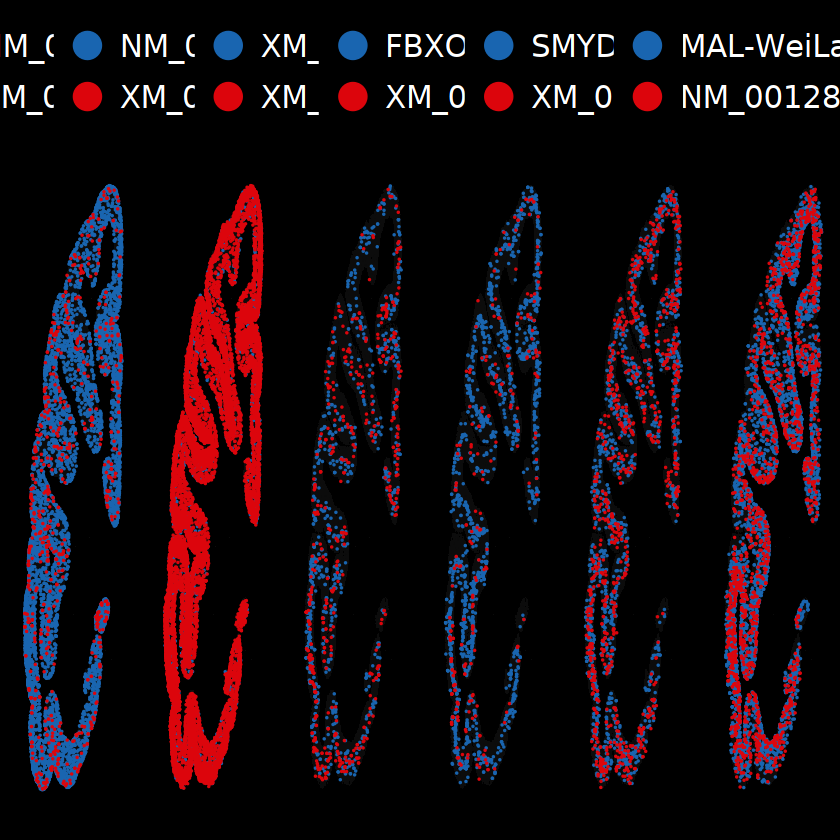

In [313]:
selectedhub = c("FABP7","HPCAL1","NTNG1","FBXO15","SMYD2","MAL")
transid = unique(transt.sp.hub$transcript_id)
plmkt.sp = list()
for (i in 1:length(selectedhub)) {
    plmkt.sp[[i]] = SpCasePlot(fsraw.cor,selectedhub[i],transid,backpt,0.7)
    #plmkt.sp[[i]] = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,selectedhub[i],NULL,NULL)
}
plmkt.spt = ggarrange(plotlist = plmkt.sp,nrow = 1)
plmkt.spt
ggexport(plmkt.spt,
        filename = "result/figure2/marker_gene_molecular_spatial_point_24_11_29.pdf",
        width = 24,height = 6)

In [13]:
ggexport(pc.box,filename = "result/figure2/multiple_isoform_marker_case_24_10_17.pdf",width = 6,height = 5)

file saved to result/figure2/multiple_isoform_marker_case_24_10_17.pdf



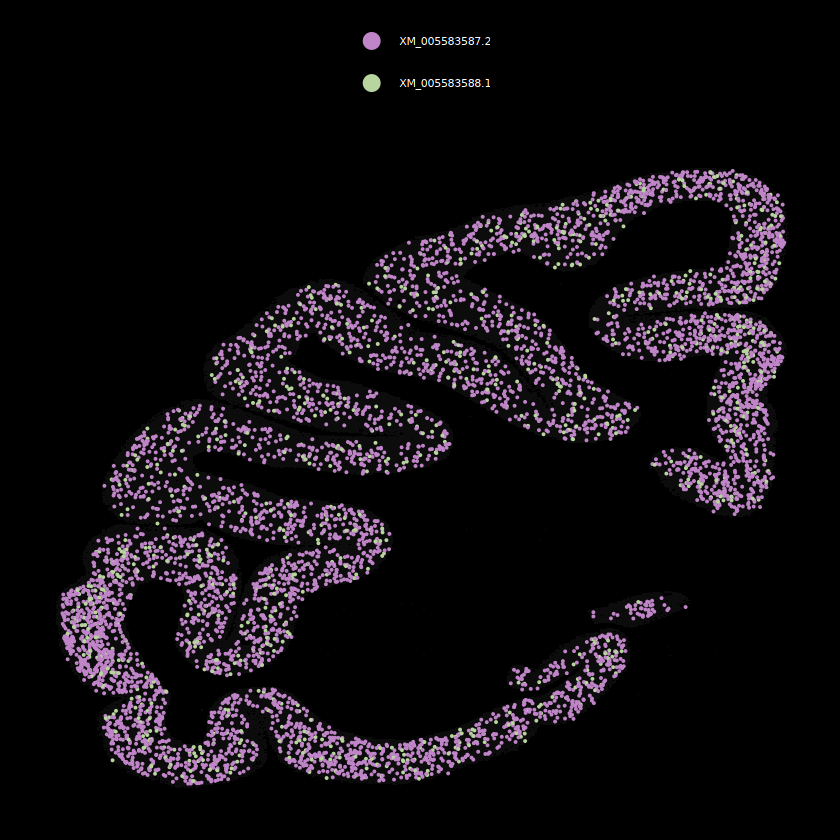

In [506]:
#fsrawdp.cellf = fsrawdp.cellf[fsrawdp.cellf$transcript_id %in% genetrstf$transcript_id,]
plmkt.spi = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,"ATP5G1",NULL,NULL)
plmkt.spi

In [149]:
pref = qread("../ref/area_figure_an.qs")

fsrawdp.cell = fsrawdp[fsrawdp$class != "",] %>% 
    group_by(cell_id,gene_id,transcript_id,class,subclass) %>%
    summarise(x = mean(x),y = mean(y),
              readnum = length(unique(readid)))
fsrawdp.cellb = qread("data//reads_full_anotation/longread_cell_position_24_03_29.qs")
#fsrawdp.cellb = unique(fsrawdp.cell[c("cell_id","x","y")])
#qsave(fsrawdp.cellb,file = "data//reads_full_anotation/longread_cell_position_24_03_29.qs")
head(fsrawdp.cellb)
# npclfdp.cell = npclfdp.cell[npclfdp.cell$transcript_id %in%
#                               genetrst$transcript_id,]

`summarise()` has grouped output by 'cell_id', 'gene_id', 'transcript_id',
'class'. You can override using the `.groups` argument.


cell_id,x,y
<dbl>,<dbl>,<dbl>
1,51192,77807
1,48966,77807
1,8427,77819
1,51208,77803
1,48984,77801
1,51181,77807


In [119]:
fsrawdp.cell = fsrawdp.cell %>% group_by(cell_id,gene_id) %>% mutate(readnumg = sum(readnum),transprop = readnum/readnumg)
summary(fsrawdp.cell$transprop)
fsrawdp.cellf = fsrawdp.cell[fsrawdp.cell$transprop > 0.8,]
nrow(fsrawdp.cell)
nrow(fsrawdp.cellf)
fsrawdp.cellf = fsrawdp.cellf[fsrawdp.cellf$transcript_id %in% genetrstf$transcript_id,]
nrow(fsrawdp.cellf)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
0.01351 1.00000 1.00000 0.96090 1.00000 1.00000 

[1] 24698935

[1] 22852369

[1] 22356111

In [139]:
MarkerSpPlotDensity = function(fsrawdp,markdfb,geneex,transid,edgesdf,ra){
    #ra = 200   
    markdf = fsrawdp[fsrawdp$gene_id == geneex,]
    markdf$xid = as.integer(markdf$x/(ra*2)) * ra * 2 + ra
    markdf$yid = as.integer(markdf$y/(ra*2)) * ra * 2 + ra
    markdf$blockid = paste0(markdf$xid,"_", markdf$yid)
    
    markdf = markdf %>% 
      group_by(xid,yid,blockid,transcript_id) %>% 
      summarise(count = length(unique(readid)))

    pmkptls = list()
    for(i in 1:length(transid)){
        transi = transid[i]
        markdfi = markdf[markdf$transcript_id == transi,]
        markdfb = markdfb[!markdfb$blockid %in% markdfi$blockid,]
        markdfb$transcript_id = transi
        markdfb$count = 0
        edgesdf$transcript_id = unique(markdfi$transcript_id)
        cml = intersect(colnames(markdfb),colnames(markdfi))
        markdfi = rbind(markdfb[,cml],markdfi[,cml])
        pmkpti = ggplot() +
          geom_tile(data = markdfi,
                 aes(xid,yid,fill = log(count+1))) + 
        geom_segment(data = edgesdf, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 0.1,
                   color = "grey") + theme_void() +
      #scale_size(range = c(0.05,0.1)) +
      #facet_wrap(~transcript_id,nrow = 2) +
          theme_void() + 
          ggtitle(transi) +
      #scale_color_manual(values = mycolor) +
      #scale_fill_gradient(low = "blue", high = "red")+
          scale_fill_viridis() +
          theme_presentation() + 
          theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 10)) +
          guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
          scale_y_reverse() + scale_x_reverse()
        pmkptls[[i]] = pmkpti
    }
    pmkpt = ggarrange(plotlist = pmkptls,nrow = 1,common.legend = T)
    return(pmkpt)

}

In [116]:
edgesdfl = pref$layeredges
edgesdfl = edgesdfl[edgesdfl$areaid %in% paste0("l",1:6),]
head(edgesdfl)

,ind1,ind2,x1,y1,x2,y2,mx1,my1,mx2,my2,bp1,bp2,areaid
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1385,7285,15438,46436,64705,46518,64693,46540.49,65132.87,46469.34,64646.63,0,0,l1
1386,16616,14951,46175,64676,46269,64674,46231.50,65121.50,46222.69,64707.37,0,0,l1
1387,33735,16616,46030,64696,46175,64676,46208.15,65451.96,46115.36,64779.21,0,0,l1
1388,3003,20924,46995,64656,46782,64591,46877.42,64659.80,46837.73,64789.86,0,0,l1
1389,4687,20924,46649,64706,46782,64591,46837.73,64789.86,46793.15,64738.31,0,0,l1
1390,32454,32318,47230,64665,47072,64696,47156.98,64710.96,47480.06,66357.65,0,0,l1


In [120]:
geneex = selectedhub[5]
fsraw.cor[fsraw.cor$gene_id == geneex, ] %>% group_by(transcript_id) %>% summarise(count = length(readid))
#transid = c("NM_001283638.1","XM_005551710.2")
#transid = c("NM_001284560.1","XM_015454768.1")

transcript_id,count
<chr>,<int>
XM_015429942.1,2045
XM_015429945.1,2
XM_015429946.1,5
XM_015429947.1,10


`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.


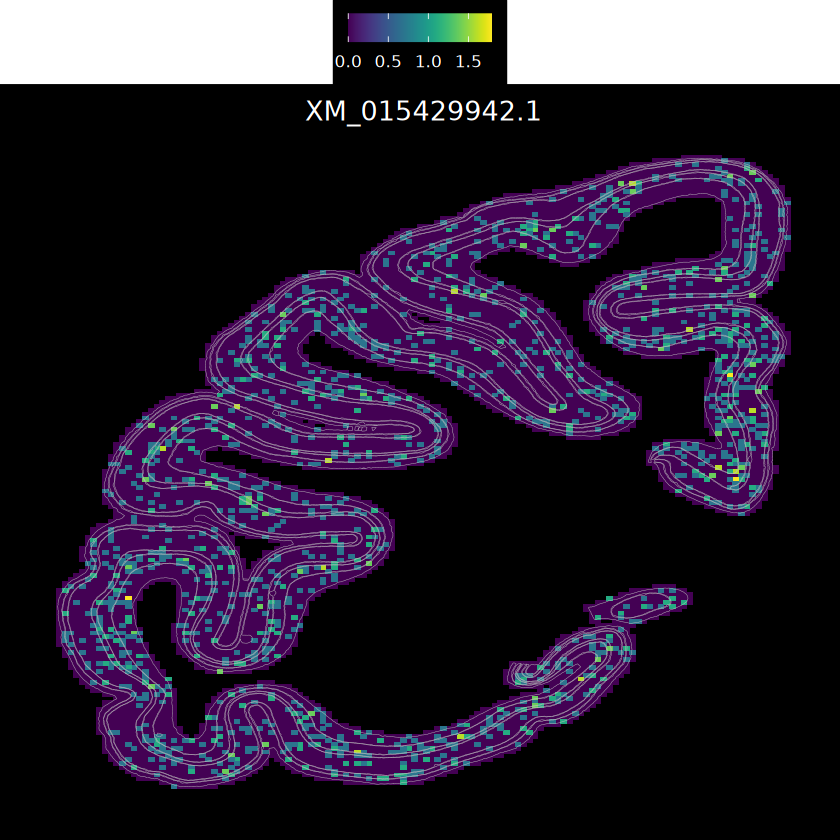

In [140]:
selectedhub = c("FABP7","CALB1","TESPA1","CXXC4","SULF2","SLC44A1")
geneex = selectedhub[5]
transid = c("XM_015429942.1")
pmkpt = MarkerSpPlotDensity(fsraw.cor,markdfb,geneex,transid,edgesdfl,200)
pmkpt

file saved to result/figure2/marker_gene_molecular_spatial_point_24_05_01.pdf



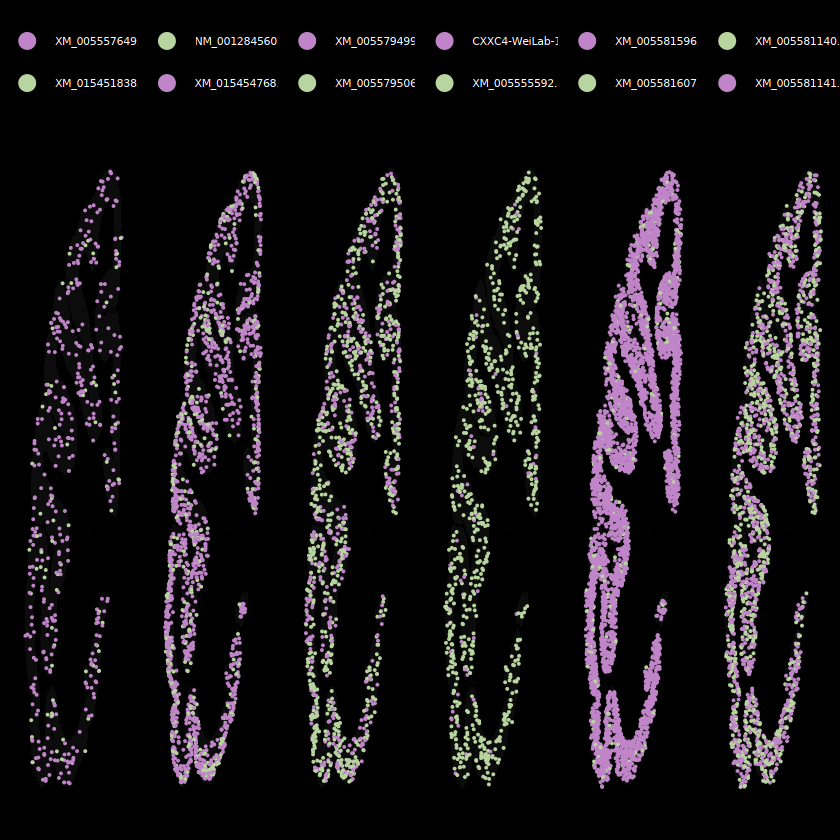

In [498]:
selectedhub = c("FABP7","CALB1","TESPA1","CXXC4","SULF2","SLC44A1")
plmkt.sp = list()
for (i in 1:length(selectedhub)) {
    plmkt.sp[[i]] = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,selectedhub[i],NULL,NULL)
}
plmkt.spt = ggarrange(plotlist = plmkt.sp,nrow = 1)
plmkt.spt
ggexport(plmkt.spt,
        filename = "result/figure2/marker_gene_molecular_spatial_point_24_05_01.pdf",
        width = 24,height = 6)

In [86]:
#data prepare

MarkerGenePreAna = function(fsrawdp,mkls.at){
    colnames(mkls.at)[6:7] = c("areatr","gene_id")
    mkls.at = mkls.at[mkls.at$avg_log2FC > 0.5 & mkls.at$p_val_adj < 0.05 & mkls.at$pct.1 > 0.25, ]
    length(unique(mkls.at$gene))

    #stat gene for filtering transcript
    genetrst.at = fsrawdp %>% group_by(areatr,gene_id) %>% 
        mutate(readnumt = length(unique(readid))) %>% 
        group_by(areatr,gene_id,transcript_id)  %>% 
        summarise(readnum = length(unique(readid)),
                  readnumt = readnumt[1],
                  readrate = readnum/readnumt)

    genetrst.atf = genetrst.at[genetrst.at$readrate > 0.05,]
    genetrst.atf = genetrst.atf %>% group_by(areatr,gene_id) %>% mutate(transnum = length(unique(transcript_id)))

    #filter gene
    fsgenest.at = fsrawdp %>% group_by(areatr, gene_id) %>% summarise(readnum = length(unique(readid)))
    fsgenest.atf = fsgenest.at[fsgenest.at$readnum > 100,]
    mkls.atf = mkls.at[paste0(mkls.at$areatr,mkls.at$gene) %in% paste0(fsgenest.atf$areatr,fsgenest.atf$gene_id),]

    mkls.at.st = merge(mkls.atf, genetrst.atf, by = c("areatr","gene_id"))
    mkls.at.st = mkls.at.st %>% group_by(areatr, gene_id) %>% summarise(mrate = max(readrate),transnum = transnum[1],readnumt = readnumt[1])
    mkls.at.st = mkls.at.st[order(mkls.at.st$areatr,-mkls.at.st$readnumt),]
    mkls.at.st = mkls.at.st %>% group_by(areatr) %>% mutate(geneorder = as.numeric(factor(gene_id,levels = unique(gene_id))) )

    #build case plot srt object
    transt.sp.at = fsrawdp %>% group_by(areatr, chunk, gene_id, transcript_id) %>% 
        summarise(transcount = length(unique(readid)))
    transt.sp.at$transgroup = paste0(transt.sp.at$gene_id,"-",transt.sp.at$transcript_id)
    transt.sp.at$cellname = paste0(transt.sp.at$areatr,"-",transt.sp.at$chunk)
    transtmx.at = dcast(transt.sp.at,transgroup~cellname,
                       value.var = "transcount",fun.aggregate = sum)
    rownames(transtmx.at) = transtmx.at$transgroup;transtmx.at = transtmx.at[-1]
  
    SrtBuild = function(transtmx){
        srtt = CreateSeuratObject(transtmx)
        srtt = NormalizeData(srtt)
        srtt = ScaleData(srtt)
        srtt = FindVariableFeatures(srtt, selection.method = "vst",
                                 nfeatures = 2000)
        return(srtt)
    }
    srt.sp.at = SrtBuild(transtmx.at)
    anareatr = MySplit(colnames(srt.sp.at),"-",1)
    anchunk = MySplit(colnames(srt.sp.at),"-",2)
    names(anareatr) = names(anchunk) = colnames(srt.sp.at)
    srt.sp.at$areatr = anareatr
    srt.sp.at$chunk = anchunk
    Idents(srt.sp.at) = srt.sp.at$areatr
    return(list("transt.sp" = transt.sp.at,"srt.sp" = srt.sp.at,"genetrstf" = genetrst.atf,"mkls.st" = mkls.at.st,"mklsf" = mkls.atf))    
}



`summarise()` has grouped output by 'areatr', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk', 'gene_id'. You can
override using the `.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at -2.2697"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 0.5063"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric,

areatr,gene_id,mrate,transnum,readnumt,geneorder
<fct>,<chr>,<dbl>,<int>,<int>,<dbl>
1|2,LOC102128139,0.9993973,1,6637,1
1|2,CCK,0.9230147,2,6183,2
1|2,PTGDS,0.9995974,1,4968,3
1|2,LOC102145066,1.0000000,1,4034,4
1|2,ATP5J2,0.9491779,1,3345,5
1|2,OAZ1,1.0000000,1,3251,6


In [ ]:
fsrawdp$areatr = fsrawdp$region
fsrawdp$chunk = fsrawdp$layer
mkls.at = mkls$area

mkgan.region = MarkerGenePreAna(fsrawdp,mkls.at)
head(mkgan.region$mkls.st)

Warning message:
"Removed 1 row containing non-finite outside the scale range (`stat_density()`)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"
Warning message in max(ids, na.rm = TRUE):
"no non-missing arguments to max; returning -Inf"


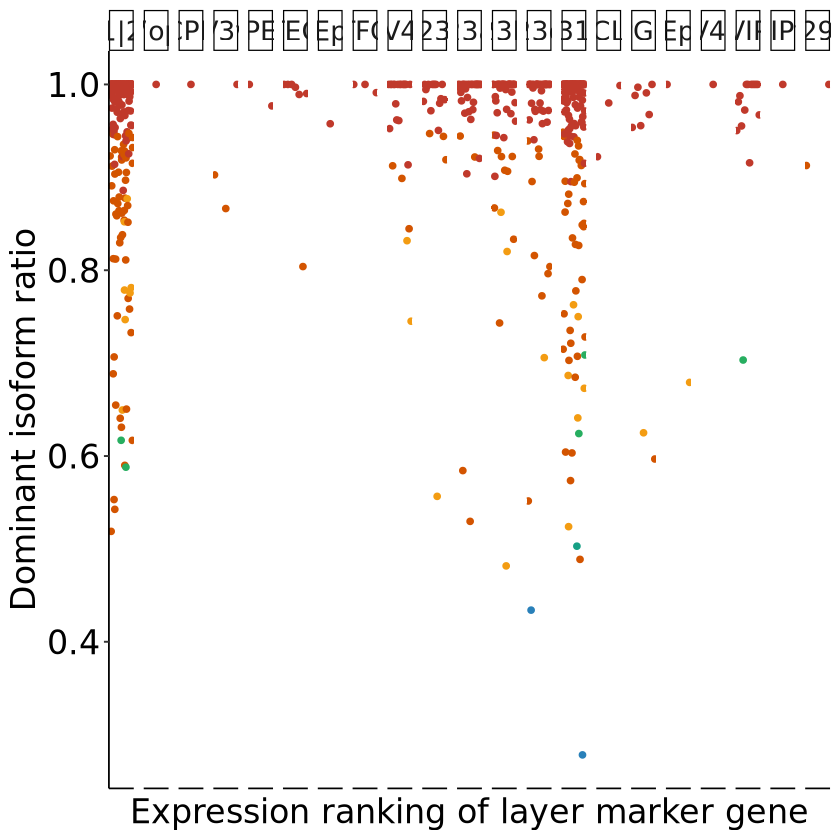

`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.


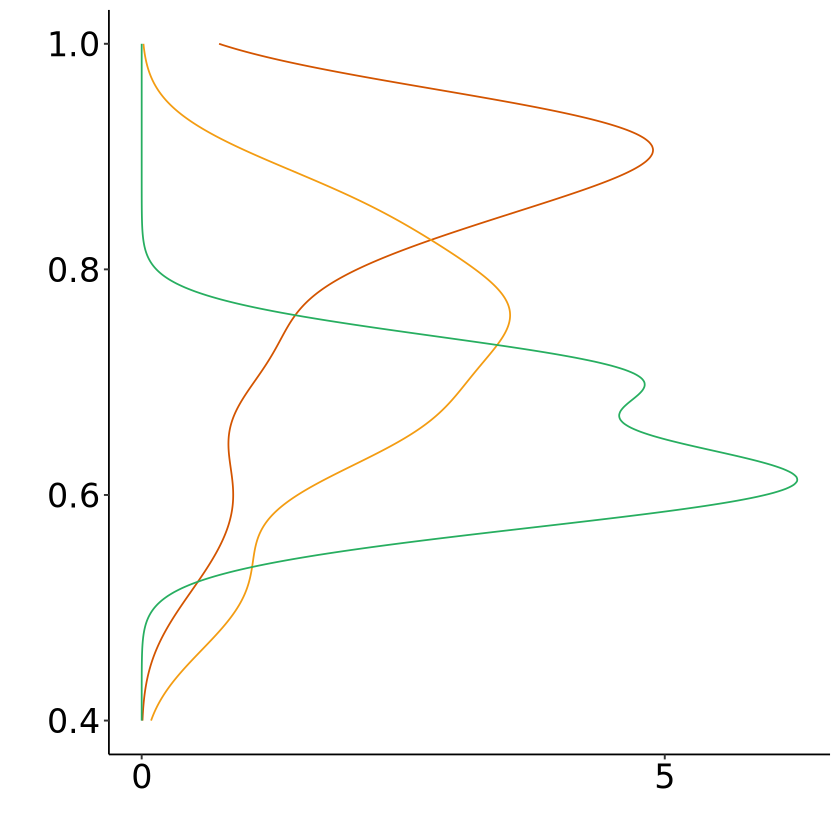

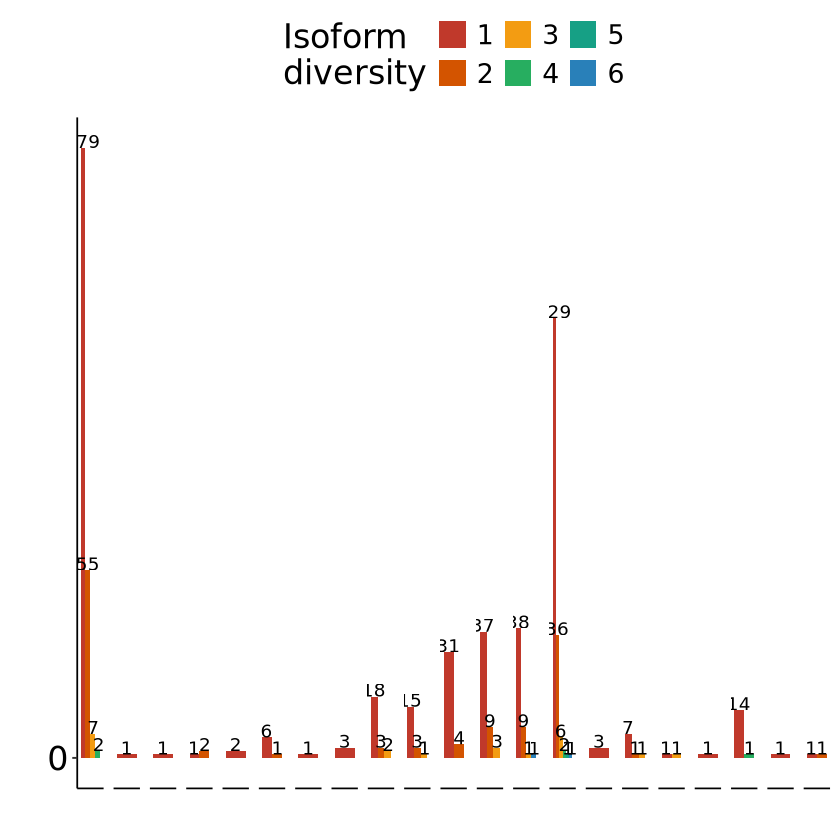

In [77]:
mkls.sti = mkgan.region$mkls.st
p1.1 = ggplot(mkls.sti,aes(x = geneorder,y = mrate,color = as.character(transnum))) + geom_point() +
facet_grid(~areatr,scales = "free") + theme_pubr() + 
theme(axis.text.x = element_blank(),axis.ticks.x = element_blank(),strip.background = element_rect(fill = NA)) +
scale_color_flatui() + labs(x = "Expression ranking of layer marker gene", y = "Dominant isoform ratio",color = "Isoform diversity") +
theme(legend.position = "none",text = element_text(size = 20))
p1.1
mkls.sti$isoformdiv = factor(mkls.sti$transnum,levels = 1:max(mkls.sti$transnum))
mycolor = pal_flatui("default")(length(unique(mkls.sti$isoformdiv)))
p1.2 = ggplot(mkls.sti[mkls.sti$transnum > 1,],aes(x = mrate,color = isoformdiv)) + geom_density() + 
scale_color_manual(values = mycolor[-1]) + 
theme_pubr() + labs(x = "",y = "",color = "Isoform\ndiversity") + theme(legend.position = "none",text = element_text(size = 20)) + 
 scale_x_continuous(limits = c(0.4,1)) + scale_y_continuous(breaks = c(0,5)) +
coord_flip()
p1.2
mkls.sti2 = mkls.sti %>% group_by(areatr,transnum) %>% summarise(genenum = length(unique(gene_id)))
p1.3 = ggplot(mkls.sti2,
              aes(x = areatr,fill = as.character(transnum),y = genenum)) + geom_bar(stat = "identity",position = "dodge") +
geom_text(aes(label = genenum),position = position_dodge(1),vjust = 0) +
scale_fill_flatui() + labs(x = "",y = "",fill = "Isoform\ndiversity") +
scale_y_continuous(breaks = c(0,200)) +
facet_grid(~areatr,scales = "free") +
theme_pubr() + 
theme(legend.position = "top",axis.text.x = element_blank(),axis.ticks.x = element_blank(),
      strip.background = element_rect(fill = NA,color = NA),
      strip.text = element_blank(),text = element_text(size = 20))
p1.3

areatr,genenum
<chr>,<int>
1|2,5580
23a,1103
23b,1899
23c,2850
29,397
30,837
31,1229
7op,3039
AI,869


`summarise()` has grouped output by 'areatr', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.


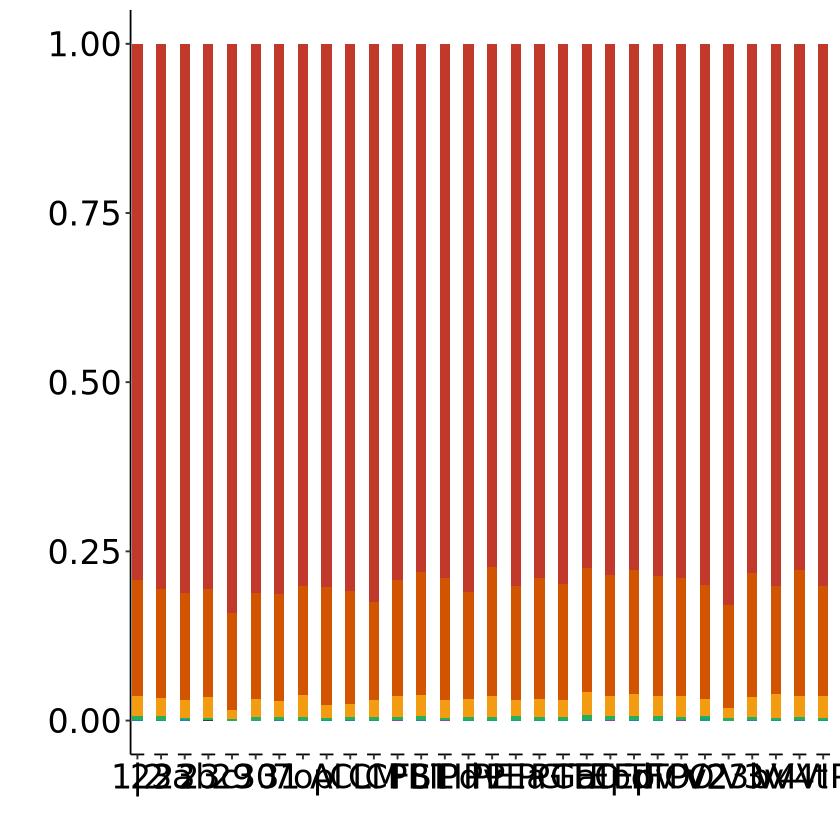

In [78]:
fsrawdp = fsrawdp[fsrawdp$layer %in% paste0("l",1:6),] %>% group_by(areatr,gene_id) %>% mutate(treadnum = length(unique(readid)))
fsrawdpf = fsrawdp[fsrawdp$treadnum > 100,]
fsrawdpf %>% group_by(areatr) %>% summarise(genenum = length(unique(gene_id)))
fsrawdpf.down = fsrawdpf %>% group_by(areatr,gene_id) %>% 
    mutate(randomid = sample(x = 1:n(),size = n()))
fsrawdpf.down = fsrawdpf.down[fsrawdpf.down$randomid %in% 1:100,]
fsrawdpf.down.st = fsrawdpf.down %>% group_by(gene_id) %>% summarise(areanum = length(unique(layer)))
genetrst.down = fsrawdpf.down %>% group_by(areatr,gene_id) %>% 
    mutate(readnumt = length(unique(readid))) %>% 
    group_by(areatr,gene_id,transcript_id)  %>% 
    summarise(readnum = length(unique(readid)),
              readnumt = readnumt[1],
              readrate = readnum/readnumt)
#genetrst.down = genetrst.down[paste0(genetrst.down$areatr,genetrst.down$gene_id) %in% paste0(mkls.layerf$areatr,mkls.layerf$gene_id),]
genetrst.downf = genetrst.down[genetrst.down$readrate > 0.05,]
genetrst.downf.st = genetrst.downf %>% group_by(areatr,gene_id) %>% summarise(transnum = length(unique(transcript_id)))
mkls.down.st = genetrst.downf.st %>% group_by(areatr,transnum) %>% summarise(genenum = length(unique(gene_id)))
p1.5 = ggplot(mkls.down.st,
              aes(x = areatr,fill = as.character(transnum),y = genenum)) + geom_bar(stat = "identity",position = "fill") +
scale_fill_flatui() + labs(x = "",y = "",fill = "Isoform\ndiversity") +
facet_grid(~areatr,scales = "free") +
theme_pubr() + 
theme(legend.position = "none",
      strip.background = element_rect(fill = NA,color = NA),
      strip.text = element_blank(),text = element_text(size = 20))
p1.5

In [79]:
ggexport(p1.5,filename = "result/figure2/gene_isoform_diversity_per100_reads_region_24_03_30.pdf",width = 10,height = 3)

file saved to result/figure2/gene_isoform_diversity_per100_reads_region_24_03_30.pdf



In [62]:
mkls.sti = mkgan.region$mkls.st
mklsfi = mkgan.region$mklsf

#select top
hubgene = mkls.sti[mkls.sti$transnum > 1 & mkls.sti$transnum < 4 & mkls.sti$mrate < 0.9 & mkls.sti$readnumt > 100 ,]
mklsfi.hub = mklsfi[mklsfi$gene_id %in% hubgene$gene_id,]
mklsfi.hub = mklsfi.hub %>% group_by(areatr) %>% top_n(wt = avg_log2FC, n = 3)
mklsfi.hub

selectedhub = c("PLLP","LOC102131354","KXD1","MRPS12","ARPP19","TSTD1","FADS3","SLC44A1","TPM1","MOBP")
#mkls.layer.st[mkls.layer.st$gene_id %in% selectedhub,]

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,areatr,gene_id
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
3.757238e-60,0.8375792,0.872,0.759,2.132082e-55,1|2,B2M
1.389393e-11,0.7207615,0.295,0.226,7.884250e-07,1|2,KLHDC9
2.882080e-08,0.7636790,0.426,0.366,1.635465e-03,1|2,PLLP
1.347564e-08,0.5164339,0.426,0.304,7.646885e-04,V3v,LOC102131354
3.053013e-16,0.5033023,0.288,0.196,1.732463e-11,TEO,KXD1
4.559371e-09,0.5481180,0.580,0.395,2.587260e-04,V4,MRPS12
1.407791e-07,0.6347776,0.596,0.427,7.988653e-03,V4,CYSTM1
1.418076e-07,0.5485946,0.645,0.487,8.047014e-03,V4,LOC102143138
6.414934e-13,0.7362893,0.970,0.900,3.640219e-08,v23b,NTRK2


Using transid as id variables

Warning message:
"Duplicated aesthetics after name standardisation: size"
Warning message in geom_boxplot(aes(x = areatr, y = value, color = transid), size = 0.3, :
"Ignoring unknown parameters: `drop`"
Warning message:
"Cannot compute density for groups with fewer than two datapoints."
Warning message:
"Cannot compute density for groups with fewer than two datapoints."
Warning message:
"Cannot compute density for groups with fewer than two datapoints."
Warning message:
"Cannot compute density for groups with fewer than two datapoints."
Warning message:
"Cannot compute density for groups with fewer than two datapoints."
Warning message:
"Cannot compute density for groups with fewer than two datapoints."


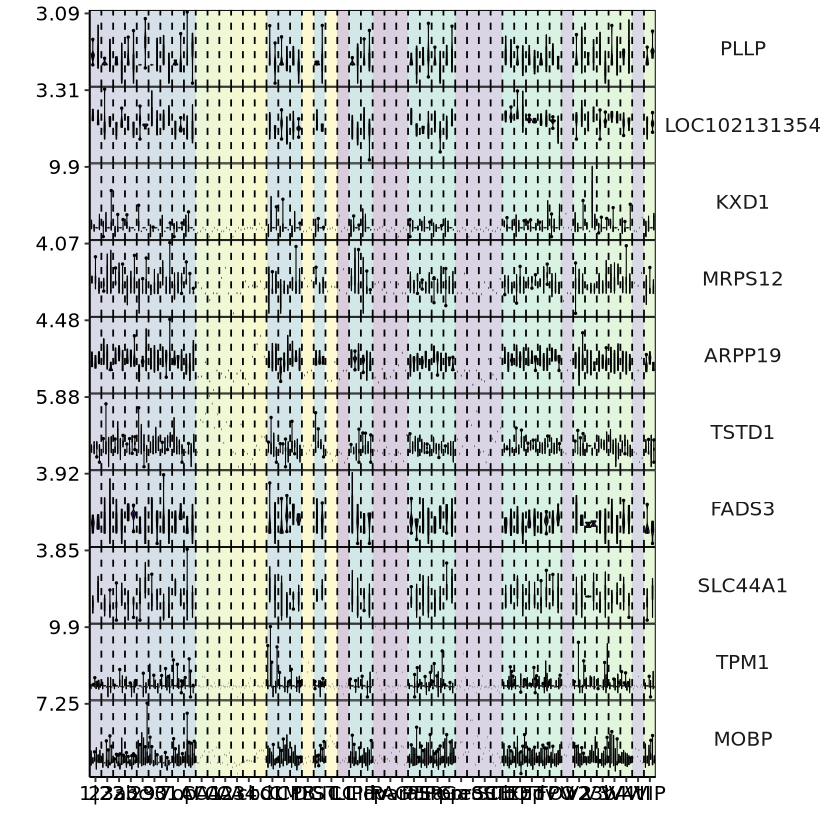

In [73]:
transt.spi = mkgan.region$transt.sp
srt.spi = mkgan.region$srt.sp
genetrstfi = mkgan.region$genetrstf

transt.sp.hub = transt.spi[transt.spi$gene_id %in% selectedhub & transt.spi$transcript_id %in% genetrstfi$transcript_id,]
transidsub = unique(transt.sp.hub$transgroup)
transidsub = gsub(transidsub,pattern = "_",replacement = "-")
srt.sp.sub = subset(srt.spi,features = transidsub)
pc.box2 = modify_vlnplot(srt.sp.sub, selectedhub)
pc.box2

In [ ]:
fsrawdp.cellf = fsrawdp.cell[fsrawdp.cell$transcript_id %in% genetrstf$transcript_id,]
plmkt.sp = list()
for (i in 1:length(selectedhub)) {
    plmkt.sp[[i]] = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,selectedhub[i])
}
plmkt.spt = ggarrange(plotlist = plmkt.sp,nrow = 1)
plmkt.spt

### DTU analysis

#### DTU number statistic 

In [316]:
# isosigls = qread(file = "data/dtu_analysis/dtu_isoform_ls_24_03_28.qs")
# names(isosigls)
isosigi = isosigls$lobe
#isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.3,]
unique(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.12 & isosigi$genecount > 500,]$gene_id)
isosigi = isosigls$lobe
summary(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.2,]$genecount)
isosigi = isosigls$layer
summary(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.2,]$genecount)
isosigi = isosigls$lobe
length(unique(isosigi[isosigi$sig != "N",]$gene_id))
length(unique(isosigi[isosigi$sig != "N",]$transcript_id))
isosigi = isosigls$layer
length(unique(isosigi[isosigi$sig != "N",]$gene_id))
length(unique(isosigi[isosigi$sig != "N",]$transcript_id))

[1] "DOCK3"   "HERC1"   "KCNIP4"  "PPP2R2B" "SEC13"   "SETBP1"  "TENM2"  
[8] "UBQLN1"  "USP9X"

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  21.00   29.00   41.00   53.13   56.00  640.00 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  21.00   29.00   40.00   72.04   63.00 1619.00 

[1] 760

[1] 1283

[1] 928

[1] 1553

In [94]:
#unique(isosigi[isosigi$sig != "N" & isosigi$dr < -0.1 & isosigi$genecount > 500,]$gene_id)
paste0("layer",substr(isosigls$layer$areatr,2,2))[1]

[1] "layer1"

In [314]:

isosigi = isosigls$layer
thred = c(0.05,0.1,0.2,0.3,0.4,0.5)
QutileDTUst = function(isosigi,thred){
    isostdf = NULL
    genenum = length(unique(isosigi$gene_id))
    for(i in thred){
        genesign = isosigi[abs(isosigi$dr) > i & isosigi$padj < 0.05,]
        isostdfi = genesign %>% group_by(areatr) %>% summarise(sign = length(unique(gene_id)))
        isostdfi$thred = i
        isostdf = rbind(isostdf,isostdfi)
    }
    isostdf$total = genenum
    isostdf$ratio = isostdf$sign/isostdf$total
    return(isostdf)
}
isostdf.l = QutileDTUst(isosigls$layer,thred)
isostdf.l$group = "layer"

isostdf.b = QutileDTUst(isosigls$lobe,thred)
isostdf.b$group = "lobe"
isostdf = rbind(isostdf.l,isostdf.b)
isostdf

areatr,sign,thred,total,ratio,group
<chr>,<int>,<dbl>,<int>,<dbl>,<chr>
layer1,975,0.05,6824,0.1428780774,layer
layer2,802,0.05,6824,0.1175263775,layer
layer3,697,0.05,6824,0.1021395076,layer
layer4,786,0.05,6824,0.1151817116,layer
layer5,716,0.05,6824,0.1049237984,layer
layer6,750,0.05,6824,0.1099062134,layer
layer1,504,0.10,6824,0.0738569754,layer
layer2,314,0.10,6824,0.0460140680,layer
layer3,229,0.10,6824,0.0335580305,layer


file saved to result/figure2/sigiso_number_stat_lobe_layer_proportion_24_10_22.pdf



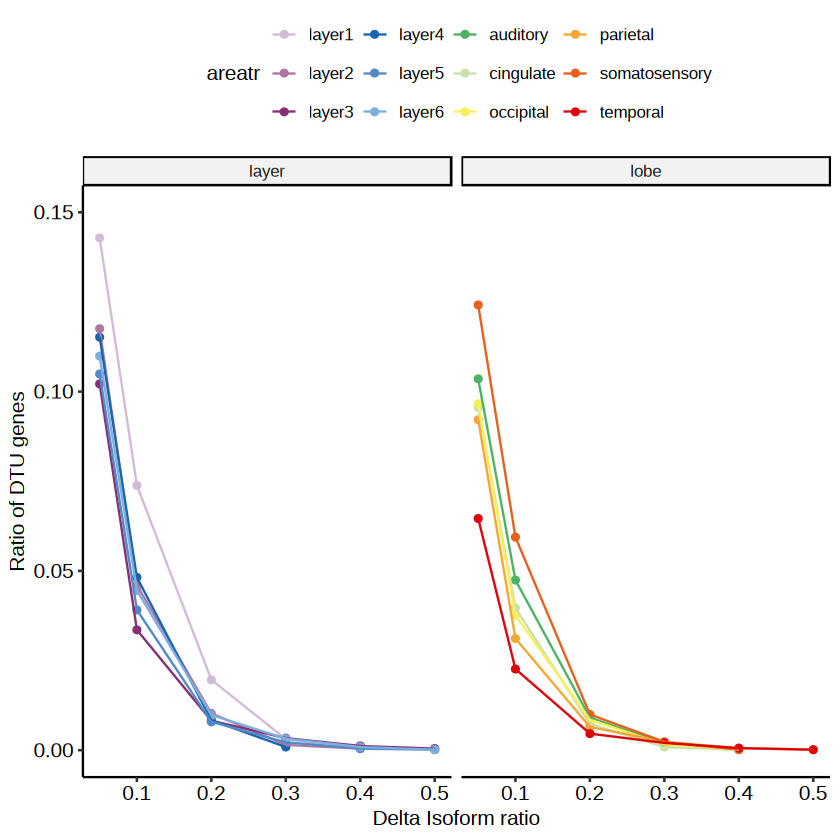

In [109]:
isostdf = isostdf[order(isostdf$group,isostdf$areatr),]
isostdf$areatr = factor(isostdf$areatr,levels = unique(isostdf$areatr))
p2.1 = ggplot(isostdf,aes(x = thred,y = ratio,color = areatr,group = areatr)) + geom_point() + geom_line() +
scale_y_continuous(limits = c(0,0.15)) + 
facet_wrap(~group,nrow = 1) + scale_color_discreterainbow() + theme_pubr() +
xlab("Delta Isoform ratio") + ylab("Ratio of DTU genes")
p2.1
ggexport(p2.1,filename = "result/figure2/sigiso_number_stat_lobe_layer_proportion_24_10_22.pdf",width = 5,height = 4)

In [238]:
genetrst = fsraw.cor %>% group_by(gene_id) %>% 
    mutate(readnumt = length(unique(readid))) %>% 
    group_by(gene_id,transcript_id)  %>% 
    summarise(readnum = length(unique(readid)),
              readnumt = readnumt[1],
              readrate = readnum/readnumt)
fsgenest = fsraw.cor %>% group_by(layer, gene_id) %>% summarise(readnum = length(unique(readid)))
summary(genetrst$readrate)
genetrstf = genetrst[genetrst$readrate > 0.05,]

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
0.0000005 0.0282954 0.5714286 0.5276932 1.0000000 1.0000000 

[1] 254

[1] 1553

[1] 1299

file saved to result/figure2/sigiso_number_stat_lobe_layer_24_12_04.pdf



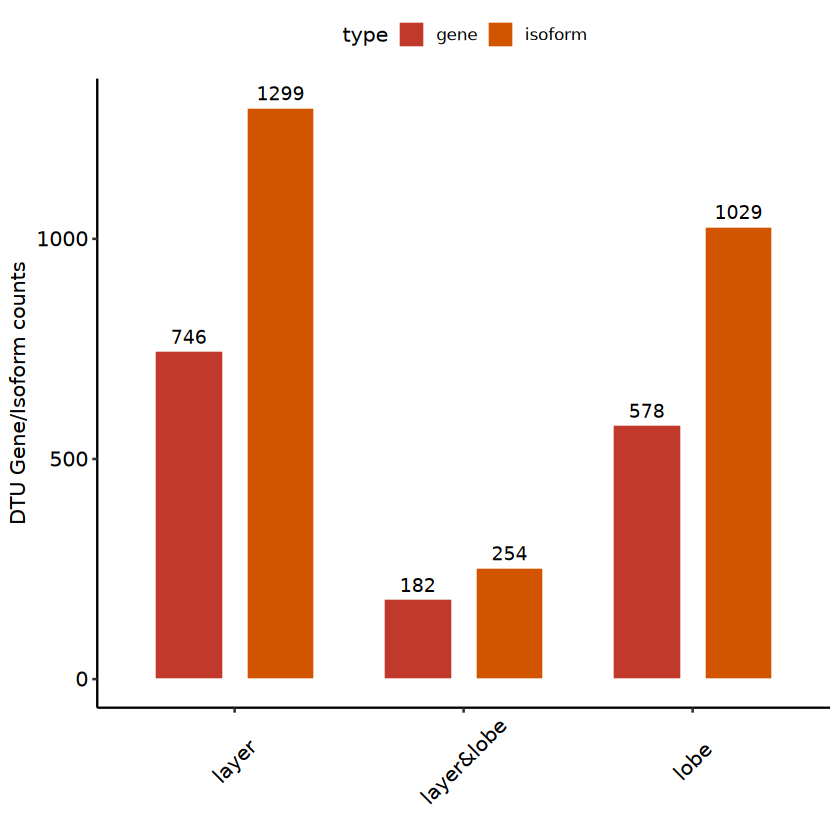

In [106]:
dtustdf = NULL
for(i in c(1,3)){
    isosigi = isosigls[[i]]
    isosigi = isosigi[isosigi$sig != "N",]
    dtugn = length(unique(isosigi$gene_id))
    dtutn = length(unique(isosigi$transcript_id[isosigi$transcript_id %in% fsraw.cor$transcript_id]))
    dtustdf = rbind(dtustdf,data.frame("count" = c(dtugn,dtutn),"type" = c("gene","isoform"),"group" = names(isosigls)[i]))
}

library(ggvenn)
#get layer dtu
isosigi = isosigls$layer
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtugn.layer = unique(isosigi$gene_id)
dtutn.layer = unique(isosigi$transcript_id)

#get layer marker
# mkgene.layer = mkls$layer
# colnames(mkgene.layer)[7] = "gene_id"
# mkgene.layer = mkgene.layer[mkgene.layer$avg_log2FC > 0.5 & mkgene.layer$p_val_adj < 0.05 & mkgene.layer$pct.1 > 0.25, ]
# mkgene.layer = unique(mkgene.layer$gene_id)
# mkiso.layer = unique(fsraw.cor[fsraw.cor$gene_id %in% mkgene.layer,]$transcript_id)

#get lobe dtu
isosigi = isosigls$lobe
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtugn.lobe = unique(isosigi$gene_id)
dtutn.lobe = unique(isosigi$transcript_id)

#get lobe marker
# mkgene.lobe = mkls$lobe
# colnames(mkgene.lobe)[7] = "gene_id"
# mkgene.lobe = mkgene.lobe[mkgene.lobe$avg_log2FC > 0.5 & mkgene.lobe$p_val_adj < 0.05 & mkgene.lobe$pct.1 > 0.25, ]
# mkgene.lobe = unique(mkgene.lobe$gene_id)
# mkiso.lobe = unique(fsraw.cor[fsraw.cor$gene_id %in% mkgene.lobe,]$transcript_id)

#get common dtu
dtugn.com = intersect(dtugn.lobe,dtugn.layer)
dtutn.com = intersect(dtutn.lobe,dtutn.layer)
length(dtutn.com)
#mkgene.com = c(mkgene.lobe,mkgene.layer)
#mkiso.com = c(mkiso.layer,mkiso.lobe)

#delet common dtu
dtugn.layer = dtugn.layer[!dtugn.layer %in% dtugn.com]
length(dtutn.layer)
dtutn.layer = dtutn.layer[!dtutn.layer %in% dtutn.com]
length(dtutn.layer)
dtugn.lobe = dtugn.lobe[!dtugn.lobe %in% dtugn.com]
dtutn.lobe = dtutn.lobe[!dtutn.lobe %in% dtutn.com]

dtustdf = data.frame("count" = c(length(dtugn.layer),
                       length(dtugn.lobe),
                       length(dtugn.com),
                       length(dtutn.layer),
                       length(dtutn.lobe),
                       length(dtutn.com)),
           "type" = c(rep("gene",3),rep("isoform",3)),
           "group" = c("layer","lobe","layer&lobe","layer","lobe","layer&lobe"))

# dtustdf = data.frame("count" = c(length(dtugn.layer[!dtugn.layer %in% mkgene.layer]),
#                        length(dtugn.layer[dtugn.layer %in% mkgene.layer]),
#                        length(dtugn.lobe[!dtugn.lobe %in% mkgene.lobe]),
#                        length(dtugn.lobe[dtugn.lobe %in% mkgene.lobe]),
#                        length(dtugn.com[!dtugn.com %in% mkgene.com]),
#                        length(dtugn.com[dtugn.com %in% mkgene.com]),
#                        length(dtutn.layer[!dtutn.layer %in% mkiso.layer]),
#                        length(dtutn.layer[dtutn.layer %in% mkiso.layer]),
#                        length(dtutn.lobe[!dtutn.lobe %in% mkiso.lobe]),
#                        length(dtutn.lobe[dtutn.lobe %in% mkiso.lobe]),
#                        length(dtutn.com[!dtutn.com %in% mkiso.com]),
#                        length(dtutn.com[dtutn.com %in% mkiso.com])),
#            "type" = c(rep("gene",6),rep("isoform",6)),
#            "group" = c(rep("layer",2),rep("lobe",2),rep("layer&lobe",2),rep("layer",2),rep("lobe",2),rep("layer&lobe",2)),
#            "MarkerGene" = c(rep(c("No","Yes"),6))
#           )

p2.1 = ggplot(dtustdf,aes(x = group,fill = type,y = count)) + 
geom_bar(stat = "identity",position = position_dodge(0.8),color = "white",width = 0.6) + 
geom_text(aes(label = count),position = position_dodge(0.8),vjust = -0.5) + 
#facet_grid(~type,scales = "free") +
theme_pubr() + theme(axis.text.x = element_text(angle = 45,vjust = 0.5)) +
labs(x = "",y = "DTU Gene/Isoform counts") + scale_fill_flatui()
p2.1
ggexport(p2.1,filename = "result/figure2/sigiso_number_stat_lobe_layer_24_12_04.pdf",width = 4,height = 4)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
file saved to result/figure2/dtu_deg_venn_stat_region_layer_25_01_01.pdf



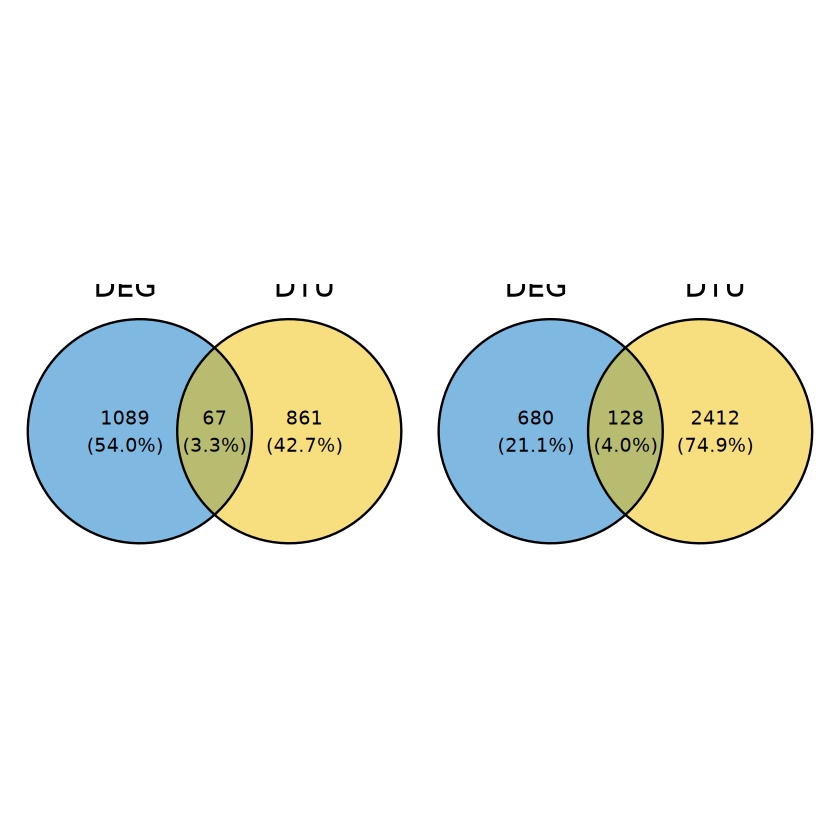

In [9]:
isosigi = isosigls$layer
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtu.layer = unique(isosigi$gene_id)
mkly = mkls$layer
mkly = mkly[mkly$p_val_adj < 0.05 & abs(mkly$avg_log2FC) > 1  & mkly$pct.1 > 0.1, ]
deg.layer = mkly$gene
pst1.1 = ggvenn(list("DEG" = deg.layer, "DTU" = dtu.layer),stroke_size = 0.5) + scale_fill_jco()

# isosigi = isosigls$lobe
# isosigi = isosigi[!isosigi$sig %in% c("N"), ]
# dtu.lobe = unique(isosigi$gene_id)
# mklb = mkls$lobe
# mklb = mklb[mklb$p_val_adj < 0.05 & mklb$avg_log2FC > 1  & mklb$pct.1 > 0.1, ]
# deg.lobe = mklb$gene
# pst1.2 = ggvenn(list("DEG" = deg.lobe, "DTU" = dtu.lobe),stroke_size = 0.5)  + scale_fill_jco()
isosigi = isosigls$region
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtu.region = unique(isosigi$gene_id)
mkly = mkls$region
mkly = mkly[mkly$p_val_adj < 0.05 & abs(mkly$avg_log2FC) > 1  & mkly$pct.1 > 0.1, ]
deg.region = unique(mkly$gene)
# isosigi = isosigls$lobe
# isosigi = isosigi[!isosigi$sig %in% c("N"), ]
# dtu.lobe = unique(isosigi$gene_id)
pst1.2 = ggvenn(list("DEG" = deg.region, "DTU" = dtu.region),stroke_size = 0.5) + scale_fill_jco()
pst1.1 + pst1.2
ggexport(pst1.1 + pst1.2,filename = "result/figure2/dtu_deg_venn_stat_region_layer_25_01_01.pdf",width = 6,height = 4)

In [14]:
mkly = mkls$region
mkly

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
LOC102126388,7.287992e-14,4.810978,0.333,0.000,1.903405e-09,1|2,LOC102126388
LOC102143327,7.287992e-14,4.811083,0.333,0.000,1.903405e-09,1|2,LOC102143327
LOC107129316,7.287992e-14,4.809372,0.333,0.000,1.903405e-09,1|2,LOC107129316
LOC102139325,3.212554e-12,4.801347,0.500,0.012,8.390228e-08,1|2,LOC102139325
OR1J1,3.932168e-12,4.803017,0.500,0.012,1.026964e-07,1|2,OR1J1
C17orf105,4.809139e-12,4.802501,0.500,0.012,1.256003e-07,1|2,C17orf105
LOC102115173,1.671863e-11,4.786972,0.833,0.054,4.366404e-07,1|2,LOC102115173
LIN28A,5.302693e-10,4.785140,0.500,0.018,1.384904e-05,1|2,LIN28A
LOC102133047,1.412899e-09,4.811011,0.333,0.006,3.690069e-05,1|2,LOC102133047


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


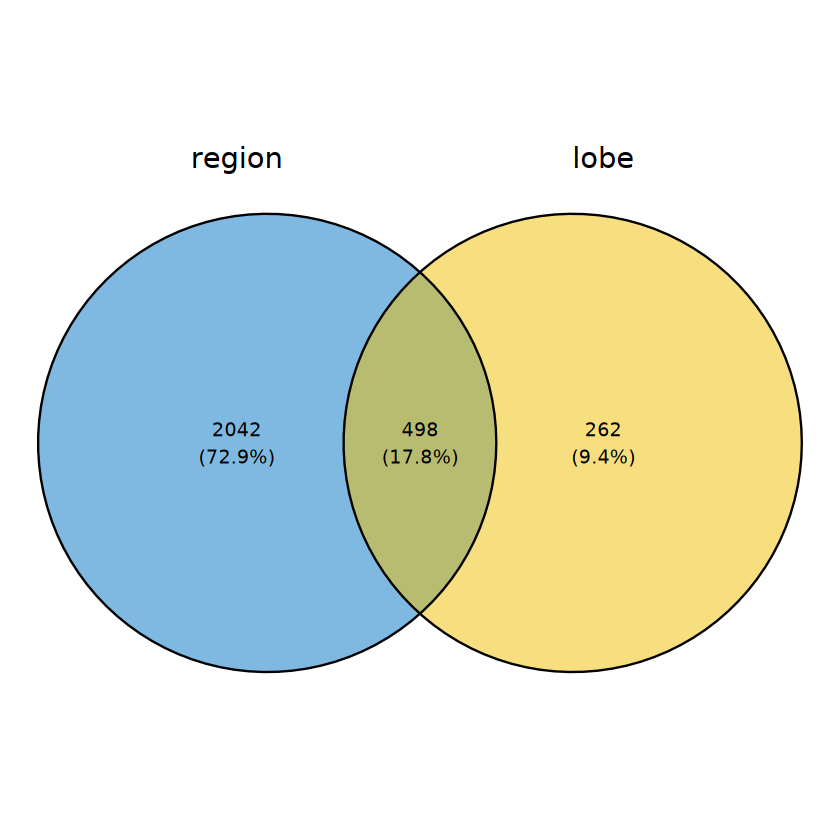

In [13]:
isosigi = isosigls$region
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtu.region= unique(isosigi$gene_id)

isosigi = isosigls$lobe
isosigi = isosigi[!isosigi$sig %in% c("N"), ]
dtu.lobe = unique(isosigi$gene_id)
ggvenn(list("region" = dtu.region, "lobe" = dtu.lobe),stroke_size = 0.5) + scale_fill_jco()

[1] 1506

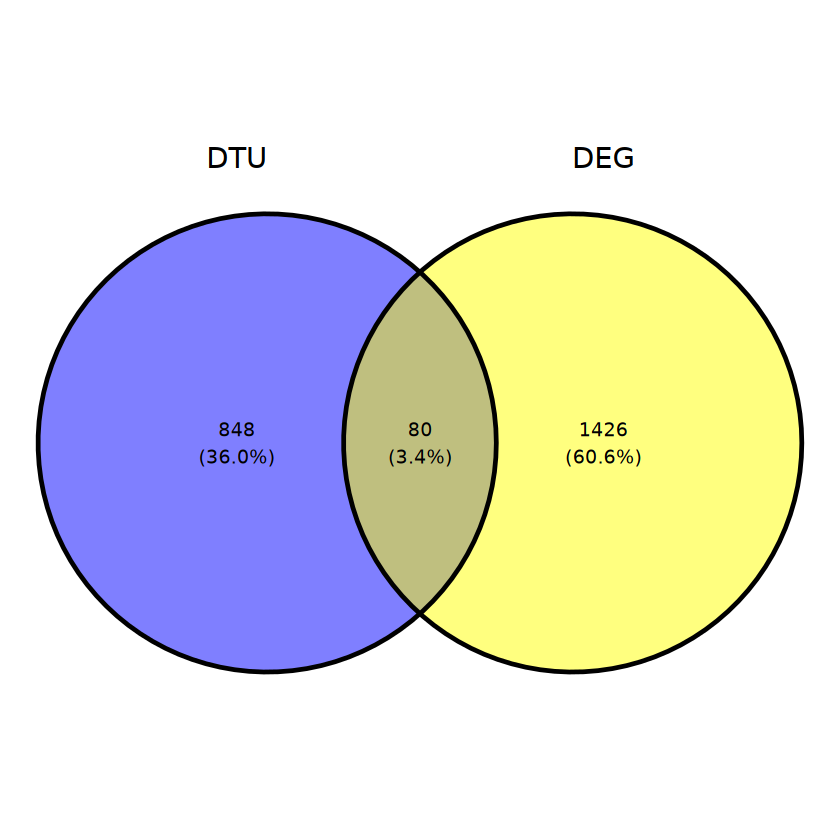

In [140]:
mkly = mkls$layer
mkly = mkly[mkly$p_val_adj < 0.05 & abs(mkly$avg_log2FC) > 1 & (mkly$pct.1 > 0.25 | mkly$pct.2 > 0.25), ]
length(unique(mkly$gene))
library(ggvenn)
isosigi = isosigls$layer
ggvenn(list("DTU" = isosigi[isosigi$sig != "N",]$gene_id,"DEG" = mkly$gene))

[1] 28

`summarise()` has grouped output by 'group'. You can override using the
`.groups` argument.
file saved to result/figure2/sigiso_stat_basic_dtun_layer&lobe_24_11_29.pdf



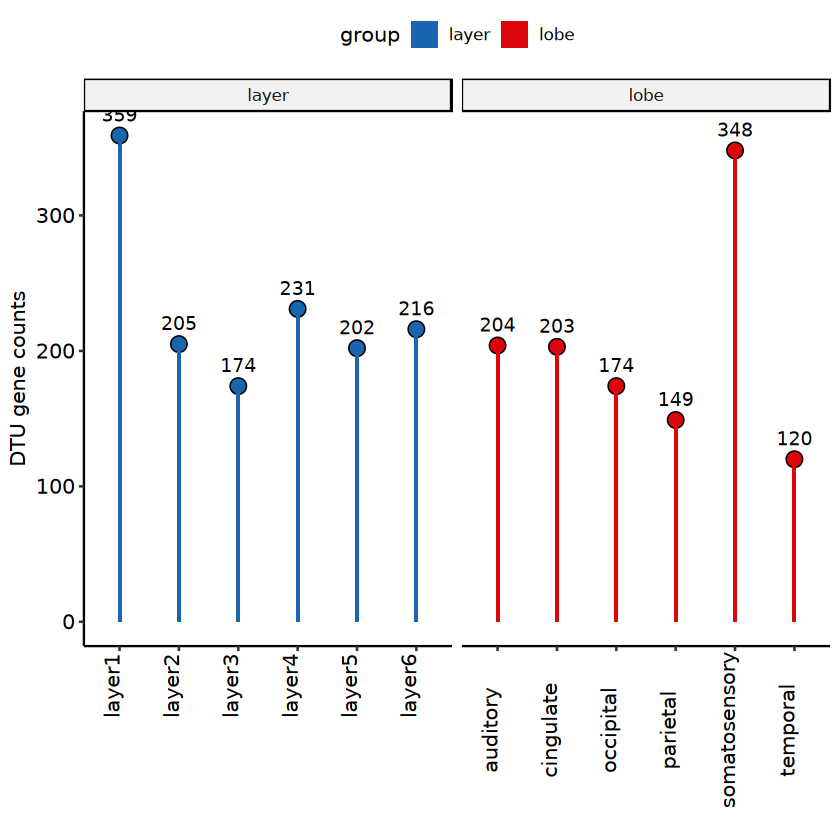

In [20]:
dtustdf = NULL
for(i in c(1,3)){
    isosigi = isosigls[[i]]
    isosigi = isosigi[isosigi$sig == "Up",]
    isosigi$group = names(isosigls)[i]
    dtustdf = rbind(dtustdf,isosigi)
}
#isosigls = qread(file = "data/dtu_analysis/dtu_isoform_ls_24_04_30.qs")
dtustdf$genetype = "Known"
dtustdf[substr(dtustdf$gene_id,1,5) == "Bambu",]$genetype = "Novel"
length(unique(dtustdf[substr(dtustdf$gene_id,1,5) == "Bambu",]$gene_id))
dtustdf.st = dtustdf %>% group_by(group,areatr) %>% summarise(dtun = length(unique(gene_id)))
pison1 = ggplot(dtustdf.st,aes(x = areatr,y = dtun,fill = group)) + 
    geom_point(position = position_dodge(0.5),shape = 21,size = 4) + 
    geom_bar(position = position_dodge(0.5),stat = "identity",width = 0.05) +
    facet_grid(~group,space = "free",scale = "free") +
    geom_text(position = position_dodge(0.5),aes(label=dtun),vjust = -1) + 
    scale_fill_discreterainbow() +
    scale_color_discreterainbow() +
    theme_pubr() + theme(axis.text.x = element_text(angle = 90,vjust = 0)) + 
    xlab("") + ylab("DTU gene counts")
pison1

ggexport(pison1,filename = "result/figure2/sigiso_stat_basic_dtun_layer&lobe_24_11_29.pdf",width = 5,height = 5)

`summarise()` has grouped output by 'group'. You can override using the
`.groups` argument.
file saved to result/figure2/sigiso_stat_basic_dtun_region_24_12_21.pdf



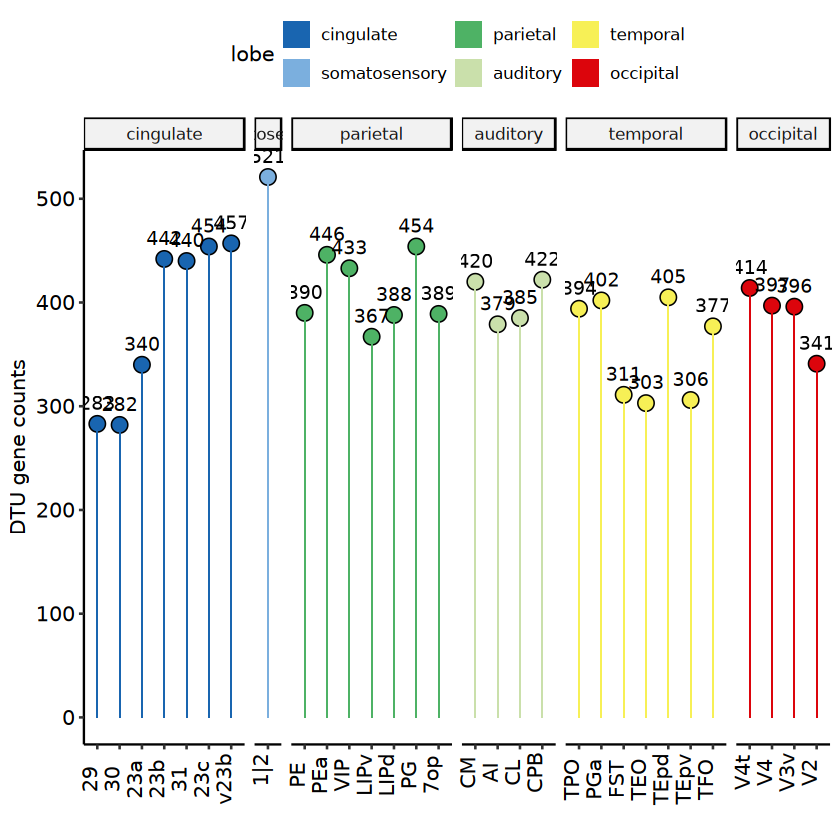

In [10]:
regionorder = c("29","30","23a","23b","31","23c","1|2","PE","PEa","VIP","LIPv","LIPd","PG","7op","CM","AI","CL","CPB","TPO",
               "PGa","FST","V4t","V4","TEO","TEpd","TEpv","TFO","V3v","V2","v23b")
lobeorder = c('cingulate','somatosensory','parietal','auditory','temporal','occipital')
isosigi = isosigls$region
isosigi = isosigi[isosigi$sig != "N",]
isosigi$group = "region"
dtustdf.st = isosigi %>% group_by(group,areatr) %>% summarise(dtun = length(unique(gene_id)))
dtustdf.st = merge(dtustdf.st,areaan,by.x = "areatr",by.y = "area")
dtustdf.st$areatr = factor(dtustdf.st$areatr,levels = regionorder)
dtustdf.st$lobe = factor(dtustdf.st$lobe,levels = lobeorder)
pison1 = ggplot(dtustdf.st,aes(x = areatr,y = dtun,fill = lobe)) + 
    geom_point(position = position_dodge(0.5),shape = 21,size = 4) + 
    geom_bar(position = position_dodge(0.5),stat = "identity",width = 0.05) +
    facet_grid(~lobe,space = "free",scale = "free") +
    geom_text(position = position_dodge(0.5),aes(label=dtun),vjust = -1) + 
    scale_fill_discreterainbow() +
    scale_color_discreterainbow() +
    theme_pubr() + theme(axis.text.x = element_text(angle = 90,vjust = 0)) + 
    xlab("") + ylab("DTU gene counts")
pison1
ggexport(pison1,filename = "result/figure2/sigiso_stat_basic_dtun_region_24_12_21.pdf",width = 6,height = 4)

In [7]:
isosigi = isosigls$region
isosigi = isosigi[isosigi$sig != "N",]
length(unique(isosigi$gene_id))

,lobe,area
,<chr>,<chr>
1,occipital,V1
2,occipital,V2
3,occipital,V3d
4,occipital,V3v
5,occipital,V3A
6,occipital,V4


file saved to result/figure2/sigiso_stat_basic_dtun_layer&lobe&region_upset_24_12_26.pdf



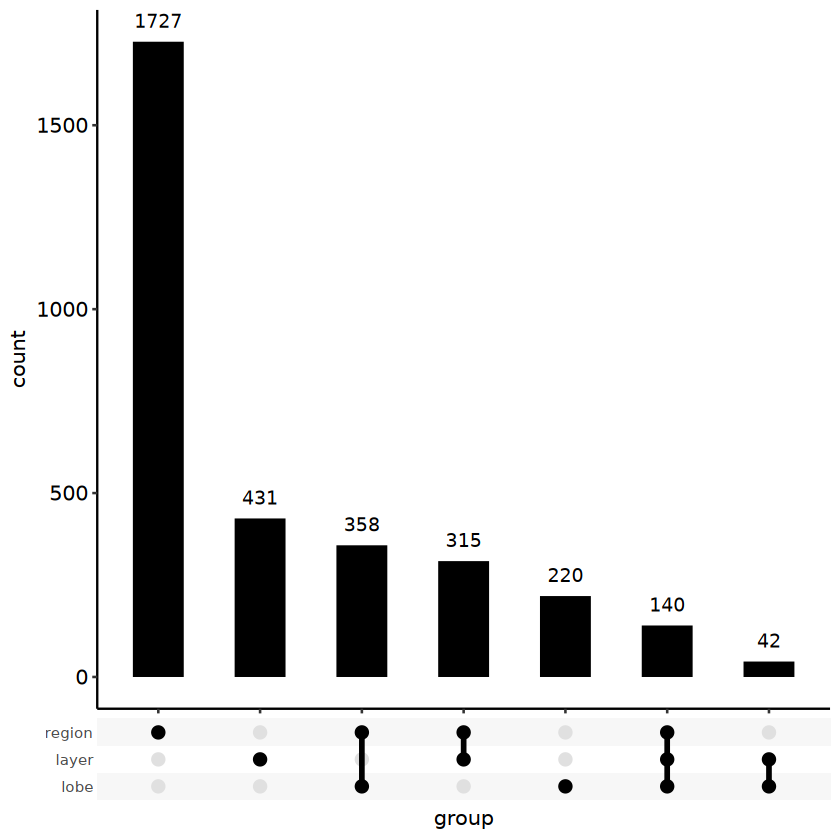

In [16]:
#upset plot
#install.packages("ggupset")
isosigr = isosigls$region
isosigr = isosigr[isosigr$sig != "N",]
isosigr$group = "region"

isosigl = isosigls$layer
isosigl = isosigl[isosigl$sig != "N",]
isosigl$group = "layer"

isosigb = isosigls$lobe
isosigb = isosigb[isosigb$sig != "N",]
isosigb$group = "lobe"
dtustdf = rbind(isosigr,isosigl,isosigb)
library(ggupset)
dtustdfup = unique(dtustdf[,c("gene_id","group")])
dtustdfup = dtustdfup %>%
  group_by(gene_id) %>%
  summarize(group = list(group))
# pisonup1 = ggplot(data = dtustdfup[dtustdfup$group == "layer",],
#             aes(x = areatr)) +
#   scale_x_upset(sets = paste0("l",1:6)) + geom_bar(fill = "black",width = 0.5) + theme_pubr()
# pisonup1

pisonup2 = ggplot(data = dtustdfup,
            aes(x = group)) +
  scale_x_upset() + 
 geom_bar(fill = "black",width = 0.5) + 
 geom_text(stat = "count",aes(label=after_stat(count)),vjust = -1) + 
    theme_pubr()
pisonup2
library(ggpubr)
library(ggplot2)
ggexport(pisonup2,filename = "result/figure2/sigiso_stat_basic_dtun_layer&lobe&region_upset_24_12_26.pdf",width = 4,height = 4)

#### DTU Case count pie plot

In [195]:
isosigi = isosigls$lobe
isosigi.hub = isosigi[isosigi$gene_id == "TPM3",]
isosigi.hub = isosigi.hub[order(-isosigi.hub$meanrelative),]
isosigi.hub
#isosigi[isosigi$sig != "N" & isosigi$gene_id %in% caseg,c("transcript_id","gene_id")]
#transsig = unique(c("XM_015452432.1",isosigi[isosigi$sig != "N" & isosigi$gene_id %in% caseg,]$transcript_id))
#isosigi[isosigi$gene_id != "CAPRIN1",]

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
81851,TPM3,XM_005541710.2,auditory,1026,2077,0.49398170,0.44692602,0.43751488,0.0564668206,N,1.105037e-23,2.85468e-21
81852,TPM3,XM_005541710.2,cingulate,1281,3099,0.41335915,0.44692602,0.45363939,-0.0402802469,N,1.105037e-23,2.85468e-21
81853,TPM3,XM_005541710.2,occipital,1113,2287,0.48666375,0.44692602,0.43897847,0.0476852774,N,1.105037e-23,2.85468e-21
81854,TPM3,XM_005541710.2,parietal,2829,5967,0.47410759,0.44692602,0.44148971,0.0326178855,N,1.105037e-23,2.85468e-21
81855,TPM3,XM_005541710.2,somatosensory,615,1739,0.35365152,0.44692602,0.46558092,-0.1119293960,Down,1.105037e-23,2.85468e-21
81856,TPM3,XM_005541710.2,temporal,4031,8767,0.45979240,0.44692602,0.44435274,0.0154396594,N,1.105037e-23,2.85468e-21
81839,TPM3,XM_005541701.2,auditory,400,2077,0.19258546,0.20649443,0.20927622,-0.0166907625,N,1.105037e-23,2.85468e-21
81840,TPM3,XM_005541701.2,cingulate,696,3099,0.22458858,0.20649443,0.20287560,0.0217129781,N,1.105037e-23,2.85468e-21
81841,TPM3,XM_005541701.2,occipital,429,2287,0.18758199,0.20649443,0.21027692,-0.0226949321,N,1.105037e-23,2.85468e-21


In [291]:
isosigi = isosigls$layer
isosigi = isosigi[isosigi$sig != "N",]
isosigi = isosigi[isosigi$areatr == "layer1",]
isosigi[isosigi$genecount > 100 & abs(isosigi$dr) > 0.2,]

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
4591,ASPH,XM_005563415.2,layer1,160,384,0.4166667,0.5954337,0.63118712,-0.2145205,Down,4.111280e-26,7.828562e-24
13986,CD47,XM_005548232.2,layer1,87,150,0.5800000,0.7871057,0.82852686,-0.2485269,Down,2.023079e-11,1.058642e-09
13992,CD47,XM_005548234.2,layer1,54,150,0.3600000,0.1798991,0.14387898,0.2161210,Up,2.023079e-11,1.058642e-09
18838,DCLK1,XM_005585633.2,layer1,126,266,0.4736842,0.7378819,0.79072140,-0.3170372,Down,8.251450e-82,6.284855e-79
18850,DCLK1,XM_015439146.1,layer1,124,266,0.4661654,0.1799090,0.12265771,0.3435077,Up,8.251450e-82,6.284855e-79
22943,ERCC1,XM_005589586.2,layer1,28,132,0.2121212,0.3866641,0.42157265,-0.2094514,Down,2.740780e-04,2.598623e-03
24937,FAM89A,FAM89A-WeiLab-1,layer1,41,190,0.2157895,0.4154974,0.45543898,-0.2396495,Down,8.079210e-11,3.819516e-09
24943,FAM89A,XM_005539790.2,layer1,149,190,0.7842105,0.5845026,0.54456102,0.2396495,Up,8.079210e-11,3.819516e-09
30292,HERC2,XM_005559029.2,layer1,103,143,0.7202797,0.5379609,0.50149709,0.2187826,Up,3.082895e-10,1.354695e-08


In [70]:
caseg = c("CD47",'NTRK2',"DDRGK1","ARPP19","DBNDD2","TPM3")
#"ARPP21"
isosigi = isosigls$layer
transsig = c("XM_015452432.1","XM_005541217.2","XR_001492897.1", "XM_005541701.2","XM_005541710.2",
             'XM_005570477.2','XM_005570483.2',' NM_001284070.1','XM_005541713.2',"XM_005548232.2","XM_005548234.2",
             unique(isosigi[isosigi$sig != "N" & isosigi$gene_id %in% caseg,]$transcript_id))
transsig
fsraw.cor.hub = fsraw.cor[fsraw.cor$gene_id %in% caseg,]
isosigi = isosigls$layer
casect = fsraw.cor.hub %>% group_by(layer,lobe,gene_id,transcript_id) %>% 
                summarise(count = length(readid)) %>% 
                group_by(layer,lobe,gene_id) %>% 
                mutate(genecount = sum(count),rate = count/genecount)


[1] "XM_015452432.1"  "XM_005541217.2"  "XR_001492897.1"  "XM_005541701.2" 
 [5] "XM_005541710.2"  "XM_005570477.2"  "XM_005570483.2"  " NM_001284070.1"
 [9] "XM_005541713.2"  "XM_005548232.2"  "XM_005548234.2"  "NM_001283415.1" 
[13] "XM_005548232.2"  "XM_005548234.2"  "XM_005569136.2"  "XM_015429879.1" 
[17] "DDRGK1-WeiLab-1" "XM_005568473.2"  "XM_005582045.2"  "XM_005582051.2"

`summarise()` has grouped output by 'layer', 'lobe', 'gene_id'. You can
override using the `.groups` argument.


In [37]:
test = fsraw.cor.hub[fsraw.cor.hub$transcript_id %in% transsig,]
unique(paste0(test$gene_id,"-",test$transcript_id))

[1] "NTRK2-XM_005582051.2"   "ARPP19-NM_001283415.1"  "DDRGK1-XM_005568473.2" 
 [4] "ARPP19-XM_015452432.1"  "NTRK2-XM_005582045.2"   "DDRGK1-DDRGK1-WeiLab-1"
 [7] "TPM3-XM_005541710.2"    "TPM3-XM_005541701.2"    "DBNDD2-XM_005569136.2" 
[10] "DBNDD2-XM_015429879.1"  "TPM3-XM_005541713.2"    "CD47-XM_005548232.2"   
[13] "CD47-XM_005548234.2"

In [71]:
casect.totall = fsraw.cor.hub %>% group_by(layer,gene_id,transcript_id) %>% 
                summarise(count = length(readid)) %>% 
                group_by(layer,gene_id) %>% 
                mutate(genecount = sum(count),rate = count/genecount)
casect.totall$lobe = "Total"
casect.totalb = fsraw.cor.hub %>% group_by(lobe,gene_id,transcript_id) %>% 
                summarise(count = length(readid)) %>% 
                group_by(lobe,gene_id) %>% 
                mutate(genecount = sum(count),rate = count/genecount)
casect.totalb$layer = "Total"
casect.total = fsraw.cor.hub %>% group_by(gene_id,transcript_id) %>% 
                summarise(count = length(readid)) %>% 
                group_by(gene_id) %>% 
                mutate(genecount = sum(count),rate = count/genecount)
casect.total$layer = "Total"
casect.total$lobe = "Total"

casect = rbind(casect.totall,casect.totalb,casect.total,casect)
casect = casect[casect$transcript_id %in% transsig,]
casect = casect %>% group_by(gene_id) %>% mutate(id = as.character(as.numeric(as.factor(transcript_id))))
casect$gene_tran = paste0(casect$gene_id,"-",casect$id)
#casect = casect[casect$genecount > 5,]
casectl = dcast(casect,layer+lobe+gene_id~id,value.var = "rate")
casectl$group = paste0(casectl$layer,"-",casectl$lobe,"-",casectl$gene_id)
casectl[is.na(casectl)] = 0
casectl$layerid = as.numeric(factor(casectl$layer,levels = c(paste0("l",1:6),"Total")))
casectl$lobeid = as.numeric(factor(casectl$lobe,levels = c("Total",lobeorder)))
unique(casectl$lobe)

`summarise()` has grouped output by 'layer', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'lobe', 'gene_id'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.


[1] "auditory"      "cingulate"     "occipital"     "parietal"     
[5] "somatosensory" "temporal"      "Total"

In [74]:
# mean(casectl[casectl$gene_id == "NTRK2" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",2:6),]$`2`)
# casectl[casectl$gene_id == "NTRK2" & casectl$lobe == "Total" ,]
# mean(casectl[casectl$gene_id == "CD47" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",2:6),]$`2`)
# casectl[casectl$gene_id == "CD47" & casectl$lobe == "Total" ,]

mean(casectl[casectl$gene_id == "DDRGK1" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",1:3),]$`1`)
mean(casectl[casectl$gene_id == "DDRGK1" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",4:6),]$`1`)

mean(casectl[casectl$gene_id == "ARPP19" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",2:3),]$`1`)
mean(casectl[casectl$gene_id == "ARPP19" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",4:6),]$`1`)

casectl[casectl$gene_id == "TPM3" & casectl$layer == "Total",]
mean(casectl[casectl$gene_id == "TPM3" & casectl$layer == "Total" & !casectl$lobe %in% "somatosensory",]$`2`)
# mean(casectl[casectl$gene_id == "DBNDD2" & casectl$lobe == "Total" & casectl$layer %in% paste0("l",1:5),]$`2`)
# casectl[casectl$gene_id == "DBNDD2" & casectl$lobe == "Total" ,]

[1] 0.630436

[1] 0.3968931

[1] 0.4795557

[1] 0.3580054

,layer,lobe,gene_id,1,2,3,group,layerid,lobeid
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
258,Total,auditory,TPM3,0.1925855,0.4939817,0.04044295,Total-auditory-TPM3,7,5
264,Total,cingulate,TPM3,0.2245886,0.4133591,0.06937722,Total-cingulate-TPM3,7,2
270,Total,occipital,TPM3,0.1875820,0.4866638,0.05946655,Total-occipital-TPM3,7,7
276,Total,parietal,TPM3,0.1987265,0.4740282,0.06350536,Total-parietal-TPM3,7,4
282,Total,somatosensory,TPM3,0.2443933,0.3536515,0.08280621,Total-somatosensory-TPM3,7,3
288,Total,temporal,TPM3,0.1935842,0.4599242,0.06240177,Total-temporal-TPM3,7,6
294,Total,Total,TPM3,0.2012545,0.4555739,0.06283911,Total-Total-TPM3,7,1


[1] 0.4639218

In [55]:
library(patchwork)
library(scatterpie)
#caseg = c("MYL6",'NTRK2',"DBNDD2","DDRGK1","ARPP19","KCNIP4")
mycolors = distinctColorPalette(2)
mycolor =  c('#1864AF','#DC050B','#F7EF55')
mycolors
#names(mycolors) = transname

casectl$gene_id = factor(casectl$gene_id,levels = caseg)
casectl$sig = 'N'
casectl$siggroup = paste0(casectl$gene_id,"-",casectl$layer)
casectl[casectl$siggroup %in% c("CD47-l1","NTRK2-l1","DDRGK1-l1","DDRGK1-l2","DDRGK1-l3",
                                "ARPP19-l2","ARPP19-l3","DBNDD2-l6"),]$sig = "Y"
casectl$siggroup = paste0(casectl$gene_id,"-",casectl$lobe)
casectl[casectl$siggroup %in% c("TPM3-somatosensory"),]$sig = "Y"
casectl$alpha = 0
casectl[casectl$sig == "Y",]$alpha = 0.3
#casectl
# isosigi = isosigls$layer
# isosigi = isosigi[isosigi$sig != "N",]
# casectl[paste0(casectl$layer,casectl$gene_id) %in% paste0(isosigi$areatr,isosigi$gene_id),]$sig = "Y"

plt = ggplot(data = casectl,aes(x = layerid, y = lobeid)) + 
      geom_tile(aes(alpha = alpha),fill = "#c1fba4") +
      geom_scatterpie(data = casectl,aes(x = layerid, y = lobeid,group = group,r = 0.4),color=NA,
                      cols=colnames(casectl)[4:6]) + 
      facet_wrap(~gene_id,nrow = 2) +
      # geom_histogram(data = root_sprn,aes(mean.model),bins = 100) +
      coord_fixed() +
      scale_x_continuous(breaks = c(1:7),labels = c(paste0("l",1:6),"Total"),position = "top")+
      scale_y_continuous(breaks = c(1:7),labels = c("Total",lobeorder)) +
      # geom_smooth(data = tem2, aes(x=x, y=y), se = F, method = 'loess',color = "black") +
      scale_fill_manual(values = mycolor) +
      #scale_fill_manual(values = mycolors) +
      #annotate("text", x = 8, y = 7, label = caseg[i], hjust = 1.1, vjust = 1.1, size = 5, angle = 90) +
      ylab("") + xlab("") +
      theme_bw() + theme(legend.position="none",axis.text = element_text(size = 12),
                        strip.background =element_rect(fill="white"))
plt
ggexport(plt,filename = "result/figure2/case_layer_isoform_rate_stat_pie_25_03_13.pdf",width = 9,height = 4)

[1] "#BF82CA" "#B7D3A2"

Warning message in grid.newpage():
"Cannot open temporary file '/tmp/RtmpwvjdLE/pdffc4876106b07' for compression (reason: No such file or directory); compression has been turned off for this device"
file saved to result/figure2/case_layer_isoform_rate_stat_pie_25_03_20.pdf



ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

In [53]:
head(casectl)

,layer,lobe,gene_id,1,2,group,layerid,lobeid,sig,siggroup,alpha
,<chr>,<chr>,<fct>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
1,l1,auditory,ARPP19,0.3559322,0.5932203,l1-auditory-ARPP19,1,5,N,ARPP19-auditory,0.0
2,l1,auditory,CD47,0.4444444,0.4444444,l1-auditory-CD47,1,5,Y,CD47-auditory,0.3
3,l1,auditory,DBNDD2,0.7000000,0.1333333,l1-auditory-DBNDD2,1,5,N,DBNDD2-auditory,0.0
4,l1,auditory,DDRGK1,0.7118644,0.2881356,l1-auditory-DDRGK1,1,5,Y,DDRGK1-auditory,0.3
5,l1,auditory,NTRK2,0.1696429,0.8125000,l1-auditory-NTRK2,1,5,Y,NTRK2-auditory,0.3
6,l1,auditory,SNRPN,0.4375000,0.4910714,l1-auditory-SNRPN,1,5,N,SNRPN-auditory,0.0


In [32]:
mycolors
distinctColorPalette(3)
'#B5C1C9'

[1] "#B7D3A2" "#BF82CA"

[1] "#C26BC8" "#B5C1C9" "#B6D87E"

#### l1-l3 vs l4-l6

In [271]:
isosigi = isosigls$layer
# transti = fsraw.cor %>% group_by(gene_id,transcript_id) %>% summarise(count = length(readid))
# transti = transti %>% group_by(gene_id) %>% mutate(relative = count/sum(count))
# transtif = transti %>% group_by(gene_id) %>% filter(relative == max(relative))

# isosigi = isosigi[isosigi$transcript_id %in% transtif$transcript_id,]
isosigi.mx = dcast(isosigi,transcript_id+gene_id~areatr,value.var = "relative",fun.aggregate = sum)
head(isosigi.mx)

,transcript_id,gene_id,layer1,layer2,layer3,layer4,layer5,layer6
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AAAS-WeiLab-1,AAAS,0.1739130,0.07142857,0.1260504,0.2058824,0.05769231,0.25000000
2,AADAT-WeiLab-1,AADAT,0.0000000,0.02439024,0.0739645,0.1484375,0.12500000,0.13333333
3,AAED1-WeiLab-1,AAED1,0.0000000,0.00000000,0.1136364,0.0000000,0.00000000,0.14285714
4,AAED1-WeiLab-2,AAED1,0.0000000,0.00000000,0.7727273,0.0000000,0.00000000,0.71428571
5,AAMDC-WeiLab-1,AAMDC,0.2043011,0.17827869,0.1915868,0.2199630,0.18026565,0.20382775
6,ABCD1-WeiLab-1,ABCD1,0.0800000,0.04166667,0.0462963,0.1000000,0.08571429,0.01851852


In [272]:
isosigi.mx$pvalue = 1
isosigi.mx$dr = 0
for (i in 1:nrow(isosigi.mx)) {
  data_group1 <- unlist(isosigi.mx[i, 4:5])
  data_group2 <- unlist(isosigi.mx[i, 6:8])
  if(length(data_group1[data_group1 > 0]) < 2 | length(data_group2[data_group2 > 0]) < 2){
      next
  }
  # 计算t检验
  t_test_result <- t.test(data_group1, data_group2)
  # 存储p值
  isosigi.mx$pvalue[i] = t_test_result$p.value
  isosigi.mx$dr[i] = mean(data_group1) - mean(data_group2)
}
isosigi.mx$padj =  p.adjust(isosigi.mx$pvalue,method = "BH")
isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$pvalue < 0.05,]
isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$padj < 0.05,]
unique(isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$pvalue < 0.05,]$gene_id)
isosigi.mx[isosigi.mx$gene_id == "ARPP19",]

,transcript_id,gene_id,layer1,layer2,layer3,layer4,layer5,layer6,pvalue,dr,padj
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
120,ASTE1-WeiLab-2,ASTE1,0.00000000,0.33333333,0.39795918,0.58333333,0.62222222,0.47368421,0.0386542253,-0.1941003,1
241,BambuGene118748-WeiLab-1,BambuGene118748,0.00000000,0.23809524,0.28099174,0.47619048,0.56521739,0.41025641,0.0248174146,-0.2243446,1
252,BambuGene119249-WeiLab-1,BambuGene119249,0.00000000,0.16000000,0.17142857,0.00000000,0.04347826,0.06818182,0.0174261279,0.1284943,1
644,BambuGene71536-WeiLab-3,BambuGene71536,0.67647059,0.73469388,0.76150628,0.58333333,0.62601626,0.64705882,0.0111966132,0.1292973,1
838,C11H12orf29-WeiLab-4,C11H12orf29,0.35384615,0.35329341,0.38788871,0.31000000,0.23888889,0.24324324,0.0344534349,0.1065470,1
965,CCDC13-WeiLab-1,CCDC13,0.14285714,0.03030303,0.04368932,0.17777778,0.10112360,0.18867925,0.0433662843,-0.1188640,1
1003,CCS-WeiLab-2,CCS,0.16666667,0.21875000,0.19327731,0.07407407,0.15254237,0.07692308,0.0403489919,0.1048338,1
1151,DDRGK1-WeiLab-1,DDRGK1,0.61387801,0.65511432,0.62641906,0.38253968,0.37415622,0.43592744,0.0020865986,0.2432256,1
1667,LOC102115161-WeiLab-2,LOC102115161,0.53932584,0.61971831,0.67452830,0.85714286,0.78333333,0.77272727,0.0337158908,-0.1572778,1


transcript_id,gene_id,layer1,layer2,layer3,layer4,layer5,layer6,pvalue,dr,padj
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>


[1] "ASTE1"           "BambuGene118748" "BambuGene119249" "BambuGene71536" 
 [5] "C11H12orf29"     "CCDC13"          "CCS"             "DDRGK1"         
 [9] "LOC102115161"    "LOC102122694"    "LRRC23"          "ARPP19"         
[13] "GSTM4"           "PHF11"           "PRKRIP1"         "RPS6KA2"        
[17] "SNAP23"          "DOCK7"           "C1H1orf228"      "ARPP21"         
[21] "NEK10"           "MAP6D1"          "COL9A1"          "PGBD1"          
[25] "PDLIM5"          "NFKB1"           "APBB3"           "PPP2R2B"        
[29] "GTPBP6"          "RNASE1"          "DCAF4"           "TGFB3"          
[33] "SERPINA1"        "ZNF251"          "TMEM106C"        "DPP10"          
[37] "FAM160A2"        "NOXA1"           "SLC44A1"         "SMC2"           
[41] "CHST9"           "LOC102125324"    "RASIP1"          "CSTF2"          
[45] "PCSK7"           "ZNF782"          "ZNF613"          "PVRL3"          
[49] "SDK1"            "BBS9"            "DIO2"            "VTI1A"          
[53] "PACRGL"

,transcript_id,gene_id,layer1,layer2,layer3,layer4,layer5,layer6,pvalue,dr,padj
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3081,NM_001283415.1,ARPP19,0.3726054,0.4964304,0.47663758,0.37716450,0.36819122,0.34428983,0.004852413,0.12331880,1
15588,XM_015452431.1,ARPP19,0.0651341,0.0354411,0.03915829,0.07251082,0.07101816,0.07389635,0.012956757,-0.03517542,1
15589,XM_015452432.1,ARPP19,0.5603448,0.4673636,0.48332045,0.54816017,0.56033096,0.58085413,0.006389207,-0.08777307,1


In [273]:
isosigi.mx = isosigi.mx %>% group_by(gene_id) %>% filter(abs(dr) == max(abs(dr)))
isosigi.mx.hub = isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$pvalue < 0.05,]
hubgenesvd = unique(isosigi.mx.hub$gene_id)
hubgenesvd
qsave(isosigi.mx,file = "result/figure2/super_vs_deep_dtu_10_23.qs")

[1] "ASTE1"           "BambuGene118748" "BambuGene71536"  "C11H12orf29"    
 [5] "CCDC13"          "CCS"             "LOC102115161"    "LOC102122694"   
 [9] "ARPP19"          "PRKRIP1"         "SNAP23"          "DOCK7"          
[13] "C1H1orf228"      "ARPP21"          "MAP6D1"          "COL9A1"         
[17] "PDLIM5"          "NFKB1"           "APBB3"           "PPP2R2B"        
[21] "GTPBP6"          "RNASE1"          "TGFB3"           "ZNF251"         
[25] "DDRGK1"          "TMEM106C"        "DPP10"           "FAM160A2"       
[29] "NOXA1"           "SLC44A1"         "SMC2"            "PHF11"          
[33] "CHST9"           "LOC102125324"    "RASIP1"          "PCSK7"          
[37] "ZNF782"          "ZNF613"          "PVRL3"           "SDK1"           
[41] "BBS9"            "DIO2"            "VTI1A"           "PACRGL"

In [47]:
isosigi.mx = qread("result/figure2/super_vs_deep_dtu_10_23.qs")

In [49]:
isosigi.mx.hub = isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$pvalue < 0.05,]
hubgenesvd = unique(isosigi.mx.hub[order(-abs(isosigi.mx.hub$dr)),]$gene_id)
length(hubgenesvd)

[1] 44

In [275]:
library(readxl)
all_sheets <- read_excel("ref/human_Brain_drug_target_and_GPCR_20240826.xlsx", sheet = 1)
tfgene = read.delim("ref/Macaca_fascicularis_TF.txt")
tfgene = unique(tfgene$Symbol)
spgene = read.delim("ref/splicing_factor_gene_in_macaca_fas.txt")
spgene = unique(spgene$Symbol)
length(unique(unlist(all_sheets[,3])))
drugovl = intersect(unique(unlist(all_sheets[,2])),hubgenesvd)
length(drugovl)
drugovl
drugovl = intersect(unique(tfgene),hubgenesvd)
length(drugovl)
drugovl
drugovl = intersect(unique(spgene),hubgenesvd)
length(drugovl)
drugovl

[1] 1143

[1] 1

[1] "TGFB3"

[1] 4

[1] "ZNF251" "NFKB1"  "ZNF613" "ZNF782"

[1] 0

character(0)

In [279]:
length(unique(fsraw.cor$readid))

[1] 61836381

In [278]:
# hubgenesvd = unique(isosigi.mx[abs(isosigi.mx$dr) > 0.05 & isosigi.mx$pvalue < 0.02,]$gene_id)
# hubgenesvd
# fsraw.corf = fsraw.cor[fsraw.cor$gene_id %in% isosigi.mx.hub$gene_id,]
# fsraw.corf.st = fsraw.corf %>% group_by(gene_id) %>% summarise(count = length(readid))
# fsraw.corf.st = fsraw.corf.st[fsraw.corf.st$count > 500,]
# hubgenesvd = fsraw.corf.st$gene_id
# hubgenesvd
library(gprofiler2)
goi = gost(query = hubgenesvd,
               organism = "mfascicularis")
goi$result

No results to show
Please make sure that the organism is correct or set significant = FALSE



NULL

Warning message:
"package 'ggrepel' was built under R version 4.3.3"
Warning message:
"ggrepel: 30 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
Warning message:
"ggrepel: 34 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
file saved to result/figure2/superficial_deep_cmp_vocano_24_10_23.pdf



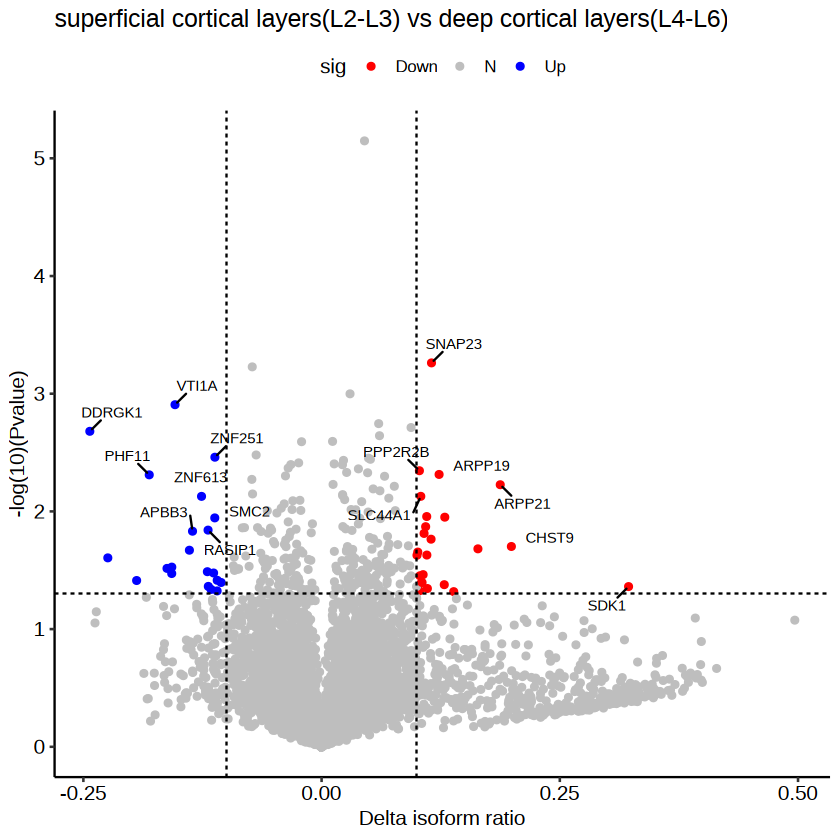

In [277]:
library(ggrepel)
isosigi.mx$sig = "N"
isosigi.mx[isosigi.mx$dr > 0.1 & isosigi.mx$pvalue < 0.05,]$sig = "Down"
isosigi.mx[isosigi.mx$dr < -0.1 & isosigi.mx$pvalue < 0.05,]$sig = "Up"
psd1 = ggplot(isosigi.mx,aes(dr,-1*log10(pvalue))) +    # 加载数据，定义横纵坐标
  geom_point(aes(color = sig)) +                           # 绘制散点图，分组依据是数据框的sig列
  labs(title="superficial cortical layers(L2-L3) vs deep cortical layers(L4-L6)",                                # 定义标题，x轴，y轴名称
       x="Delta isoform ratio", 
       y="-log(10)(Pvalue)") + 
  scale_color_manual(values = c("red","grey","blue")) + 
  geom_hline(yintercept=-log10(0.05),linetype=2)+ 
  geom_vline(xintercept=c(-0.1,0.1),linetype=2)+ 
  geom_text_repel(data = isosigi.mx[isosigi.mx$sig != "N",],
                  aes(x = dr,y = -1*log10(pvalue),label = gene_id),                                        
                  size=3, 
                  box.padding=unit(0.5,'lines'), 
                  point.padding=unit(0.1, 'lines'), 
                  segment.color='black',
                  show.legend=FALSE) + theme_pubr()
psd1
ggexport(psd1,filename = "result/figure2/superficial_deep_cmp_vocano_24_10_23.pdf",width = 6, height = 6)

,transcript_id,gene_id,l1,l2,l3,l4,l5,l6,pvalue,dr,padj,sig
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
120,ASTE1-WeiLab-2,ASTE1,0.0000000,0.33333333,0.39795918,0.5833333,0.6222222,0.4736842,0.03865423,-0.1941003,1,Up
241,BambuGene118748-WeiLab-1,BambuGene118748,0.0000000,0.23809524,0.28099174,0.4761905,0.5652174,0.4102564,0.02481741,-0.2243446,1,Up
965,CCDC13-WeiLab-1,CCDC13,0.1428571,0.03030303,0.04368932,0.1777778,0.1011236,0.1886792,0.04336628,-0.1188640,1,Up
1667,LOC102115161-WeiLab-2,LOC102115161,0.5393258,0.61971831,0.67452830,0.8571429,0.7833333,0.7727273,0.03371589,-0.1572778,1,Up
4073,RPS6KA2-WeiLab-2,RPS6KA2,0.2400000,0.25000000,0.28205128,0.3589744,0.3469388,0.4227642,0.03056871,-0.1102001,1,Up
5116,XM_005543198.2,DOCK7,0.2151899,0.13253012,0.16333333,0.2711864,0.2066667,0.2945205,0.03849474,-0.1095262,1,Up


[1] 36

[1] 25

[1] 53

Warning message:
"The `size` argument of `element_rect()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead."
file saved to result/figure2/superficial_deep_cmp_24_08_25.pdf



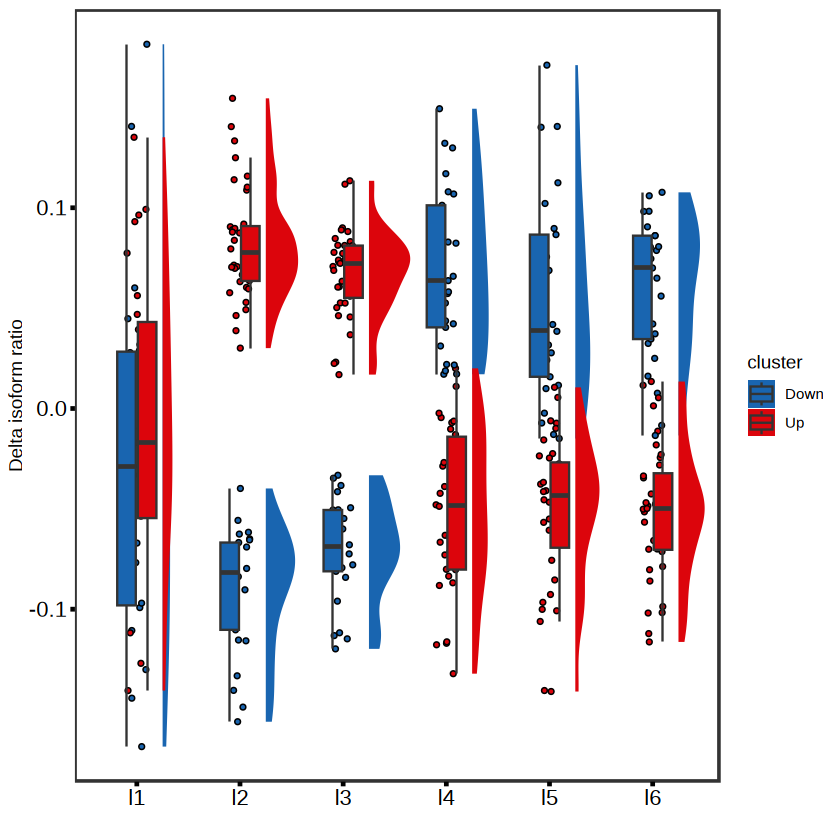

In [217]:
#transgroup
isosigf.mx1hub1 = isosigi.mx[isosigi.mx$dr > 0.1 & isosigi.mx$pvalue < 0.05,]
isosigf.mx1hub2 = isosigi.mx[isosigi.mx$dr < -0.1 & isosigi.mx$pvalue < 0.05,]
head(isosigf.mx1hub2)
# mdg1 = clusteran[clusteran$transcript_id %in% rownames(isosigf.mx1hub1),]
# mdg2 = clusteran[clusteran$transcript_id %in% rownames(isosigf.mx1hub2),]
nrow(isosigf.mx1hub1)
nrow(isosigf.mx1hub2)
isosigf.mx1hub = rbind(isosigf.mx1hub1,isosigf.mx1hub2)
isosigs = isosigls$layer
# isosigs = isosigs[isosigs$transcript_id %in% c(mdg1$transcript_id,mdg2$transcript_id),]
#isosigf = isosigs[isosigs$sig == "Up" & isosigs$areatr %in% c("l1","l2","l3"),]
isosigs$dr2 = isosigs$relative - isosigs$meanrelative
isosigs = isosigs[isosigs$transcript_id %in% isosigf.mx1hub$transcript_id,]
#length(unique(isosigs$gene_id))
#isosigs = isosigs[isosigs$transcript_id %in% mdg1$transcript_id,]
# mdg1$cluster = "Up"
# mdg2$cluster = "Down"
# nrow(clusteran)
# mdgt = rbind(mdg1,mdg2)
# nrow(mdgt)
isosigs$cluster = "Up"
isosigs[isosigs$transcript_id %in% isosigf.mx1hub2$transcript_id,]$cluster = "Down"
length(unique(isosigs$gene_id))
isosigs = isosigs[order(isosigs$gene_id,isosigs$areatr,isosigs$dr2),]
isosigs$cluster = as.character(isosigs$cluster)

pmd1cs2 = ggplot(isosigs,aes(x = areatr, y = dr2, fill = cluster))+
  geom_jitter(shape=21,size=1,width=0.1) +
  geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
  geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
  # stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
  #                    ref.group = ".all.")  +
  theme_bw()+
  theme(panel.grid = element_blank(),
        # legend.position = "none",
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
  scale_fill_discreterainbow() + ylab("Delta isoform ratio") + xlab("")
pmd1cs2
ggexport(pmd1cs2,filename = "result/figure2/superficial_deep_cmp_24_08_25.pdf",width = 5, height = 4)

[1] 777794

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
    1.0   199.0   355.0   377.4   523.0  1082.0 

`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.


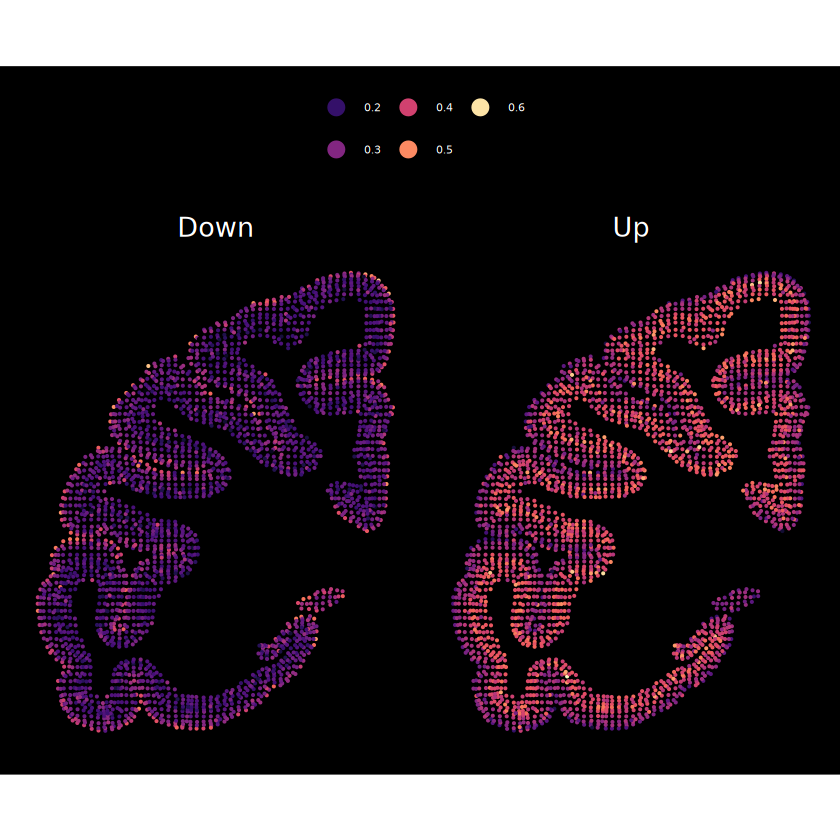

In [109]:
fsrawdp.hub = fsrawdp[fsrawdp$gene_id %in% isosigs$gene_id,]
fsrawdp.hub$cluster = mdgt[match(fsrawdp.hub$transcript_id,mdgt$transcript_id),]$cluster
nrow(fsrawdp.hub)

ra = 500
fsrawdp.hub$xid = as.integer(fsrawdp.hub$x/(ra*2)) * ra * 2 + ra
fsrawdp.hub$yid = as.integer(fsrawdp.hub$y/(ra*2)) * ra * 2 + ra
fsrawdp.hub$blockid = paste0(fsrawdp.hub$xid,"_", fsrawdp.hub$yid)

fsrawdp.hub = fsrawdp.hub %>% group_by(layer,region,blockid) %>% 
    mutate(readnum = length(readid))
summary(fsrawdp.hub$readnum)
fsrawdp.hub = fsrawdp.hub[fsrawdp.hub$readnum > 50,]
fsrawdp.blu = fsrawdp.hub %>% group_by(layer,region,blockid) %>% 
summarise(readnum = length(unique(readid)),
          readprop = length(unique(readid[cluster == "Up"]))/readnum,
          x = mean(x),y = mean(y),cluster = "Up")
fsrawdp.bld = fsrawdp.hub %>% group_by(layer,region,blockid) %>% 
summarise(readnum = length(unique(readid)),
          readprop = length(unique(readid[cluster == "Down"]))/readnum,
          x = mean(x),y = mean(y),cluster = "Down")
fsrawdp.bl = rbind(fsrawdp.blu,fsrawdp.bld)


pmkpti1 = ggplot(fsrawdp.bl,aes(x = x, y = y,color = readprop)) +
      geom_point(size = 0.1) +
      theme_void() + 
      facet_grid(~cluster) +
      scale_color_viridis(option = "A") +
      theme_presentation() + 
      theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 6)) +
      guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
      scale_y_reverse() + scale_x_reverse() +
        coord_fixed()
pmkpti1

In [110]:
ggexport(pmkpti1,filename = "result/figure2/superficial_deep_cmp_spatial_24_05_13.pdf",width = 10, height = 5)

file saved to result/figure2/superficial_deep_cmp_spatial_24_05_13.pdf



#### DTU clone analysis of layers

In [40]:
isosigi = isosigls$layer
hubtrans = unique(isosigi[isosigi$sig %in% c("Up","Down"),]$transcript_id)
isosigf2 = isosigi[isosigi$transcript_id %in% hubtrans,]
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$transcript_id)))
isosigf2 = isosigf2 %>% group_by(gene_id) %>% filter(meanrelative == max(meanrelative))
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$gene_id)))
isosigf.mx1 = dcast(isosigf2,transcript_id~areatr,value.var = "dr",fun.aggregate = sum)
rownames(isosigf.mx1) = isosigf.mx1$transcript_id;isosigf.mx1 = isosigf.mx1[-1]
head(isosigf.mx1)

[1] 1553
[1] 928


,layer1,layer2,layer3,layer4,layer5,layer6
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AHSA2-WeiLab-1,-0.1649244,0.095601869,0.02346031,-0.03463515,0.048138331,0.03235908
APOM-WeiLab-2,-0.1990681,-0.008215757,-0.01840881,0.28367614,0.044581226,-0.10256465
ARMCX5-WeiLab-1,0.0000000,0.032814008,0.03193290,-0.16709408,-0.009142011,0.11148918
BambuGene103646-WeiLab-2,-0.1606265,0.023176243,0.03631326,0.07797092,0.042450221,-0.01928417
BambuGene103803-WeiLab-2,0.0000000,0.092986101,0.04359094,0.01554045,-0.041205076,-0.11091241
BambuGene110675-WeiLab-2,0.1233938,0.130605384,0.02185538,-0.21814462,-0.004811283,-0.05289871


mxgroup
                                           0-               0-layer1 
                     1                    492                    122 
       0-layer1-layer2 0-layer1-layer2-layer4        0-layer1-layer3 
                     2                      1                      2 
       0-layer1-layer4        0-layer1-layer6               0-layer2 
                     1                      4                     49 
       0-layer2-layer3        0-layer2-layer4        0-layer2-layer5 
                     3                      2                      1 
       0-layer2-layer6               0-layer3        0-layer3-layer4 
                     3                     36                      5 
       0-layer3-layer5 0-layer3-layer5-layer6        0-layer3-layer6 
                     8                      1                      4 
              0-layer4        0-layer4-layer5        0-layer4-layer6 
                    77                      6                      4 
            

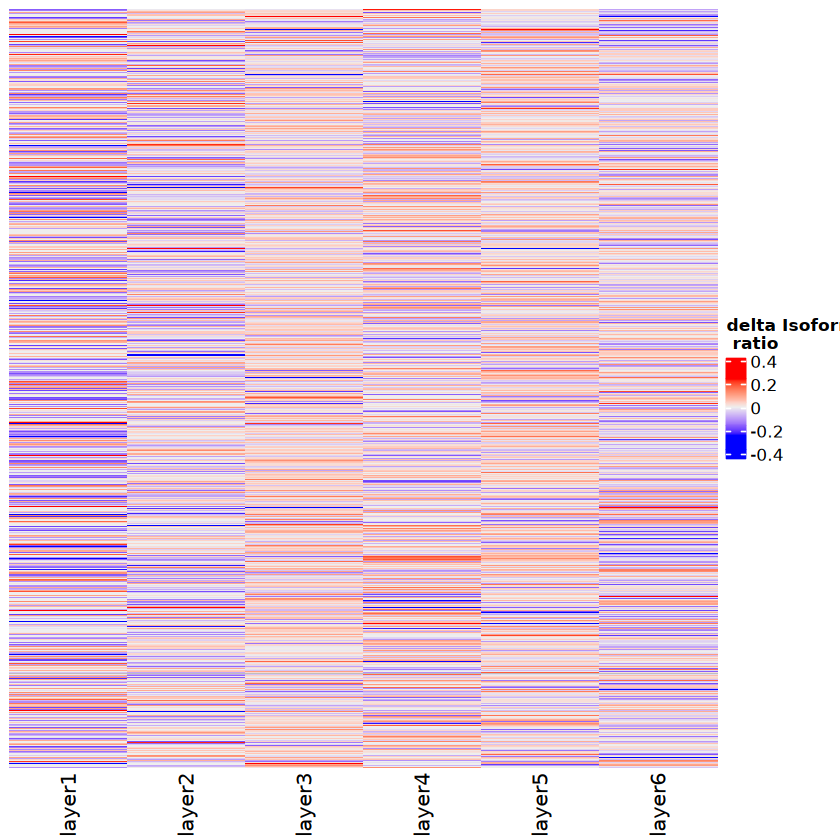

In [31]:
isosigf.mx1.or = isosigf.mx1
isosigf.mx1.or = as.data.frame(isosigf.mx1.or)
mxgroup = ""
for(i in 1:nrow(isosigf.mx1.or)){
    linei = unlist(isosigf.mx1.or[i,])
    upc = names(linei[linei > 0.1])
    upc = paste(upc,collapse = "-")
    upc = paste0("0","-",upc)

    # dpc = names(linei[linei < (-0.1)])
    # dpc = paste0(dpc,collapes = "-")
    # dpc = paste0("1","-",dpc)
    # lc = paste0(upc,"_",dpc)
    mxgroup = c(mxgroup,upc)
}
table(mxgroup)
isosigf.mx1.or = isosigf.mx1.or[order(mxgroup),]
pcloneht1 = Heatmap(as.matrix(isosigf.mx1.or),show_row_names = F,cluster_rows = F,cluster_columns = F,name = "delta Isoform\n ratio")
pcloneht1

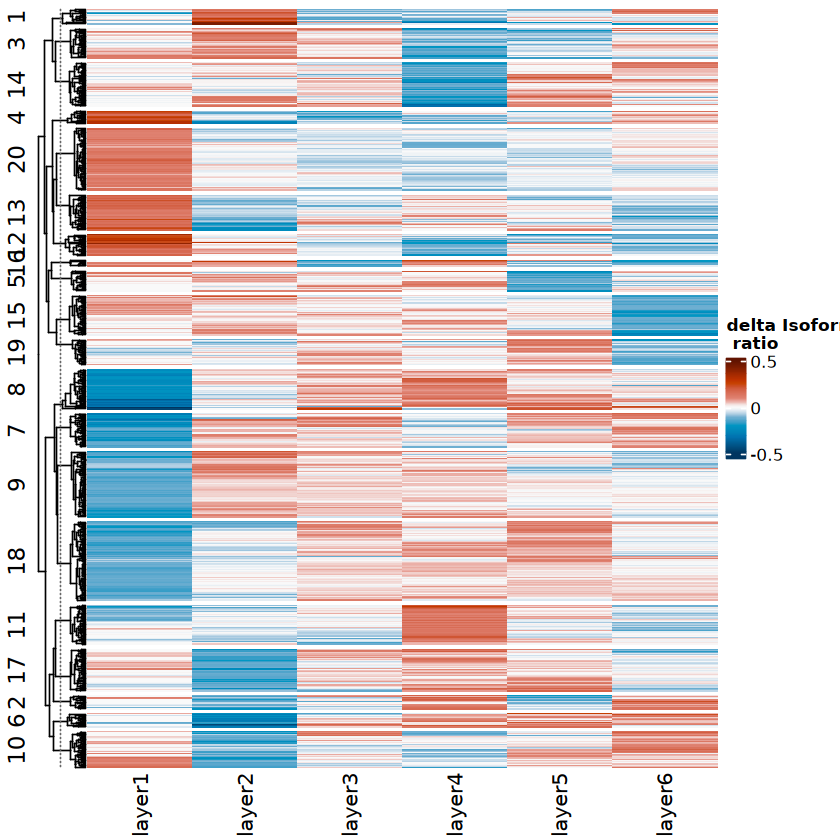

In [41]:
n = 20
isosigf.mx1f = isosigf.mx1[rowSums(isosigf.mx1 != 0) > 4,]
fit = kmeans(isosigf.mx1f,n)
split <- factor(as.character(fit$cluster), levels=as.character(c(1:n)))
# 计算距离矩阵
# distances <- dist(isosigf.mx1)
# fit <- hclust(distances, method="ward.D2") # 你可以选择其他方法，如 "average", "single", "ward.D2" 等
# clusters <- cutree(fit, k=n)
# split <- factor(as.character(clusters), levels=as.character(c(1:n)))

library(circlize)
col_fun = colorRamp2(c(-0.5, -0.1, 0, 0.1, 0.5), hcl_palette = "RdBu",reverse = T)
isosigf.mx1f = as.matrix(isosigf.mx1f)
pcloneht1 = Heatmap(isosigf.mx1f,show_row_names = F,row_split = split,cluster_columns = F,name = "delta Isoform\n ratio",col = col_fun)
pcloneht1

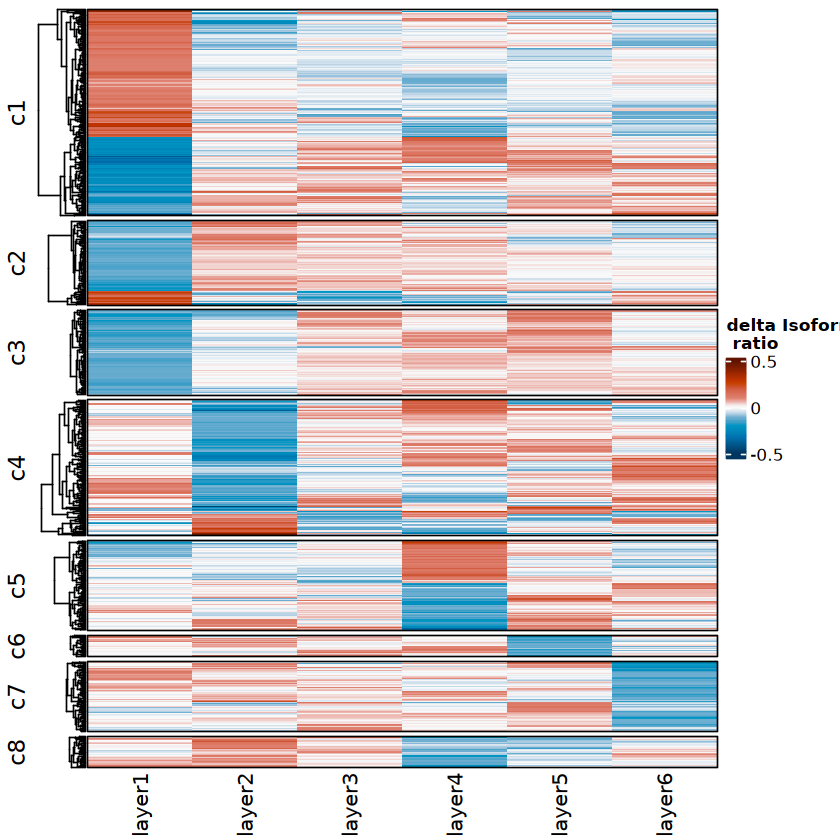

In [55]:
clist = list(c1 = c(7,13,8,12,20),
             c2 = c(9,4),
             c3 = c(18),
             c4 = c(10,16,17,2,6,1),
             c5 = c(11,14),
             c6 = c(5),
             c7 = c(15,19),
             c8 = c(3))
split <- fit$cluster
for (i in 1:length(clist)) {
    split[which(split %in% clist[[i]])] = names(clist)[i]
}
  
split <- factor(as.character(split), levels=names(clist))
names(split) = names(fit$cluster)
col_fun = colorRamp2(c(-0.5, -0.1, 0, 0.1, 0.5), hcl_palette = "RdBu",reverse = T)
pcloneht1 = Heatmap(isosigf.mx1f,show_row_names = F,row_split = split,
                    cluster_columns = F,cluster_row_slices = F,
                    border = T,
                    name = "delta Isoform\n ratio",col = col_fun)
pcloneht1

In [82]:
ggexport(pcloneht1,filename = "result/figure2/layer_sig_iso_clone_heatmap_11_29.pdf",width = 4,height = 6)

file saved to result/figure2/layer_sig_iso_clone_heatmap_11_29.pdf



In [58]:
clusteran = data.frame("cluster" = split,"transcript_id" = rownames(isosigf.mx1f))
isosigf2$cluster = clusteran[match(isosigf2$transcript_id,clusteran$transcript_id),]$cluster
clusteran = unique(isosigf2[,c("gene_id","transcript_id","cluster")])
clusteran[clusteran$gene_id %in% c("DDRGK1","ARPP21","ARPP19"),]
#write.csv(clusteran,file = "result/figure2/sigiso_layer_transcript_dr_cluster_tab_08_25.csv",row.names = F, quote = F)

gene_id,transcript_id,cluster
<chr>,<chr>,<fct>
ARPP19,NM_001283415.1,c2
ARPP21,XM_015444956.1,c3
DDRGK1,DDRGK1-WeiLab-1,c8


[1] 1283
[1] 760


,auditory,cingulate,occipital,parietal,somatosensory,temporal
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ACBD7-WeiLab-1,-0.069549496,-0.044522758,-0.003700283,0.01167257,0.12836906,-0.02226909
AP4B1-WeiLab-1,-0.143714919,0.024724651,0.013996558,-0.03647061,0.10515228,0.03631204
ASPHD1-WeiLab-1,-0.115495138,0.020082475,0.098211426,-0.01710699,0.03599514,-0.02168691
ATG7-WeiLab-1,0.129406737,-0.008247318,-0.146462490,0.03282636,0.07204559,-0.07956887
BambuGene113631-WeiLab-4,-0.102094085,0.015148486,-0.043993993,-0.06188228,0.20385897,-0.01103709
BambuGene116686-WeiLab-6,-0.008627867,-0.077106127,-0.022817056,-0.04742097,0.18175675,-0.02578473


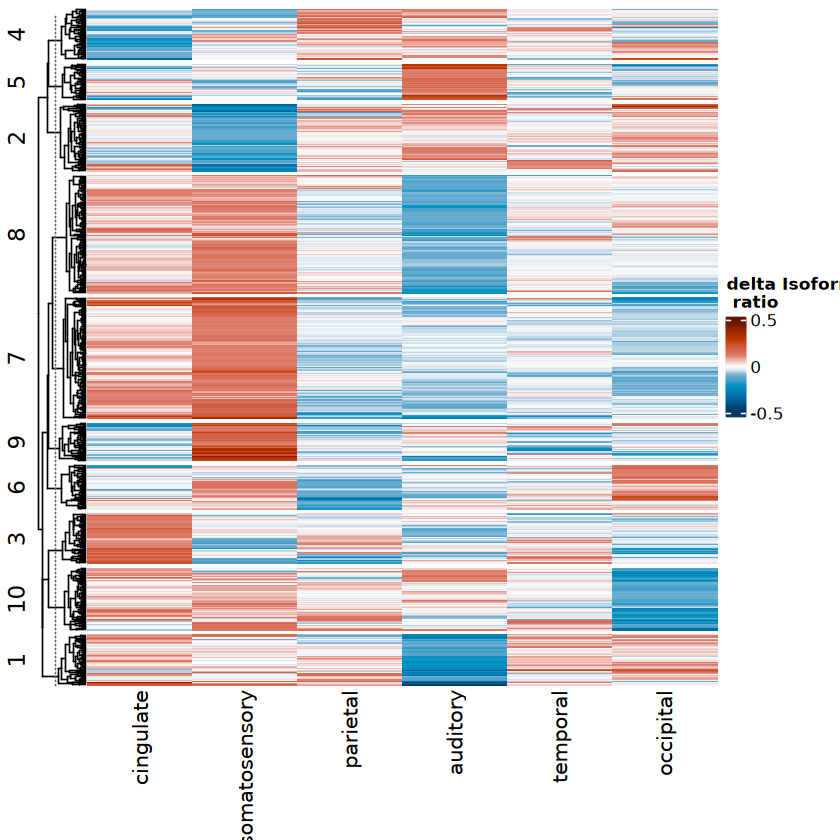

In [146]:
isosigi = isosigls$lobe
hubtrans = unique(isosigi[isosigi$sig %in% c("Up","Down"),]$transcript_id)
isosigf2 = isosigi[isosigi$transcript_id %in% hubtrans,]
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$transcript_id)))
isosigf2 = isosigf2 %>% group_by(gene_id) %>% filter(meanrelative == max(meanrelative))
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$gene_id)))
isosigf.mx1 = dcast(isosigf2,transcript_id~areatr,value.var = "dr",fun.aggregate = sum)
rownames(isosigf.mx1) = isosigf.mx1$transcript_id;isosigf.mx1 = isosigf.mx1[-1]
head(isosigf.mx1)
n = 10
isosigf.mx1f = isosigf.mx1[rowSums(isosigf.mx1 != 0) > 4,]
fit = kmeans(isosigf.mx1f,n)
split <- factor(as.character(fit$cluster), levels=as.character(c(1:n)))
isosigf.mx1f = isosigf.mx1f[,lobeorder]
# 计算距离矩阵
# distances <- dist(isosigf.mx1)
# fit <- hclust(distances, method="ward.D2") # 你可以选择其他方法，如 "average", "single", "ward.D2" 等
# clusters <- cutree(fit, k=n)
# split <- factor(as.character(clusters), levels=as.character(c(1:n)))

library(circlize)
col_fun = colorRamp2(c(-0.5, -0.1, 0, 0.1, 0.5), hcl_palette = "RdBu",reverse = T)
isosigf.mx1f = as.matrix(isosigf.mx1f)
pcloneht1 = Heatmap(isosigf.mx1f,show_row_names = F,row_split = split,cluster_columns = F,name = "delta Isoform\n ratio",col = col_fun)
pcloneht1

file saved to result/figure2/lobe_sig_iso_clone_heatmap_11_29.pdf



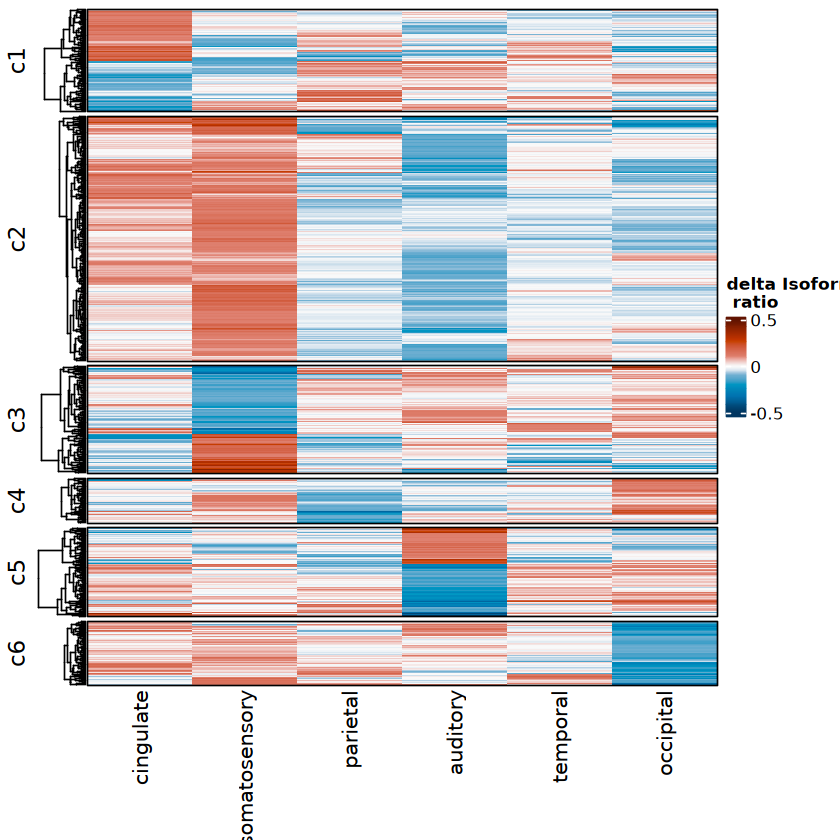

In [158]:
clist = list(c1 = c(3,4),
             c2 = c(7,8),
             c3 = c(9,2),
             c4 = c(6),
             c5 = c(5,1),
             c6 = c(10))
split <- fit$cluster
for (i in 1:length(clist)) {
    split[which(split %in% clist[[i]])] = names(clist)[i]
}
  
split <- factor(as.character(split), levels=names(clist))
names(split) = names(fit$cluster)
col_fun = colorRamp2(c(-0.5, -0.1, 0, 0.1, 0.5), hcl_palette = "RdBu",reverse = T)
pcloneht1 = Heatmap(isosigf.mx1f,show_row_names = F,row_split = split,
                    cluster_columns = F,cluster_row_slices = F,
                    border = T,
                    name = "delta Isoform\n ratio",col = col_fun)
pcloneht1
ggexport(pcloneht1,filename = "result/figure2/lobe_sig_iso_clone_heatmap_11_29.pdf",width = 3.7,height = 6)

In [159]:
#clusteran = read.csv("result/figure2/sigiso_layer_transcript_dr_cluster_tab_08_25.csv")
clusteran = data.frame("cluster" = split,"transcript_id" = rownames(isosigf.mx1f))
isosigf2$cluster = clusteran[match(isosigf2$transcript_id,clusteran$transcript_id),]$cluster
clusteran = unique(isosigf2[,c("gene_id","transcript_id","cluster")])
unique(clusteran[clusteran$cluster == "c2",]$gene_id)
write.csv(clusteran,file = "result/figure2/sigiso_lobe_transcript_dr_cluster_tab_11_25.csv",row.names = F, quote = F)

[1] "AAGAB"           "ACBD7"           "ACTR3B"          "ACTR6"          
  [5] NA                "ADGRB3"          "ADIPOR2"         "AGBL4"          
  [9] "AIFM1"           "AKAP7"           "ANO4"            "AP4B1"          
 [13] "ARFGEF1"         "ARHGAP44"        "ARHGEF10L"       "ARMC9"          
 [17] "ARMCX5"          "ASPHD1"          "ASXL1"           "ATP13A4"        
 [21] "ATP6V1C1"        "AUTS2"           "BambuGene113631" "BambuGene130649"
 [25] "BATF3"           "BAZ2B"           "BCLAF1"          "BICD1"          
 [29] "C6H5orf28"       "C7H15orf41"      "CACNB2"          "CAPN1"          
 [33] "CBY1"            "CCNH"            "CCNL1"           "CDC42BPB"       
 [37] "CDK14"           "CEP57L1"         "CEP85"           "CFLAR"          
 [41] "CHD5"            "CHD8"            "CHKB"            "CNTNAP4"        
 [45] "COL4A3BP"        "CORO1C"          "CREBBP"          "CREBRF"         
 [49] "CRYZL1"          "CUL2"            "CYTH1"           "DARS"           
 [53] "DCTN4"           "DCUN1D1"         "DLG2"            "DMD"            
 [57] "DNAJB4"          "DNAJC14"         "DNAJC24"         "DOCK3"          
 [61] "DOCK9"           "DROSHA"          "DYNC1I1"         "DZIP3"          
 [65] "ECHDC1"          "EDEM3"           "ELMO1"           "EPHA7"          
 [69] "EPS15"           "FAM104A"         "FAM118B"         "FAM179B"        
 [73] "FAM210A"         "FAM217B"         "FAM234A"         "FAM73A"         
 [77] "FAM76A"          "FAT1"            "FBXO8"           "FGFR1OP"        
 [81] "FGGY"            "FKBP7"           "FKTN"            "FNBP1L"         
 [85] "FRMPD4"          "FUK"             "FUS"             "FXN"            
 [89] "GAPVD1"          "GCN1"            "GGT7"            "GPAM"           
 [93] "GPATCH8"         "GRAMD3"          "GRIN2B"          "GRIP1"          
 [97] "HERC1"           "HIPK3"           "HOMER2"          "HP1BP3"         
[101] "HTR1E"           "IBTK"            "IKBKG"           "INTS10"         
[105] "IWS1"            "KANSL3"          "KCNIP4"          "KCTD15"         
[109] "KDM8"            "KIAA0430"        "KIAA1468"        "LDB2"           
[113] "LOC101866062"    "LOC101926672"    "LOC102114773"    "LOC102118851"   
[117] "LOC102123156"    "LOC102123623"    "LOC102125373"    "LOC102139156"   
[121] "LOC102139567"    "LOC102140686"    "LOC102143459"    "LOC107126456"   
[125] "LOC107126752"    "LOC107127703"    "LOC107127721"    "LOC107128496"   
[129] "MACROD2"         "MAPKAP1"         "MARK2"           "MCF2"           
[133] "METTL17"         "METTL5"          "MGAT1"           "MICU1"          
[137] "MKL2"            "MOB1B"           "MPP6"            "MPRIP"          
[141] "MRO"             "MSANTD4"         "MSRA"            "MUTYH"          
[145] "NAE1"            "NDUFS1"          "NOP2"            "NRCAM"          
[149] "OFD1"            "OLIG1"           "ORC4"            "PAK3"           
[153] "PARP11"          "PDE10A"          "PDS5A"           "PER3"           
[157] "PEX19"           "PGGT1B"          "PHACTR3"         "PHF3"           
[161] "PID1"            "PKM"             "PLPPR5"          "PMS2"           
[165] "PPFIA2"          "PPP1R12B"        "PPP2R2B"         "PSMD12"         
[169] "PUDP"            "RAB3C"           "RAB3IP"          "RALGAPA1"       
[173] "RARB"            "RBFOX2"          "RBM33"           "RBM45"          
[177] "RERE"            "RFWD2"           "RGN"             "RHBDD1"         
[181] "RIMS1"           "RNF19B"          "RNMT"            "RPE"            
[185] "RSPRY1"          "RUFY2"           "SEC14L2"         "SEC23B"         
[189] "SESN3"           "SETD6"           "SETD9"           "SETX"           
[193] "SFXN5"           "SGIP1"           "SH3GL3"          "SHROOM3"        
[197] "SLC25A12"        "SLC35G2"         "SLC4A10"         "SLMAP"          
[201] "SMAD5"           "SMARCE1"         "SMU1"            "SNAP23"         
[205] "SNX1"            

In [151]:
#GO analysis
#try GO analysis
library(ggsci)
library(gprofiler2)
MyGOPlot = function(hubgenei,ni,mytitle,mycolor = NULL){
    goi = gost(query = hubgenei,
               organism = "mfascicularis")
#godfi = CalOddRate(goi$result,5)
    godfi = goi$result
    godfi$gene_ratio = godfi$intersection_size/godfi$term_size
#godfi = godfi[godfi$p_value < 0.05,]
    godfi = godfi[godfi$intersection_size > 2,] %>% group_by(source) %>% arrange(gene_ratio) %>% 
    top_n(wt = gene_ratio,n = ni)
    godfi$term_name = factor(godfi$term_name,levels = unique(godfi$term_name))
    print(nrow(godfi))

    if(is.null(mycolor)){
        mycolor = pal_flatui("default")(length(unique(godfi$source)))
    }
    godfi = godfi[!godfi$term_name %in% c("cell junction","cytoplasm","cytosol","cytoskeleton"),]
    if(nrow(godfi) > 0){
        pgi = ggplot(godfi,
               aes(x = gene_ratio, y=term_name,fill = source)) + 
        geom_point(aes(size = intersection_size),shape = 21) +
        geom_bar(stat = "identity",width = 0.03) +
        geom_text(aes(label = term_name,x = 0),hjust = -0.01,vjust = -0.5) +
        scale_fill_manual(values = mycolor) +
 #       scale_fill_viridis(direction = 1,option = "A") +
        #scale_fill_distiller(direction = 1,palette = "Greens") +
    # scale_y_discrete(labels = rev(unique(godftf$term_name))) +
    #facet_grid(source~.,scales = "free",space = "free") + 
        xlab("gene counts") +
        theme_pubr() + theme(legend.position = "top",axis.text.y = element_blank()) +
        ggtitle(mytitle)
    }
    return(pgi)
    
}

MyGOCal = function(hubgenei,ni){
    goi = gost(query = hubgenei,sources = c("GO","KEGG","REAC","WP","TF","HPA","HP"),
               organism = "mfascicularis")
#godfi = CalOddRate(goi$result,5)
    godfi = goi$result
    if(is.null(godfi)) return(NULL)
    godfi$gene_ratio = godfi$intersection_size/godfi$term_size
#godfi = godfi[godfi$p_value < 0.05,]
    
    godfi = godfi[godfi$intersection_size > 2,]
    
    godfi = godfi %>% group_by(source) %>% arrange(gene_ratio) %>% 
    top_n(wt = gene_ratio,n = ni)
    godfi$term_name = factor(godfi$term_name,levels = unique(godfi$term_name))
    print(nrow(godfi))

    godfi = godfi[!godfi$term_name %in% c("cell junction","cytoplasm","cytosol","cytoskeleton"),]

    return(godfi)
    
}


#ggexport(pgi,filename = "result/figure3/sigiso_class_transcript_dr_cluster_heatmap_NN_GO_24_04_21.pdf",width = 4,height = 8)
nrow(clusteran)
clusteran = clusteran[!is.na(clusteran$cluster),]
nrow(clusteran)
clusterid = unique(clusteran$cluster)
mycolor = pal_flatui("default")(5)
names(mycolor) = c("GO:BP","GO:MF","GO:CC","HP","KEGG")

pgls = list()
godft = NULL
for(i in 1:length(clusterid)){
    hubgenei = unique(clusteran[as.character(clusteran$cluster) == clusterid[i],]$gene_id)
    godfi = MyGOCal(hubgenei,5)
    godfi$group = clusterid[i]
    godft = rbind(godft,godfi)
}



[1] 760

[1] 693

[1] 7
[1] 13
[1] 4


No results to show
Please make sure that the organism is correct or set significant = FALSE



[1] 1
[1] 2


[1] 20


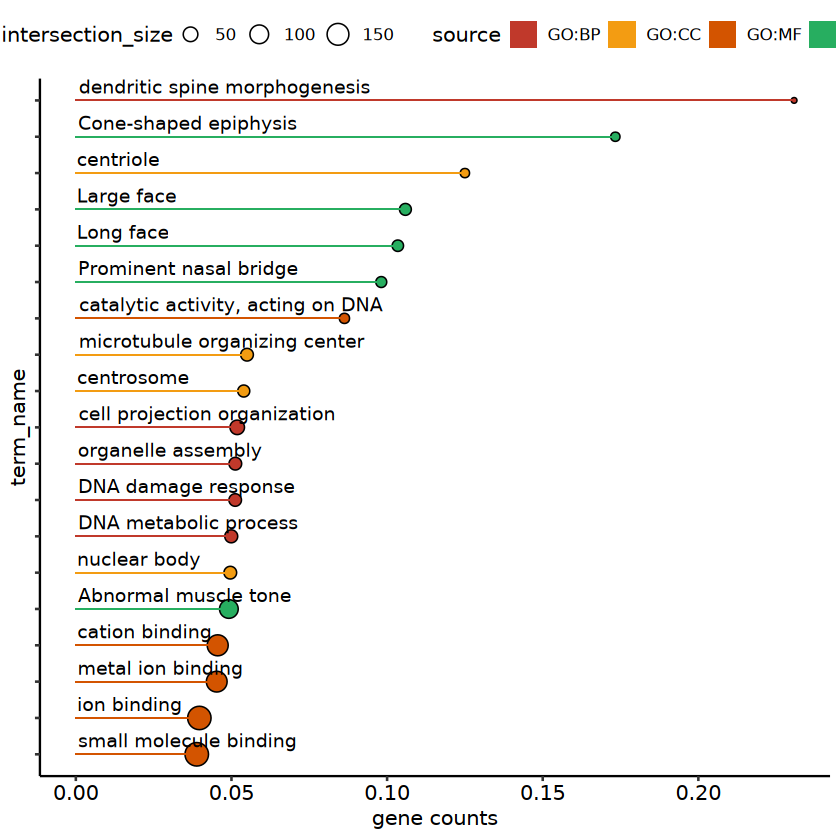

In [153]:
hubgenei = unique(clusteran$gene_id)
#hubgenei
godfi = MyGOCal(hubgenei,5)
#godfi
pgi = ggplot(godfi,
               aes(x = gene_ratio, y=term_name,fill = source)) + 
        geom_point(aes(size = intersection_size),shape = 21) +
        geom_bar(stat = "identity",width = 0.03) +
        geom_text(aes(label = term_name,x = 0),hjust = -0.01,vjust = -0.5) +
        scale_fill_manual(values = mycolor) +
 #       scale_fill_viridis(direction = 1,option = "A") +
        #scale_fill_distiller(direction = 1,palette = "Greens") +
    # scale_y_discrete(labels = rev(unique(godftf$term_name))) +
    #facet_grid(source~.,scales = "free",space = "free") + 
        xlab("gene counts") +
        theme_pubr() + theme(legend.position = "top",axis.text.y = element_blank())
pgi

Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_point()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_text()`)."


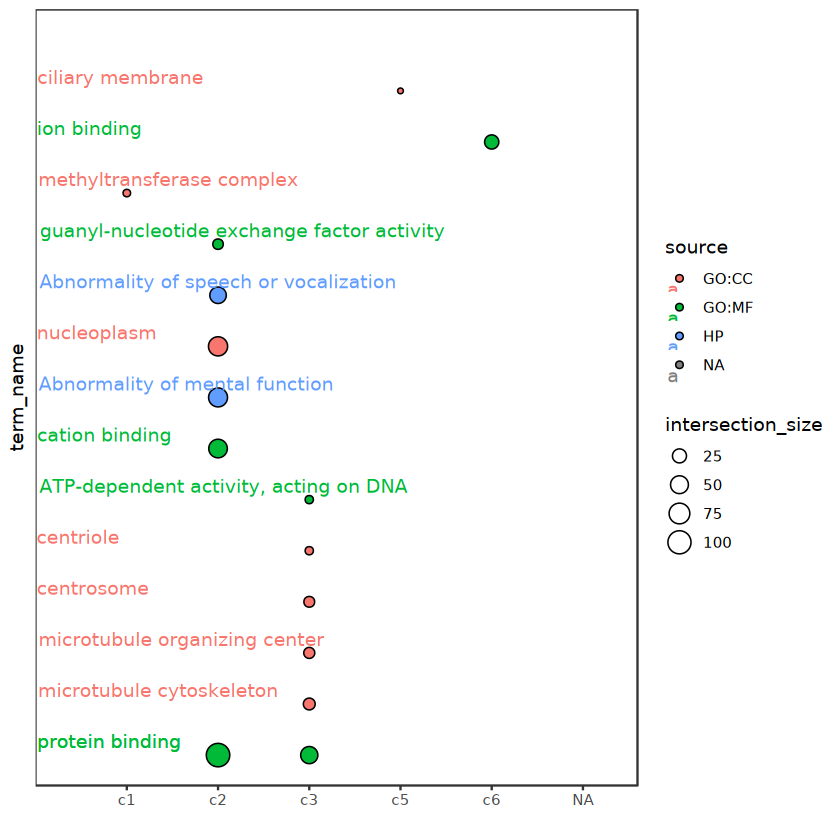

In [152]:
pgot = ggplot(data = godft[godft$source != "GO:BP",]) + 
     # geom_rect(data = unique(godft[,c("term_name","source")]),
     #                               aes(ymin = as.numeric(term_name)-0.5,ymax = as.numeric(term_name)+0.5,
     #                                                        xmin = -Inf,xmax = Inf,fill = source),
     #            alpha = 0.2) +
    geom_point(aes(x = group,y = term_name,size = intersection_size,fill = source),shape = 21,color = "black") +
    geom_text(aes(y = term_name,label = term_name,x = 0,color = source),hjust = -0.01,vjust = -0.5) +
        #scale_fill_manual(values = mycolor) + 
    #scale_color_manual(values = mycolor) +
#    facet_grid(group~.,scales = "free",space = "free") +
    theme_bw() +
    theme(axis.text.y = element_blank(),
       axis.ticks.y = element_blank(),
      panel.spacing = unit(0,'lines'),
      panel.grid.major = element_blank(),
      #panel.grid.minor = element_blank(),
      panel.border = element_rect(fill = NA)) + xlab("")
pgot

[1] 928

[1] 33


file saved to result/figure2/sigiso_layer_transcript_dr_GO_24_09_10.pdf



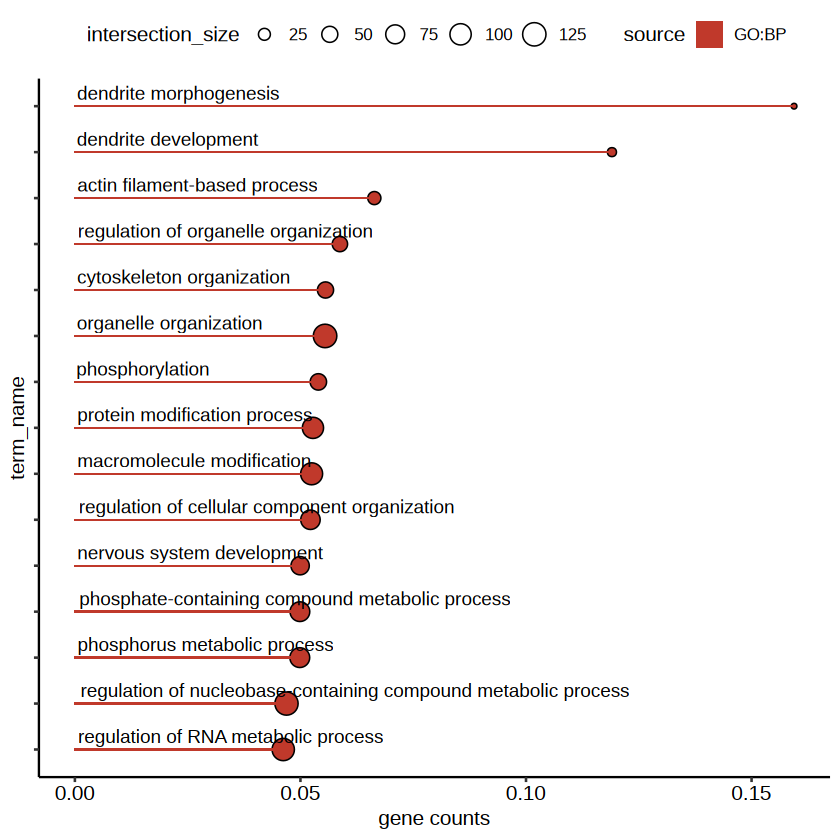

In [395]:
#hubgenei = unique(isosigi.mx[abs(isosigi.mx$dr) > 0.1 & isosigi.mx$pvalue < 0.05,]$gene_id)
#length(hubgenei)
#godft = MyGOCal(hubgenei,5)
#godft
isosigi = isosigls$layer
isosighubi = isosigi[!isosigi$sig %in% "N",]
hubgenest = unique(isosighubi$gene_id)
write.csv(isosighubi,file = "result/figure2/layer_dtu_list_09_09.csv",row.names = F)

length(hubgenest)
godfi = MyGOCal(hubgenest,15)
mycolor = pal_flatui("default")(length(unique(godfi$source)))
pgi = ggplot(godfi[!godfi$source %in% c("GO:CC","GO:MF","HP"),],
               aes(x = gene_ratio, y=term_name,fill = source)) + 
        geom_point(aes(size = intersection_size),shape = 21) +
        geom_bar(stat = "identity",width = 0.03) +
        geom_text(aes(label = term_name,x = 0),hjust = -0.01,vjust = -0.5) +
        scale_fill_manual(values = mycolor) +
 #       scale_fill_viridis(direction = 1,option = "A") +
        #scale_fill_distiller(direction = 1,palette = "Greens") +
    # scale_y_discrete(labels = rev(unique(godftf$term_name))) +
    #facet_grid(source~.,scales = "free",space = "free") + 
        xlab("gene counts") +
        theme_pubr() + theme(legend.position = "top",axis.text.y = element_blank())
pgi

ggexport(pgi,filename = "result/figure2/sigiso_layer_transcript_dr_GO_24_09_10.pdf",width = 4,height = 5)

[1] 760

[1] 40


file saved to result/figure2/sigiso_lobe_transcript_dr_GO_24_09_10.pdf



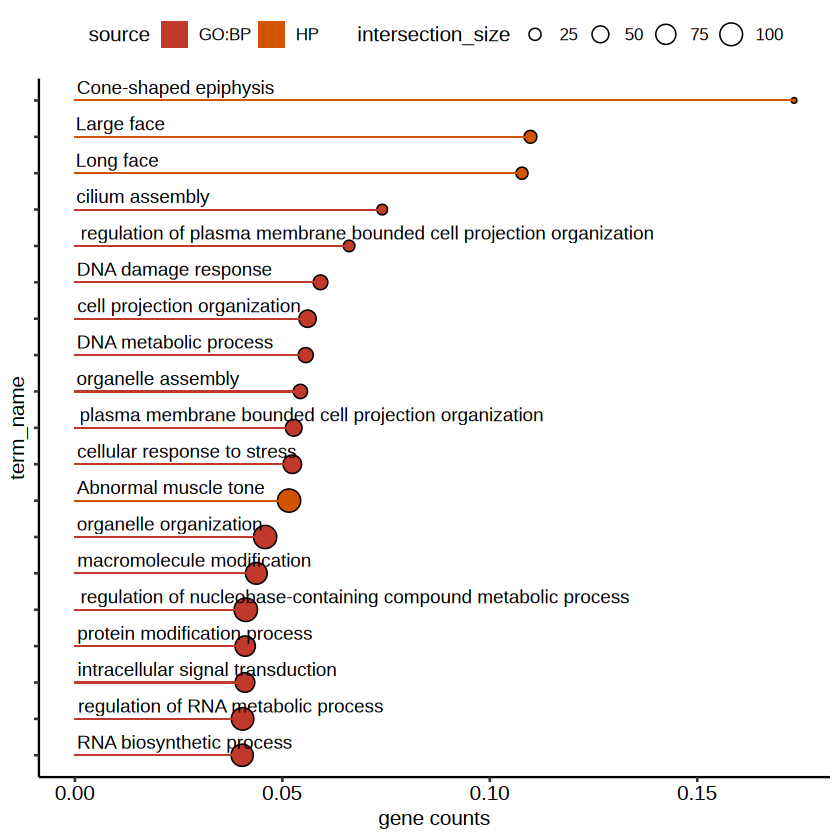

In [397]:
isosigi = isosigls$lobe
isosighubi = isosigi[!isosigi$sig %in% "N",]
hubgenest = unique(isosighubi$gene_id)
write.csv(isosighubi,file = "result/figure2/lobe_dtu_list_09_09.csv",row.names = F)

length(hubgenest)
godfi = MyGOCal(hubgenest,15)
mycolor = pal_flatui("default")(length(unique(godfi$source)))
pgi = ggplot(godfi[!godfi$source %in% c("GO:CC","GO:MF"),],
               aes(x = gene_ratio, y=term_name,fill = source)) + 
        geom_point(aes(size = intersection_size),shape = 21) +
        geom_bar(stat = "identity",width = 0.03) +
        geom_text(aes(label = term_name,x = 0),hjust = -0.01,vjust = -0.5) +
        scale_fill_manual(values = mycolor) +
 #       scale_fill_viridis(direction = 1,option = "A") +
        #scale_fill_distiller(direction = 1,palette = "Greens") +
    # scale_y_discrete(labels = rev(unique(godftf$term_name))) +
    #facet_grid(source~.,scales = "free",space = "free") + 
        xlab("gene counts") +
        theme_pubr() + theme(legend.position = "top",axis.text.y = element_blank())
pgi

ggexport(pgi,filename = "result/figure2/sigiso_lobe_transcript_dr_GO_24_09_10.pdf",width = 4,height = 5)

[1] 4520
[1] 2540


Warning message:
"did not converge in 10 iterations"
`use_raster` is automatically set to TRUE for a matrix with more than
2000 rows. You can control `use_raster` argument by explicitly setting
TRUE/FALSE to it.

Set `ht_opt$message = FALSE` to turn off this message.

file saved to result/figure2/region_sig_iso_clone_heatmap_12_21.pdf



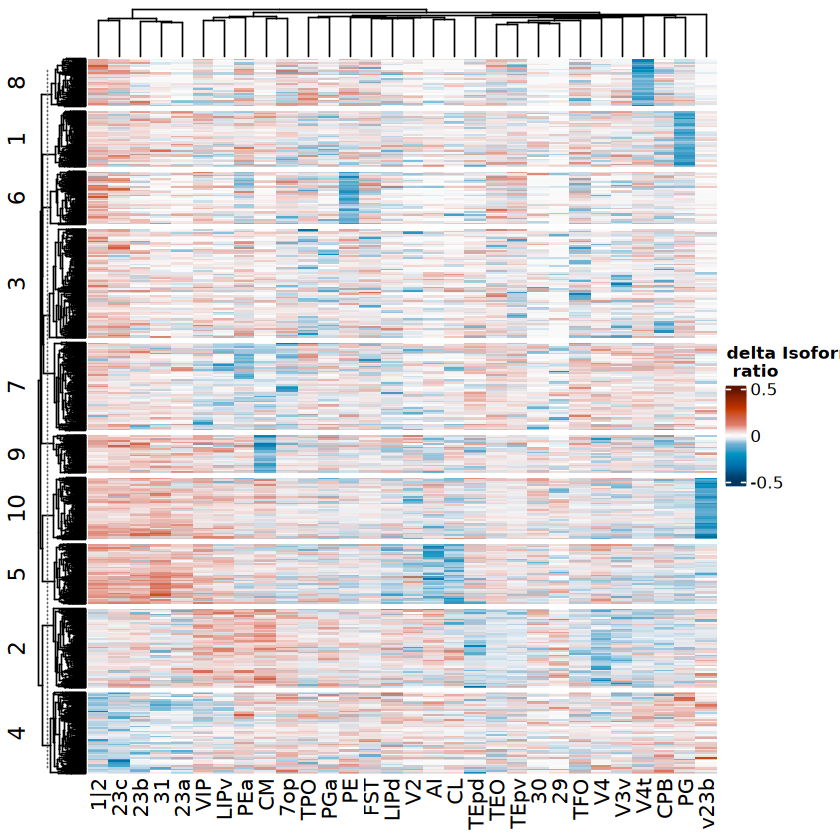

In [22]:
isosigi = isosigls$region
hubtrans = unique(isosigi[isosigi$sig %in% c("Up","Down"),]$transcript_id)
isosigf2 = isosigi[isosigi$transcript_id %in% hubtrans,]
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$transcript_id)))
isosigf2 = isosigf2 %>% group_by(gene_id) %>% filter(meanrelative == max(meanrelative))
isosigf2$dr2 = isosigf2$relative - isosigf2$meanrelative
print(length(unique(isosigf2$gene_id)))
isosigf.mx1 = dcast(isosigf2,transcript_id~areatr,value.var = "dr",fun.aggregate = sum)
rownames(isosigf.mx1) = isosigf.mx1$transcript_id;isosigf.mx1 = isosigf.mx1[-1]
#head(isosigf.mx1)
n = 10
isosigf.mx1f = isosigf.mx1[rowSums(isosigf.mx1 != 0) > 4,]
fit = kmeans(isosigf.mx1f,n)
split <- factor(as.character(fit$cluster), levels=as.character(c(1:n)))
isosigf.mx1f = isosigf.mx1f[,regionorder]
# 计算距离矩阵
# distances <- dist(isosigf.mx1)
# fit <- hclust(distances, method="ward.D2") # 你可以选择其他方法，如 "average", "single", "ward.D2" 等
# clusters <- cutree(fit, k=n)
# split <- factor(as.character(clusters), levels=as.character(c(1:n)))

library(circlize)
col_fun = colorRamp2(c(-0.5, -0.1, 0, 0.1, 0.5), hcl_palette = "RdBu",reverse = T)
isosigf.mx1f = as.matrix(isosigf.mx1f)
pcloneht1 = Heatmap(isosigf.mx1f,show_row_names = F,row_split = split,cluster_columns = T,
                    name = "delta Isoform\n ratio",col = col_fun)
pcloneht1
ggexport(pcloneht1,filename = "result/figure2/region_sig_iso_clone_heatmap_12_21.pdf",width = 5,height = 5)

#### stat layer difference in gene and isoform level

In [236]:
#stat layer difference in gene and isoform level
mkgene.layer = mkls$layer
colnames(mkgene.layer)[7] = "gene_id"
mkgene.layer = mkgene.layer[mkgene.layer$avg_log2FC > 0.5 & mkgene.layer$p_val_adj < 0.05 & mkgene.layer$pct.1 > 0.25, ]

isosigi = isosigls$layer
isosigi = isosigi[isosigi$sig == "Up", ]
table(mkgene.layer$cluster)
table(isosigi$areatr)


 l1  l2  l3  l4  l5  l6 
546 235 152 141 126 426 


 l1  l2  l3  l4  l5  l6 
172  35  27  30  21  48 

In [238]:
#stat lobe difference in gene and isoform level
mkgene.lobe = mkls$lobe
colnames(mkgene.lobe)[7] = "gene_id"
mkgene.lobe = mkgene.lobe[mkgene.lobe$avg_log2FC > 0.5 & mkgene.lobe$p_val_adj < 0.05 & mkgene.lobe$pct.1 > 0.25, ]

isosigi = isosigls$lobe
isosigi = isosigi[isosigi$sig == "Up", ]
table(mkgene.lobe$cluster)
table(isosigi$areatr)


somatosensory      parietal      auditory     occipital      temporal 
          440             2             7             1             1 
    cingulate 
           77 


     auditory     cingulate     occipital      parietal somatosensory 
           53            10             9            17            24 
     temporal 
            5 

In [249]:
mkgene.lobe[mkgene.lobe$cluster == "somatosensory" & mkgene.lobe$avg_log2FC > 0.5,]

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene_id
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
LOC102145362,5.493587e-116,0.5640546,0.982,0.944,3.117391e-111,somatosensory,LOC102145362
BambuGene132304,7.358183e-108,0.5522257,0.996,0.983,4.175475e-103,somatosensory,BambuGene132304
LOC102128139,7.501279e-108,0.5522265,0.996,0.983,4.256676e-103,somatosensory,LOC102128139
LOC102123920,5.048417e-102,0.5877243,0.963,0.904,2.864775e-97,somatosensory,LOC102123920
CHCHD10,2.783335e-90,0.6501677,0.968,0.909,1.579431e-85,somatosensory,CHCHD10
VPREB3,7.739288e-90,0.6480454,0.968,0.910,4.391736e-85,somatosensory,VPREB3
BambuGene85043,3.127124e-89,0.5144881,0.989,0.975,1.774518e-84,somatosensory,BambuGene85043
UBC,4.009473e-89,0.5139108,0.989,0.975,2.275216e-84,somatosensory,UBC
LOC102133162,4.801582e-89,0.6523402,0.963,0.894,2.724706e-84,somatosensory,LOC102133162


[1] "#DA7EC1" "#B1E753" "#89D6D3" "#B24CDD" "#8394D4" "#DAD38F" "#D97E65"
[8] "#D5C8CF" "#80DE9C"
# A tibble: 6 × 13
# Groups:   group [3]
  readid   seqnames  start    end width strand score group transcript_id readord
  <chr>    <fct>     <int>  <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 cb59d76… NW_0050…    219   1903  1685 +          0 temp… UBC-WeiLab-1  UBC-We…
2 2f1e6c2… NW_0050…    786   1903  1118 -          0 temp… UBC-WeiLab-1  UBC-We…
3 5d006ef… NW_0050…    859   1903  1045 -          0 cing… UBC-WeiLab-1  UBC-We…
4 835f81d… NC_0126…   2557   2886   330 +         45 cing… UBC-WeiLab-1  UBC-We…
5 4713618… NC_0126…   4360   5408  1049 -         60 pari… UBC-WeiLab-1  UBC-We…
6 03da210… NC_0222… 553122 553128     7 -         60 temp… UBC-WeiLab-1  UBC-We…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message in stats::qt(ci/2 + 0.5, data_sum$length - 1):
"NaNs produced"
Warning message:
"Removed 1104 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 974 rows containing mis

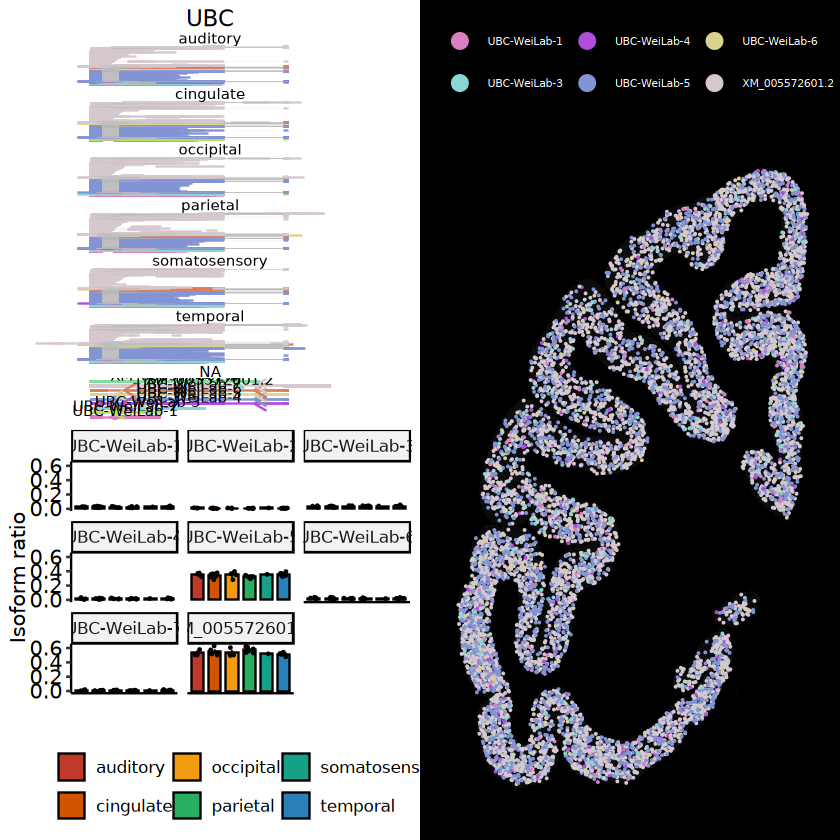

In [252]:
geneex = "UBC"
fileid = paste0("result/figure2/",geneex,"_lobe_case_24_04_05.pdf")
isosigi = isosigls$lobe
fsraw.cor$areatr = fsraw.cor$lobe
fsraw.cor$chunk = fsraw.cor$region
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex)
pc1
#ggexport(pc1,filename = fileid,width = 8,height = 6)

In [122]:
spdatals$dtu.st = list("dtustdf" = dtustdf,"figure" = p2.1)
qsave(spdatals,file = "result/figure2/spdata_an_ls_24_03_30.qs")

In [119]:
spdatals = qread("result/figure2/spdata_an_ls_24_03_30.qs")
spdatals$dtu.st$dtustdf

count,type,group,MarkerGene
<int>,<chr>,<chr>,<chr>
109,gene,layer,No
20,gene,layer,Yes
110,gene,lobe,No
2,gene,lobe,Yes
54,gene,layer&lobe,No
8,gene,layer&lobe,Yes
308,isoform,layer,No
97,isoform,layer,Yes
452,isoform,lobe,No


### DTU case Plot

#### Spatial case plot

In [78]:
pref = qread("../ref/area_figure_an.qs")
edgesdf = pref$areaedges

In [152]:
SpCasePlot = function(fsraw.cor,geneex,hubtrans,backpt,ptsize = 1,backsize = 0.05){
    mkdf = fsraw.cor[fsraw.cor$gene_id == geneex,]
    mkdf = mkdf[mkdf$transcript_id %in% hubtrans,]
    mkdf = mkdf[order(as.numeric(factor(mkdf$transcript_id,levels = hubtrans))),]
    mycolor = distinctColorPalette(length(hubtrans))
    #mkdf = mkdf[order(mkdf$transcript_id),]
    pmkpti1 = ggplot() +
      scattermore::geom_scattermore(
        data = backpt,
        aes(x,y),
        color = "white",
        # pixels = raster.dpi,
        pointsize = backsize
      ) +
      geom_point(data = mkdf,
                 aes(x,y,fill = transcript_id),shape = 21,size = ptsize,stroke = NA) + 
      # geom_segment(data = edgesdf, aes(x = x1, y = y1, xend = x2, yend = y2,color = areatr),
      #            size = 0.5,alpha = 0.75) + 
     # scale_size(range = c(0.05,0.1)) +
      #facet_wrap(~layer,nrow = 2) 
      theme_void() +
      scale_fill_discreterainbow() +
      #scale_fill_manual(values = mycolor) +
      #scale_color_flatui() +
      theme_presentation() + 
      theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 18)) +
      guides(color = guide_legend(override.aes = list(size=8),nrow = 3),
            fill = guide_legend(override.aes = list(size=8),nrow = 2),
            size = "none") +
      scale_y_reverse() + scale_x_reverse()
    return(pmkpti1)
}

file saved to result/figure2/DBNDD2_layer_case_bin1_24_10_23.pdf



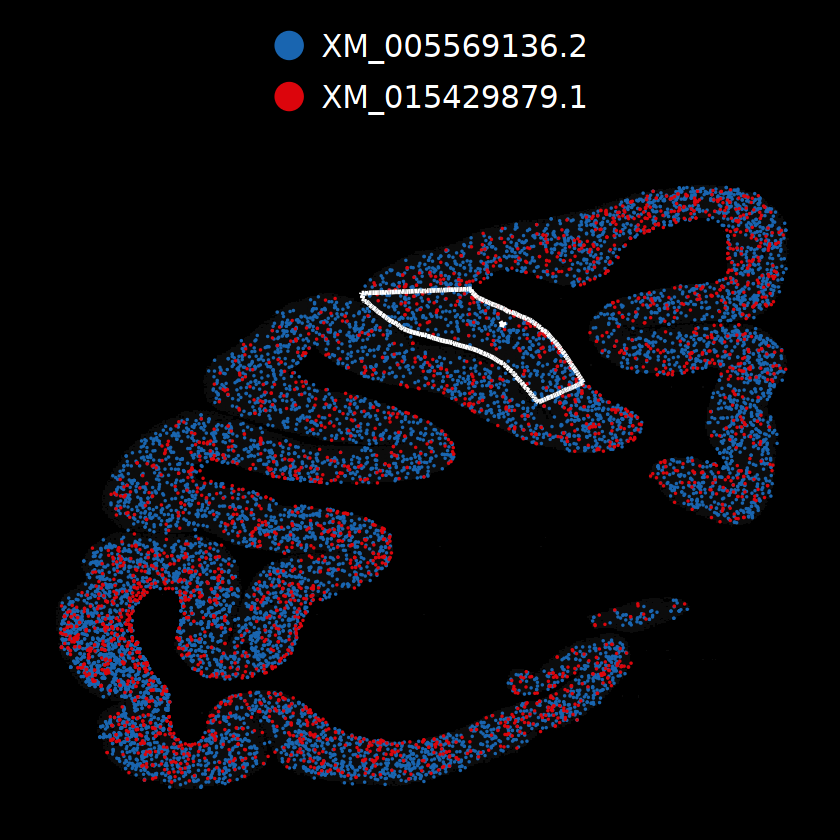

file saved to result/figure2/DBNDD2_layer_case_bin1_zoom_24_10_23.pdf



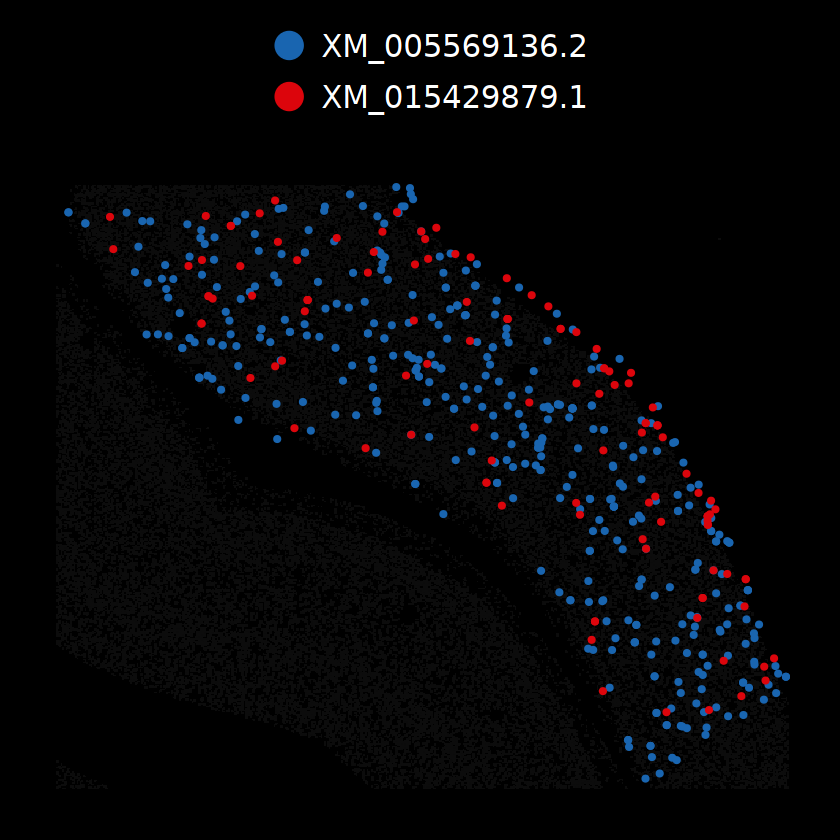

In [96]:
geneex = "DBNDD2"
transid = c("XM_005569136.2","XM_015429879.1")
edgesdf.zoom = edgesdf[edgesdf$areaid %in% "PEa",]
pc1 = SpCasePlot(fsraw.cor,geneex,transid,backpt,0.7)
pc1 = pc1 + geom_segment(data = edgesdf.zoom, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 1,alpha = 1,
                   color = "white")
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_10_23.pdf")
ggexport(pc1,filename = fileid,width = 4,height = 6)

fsraw.cor.zoom = fsraw.cor[fsraw.cor$region == "PEa",]
backpt.zoom = backpt[backpt$x < max(fsraw.cor.zoom$x) & backpt$x > min(fsraw.cor.zoom$x) &
                     backpt$y < max(fsraw.cor.zoom$y) & backpt$y > min(fsraw.cor.zoom$y),]
pc1.zoom = SpCasePlot(fsraw.cor.zoom,geneex,transid,backpt.zoom,2)
pc1.zoom
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_zoom_24_10_23.pdf")
ggexport(pc1.zoom,filename = fileid,width = 4,height = 6)

# isosigi = isosigls$layer
# fsraw.cor$areatr = fsraw.cor$layer
# fsraw.cor$chunk = fsraw.cor$lobe

# pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid)
# pcr
# pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
# pcc
# fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_24_08_24.pdf")
# ggexport(pcr,filename = fileid,width = 4,height = 6)
# fileid = paste0("result/figure2/",geneex,"_layer_case_boxstat_24_08_24.pdf")
# ggexport(pcc,filename = fileid,width = 4,height = 4)

file saved to result/figure2/DDRGK1_layer_case_bin1_24_11_29.pdf



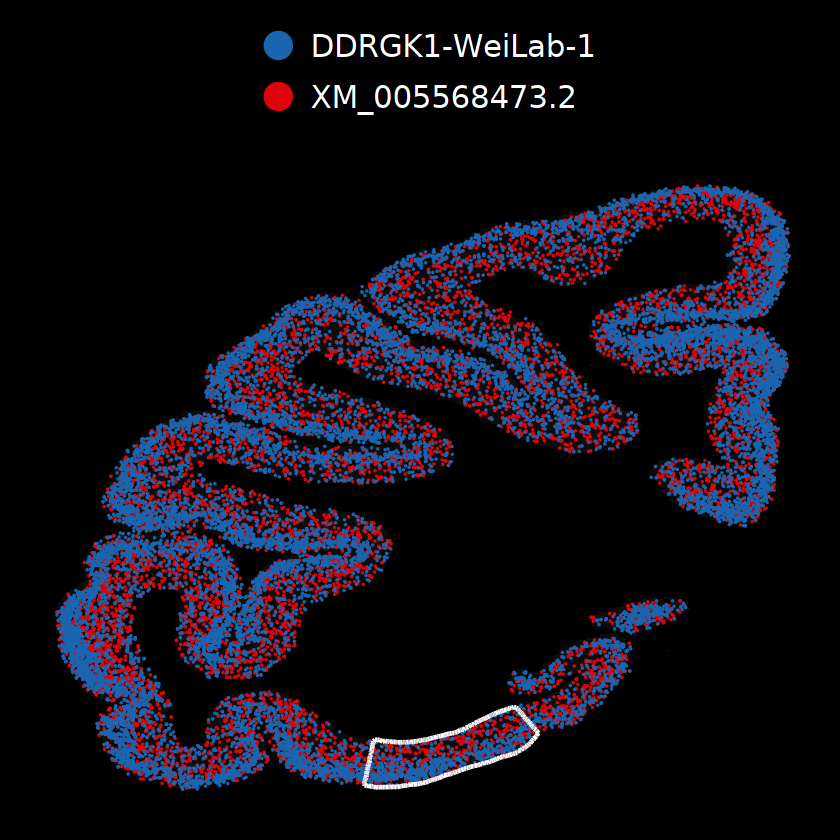

file saved to result/figure2/DDRGK1_layer_case_bin1_zoom_24_11_29.pdf



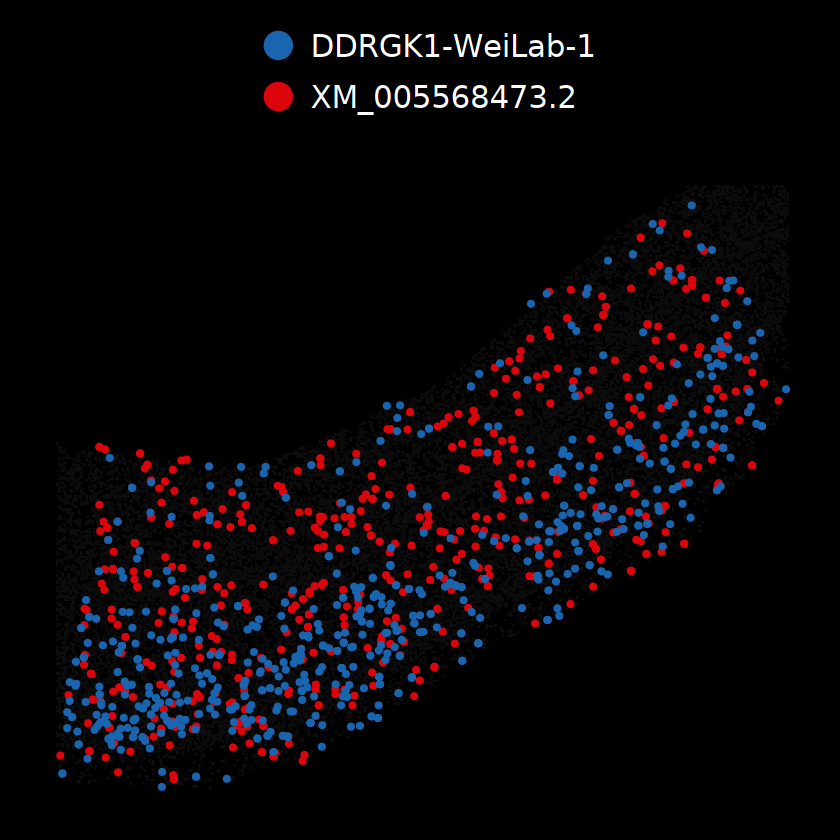

In [97]:
geneex = "DDRGK1"
transid = c("XM_005568473.2","DDRGK1-WeiLab-1")
edgesdf.zoom = edgesdf[edgesdf$areaid %in% "TFO",]
pc1 = SpCasePlot(fsraw.cor,geneex,transid,backpt,0.7)
pc1 = pc1 + geom_segment(data = edgesdf.zoom, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 1,alpha = 1,
                   color = "white")
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_11_29.pdf")
ggexport(pc1,filename = fileid,width = 4,height = 6)

fsraw.cor.zoom = fsraw.cor[fsraw.cor$region == "TFO",]
backpt.zoom = backpt[backpt$x < max(fsraw.cor.zoom$x) & backpt$x > min(fsraw.cor.zoom$x) &
                     backpt$y < max(fsraw.cor.zoom$y) & backpt$y > min(fsraw.cor.zoom$y),]
pc1.zoom = SpCasePlot(fsraw.cor.zoom,geneex,transid,backpt.zoom,2)
pc1.zoom
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_zoom_24_11_29.pdf")
ggexport(pc1.zoom,filename = fileid,width = 4,height = 6)


file saved to result/figure2/ARPP19_layer_case_bin1_24_11_29.pdf



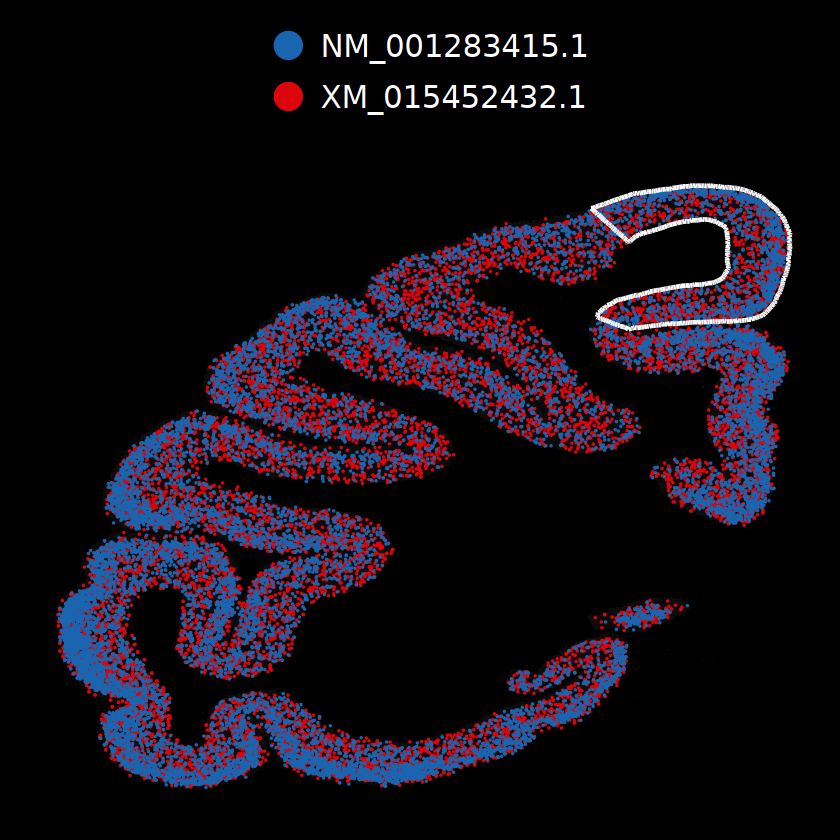

file saved to result/figure2/ARPP19_layer_case_bin1_zoom_24_11_29.pdf



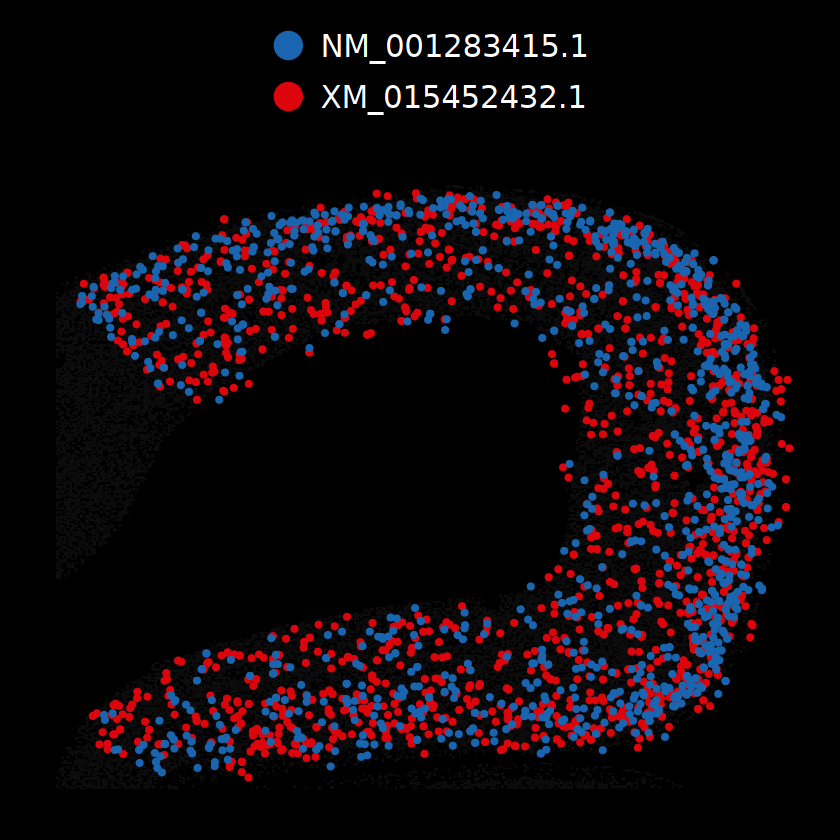

In [99]:
geneex = "ARPP19"
transid = c("XM_015452432.1","NM_001283415.1")
edgesdf.zoom = edgesdf[edgesdf$areaid %in% "1/2",]
pc1 = SpCasePlot(fsraw.cor,geneex,transid,backpt,0.7)
pc1 = pc1 + geom_segment(data = edgesdf.zoom, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 1,alpha = 1,
                   color = "white")
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_11_29.pdf")
ggexport(pc1,filename = fileid,width = 4,height = 6)

fsraw.cor.zoom = fsraw.cor[fsraw.cor$region == "1|2",]
backpt.zoom = backpt[backpt$x < max(fsraw.cor.zoom$x) & backpt$x > min(fsraw.cor.zoom$x) &
                     backpt$y < max(fsraw.cor.zoom$y) & backpt$y > min(fsraw.cor.zoom$y),]
pc1.zoom = SpCasePlot(fsraw.cor.zoom,geneex,transid,backpt.zoom,2)
pc1.zoom
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_zoom_24_11_29.pdf")
ggexport(pc1.zoom,filename = fileid,width = 4,height = 6)


In [256]:
isosigi = isosigls$lobe
unique(isosigi[isosigi$gene_id == "SDCCAG8",]$transcript_id)
isosigi = isosigi[isosigi$sig != "N",]
isosigi[isosigi$genecount > 500,]

[1] "XM_005539643.2" "XM_005539646.2" "XM_015433624.1" "XM_015433999.1"

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
5286,ATP6V1C1,NM_001285055.1,somatosensory,192,506,0.37944664,0.4665637,0.4839871,-0.1045405,Down,3.721499e-06,8.981818e-05
5292,ATP6V1C1,XM_005563847.2,somatosensory,314,506,0.62055336,0.5334363,0.5160129,0.1045405,Up,3.721499e-06,8.981818e-05
15873,CHD5,XM_005544937.2,somatosensory,178,749,0.23765020,0.3368159,0.3566490,-0.1189988,Down,1.738133e-09,9.325753e-08
15879,CHD5,XM_005544938.2,somatosensory,571,749,0.76234980,0.6631841,0.6433510,0.1189988,Up,1.738133e-09,9.325753e-08
20644,DNAJB4,XM_005542952.2,temporal,504,871,0.57864524,0.6662307,0.6837478,-0.1051026,Down,6.378096e-08,2.444353e-06
21065,DOCK3,XM_005547251.2,somatosensory,575,617,0.93192869,0.8313941,0.8112872,0.1206415,Up,7.563586e-15,1.122468e-12
21071,DOCK3,XM_005547253.2,somatosensory,42,617,0.06807131,0.1583513,0.1764073,-0.1083360,Down,7.563586e-15,1.122468e-12
21901,DYNC1I1,XM_005550165.2,somatosensory,475,525,0.90476190,0.8091344,0.7900089,0.1147530,Up,2.272670e-09,1.210066e-07
31136,HERC1,XM_005559745.2,somatosensory,107,884,0.12104072,0.2092979,0.2269494,-0.1059087,Down,3.238181e-21,8.066540e-19


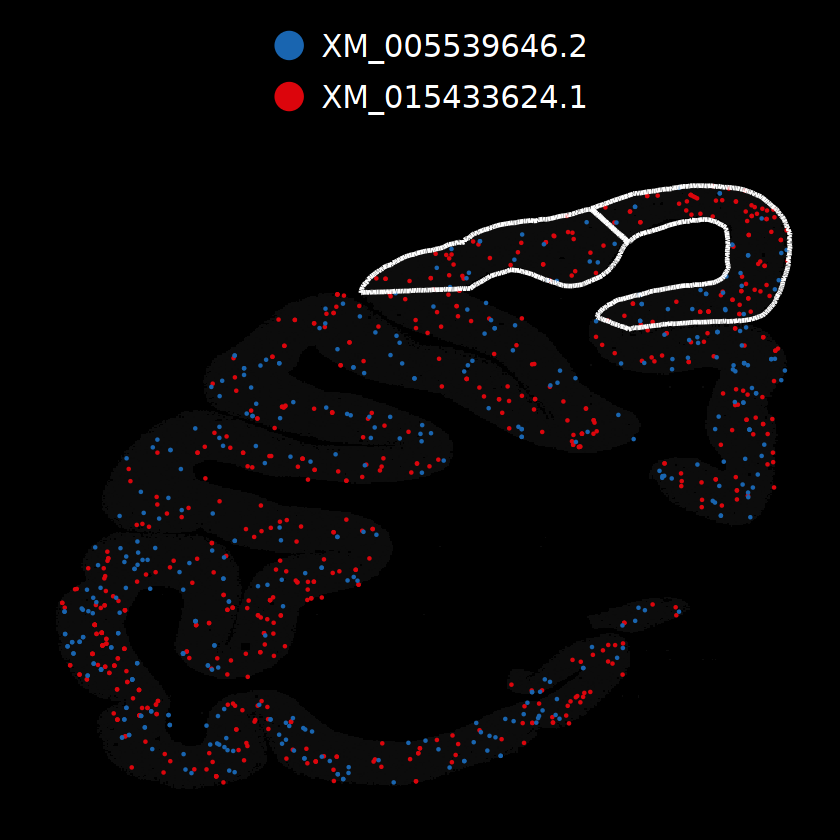

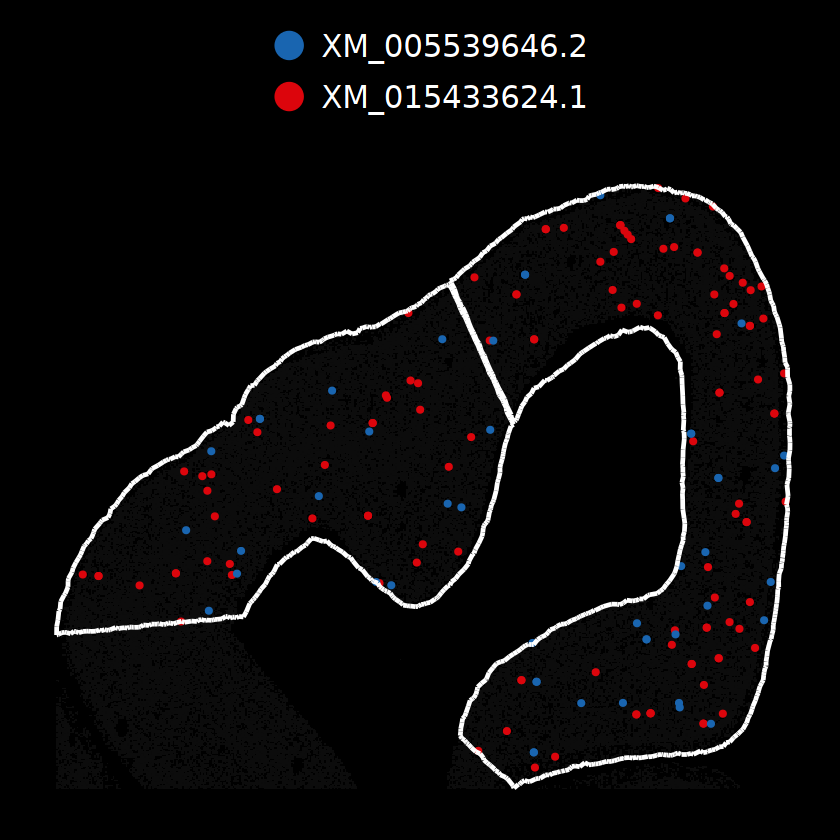

In [231]:
geneex = "SDCCAG8"
transid = c('XM_015433624.1','XM_005539646.2')
edgesdf.zoom = edgesdf[edgesdf$areaid %in% c("1/2","PE"),]
pc1 = SpCasePlot(fsraw.cor,geneex,transid,backpt,1)
pc1 = pc1 + geom_segment(data = edgesdf.zoom, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 1,alpha = 1,
                   color = "white")
pc1
#fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_10_23.pdf")
#ggexport(pc1,filename = fileid,width = 6,height = 9)

fsraw.cor.zoom = fsraw.cor[fsraw.cor$region %in% c("1|2","PE"),]
backpt.zoom = backpt[backpt$x < max(fsraw.cor.zoom$x) & backpt$x > min(fsraw.cor.zoom$x) &
                     backpt$y < max(fsraw.cor.zoom$y) & backpt$y > min(fsraw.cor.zoom$y),]
pc1.zoom = SpCasePlot(fsraw.cor.zoom,geneex,transid,backpt.zoom,2)
pc1.zoom = pc1.zoom + geom_segment(data = edgesdf.zoom, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 1,alpha = 1,
                   color = "white")
pc1.zoom
#fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_zoom_24_10_23.pdf")
#ggexport(pc1.zoom,filename = fileid,width = 6,height = 9)


#### fullscope case splced reads plot

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 462 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 329 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 20 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 11 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 15 rows containing missing values or values outside the scale range
(

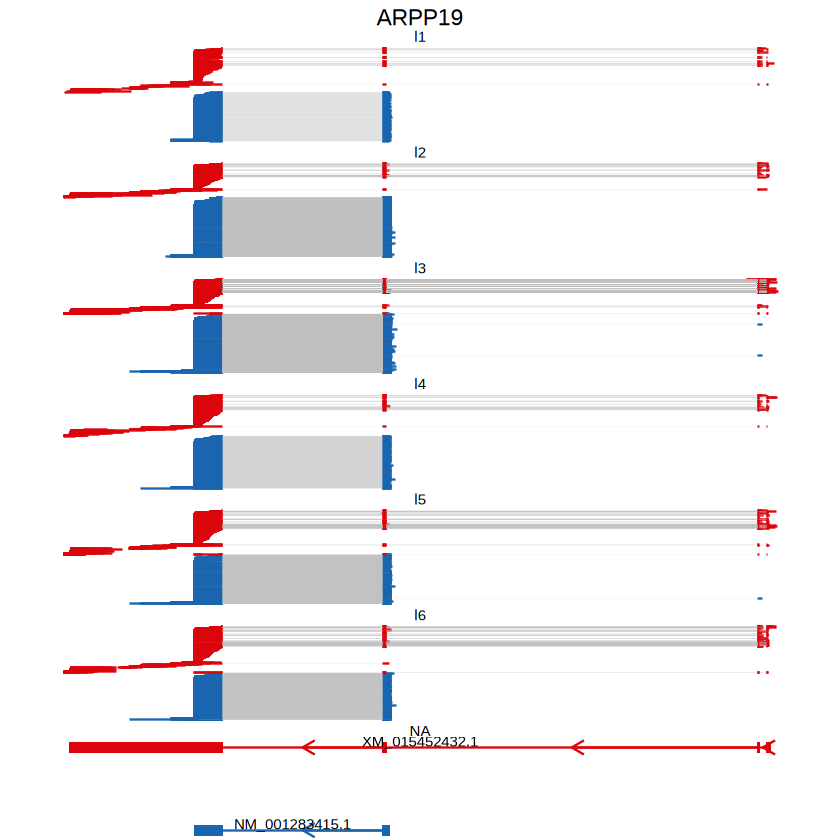

In [264]:
geneex = "ARPP19"
transid = c("XM_015452432.1","NM_001283415.1")
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_10_23.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

# isosigi = isosigls$layer
# fsraw.cor$areatr = fsraw.cor$layer
# fsraw.cor$chunk = fsraw.cor$lobe
# pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
# pcc
# fileid = paste0("result/figure2/",geneex,"_layer_case_boxstat_24_08_24.pdf")
# ggexport(pcc,filename = fileid,width = 4,height = 4)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 266 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 218 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 8 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 18 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 9 rows containing missing values or values outside the scale range
(`geo

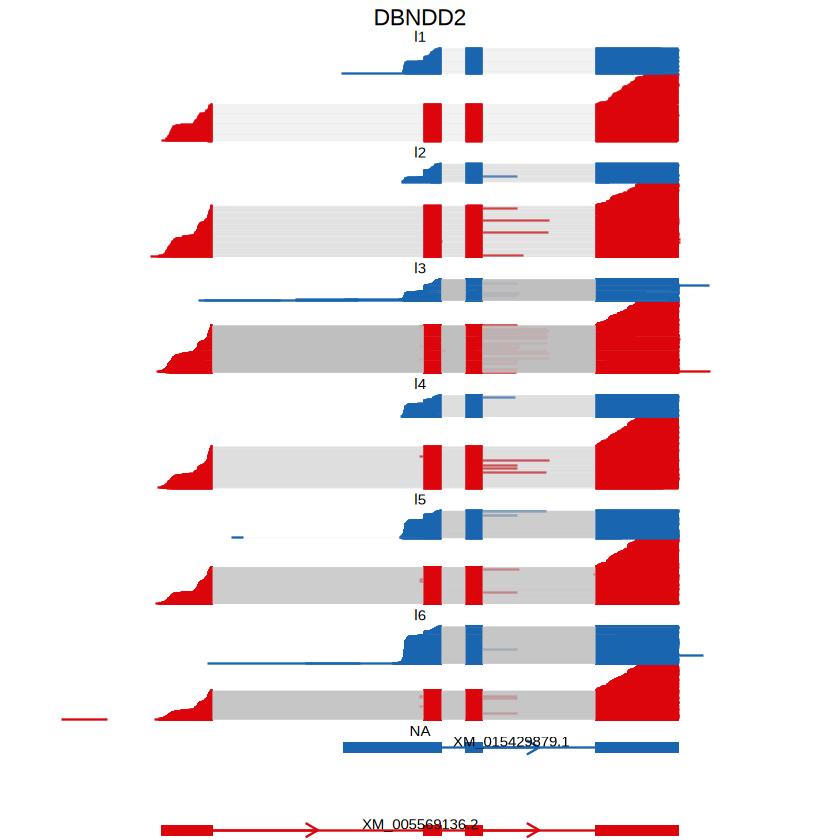

In [266]:
geneex = "DBNDD2"
transid = c("XM_005569136.2","XM_015429879.1")
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_10_23.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 38 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 36 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 38 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 36 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
file saved to result/figure2/TPM3_layer_case_readsplice_fullscope_24_12_05.pdf



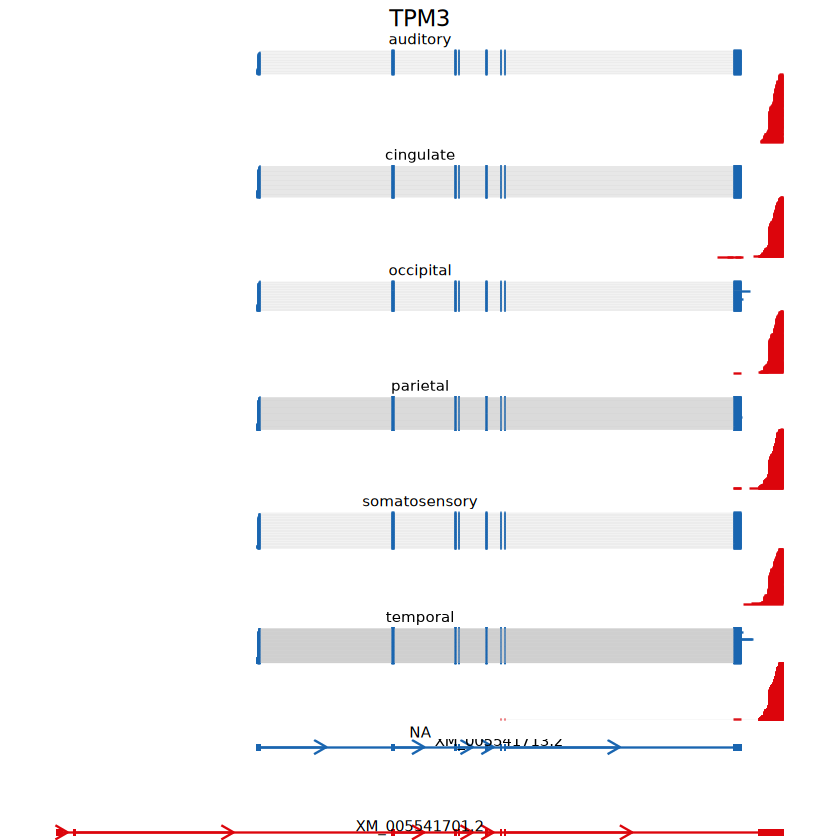

In [129]:
geneex = "TPM3"
transid = c("XM_005541701.2","XM_005541713.2")
isosigi = isosigls$lobe
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$lobe
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 40 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 38 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 40 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 38 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_se

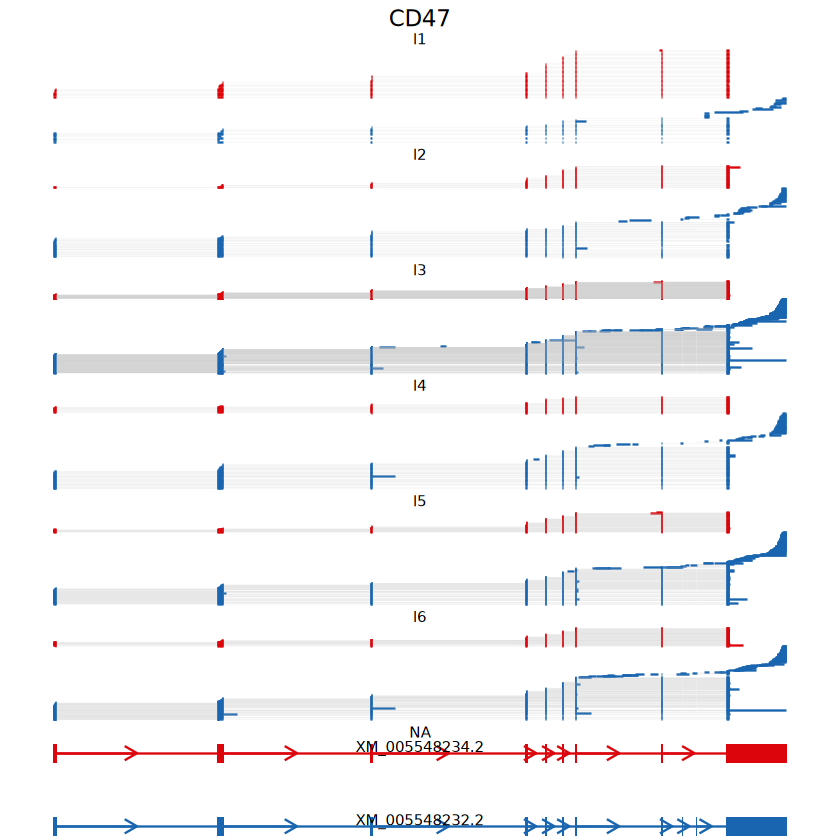

In [133]:
geneex = "CD47"
transid = c('XM_005548234.2','XM_005548232.2')
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 39 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 24 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 39 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 24 rows containing missing values or values outside the scale range
(`geom

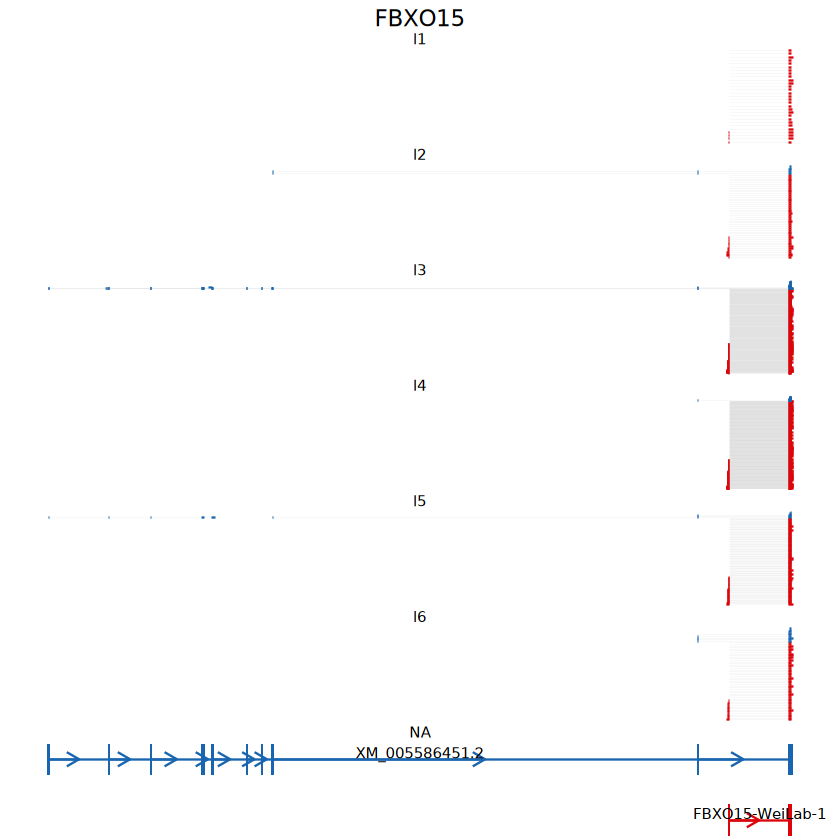

In [134]:
geneex = "FBXO15"
transid = c('FBXO15-WeiLab-1','XM_005586451.2')
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
file saved to result/figure2/SMYD2_layer_case_readsplice_fullscope_24_12_05.pdf



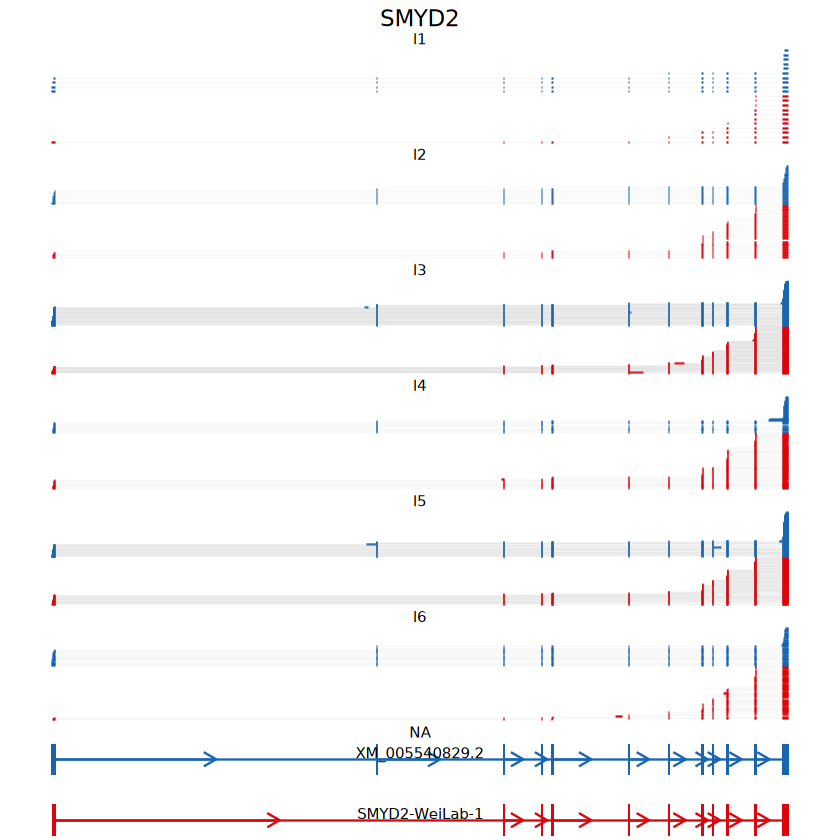

In [135]:
geneex = "SMYD2"
transid = c('SMYD2-WeiLab-1','XM_005540829.2')
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 14 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 7 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 12 rows containing missing values or values outside the scale range
(`geo

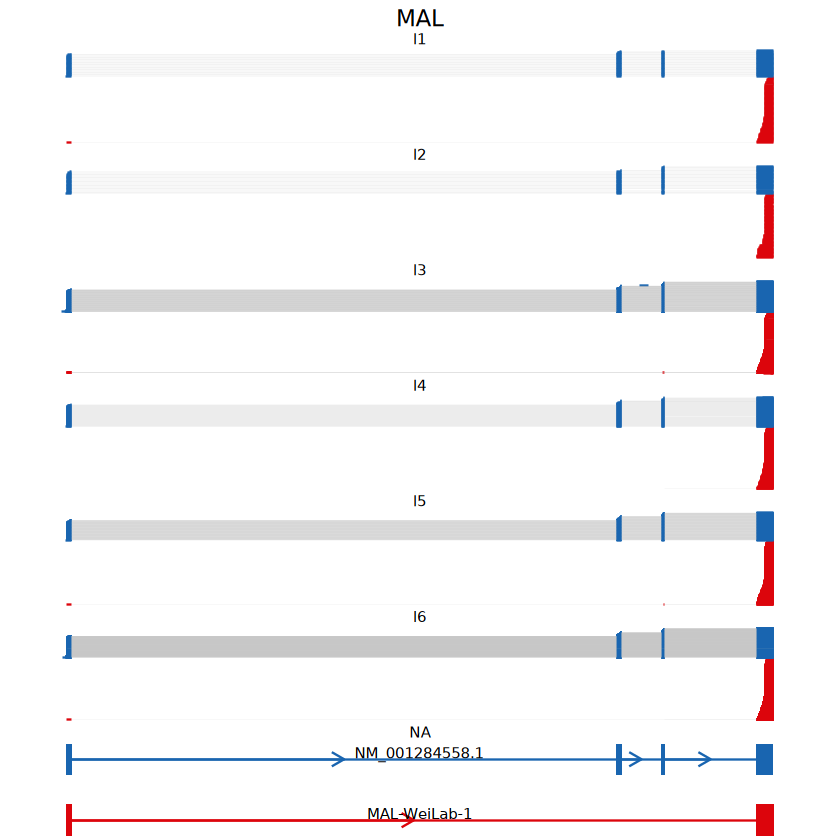

In [136]:
geneex = "MAL"
transid = c('MAL-WeiLab-1','NM_001284558.1')
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = transid
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE,mycolor)
pcr
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_fullscope_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

In [266]:
geneex = "NTRK2"
transid = c("XM_005582045.2","XM_005582051.2")
fsraw.cor.zoom = fsraw.cor[fsraw.cor$region == "1|2",]
backpt.zoom = backpt[backpt$x < max(fsraw.cor.zoom$x) & backpt$x > min(fsraw.cor.zoom$x) &
                     backpt$y < max(fsraw.cor.zoom$y) & backpt$y > min(fsraw.cor.zoom$y),]
pc1 = MarkerSpPlotBin1(fsraw.cor.zoom,backpt.zoom,geneex,NULL,transid,0.3)
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_zoom_24_09_06.pdf")
# ggexport(pc1,filename = fileid,width = 6,height = 9)
#pc2 = MarkerSpPlotBin1(fsraw.cor,backpt,geneex,NULL,transid,0.3)
#pc2
ggexport(pc1,filename = fileid,width = 6,height = 9)
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE)
pcr
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
pcc
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_24_09_10.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)
fileid = paste0("result/figure2/",geneex,"_layer_case_boxstat_24_09_10.pdf")
ggexport(pcc,filename = fileid,width = 4,height = 4)

`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
Warning message in grid.newpage():
"Cannot open temporary file '/tmp/Rtmpo61LC0/pdf13df7d0503a3' for compression (reason: No space left on device); compression has been turned off for this device"
file saved to result/figure2/NTRK2_layer_case_bin1_zoom_24_09_06.pdf

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 118 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 89 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the s

ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Computation failed in `stat_compare_means()`.
Caused by error in `dplyr::mutate()`:
! Can't transform a data frame with duplicate names."


ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

Warning message in grid.newpage():
"Cannot open temporary file '/tmp/Rtmpo61LC0/pdf13df7203a927a' for compression (reason: No space left on device); compression has been turned off for this device"
Warning message:
"Removed 118 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 89 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
fi

ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
file saved to result/figure2/SLC44A1_layer_case_bin1_24_09_06.pdf

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 157 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 104 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 4 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 13 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 4 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing

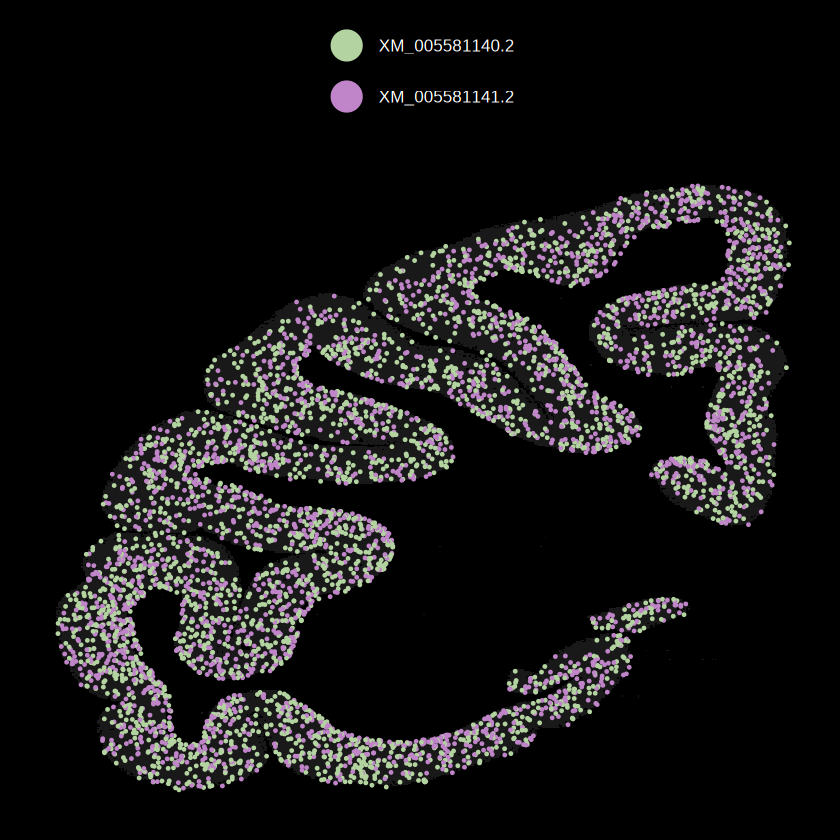

ERROR: Error: number of cluster centres must lie between 1 and nrow(x)


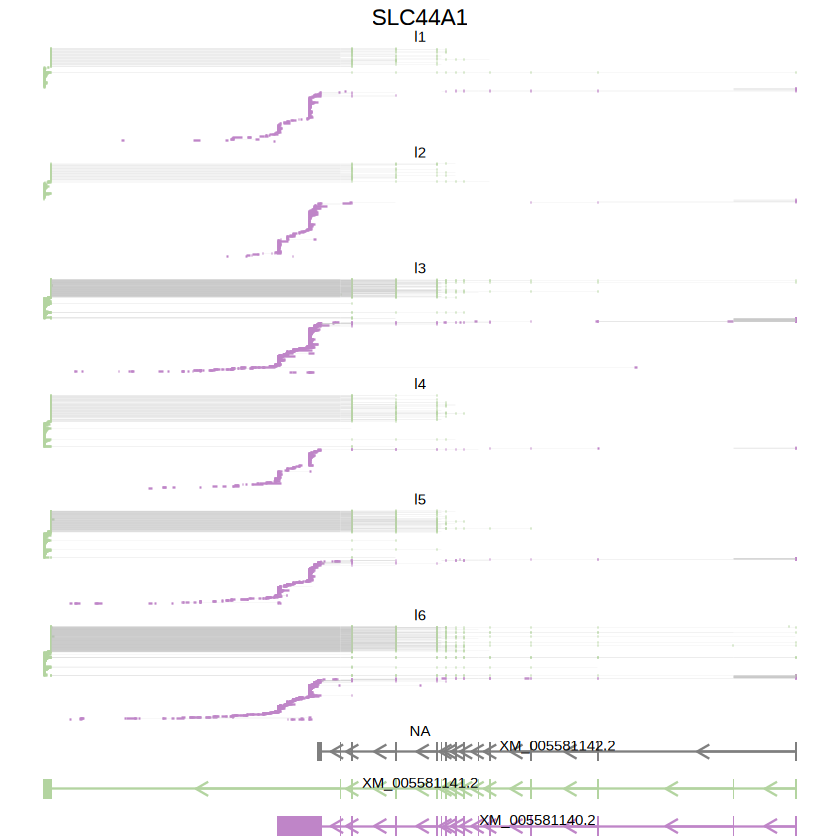

In [433]:
#'APBB3''ARPP19''ARPP21''BambuGene71536''C11H12orf29''CCDC13''COL9A1''DDRGK1''DIO2''DOCK7''DPP10'
#'FAM160A2''GSTM4''GTPBP6''LOC102115161''MAP6D1''NFKB1''NOXA1''PACRGL''PDLIM5''PGBD1''PHF11''PPP2R2B'
#'PVRL3''RNASE1''RPS6KA2''SLC44A1''SNAP23''TGFB3''TMEM106C''VTI1A''ZNF251''ZNF782'
geneex = "SLC44A1"
transid = NULL
pc1 = MarkerSpPlotBin1(fsraw.cor,backpt,geneex,NULL,transid,0.2)
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_09_06.pdf")
ggexport(pc1,filename = fileid,width = 6,height = 9)
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid)
pcr
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
pcc

`summarise()` has grouped output by 'x', 'y'. You can override using the
`.groups` argument.
file saved to result/figure2/ARPP21_layer_case_bin1_24_09_06.pdf

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 504 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 217 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 23 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 86 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 26 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 69 rows containing missin

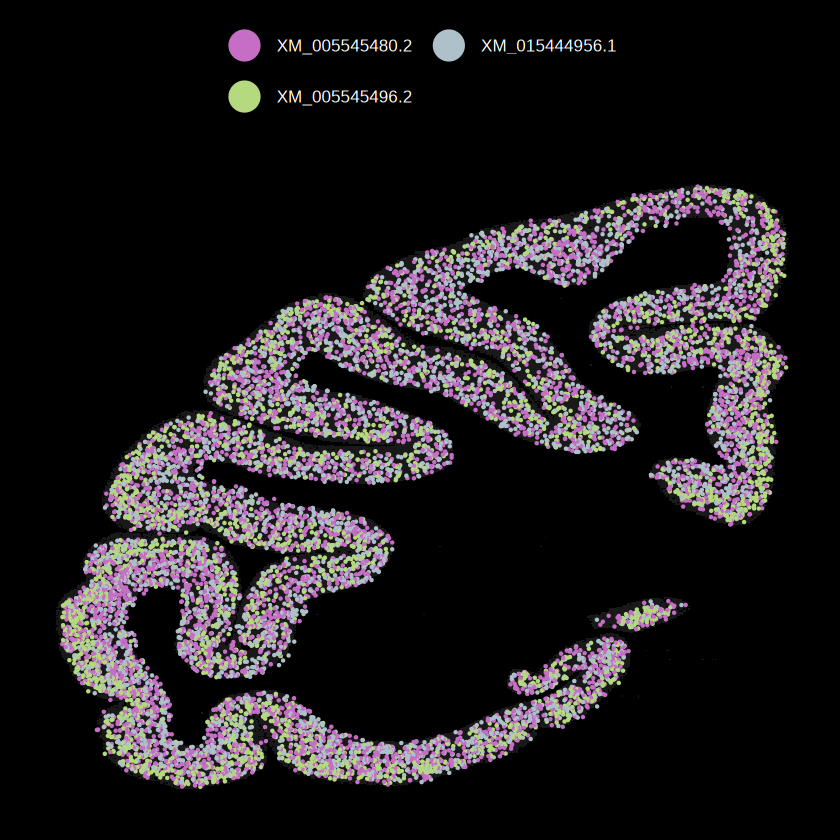

`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Computation failed in `stat_compare_means()`.
Caused by error in `dplyr::mutate()`:
! Can't transform a data frame with duplicate names."


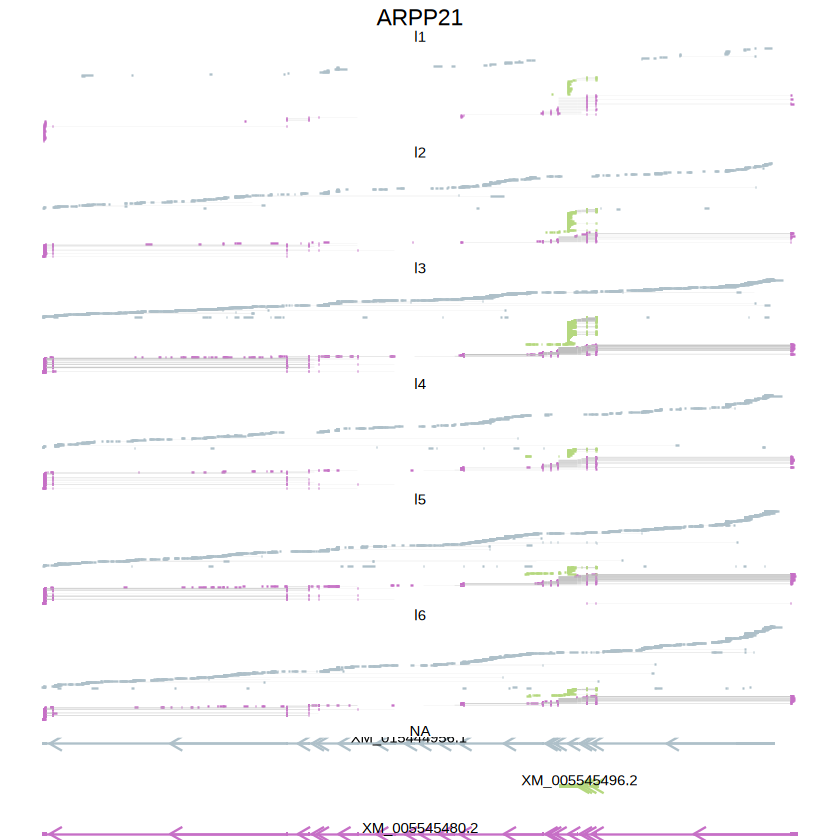

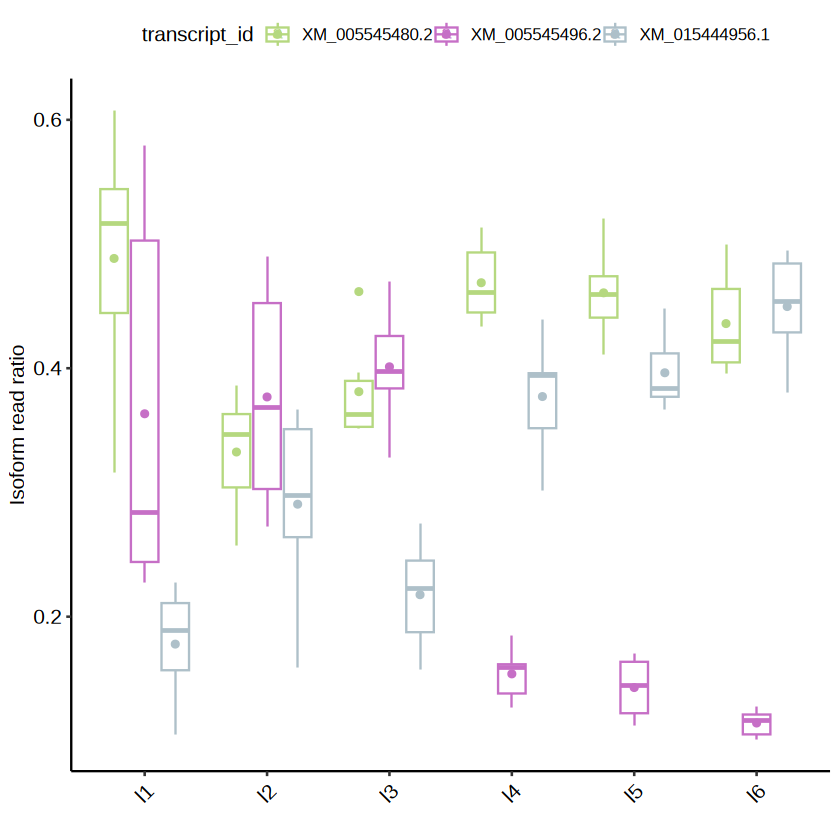

In [440]:
#'PVRL3''RNASE1''RPS6KA2''SLC44A1''SNAP23''TGFB3''TMEM106C''VTI1A''ZNF251''ZNF782'
geneex = "ARPP21"
transid = c('XM_005545480.2','XM_005545496.2','XM_015444956.1')
pc1 = MarkerSpPlotBin1(fsraw.cor,backpt,geneex,NULL,transid,0.2)
pc1
fileid = paste0("result/figure2/",geneex,"_layer_case_bin1_24_09_06.pdf")
ggexport(pc1,filename = fileid,width = 6,height = 9)
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE)
pcr


`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Computation failed in `stat_compare_means()`.
Caused by error in `dplyr::mutate()`:
! Can't transform a data frame with duplicate names."
Warning message:
"Removed 504 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 217 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 23 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 86 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 26 rows containing missing values or values outs

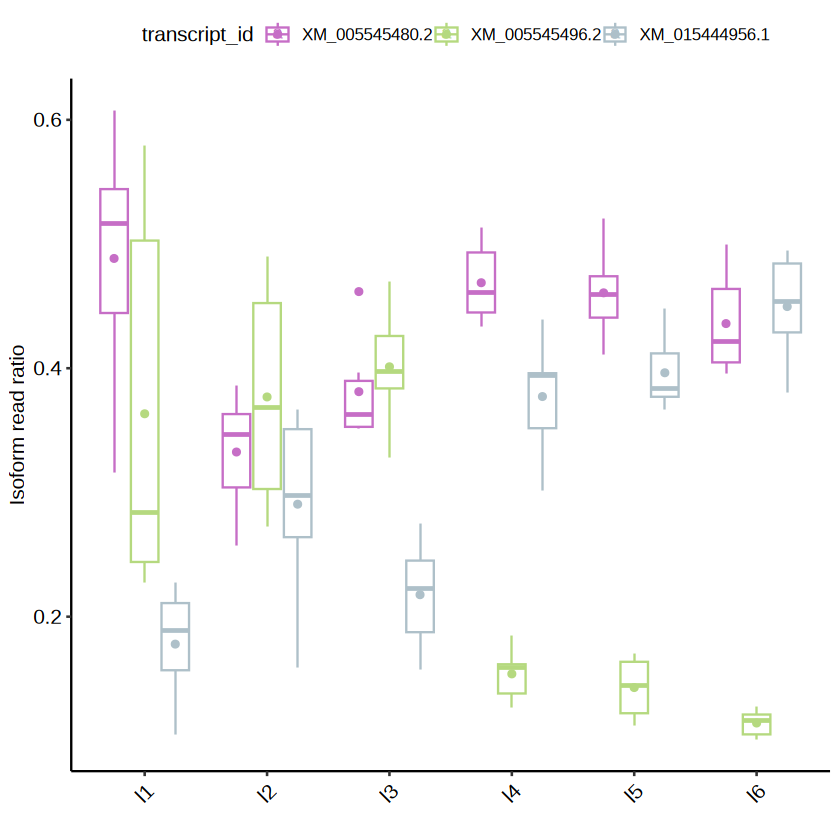

In [441]:
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
pcc
fileid = paste0("result/figure2/",geneex,"_layer_case_readsplice_24_09_10.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)
fileid = paste0("result/figure2/",geneex,"_layer_case_boxstat_24_09_10.pdf")
ggexport(pcc,filename = fileid,width = 4,height = 4)

In [122]:
geneex = "DDRGK1"
isosigi = isosigls$layer
mean(isosigi[isosigi$areatr %in% c("l1","l2","l3") & isosigi$transcript_id == "DDRGK1-WeiLab-1",]$relative)
isosigi[isosigi$gene_id == geneex,]
nrow(fsraw.cor[fsraw.cor$gene_id == geneex,])
unique(fsraw.cor[fsraw.cor$gene_id == geneex,]$transcript_id)

[1] 0.6318038

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
19098,DDRGK1,DDRGK1-WeiLab-1,l1,1097,1787,0.6138780,0.5146725,0.4948313,0.11904666,Up,4.431769e-287,1.012659e-283
19099,DDRGK1,DDRGK1-WeiLab-1,l2,2722,4155,0.6551143,0.5146725,0.4865841,0.16853024,Up,4.431769e-287,1.012659e-283
19100,DDRGK1,DDRGK1-WeiLab-1,l3,9546,15239,0.6264191,0.5146725,0.4923231,0.13409592,Up,4.431769e-287,1.012659e-283
19101,DDRGK1,DDRGK1-WeiLab-1,l4,723,1890,0.3825397,0.5146725,0.5410990,-0.15855933,Down,4.431769e-287,1.012659e-283
19102,DDRGK1,DDRGK1-WeiLab-1,l5,1164,3111,0.3741562,0.5146725,0.5427757,-0.16861948,Down,4.431769e-287,1.012659e-283
19103,DDRGK1,DDRGK1-WeiLab-1,l6,1490,3418,0.4359274,0.5146725,0.5304215,-0.09449401,N,4.431769e-287,1.012659e-283
19104,DDRGK1,XM_005568473.2,l1,690,1787,0.3861220,0.4853275,0.5051687,-0.11904666,Down,4.431769e-287,1.012659e-283
19105,DDRGK1,XM_005568473.2,l2,1433,4155,0.3448857,0.4853275,0.5134159,-0.16853024,Down,4.431769e-287,1.012659e-283
19106,DDRGK1,XM_005568473.2,l3,5693,15239,0.3735809,0.4853275,0.5076769,-0.13409592,Down,4.431769e-287,1.012659e-283


[1] 31915

[1] "XM_005568473.2"  "DDRGK1-WeiLab-1"

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 118 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 89 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."


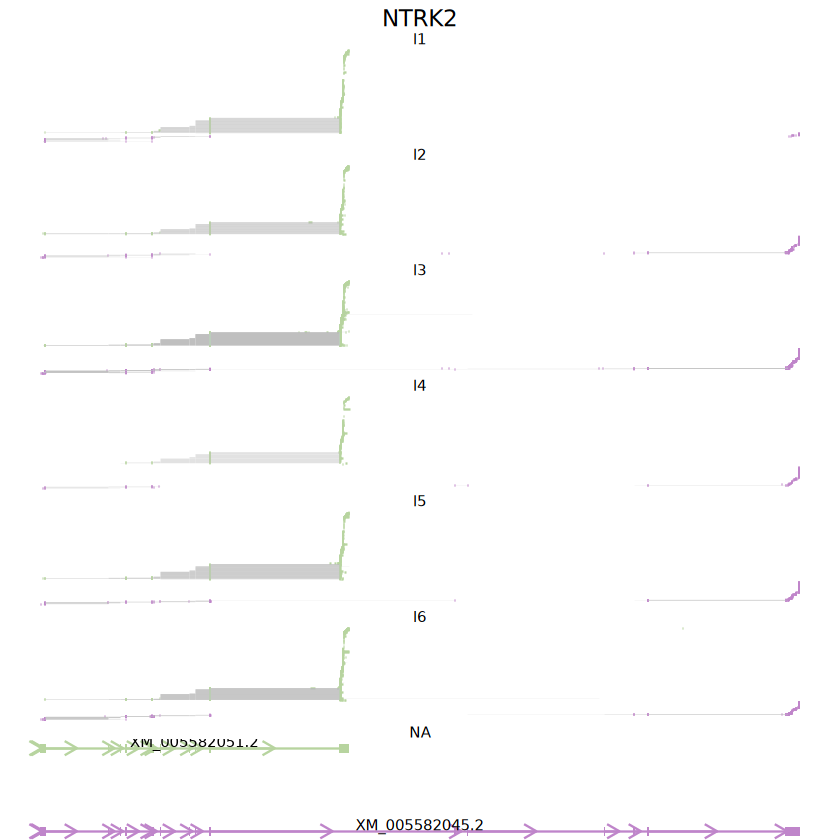

In [120]:
geneex = "NTRK2"
transid = c('XM_005582045.2','XM_005582051.2')
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex,transid,TRUE)
pcr

`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Computation failed in `stat_compare_means()`.
Caused by error in `dplyr::mutate()`:
! Can't transform a data frame with duplicate names."
Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 14 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside

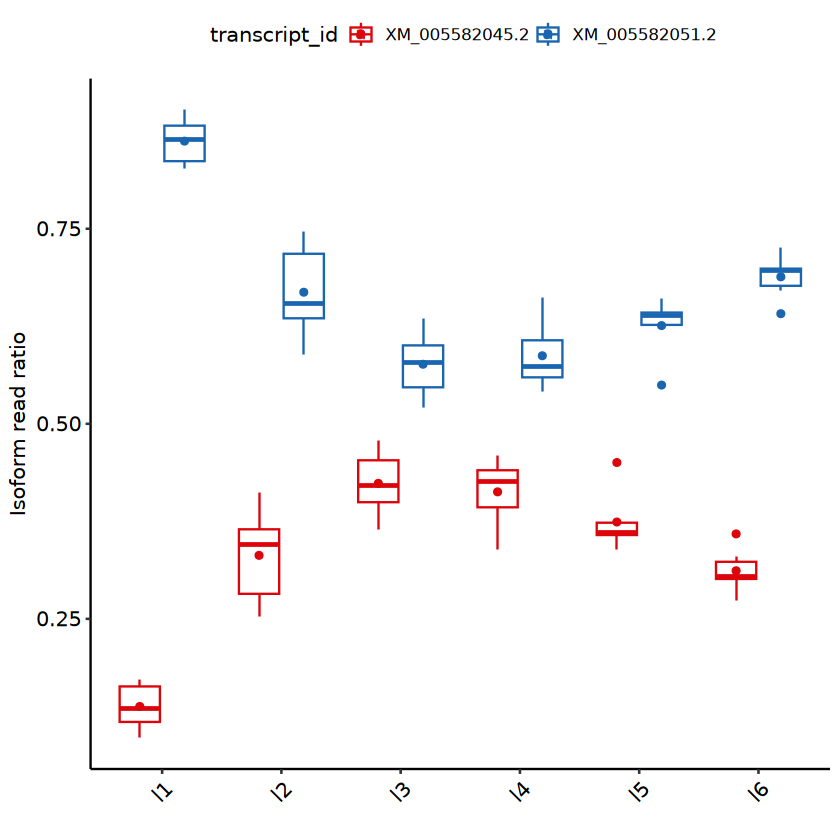

Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 14 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 7 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 12 rows containing missing values or values outside the scale range
(`geom_segment()`)."
file saved to result/figure2/ARPP21_layer_case_stbox_24_12_05.pdf

`summarise()` has

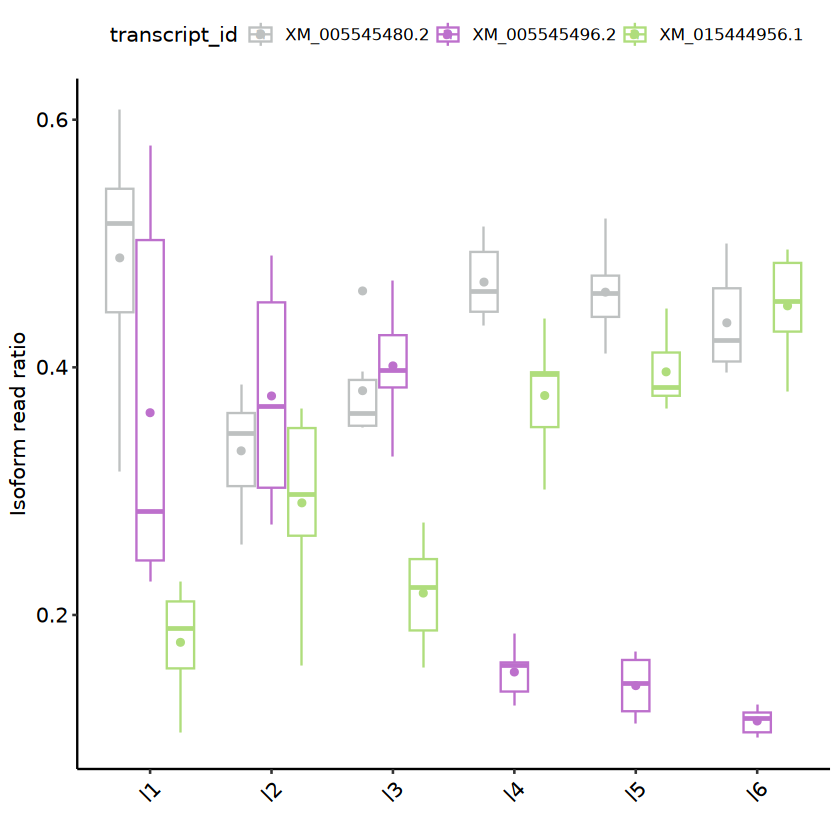

Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 14 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 7 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 12 rows containing missing values or values outside the scale range
(`geom_segment()`)."
file saved to result/figure2/CD47_layer_case_stbox_24_12_05.pdf

`summarise()` has g

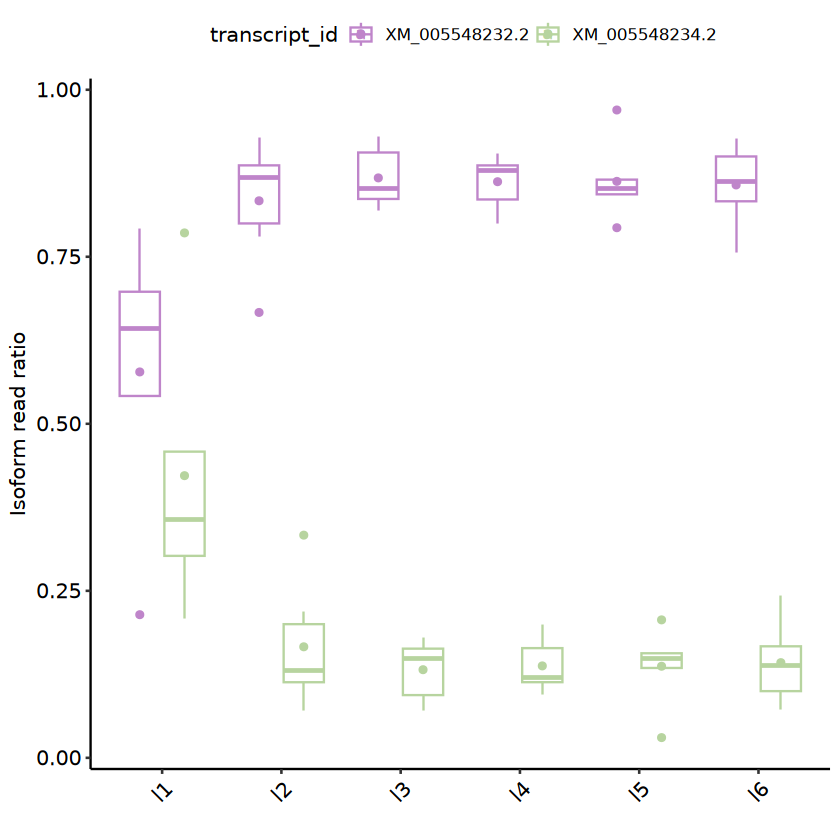

Warning message:
"Removed 76 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 14 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 7 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 12 rows containing missing values or values outside the scale range
(`geom_segment()`)."
file saved to result/figure2/TPM3_lobe_case_stbox_24_12_05.pdf



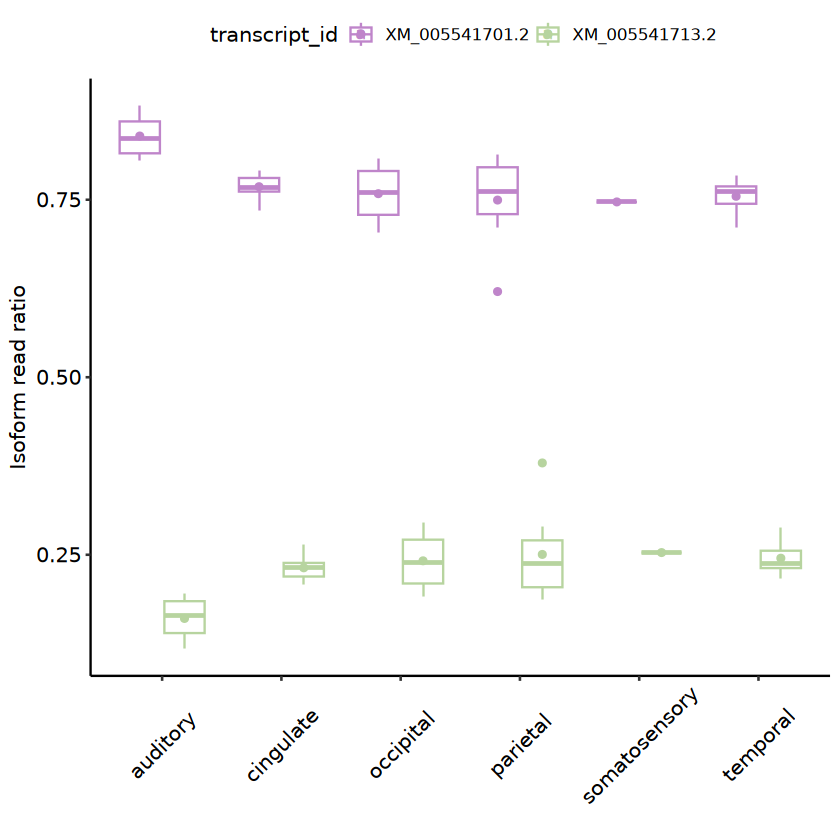

In [139]:
mycolor = c('#DC050C','#1965B0')
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe

geneex = "NTRK2"
transid = c('XM_005582045.2','XM_005582051.2')
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,mycolor)
pcc
fileid = paste0("result/figure2/",geneex,"_layer_case_stbox_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

geneex = "ARPP21"
transid = c('XM_005545480.2','XM_005545496.2','XM_015444956.1')
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
pcc
fileid = paste0("result/figure2/",geneex,"_layer_case_stbox_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

geneex = "CD47"
transid = c('XM_005548234.2','XM_005548232.2')
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
pcc
fileid = paste0("result/figure2/",geneex,"_layer_case_stbox_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

geneex = "TPM3"
transid = c("XM_005541701.2","XM_005541713.2")
fsraw.cor$areatr = fsraw.cor$lobe
fsraw.cor$chunk = fsraw.cor$region
pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,mycolor)
pcc
fileid = paste0("result/figure2/",geneex,"_lobe_case_stbox_24_12_05.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)


##### PSMD12 a lobe case

In [178]:
isosigi = isosigls$lobe
isosigi[isosigi$gene_id == "RTN1",]

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
69868,RTN1,XM_005561388.2,auditory,5020,6640,0.7560241,0.7309684,0.7259573,0.03006682,N,1.134102e-50,1.582072e-47
69869,RTN1,XM_005561388.2,cingulate,8823,11879,0.7427393,0.7309684,0.7286142,0.01412505,N,1.134102e-50,1.582072e-47
69870,RTN1,XM_005561388.2,occipital,5929,8466,0.7003307,0.7309684,0.7370959,-0.03676521,N,1.134102e-50,1.582072e-47
69871,RTN1,XM_005561388.2,parietal,14949,19534,0.7652810,0.7309684,0.7241059,0.04117517,N,1.134102e-50,1.582072e-47
69872,RTN1,XM_005561388.2,somatosensory,5653,8048,0.7024105,0.7309684,0.7366800,-0.03426945,N,1.134102e-50,1.582072e-47
69873,RTN1,XM_005561388.2,temporal,23062,32074,0.7190248,0.7309684,0.7333571,-0.01433239,N,1.134102e-50,1.582072e-47
69874,RTN1,XM_005561389.2,auditory,1619,6640,0.2438253,0.2689683,0.2739969,-0.03017164,N,1.134102e-50,1.582072e-47
69875,RTN1,XM_005561389.2,cingulate,3055,11879,0.2571765,0.2689683,0.2713267,-0.01415017,N,1.134102e-50,1.582072e-47
69876,RTN1,XM_005561389.2,occipital,2537,8466,0.2996693,0.2689683,0.2628282,0.03684111,N,1.134102e-50,1.582072e-47


In [159]:
# isosigls = qread(file = "data/dtu_analysis/dtu_isoform_ls_24_03_28.qs")
# names(isosigls)
isosigi = isosigls$lobe
#isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.3,]
unique(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.1 & isosigi$genecount > 500,]$gene_id)
# isosigi = isosigls$lobe
# summary(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.2,]$genecount)
# isosigi = isosigls$layer
# summary(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.2,]$genecount)

[1] "ATP6V1C1" "CHD5"     "DNAJB4"   "DOCK3"    "DYNC1I1"  "HERC1"   
 [7] "IFT20"    "KCNIP4"   "NRCAM"    "PPFIA2"   "PPP2R2B"  "PSMD12"  
[13] "RBFOX2"   "SEC13"    "SETBP1"   "SPTAN1"   "TENM2"    "TPM2"    
[19] "TPM3"     "UBQLN1"   "USP9X"

In [160]:
geneex = unique(isosigi[isosigi$sig != "N" & abs(isosigi$dr) > 0.1 & isosigi$genecount > 500 & isosigi$areatr == "somatosensory",]$gene_id)
pcls = list()
for(i in 1:length(geneex)){
    isosigi = isosigls$lobe
    transid = unique(isosigi[isosigi$gene_id %in% geneex[i],]$transcript_id)
    fsraw.cor$areatr = fsraw.cor$lobe
    fsraw.cor$chunk = fsraw.cor$layer
    pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,geneex[i],transid)
    pcls[[i]] = pcr
}
fileid = paste0("result/figure2/hub_lobe_case_readsplice_500_24_10_24.pdf")
ggexport(pcls,filename = fileid,width = 4,height = 6)
#pcc = CaseCountPlotBox(fsraw.cor,geneex,transid,NULL)
#pcc
# fileid = paste0("result/figure2/",geneex,"_lobe_case_readsplice_24_08_24.pdf")
# ggexport(pcr,filename = fileid,width = 4,height = 6)
# fileid = paste0("result/figure2/",geneex,"_lobe_case_boxstat_24_08_24.pdf")
# ggexport(pcc,filename = fileid,width = 4,height = 4)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


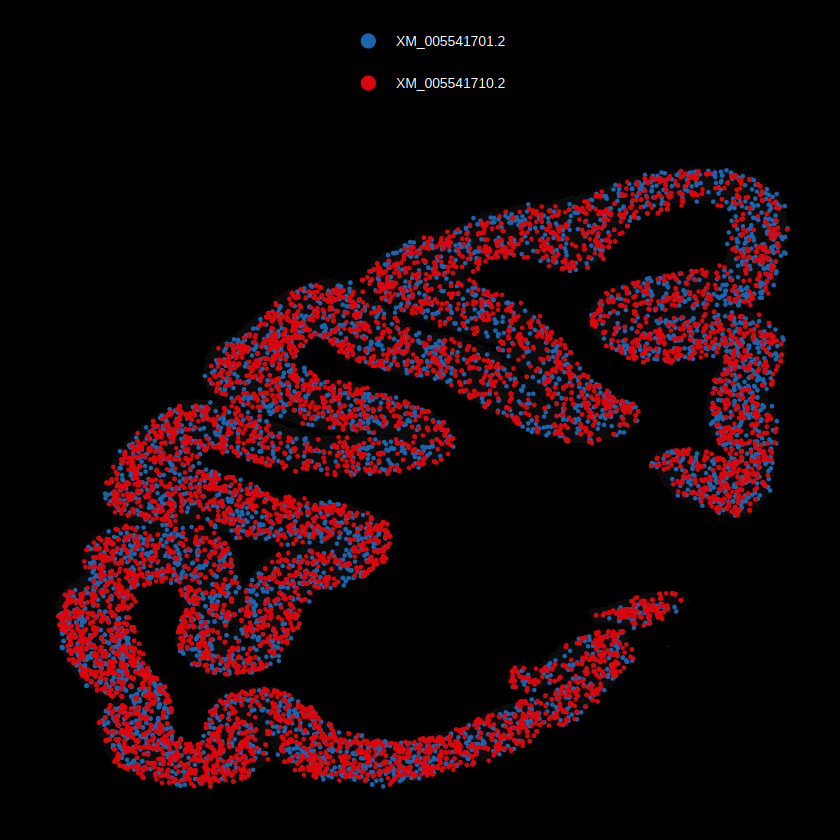

In [190]:
geneex = "TPM3"
isosigi = isosigls$lobe
transid = unique(isosigi[isosigi$gene_id %in% geneex & isosigi$sig != "N",]$transcript_id)
transid = c("XM_005541710.2","XM_005541701.2")
mkdf = fsraw.cor[fsraw.cor$gene_id == geneex,]
mkdf = mkdf[mkdf$transcript_id %in% transid,]
mkdf = mkdf[order(as.numeric(as.factor(mkdf$transcript_id))),]
pmkpti1 = SpCasePlot(mkdf,transid)
pmkpti1

In [183]:
isosigi[isosigi$gene_id %in% "TPM3",]

,gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
,<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
81833,TPM3,NM_001284070.1,auditory,237,2077,0.11410688,0.10934687,0.10839487,0.0057120129,N,1.105037e-23,2.85468e-21
81834,TPM3,NM_001284070.1,cingulate,335,3099,0.10809939,0.10934687,0.10959637,-0.0014969847,N,1.105037e-23,2.85468e-21
81835,TPM3,NM_001284070.1,occipital,251,2287,0.10975077,0.10934687,0.10926610,0.0004846692,N,1.105037e-23,2.85468e-21
81836,TPM3,NM_001284070.1,parietal,609,5967,0.10206134,0.10934687,0.11080398,-0.0087426442,N,1.105037e-23,2.85468e-21
81837,TPM3,NM_001284070.1,somatosensory,189,1739,0.10868315,0.10934687,0.10947962,-0.0007964675,N,1.105037e-23,2.85468e-21
81838,TPM3,NM_001284070.1,temporal,994,8767,0.11337972,0.10934687,0.10854031,0.0048394143,N,1.105037e-23,2.85468e-21
81839,TPM3,XM_005541701.2,auditory,400,2077,0.19258546,0.20649443,0.20927622,-0.0166907625,N,1.105037e-23,2.85468e-21
81840,TPM3,XM_005541701.2,cingulate,696,3099,0.22458858,0.20649443,0.20287560,0.0217129781,N,1.105037e-23,2.85468e-21
81841,TPM3,XM_005541701.2,occipital,429,2287,0.18758199,0.20649443,0.21027692,-0.0226949321,N,1.105037e-23,2.85468e-21


In [87]:
unique(isosigi[isosigi$gene_id %in% geneex & isosigi$sig != "N",]$transcript_id)

[1] "XM_005588313.2"

##### Lobe case plot

In [23]:
isosigi = isosigls$lobe
isosighub = isosigi[isosigi$sig == "Up",]
isotmp = isosighub
isotmp = isosighub %>% group_by(gene_id,transcript_id) %>%
    summarise(mysig = paste0(areatr,collapse = "-"))
isotmp = isotmp[isotmp$mysig %in% unique(isosigi$areatr),]
write.csv(isosighub,file = "result/figure2/lobe_dtu_list.csv")

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.


[1] "#C285C8" "#B5D6A0"
# A tibble: 6 × 13
# Groups:   group [4]
  readid   seqnames  start    end width strand score group transcript_id readord
  <chr>    <fct>     <int>  <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 9752985… NW_0050… 8.6 e2 1.90e3  1044 +          0 pari… NM_001284642… NM_001…
2 eb90d9b… NC_0126… 2.36e3 2.53e3   176 -         33 occi… NM_001284642… NM_001…
3 eb90d9b… NW_0050… 3.56e3 3.74e3   176 -          0 occi… NM_001284642… NM_001…
4 7a92b97… NC_0222… 1.09e6 1.09e6   479 +         60 soma… NM_001284642… NM_001…
5 2e056d5… NC_0222… 3.81e6 3.81e6  1418 +         60 temp… NM_001284642… NM_001…
6 17481d8… NC_0222… 5.38e6 5.38e6   375 +          0 temp… NM_001284642… NM_001…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
Warning message:
"Removed 118 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 92 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed

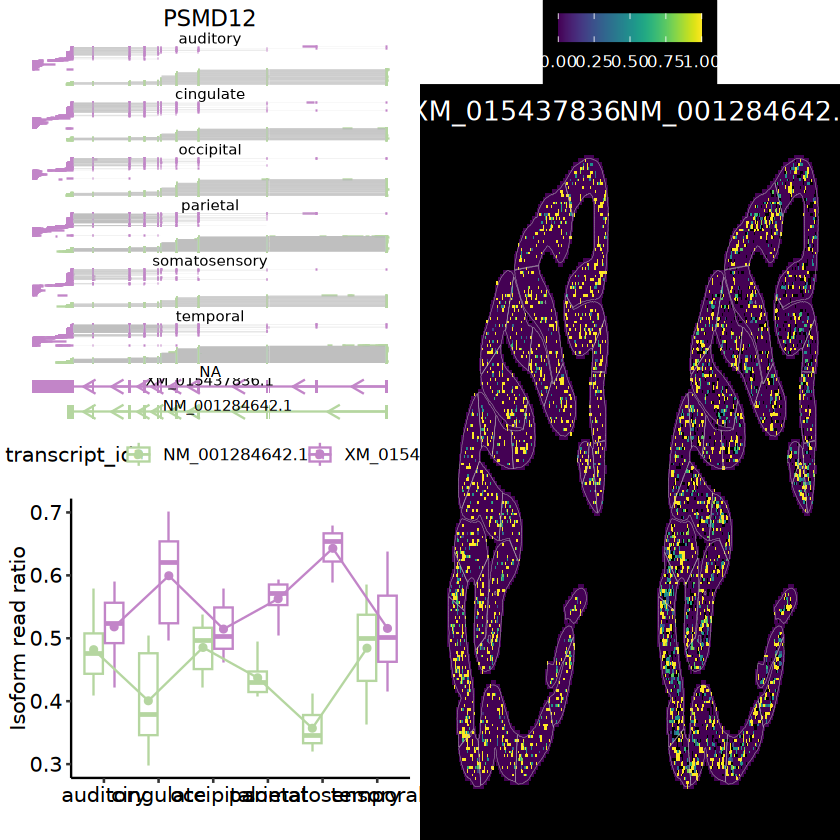

In [77]:
geneex = "PSMD12"
transid = c("XM_015437836.1","NM_001284642.1")
fileid = paste0("result/figure2/",geneex,"_lobe_case_24_08_25.pdf")
isosigi = isosigls$lobe
fsraw.cor$areatr = fsraw.cor$lobe
fsraw.cor$chunk = fsraw.cor$layer

pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,transid,markdfb,edgesdf)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/PSMD12_lobe_case_bin200_24_08_24.pdf



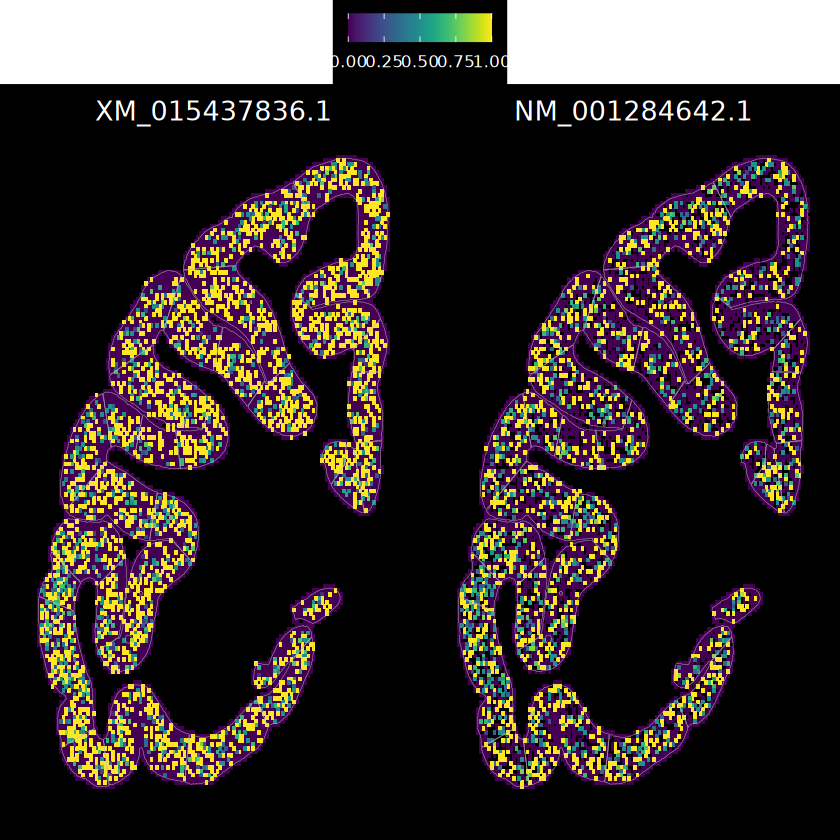

In [146]:
geneex = "PSMD12"
transid = c("XM_015437836.1","NM_001284642.1")
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_lobe_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
`geom_smooth()` using method = 'loess' and formula = 'y ~ x'
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"span too small.   fewer data values than degrees of freedom."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 1.98"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.02"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  0"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 4.0804"


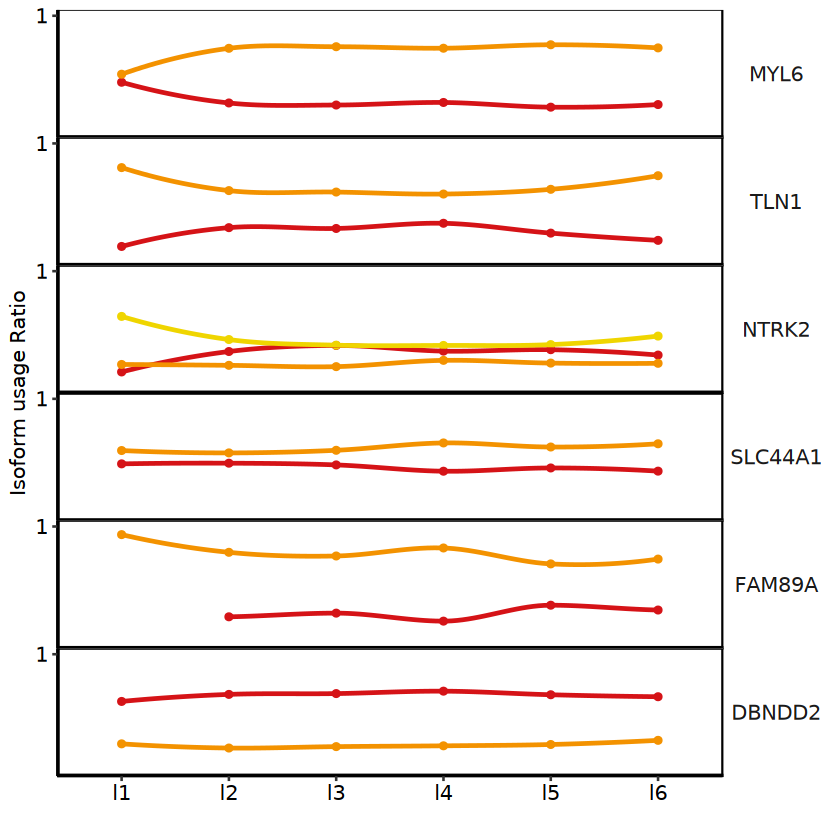

In [171]:
isosigi = isosigls$layer
# isosighub = isosigi[isosigi$sig == "Up",]
# isotmp = isosighub
# isotmp = isosighub %>% group_by(gene_id,transcript_id) %>%
#     summarise(mysig = paste0(areatr,collapse = "-"))
# isotmp = isotmp[isotmp$mysig %in% unique(isosigi$areatr),]
# write.csv(isosighub,file = "result/figure2/layer_dtu_list.csv")

gmks = c("MYL6","TLN1","NTRK2","SLC44A1","FAM89A","DBNDD2")
  # gmks = c("MYL6","TLN1","C15H9orf9","MATN2","ASPH","PVRL3")
  # gmks2 = c("XM_015430205.1","BambuTx30102","XM_005594485.2",
  #           "BambuTx16896","BambuTx43196","XM_005566597.2")
  # 
  #plot
mklst = isosigi[isosigi$gene_id %in% gmks,]
mklst$gene_id = factor(mklst$gene_id,levels = gmks)
mklst$areatr = factor(mklst$areatr,levels = paste0("l",1:6))
#tanshub = unique(mklst[mklst$sig %in% c("Up","Down"),]$transcript_id)
#mklst = mklst[mklst$transcript_id %in% tanshub,]
mklst = mklst %>% group_by(gene_id) %>%
    mutate(transid = as.character(as.numeric(as.factor(transcript_id))))
#mklst 
    
pmkgrid = ggplot(mklst,aes(x = areatr, y = relative, group = transid,
                             color = transid)) +
    geom_point() +
    geom_smooth(aes(x = as.numeric(areatr), y = relative),se = F) +
    # geom_text(aes(x = arealayer, y = norm,label = transcript_id),
    #           size = 1,position = "stack",vjust = 0.5) +
    scale_y_continuous(limits = c(0,1),breaks = c(1)) +
    facet_grid(gene_id~.,scales = "free") +
    scale_color_frontiers() +
    xlab("") + ylab("Isoform usage Ratio") +
    theme(legend.position = "none") +
    annotation_custom(grid::linesGrob(y = c(0, 0), gp = grid::gpar(lwd = 3))) +
    annotation_custom(grid::linesGrob(x = c(0, 0), gp = grid::gpar(lwd = 3))) +
#    facetted_pos_scales(y = ylabels)+
      # scale_y_continuous(breaks = custom_breaks) +
    theme_pubr() +
      theme(strip.background = element_blank(), 
            strip.text.x = element_blank(), 
            panel.spacing = unit(0,'lines'),
            legend.position = "none",
            panel.border = element_rect(fill = NA),
            strip.text.y = element_text(angle = 0,size = 12),
            axis.text.x = element_text(size = 12))
pmkgrid


In [141]:
fsrawdpf = fsraw %>% group_by(readid) %>% filter(n() == 1)

In [175]:
qsave(fsrawdpf,file = "data/reads_full_anotation/main_data_read_total_annotation_read_onlyunique_24_05_16.qs")

Warning message:
"Returning more (or less) than 1 row per `summarise()` group was deprecated in
dplyr 1.1.0.
ℹ Please use `reframe()` instead.
ℹ When switching from `summarise()` to `reframe()`, remember that `reframe()`
  always returns an ungrouped data frame and adjust accordingly."
`summarise()` has grouped output by 'layer', 'lobe', 'gene_id',
'transcript_id'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'areatr', 'gene_id'. You can override using
the `.groups` argument.
`geom_smooth()` using method = 'loess' and formula = 'y ~ x'
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"span too small.   fewer data values than degrees of freedom."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 1.98"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.02"
Warning message in simpleLoess(

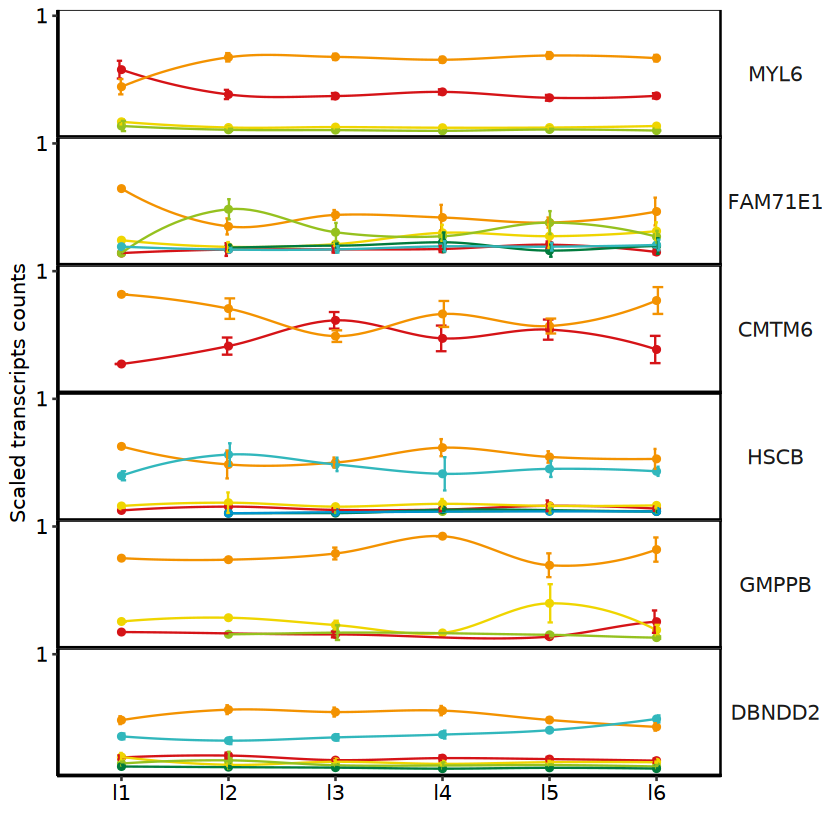

In [160]:
gmks = c("MYL6","FAM71E1","CMTM6","HSCB","GMPPB","DBNDD2")
# gmks = c("MYL6","TLN1","NTRK2","DEGS2","PRDM11","MORN1")
mklst2 = fsrawdpf[fsrawdpf$gene_id %in% gmks,]
mklst2 = mklst2 %>% group_by(layer,lobe,gene_id) %>% 
    mutate(genecount = length(unique(readid))) %>% filter(genecount > 10) %>% 
    group_by(layer,lobe,gene_id,transcript_id) %>%
    summarise(transcount = length(unique(readid)),
              relative = transcount/genecount)
mklst2 = mklst2[mklst2$layer %in% paste0("l",1:6),]
mklst2$gene_id = factor(mklst2$gene_id,levels = gmks)
mklst2$areatr = mklst2$layer
mklst2$areatr = factor(mklst2$areatr,levels = paste0("l",1:6))
isosigi = isosigls$layer
mklst = isosigi[isosigi$gene_id %in% gmks,]
tanshub = unique(mklst[mklst$sig %in% c("Up","Down"),]$transcript_id)
#mklst2 = mklst2[mklst2$transcript_id %in% tanshub,]
mklst2 = mklst2 %>% group_by(gene_id) %>%
    mutate(transid = as.character(as.numeric(as.factor(transcript_id))))

mklst2 = mklst2 %>% group_by(areatr,gene_id,transid) %>% summarise(sd = sd(relative),relative = mean(relative))
  
pmkgrid2 = ggplot(mklst2,aes(x = areatr, y = relative, group = transid,
                             color = transid)) +
    geom_point() +
    geom_smooth(aes(x = as.numeric(areatr), y = relative),size = 0.5,
                se = F) +
    geom_errorbar(aes(ymin=relative-sd, ymax=relative+sd), width=.2,
                  position=position_dodge(0.05)) +
    # geom_text(aes(x = arealayer, y = norm,label = transcript_id),
    #           size = 1,position = "stack",vjust = 0.5) +
    scale_y_continuous(limits = c(0,1),breaks = c(1)) +
    facet_grid(gene_id~.,scales = "free") +
    scale_color_frontiers() +
    xlab("") + ylab("Scaled transcripts counts") +
    theme(legend.position = "none") +
    annotation_custom(grid::linesGrob(y = c(0, 0), gp = grid::gpar(lwd = 3))) +
    annotation_custom(grid::linesGrob(x = c(0, 0), gp = grid::gpar(lwd = 3))) +
    theme_pubr() +
      theme(strip.background = element_blank(), 
            strip.text.x = element_blank(), 
            panel.spacing = unit(0,'lines'),
            legend.position = "none",
            panel.border = element_rect(fill = NA),
            strip.text.y = element_text(angle = 0,size = 12),
            axis.text.x = element_text(size = 12))
pmkgrid2

In [161]:
ggexport(pmkgrid2,filename = "result/figure2/layer_marker_curve_24_05_13.pdf",width = 4,height = 5)

`geom_smooth()` using method = 'loess' and formula = 'y ~ x'
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"span too small.   fewer data values than degrees of freedom."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 1.98"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"neighborhood radius 2.02"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"reciprocal condition number  0"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"There are other near singularities as well. 4.0804"
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"span too small.   fewer data values than degrees of freedom."
Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
"pseudoinverse used at 2.985"
Warning mes

Using transid as id variables

Warning message:
"Duplicated aesthetics after name standardisation: size"
Warning message in geom_boxplot(aes(x = areatr, y = value, color = transid), size = 0.3, :
"Ignoring unknown parameters: `drop`"


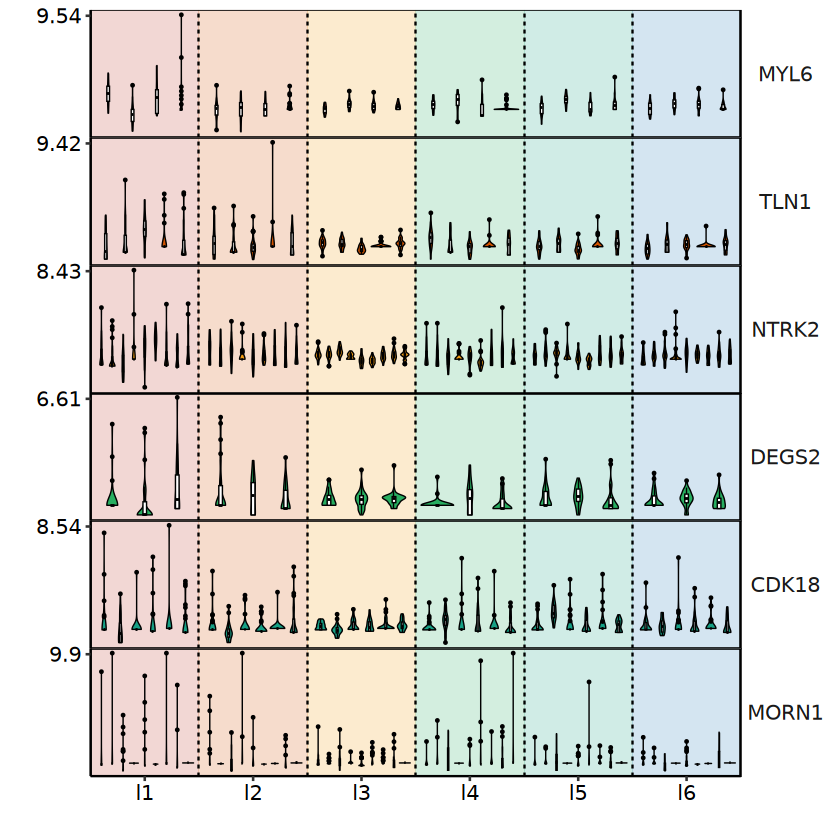

In [313]:
pc.box = modify_vlnplot(srt.sp, gmks)
pc.box

In [121]:
fsrawdp.cellb = qread("data/reads_full_anotation/longread_cell_position_24_03_29.qs")
fsrawdp.cell = fsrawdp[fsrawdp$class != "",] %>% 
    group_by(cell_id,gene_id,transcript_id,class,subclass) %>%
    summarise(x = mean(x),y = mean(y),
              readnum = length(unique(readid)))

`summarise()` has grouped output by 'cell_id', 'gene_id', 'transcript_id',
'class'. You can override using the `.groups` argument.


In [169]:
fsrawdp.cellf = fsrawdpf %>% 
    group_by(x,y,gene_id,transcript_id,class,subclass) %>%
    summarise(readnum = length(unique(readid)))
qsave(fsrawdp.cellf,"data/reads_full_anotation/longread_isoform_position_noambigious_24_05_14.qs")

`summarise()` has grouped output by 'x', 'y', 'gene_id', 'transcript_id',
'class'. You can override using the `.groups` argument.


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


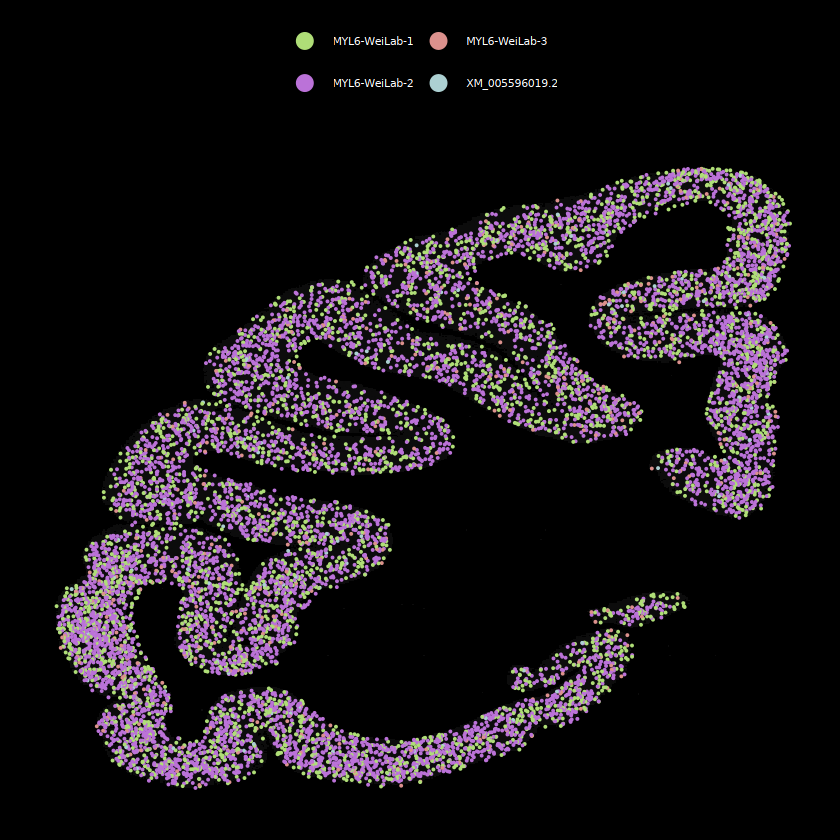

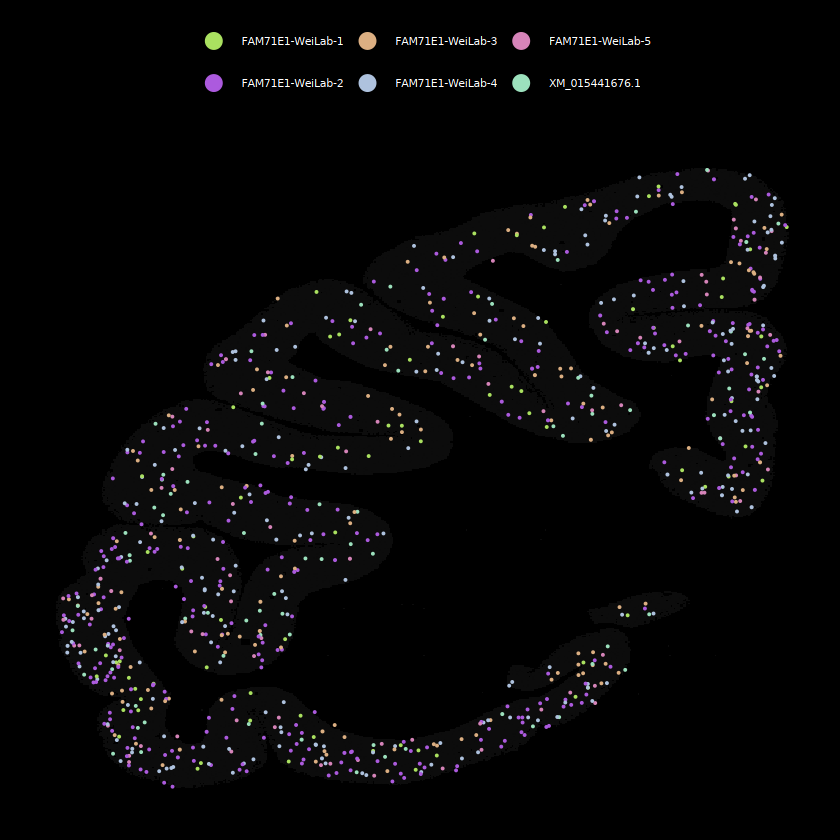

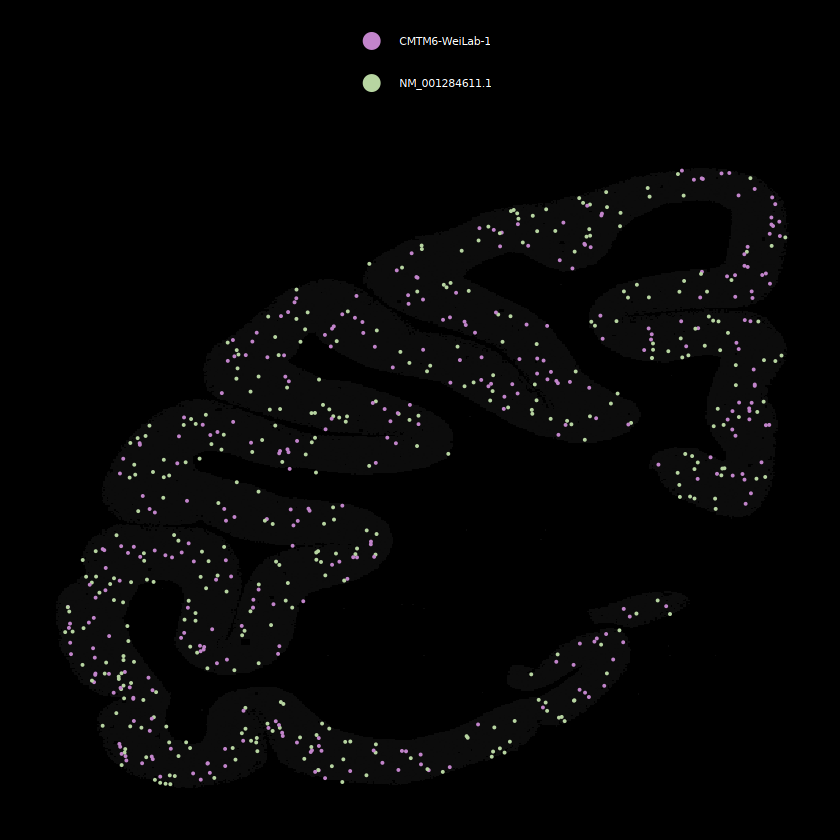

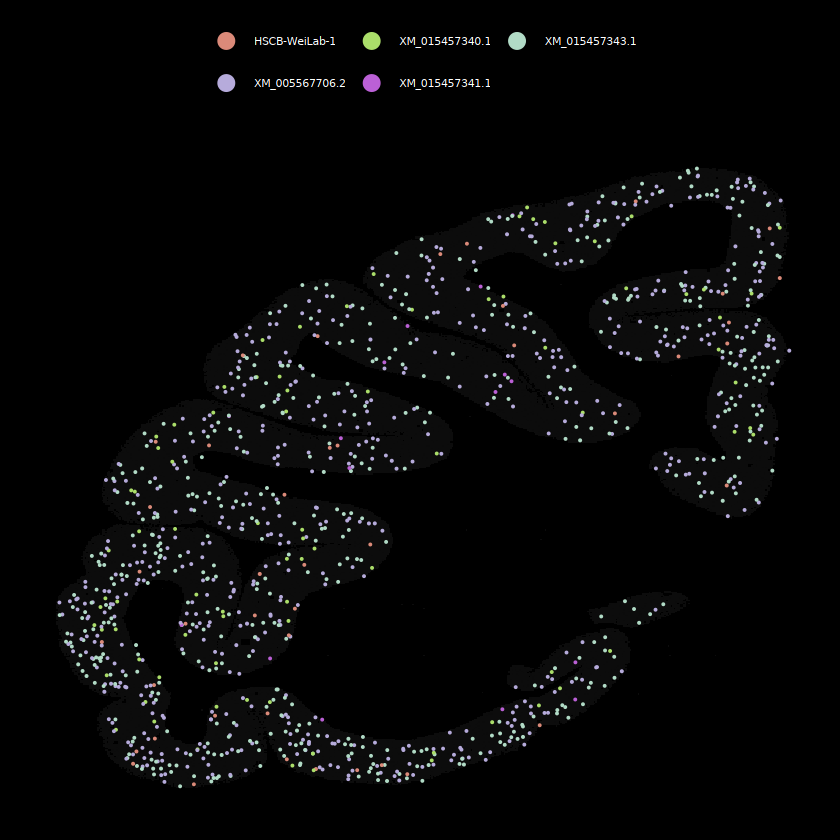

[[1]]

[[2]]

[[3]]

[[4]]

[[5]]

[[6]]


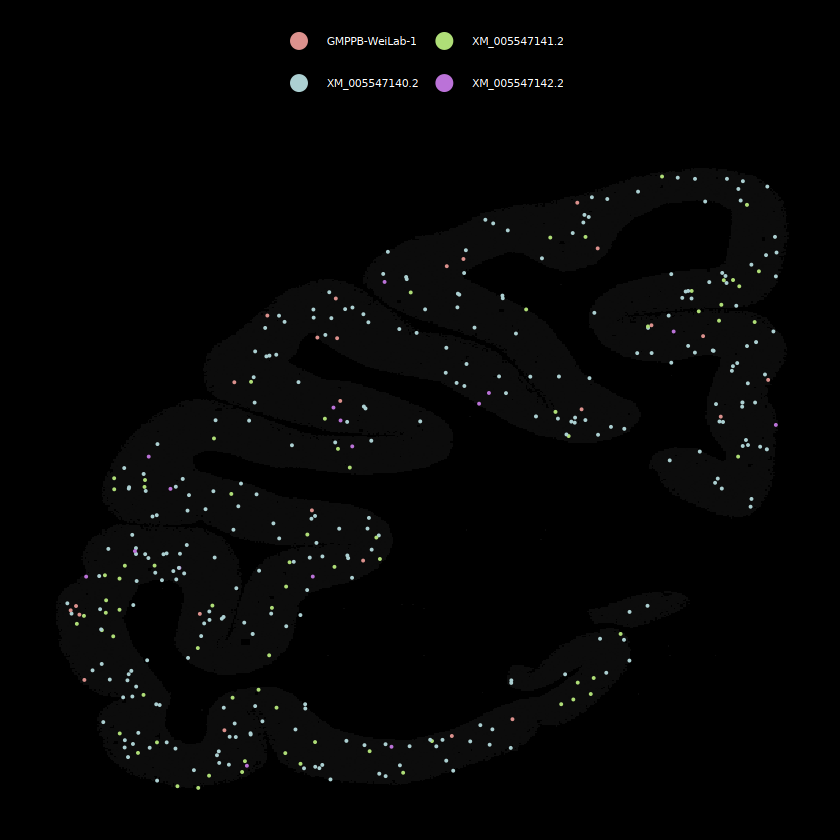

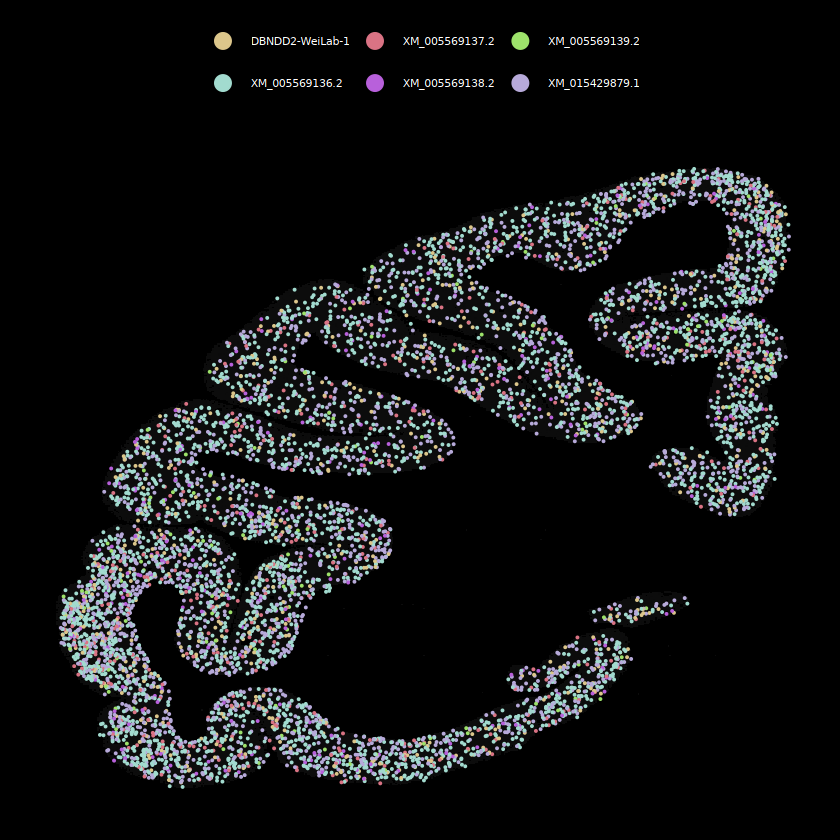

In [171]:
#plot in spatial and splicing
fsrawdpf = fsrawdpf[fsrawdpf$layer %in% paste0("l",1:6),]
gmks = c("MYL6","FAM71E1","CMTM6","HSCB","GMPPB","DBNDD2")
#geneex = "DBNDD2"
#fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_01.pdf")
isosigi = isosigls$layer
fsrawdpf$areatr = fsrawdpf$layer
fsrawdpf$chunk = fsrawdpf$lobe
pcpls = list()
pctls = list()
for(i in 1:6){
    pcpls[[i]] =  MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,gmks[i],hubtrans = NULL)
    grtdfl = BuildPlotBed(fsrawdpf,longbed,"layer",gmks[i],NULL)
    pctls[[i]] = IsoformReadPlot(gtf, grtdfl, gmks[i],onlyhub = T)
}
pcpls

In [174]:
pctlst = ggarrange(plotlist = pctls,nrow = 1)
pcplst = ggarrange(plotlist = pcpls,nrow = 1)
ggexport(pctlst,filename = "result/figure2/dtu_isoform_case_splice_plot_24_05_14.pdf",width = 24,height = 6)
ggexport(pcplst,filename = "result/figure2/dtu_isoform_case_spatial_plot_24_05_14.pdf",width = 24,height = 6)

Warning message:
"Removed 20497 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 13956 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 342 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 523 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2610 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 610 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1297 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1133 rows containing missing values or valu

##### Special Case plot

In [30]:
fsraw.cor = fsraw.cor[fsraw.cor$layer %in% paste0("l",1:6),]

In [26]:
pref = qread("../ref/area_figure_an.qs")
edgesdf = pref$layeredges
edgesdf = edgesdf[edgesdf$areaid %in% paste0("l",1:6),]
head(edgesdf)

,ind1,ind2,x1,y1,x2,y2,mx1,my1,mx2,my2,bp1,bp2,areaid
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
1385,7285,15438,46436,64705,46518,64693,46540.49,65132.87,46469.34,64646.63,0,0,l1
1386,16616,14951,46175,64676,46269,64674,46231.50,65121.50,46222.69,64707.37,0,0,l1
1387,33735,16616,46030,64696,46175,64676,46208.15,65451.96,46115.36,64779.21,0,0,l1
1388,3003,20924,46995,64656,46782,64591,46877.42,64659.80,46837.73,64789.86,0,0,l1
1389,4687,20924,46649,64706,46782,64591,46837.73,64789.86,46793.15,64738.31,0,0,l1
1390,32454,32318,47230,64665,47072,64696,47156.98,64710.96,47480.06,66357.65,0,0,l1


In [31]:
markdfb = unique(fsraw.cor[,c("x","y")])
ra = 200
markdfb$xid = as.integer(markdfb$x/(ra*2)) * ra * 2 + ra
markdfb$yid = as.integer(markdfb$y/(ra*2)) * ra * 2 + ra
markdfb$blockid = paste0(markdfb$xid,"_", markdfb$yid)
markdfb = unique(markdfb[,c("xid","yid","blockid")])
markdfb$genecount = 0
markdfb$count = 0
nrow(markdfb)

[1] 9632

In [44]:
edgesdf = pref$areaedges
edgesdf[edgesdf$areaid == "1/2",]$areaid = "1|2"
edgesdf = edgesdf[edgesdf$areaid %in% unique(fsraw.cor$region),]
head(edgesdf)

,ind1,ind2,x1,y1,x2,y2,mx1,my1,mx2,my2,bp1,bp2,areaid
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
83,264,3307,9617,57565,9606,57530,9621.866,57544.24,9380.357,57620.14,0,0,29
84,2954,264,9623,57633,9617,57565,9625.514,57598.51,9380.357,57620.14,0,0,29
85,777,2954,9656,57746,9623,57633,9518.099,57724.95,9351.864,57773.50,0,0,29
86,1689,3380,9547,56808,9562,56750,9562.446,56781.06,9165.461,56678.39,0,0,29
87,1698,3161,9657,57934,9656,57801,9693.115,57867.22,8842.147,57873.62,0,0,29
88,699,1689,9548,56923,9547,56808,9543.395,56865.54,7310.413,56884.95,0,0,29


In [144]:
gmks = c("MYL6","FAM71E1","CMTM6","HSCB","GMPPB","DBNDD2")
unique(fsraw.cor[fsraw.cor$gene_id == "CMTM6",]$transcript_id)
markdf = fsraw.cor[fsraw.cor$gene_id == "CMTM6",]
markdf = markdf %>% group_by(lobe) %>% 
      mutate(genecount = length(unique(readid))) %>%
      group_by(lobe,transcript_id) %>% 
      summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)
markdf

[1] "NM_001284611.1" "CMTM6-WeiLab-1" "BambuTx4281"

`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.


lobe,transcript_id,count,genecount,rate
<chr>,<chr>,<int>,<int>,<dbl>
auditory,BambuTx4281,6,76,0.07894737
auditory,CMTM6-WeiLab-1,28,76,0.36842105
auditory,NM_001284611.1,42,76,0.55263158
cingulate,BambuTx4281,6,121,0.04958678
cingulate,CMTM6-WeiLab-1,43,121,0.35537190
cingulate,NM_001284611.1,72,121,0.59504132
occipital,BambuTx4281,11,95,0.11578947
occipital,CMTM6-WeiLab-1,35,95,0.36842105
occipital,NM_001284611.1,49,95,0.51578947


`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/CMTM6_lobe_case_bin200_24_08_24.pdf



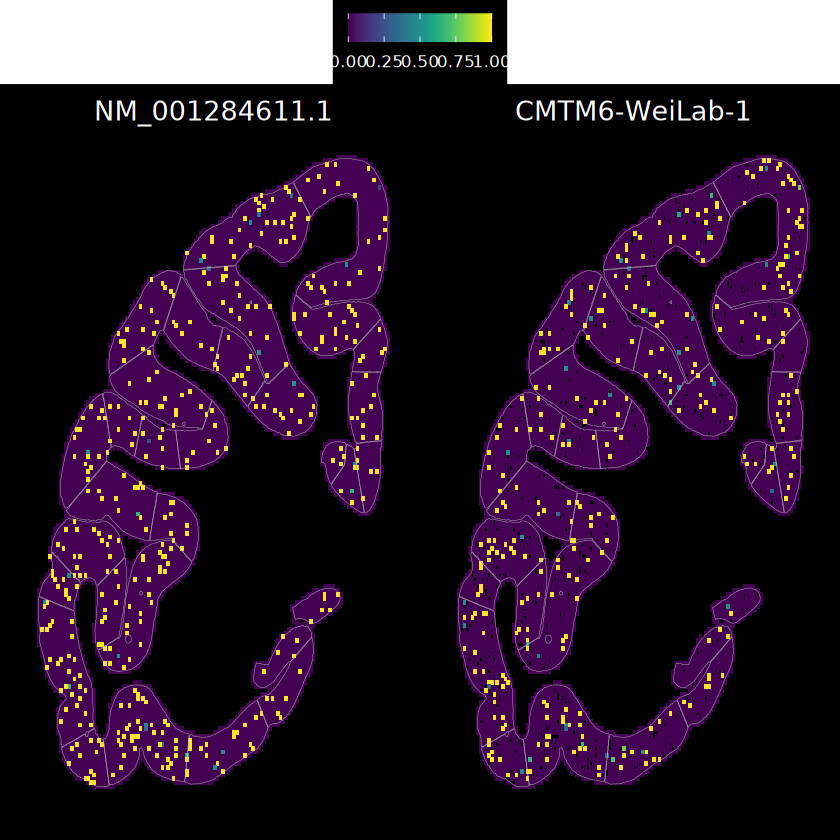

In [145]:
geneex = "CMTM6"
transid = c('NM_001284611.1','CMTM6-WeiLab-1')
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_lobe_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt

`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/MYL6_layer_case_bin200_24_08_24.pdf

`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/DDRGK1_layer_case_bin200_24_08_24.pdf



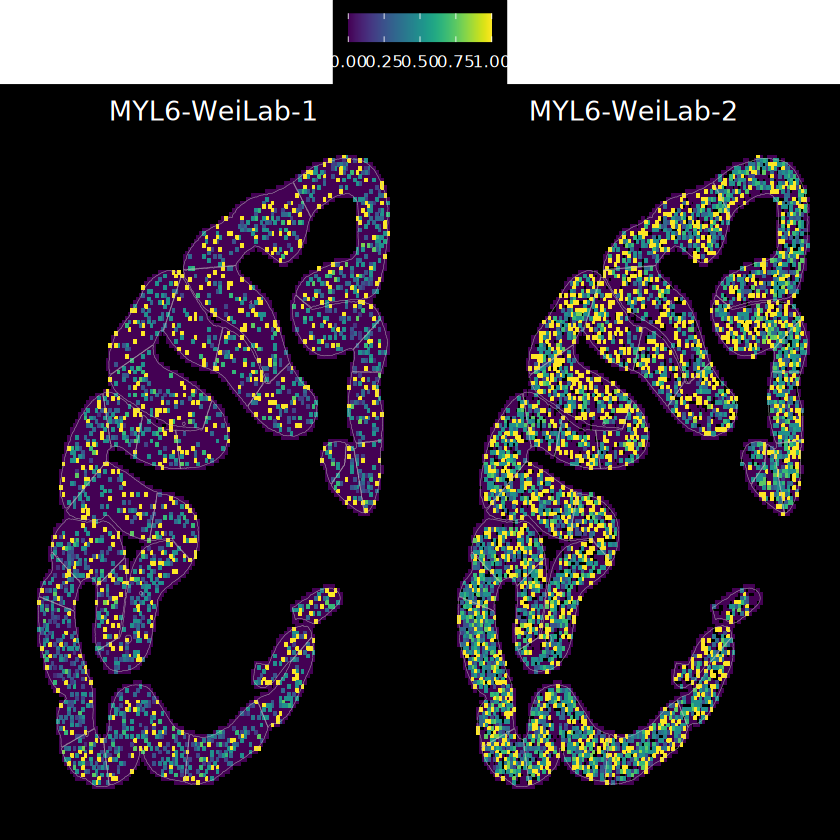

`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/ARPP19_layer_case_bin200_24_08_24.pdf



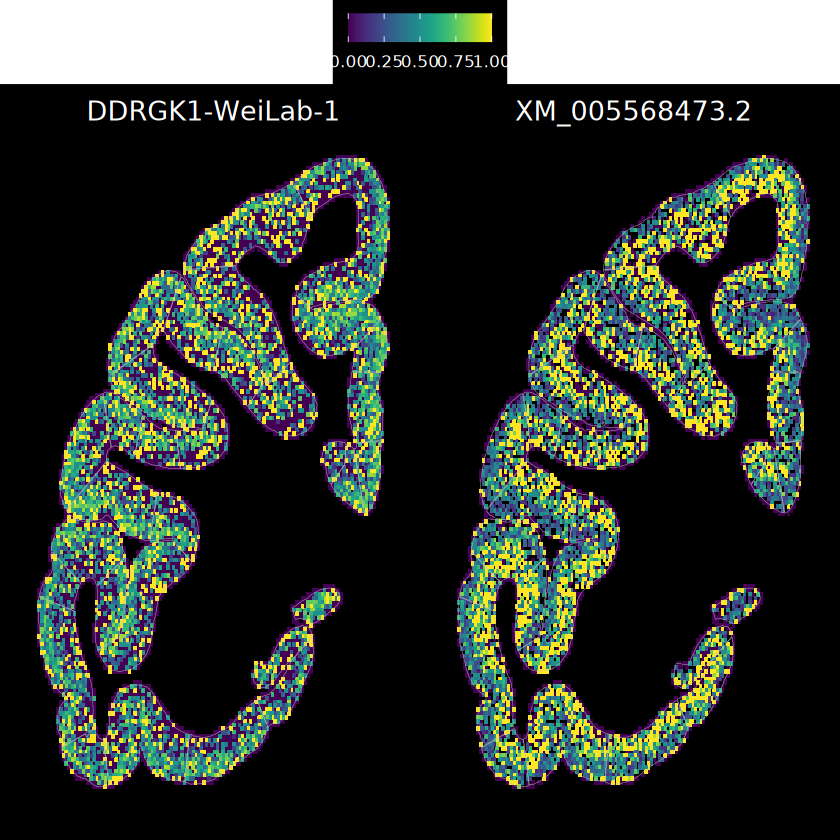

`summarise()` has grouped output by 'xid', 'yid', 'blockid'. You can override
using the `.groups` argument.
file saved to result/figure2/DBNDD2_layer_case_bin200_24_08_24.pdf



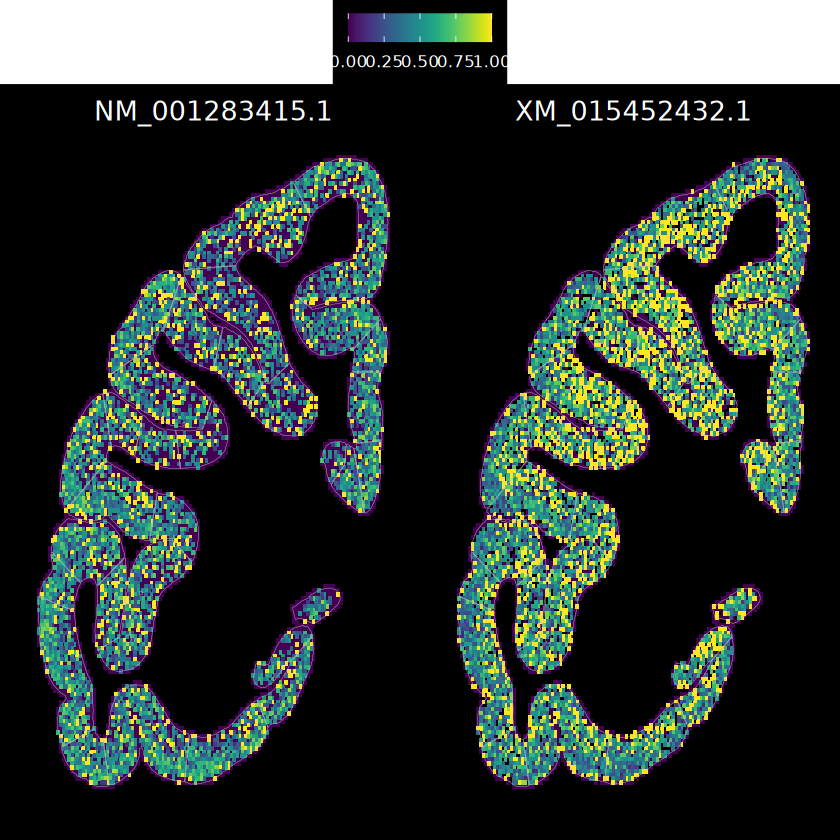

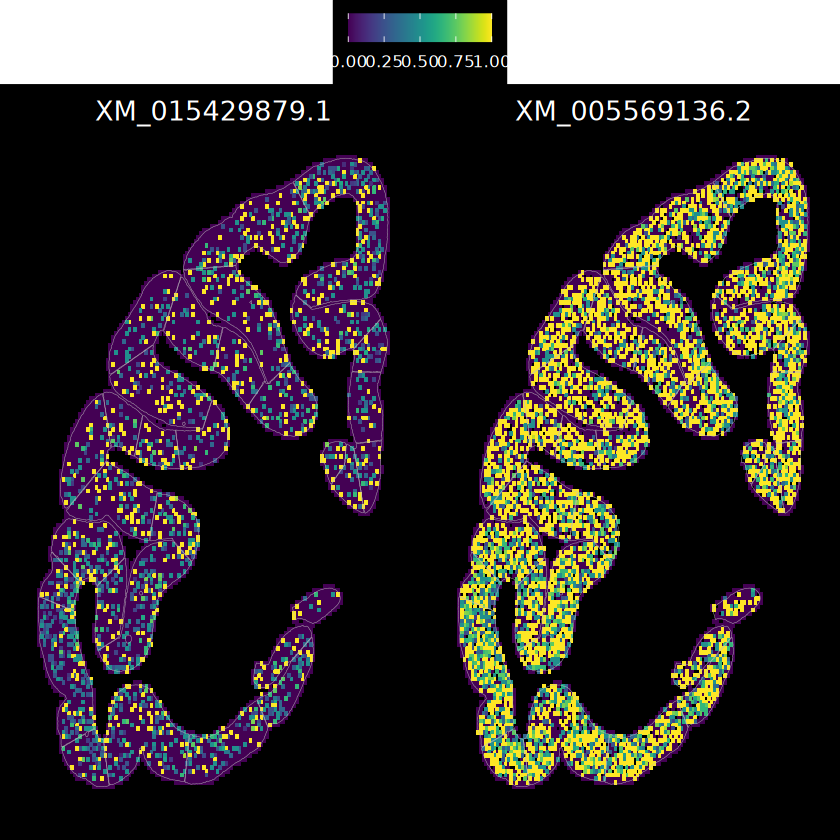

In [142]:
geneex = "MYL6"
transid = c("MYL6-WeiLab-1","MYL6-WeiLab-2")
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_layer_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt
#transid = c("XM_015429879.1","XM_005569136.2")
#transid = c("DDRGK1-WeiLab-1","XM_005568473.2")
#geneex = "CMTM6"
#transid = c("CMTM6-WeiLab-1","NM_001284611.1")
#geneex = "GMPPB"
#transid = c("XM_005547141.2","XM_005547140.2")

geneex = "DDRGK1"
transid = c("DDRGK1-WeiLab-1","XM_005568473.2")
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_layer_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt

geneex = "ARPP19"
transid = c("NM_001283415.1","XM_015452432.1")
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_layer_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt

geneex = "DBNDD2"
transid = c("XM_015429879.1","XM_005569136.2")
pmkpt = MarkerSpPlot(fsraw.cor,markdfb,geneex,transid,edgesdf,200)
fileid = paste0("result/figure2/",geneex,"_layer_case_bin200_24_08_24.pdf")
ggexport(pmkpt,filename = fileid,width = 8,height = 6)
pmkpt

In [650]:
qsave(fsraw.cor,"data/reads_full_anotation/main_data_read_total_annotation_dedup_forplot_onlycortex_24_05_01.qs")

In [7]:
fsraw.cor = qread("data/reads_full_anotation/main_data_read_total_annotation_dedup_forplot_onlycortex_24_05_01.qs")

In [8]:
fsrawdp.cell = qread("longread_cell_isoform_without_subcortical_24_04_29.qs")

[1] "#B8D49F" "#C085C8"
# A tibble: 6 × 13
# Groups:   group [3]
  readid     seqnames start   end width strand score group transcript_id readord
  <chr>      <fct>    <int> <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 264dcb9c-… NW_0050…   116  1903  1788 +          0 l3    MYL6-WeiLab-1 MYL6-W…
2 8065f1af-… NW_0050…   198   300   103 -          0 l1    MYL6-WeiLab-1 MYL6-W…
3 6ba04bad-… NW_0050…   216  1770  1555 +          0 l6    MYL6-WeiLab-1 MYL6-W…
4 deda91b6-… NW_0050…   226  1127   902 -          0 l6    MYL6-WeiLab-1 MYL6-W…
5 92f51f0c-… NC_0126…  2752  3196   445 +         58 l3    MYL6-WeiLab-1 MYL6-W…
6 92f51f0c-… NW_0050…  3956  4400   445 +          0 l3    MYL6-WeiLab-1 MYL6-W…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Removed 19729 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 13686 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 289 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 487 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2422 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning

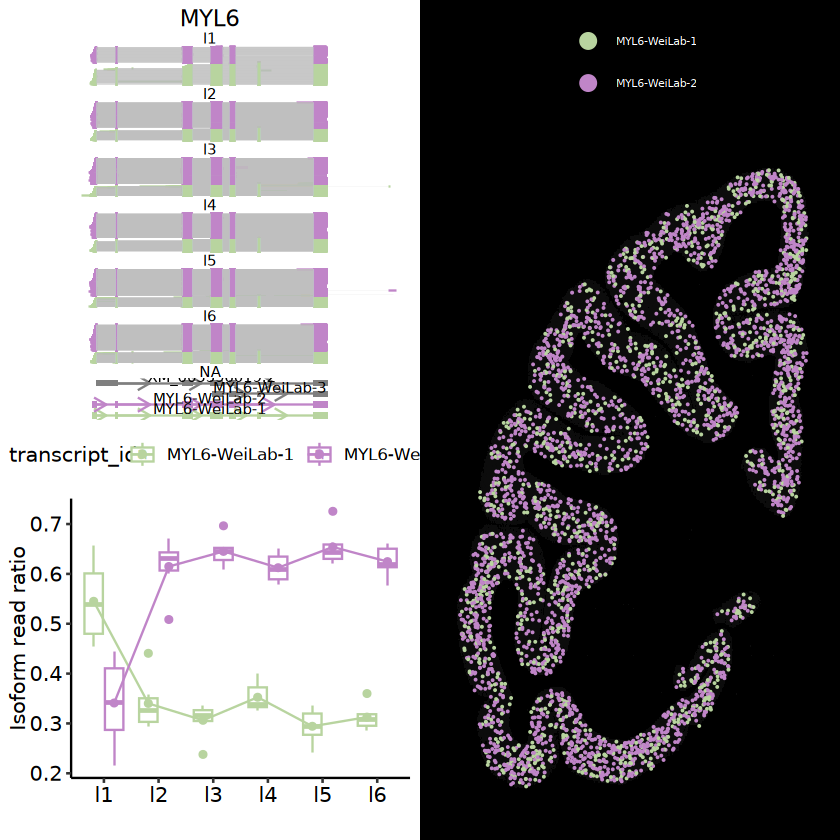

In [580]:
#edgesdf = pref$layeredges
#edgesdf = edgesdf[edgesdf$areaid %in% paste0("l",1:6),]
#head(edgesdf)
fsraw.cor = qread("data/reads_full_anotation/main_data_read_total_annotation_dedup_forplot_onlycortex_24_05_01.qs")
fsrawdp.cell = qread("longread_cell_isoform_without_subcortical_24_04_29.qs")
geneex = "MYL6"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_01.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
hubtrans = c("MYL6-WeiLab-1","MYL6-WeiLab-2")
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,hubtrans,fsrawdp.cell)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

[1] "#B8D49F" "#C085C8"
# A tibble: 6 × 13
# Groups:   group [2]
  readid     seqnames start   end width strand score group transcript_id readord
  <chr>      <fct>    <int> <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 7e1420f1-… NW_0050…   216  1903  1688 -          0 l2    DDRGK1-WeiLa… DDRGK1…
2 11a73bfc-… NW_0050…   242  1903  1662 +          0 l3    DDRGK1-WeiLa… DDRGK1…
3 abc07e19-… NW_0050…   351  1902  1552 -          0 l2    DDRGK1-WeiLa… DDRGK1…
4 5f2d3269-… NW_0050…  1069  1903   835 -          0 l3    DDRGK1-WeiLa… DDRGK1…
5 79e68f9c-… NW_0050…  1154  1690   537 -          0 l3    DDRGK1-WeiLa… DDRGK1…
6 d9990679-… NW_0050…  1280  1692   413 -          0 l3    DDRGK1-WeiLa… DDRGK1…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Removed 439 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 325 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 4 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 16 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 60 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message

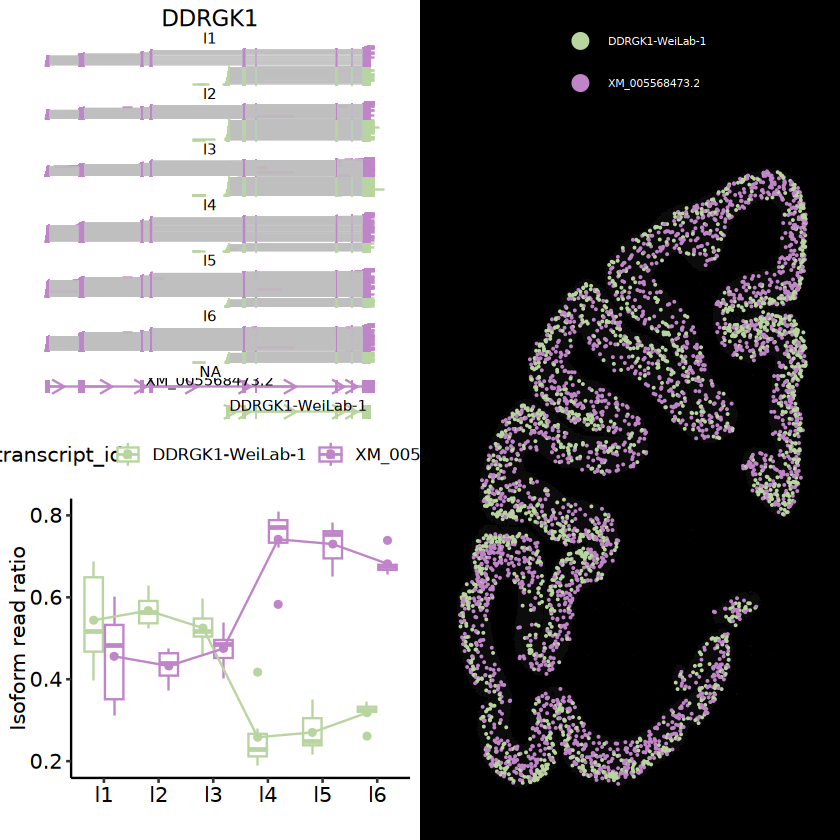

In [579]:
geneex = "DDRGK1"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_01.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,NULL,fsrawdp.cell)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

[1] "#C085C8" "#B8D49F"
# A tibble: 6 × 13
# Groups:   group [2]
  readid   seqnames  start    end width strand score group transcript_id readord
  <chr>    <fct>     <int>  <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 TB2000B… NC_0126… 9.65e2 1.24e3   271 +          0 l3    DBNDD2-WeiLa… DBNDD2…
2 3ebc480… NC_0222… 1.33e7 1.33e7  1119 +          0 l3    DBNDD2-WeiLa… DBNDD2…
3 3448440… NC_0222… 1.91e7 1.91e7   733 +         60 l3    DBNDD2-WeiLa… DBNDD2…
4 TB2000A… NC_0222… 3.10e7 3.10e7   383 +          0 l6    DBNDD2-WeiLa… DBNDD2…
5 TB2000B… NC_0222… 5.03e7 5.03e7    88 +         24 l3    DBNDD2-WeiLa… DBNDD2…
6 TB2000B… NC_0222… 5.03e7 5.03e7    60 +         24 l3    DBNDD2-WeiLa… DBNDD2…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Removed 279 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 225 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 8 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 21 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:

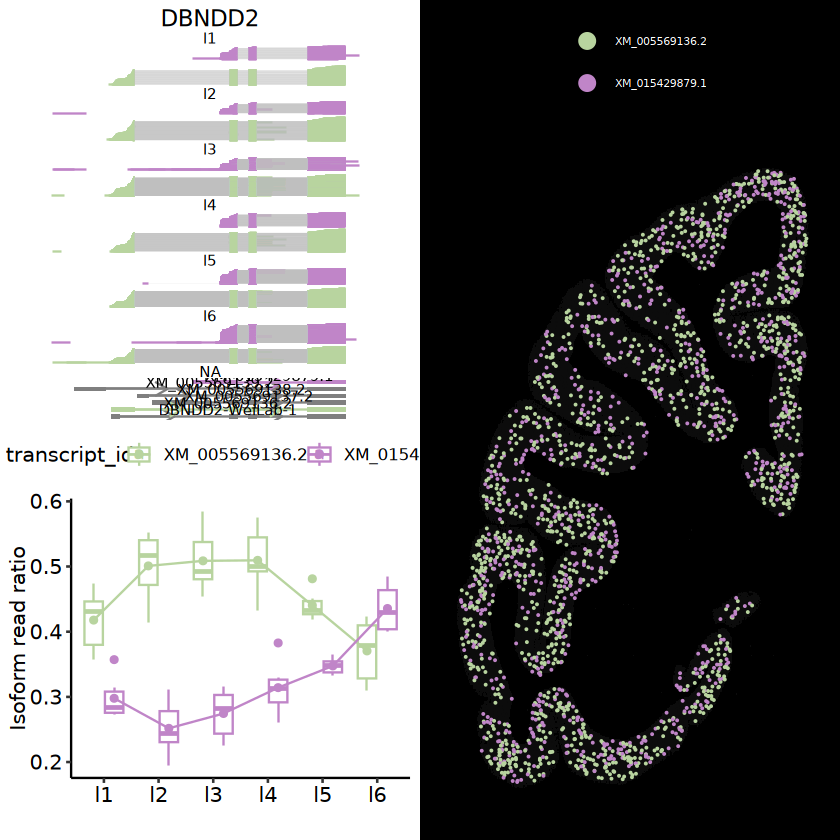

In [581]:
geneex = "DBNDD2"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_01.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
hubtrans = c("XM_015429879.1","XM_005569136.2")
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,hubtrans,fsrawdp.cell)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

[1] "#BDC3C4" "#B0DC7B" "#C270CC"
# A tibble: 6 × 13
# Groups:   group [3]
  readid   seqnames  start    end width strand score group transcript_id readord
  <chr>    <fct>     <int>  <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 TB2000A… NC_0222… 1.42e8 1.42e8   350 -         60 l5    XM_015449709… XM_015…
2 TB2000B… NC_0222… 1.42e8 1.42e8   181 -         60 l4    XM_015449709… XM_015…
3 TB2000A… NC_0222… 1.43e8 1.43e8   321 +         60 l3    XM_015449709… XM_015…
4 TB2000A… NC_0222… 1.43e8 1.43e8   140 -         60 l5    XM_015449709… XM_015…
5 TB2000B… NC_0222… 1.43e8 1.43e8   140 -         60 l4    XM_015449709… XM_015…
6 TB2000A… NC_0222… 1.43e8 1.43e8   501 -         60 l5    XM_015449709… XM_015…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Removed 11 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 11 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Computation failed in `stat_compare_means()`.
Caused by error in `mutate()`:
ℹ In argument: `p = purrr::map(...)`.
Caused by error in `purrr::map()`:
ℹ In index: 1.
ℹ With name: x.1.
Caused by error in `t.test.default()`:
! not enough 'x' observations"
file saved to result/figure2/ZSCAN31_layer_case_24_05_20.pdf



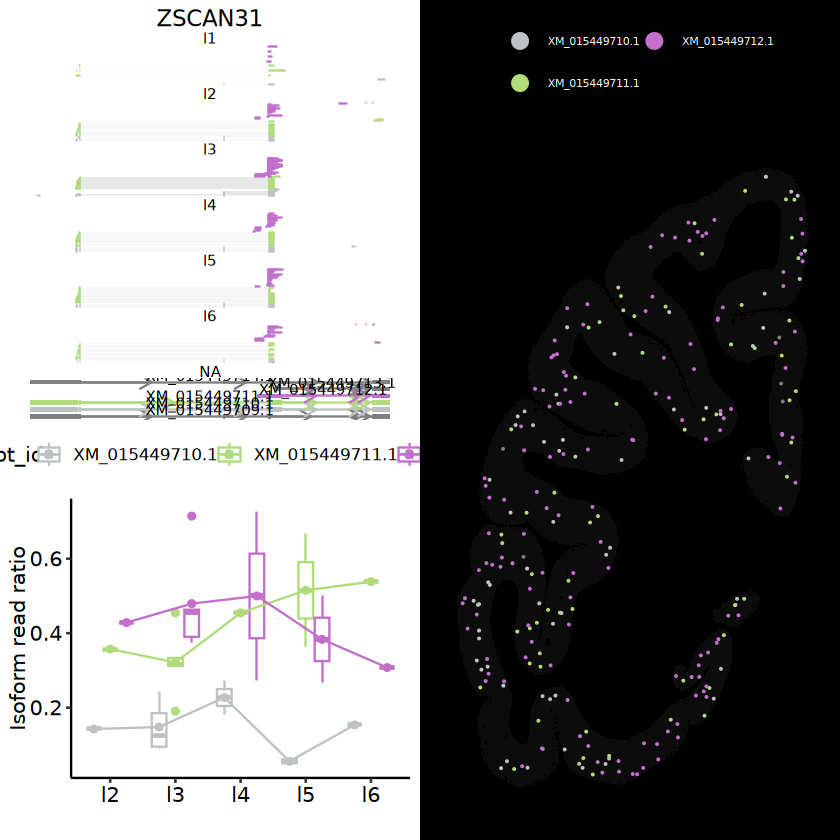

In [192]:
geneex = "ZSCAN31"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_20.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,NULL,fsrawdp.cell)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

In [ ]:
geneex = "ARPP19"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_05_20.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex,c("NM_001283415.1","XM_015452431.1"),fsrawdp.cell)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

`summarise()` has grouped output by 'lobe', 'region', 'blockid'. You can
override using the `.groups` argument.
`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.
file saved to result/figure2/bambu_iso_case_DDRGK1_lobe_barplot_05_01.pdf



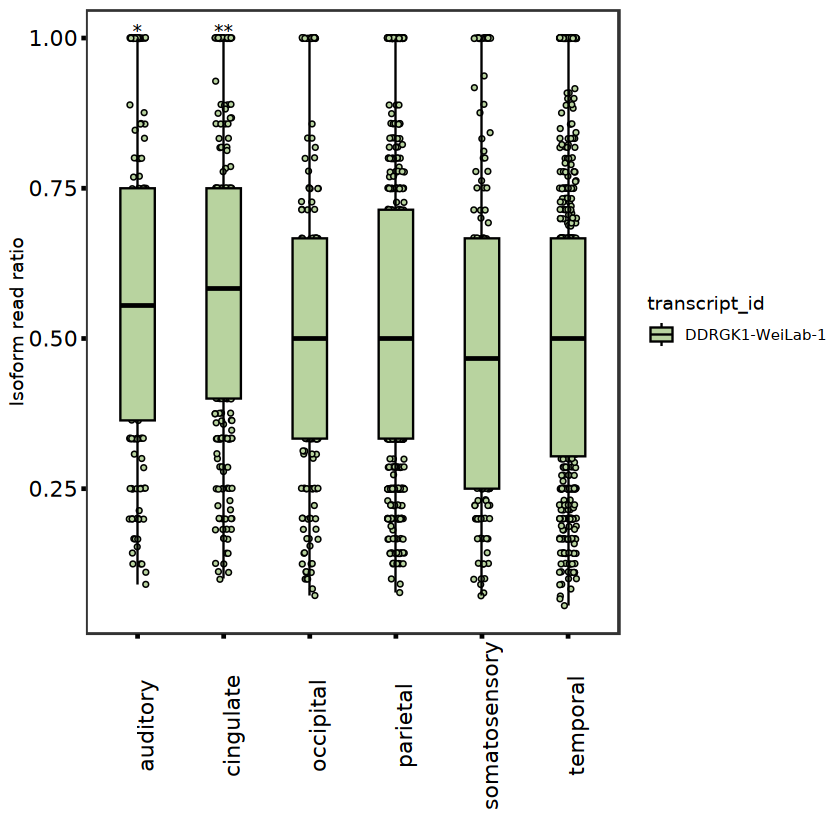

In [599]:
geneex = "DDRGK1"

ra = 400
npclfc = fsraw.cor[fsraw.cor$gene_id == geneex,]
npclfc$xid = as.integer(npclfc$x/(ra*2)) * ra * 2 + ra
npclfc$yid = as.integer(npclfc$y/(ra*2)) * ra * 2 + ra
npclfc$blockid = paste0(npclfc$xid,"_", npclfc$yid)

npclfc = npclfc %>% dplyr::group_by(lobe,region,blockid) %>% 
      dplyr::mutate(genecount = length(unique(readid))) %>%
      dplyr::group_by(lobe,region,blockid,transcript_id) %>% 
      dplyr::summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)
npclfcm2 = npclfc %>% group_by(lobe,transcript_id) %>% 
      summarise(mean = mean(rate),sd = sd(rate))
mycolors = distinctColorPalette(2)
pcbx2 = ggplot(npclfc[npclfc$transcript_id == "DDRGK1-WeiLab-1",],
                  aes(x = lobe, y = rate, fill = transcript_id)) +
      geom_jitter(shape=21,size=1,width=0.1) +
      geom_boxplot(width=0.4,size=0.5,color = "black") +
      # geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color = NA)+
      stat_compare_means(label = "p.signif",hide.ns = T,method = "t.test",ref.group = ".all.") + 
      scale_fill_manual(values = "#B8D39F") +
            theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
        xlab("") + ylab("Isoform read ratio")
pcbx2
ggexport(pcbx2,filename = "result/figure2/bambu_iso_case_DDRGK1_lobe_barplot_05_01.pdf",width = 5,height = 4)

`summarise()` has grouped output by 'lobe', 'region', 'blockid'. You can
override using the `.groups` argument.
`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.
file saved to result/figure2/bambu_iso_case_DBNDD2_lobe_barplot_05_01.pdf



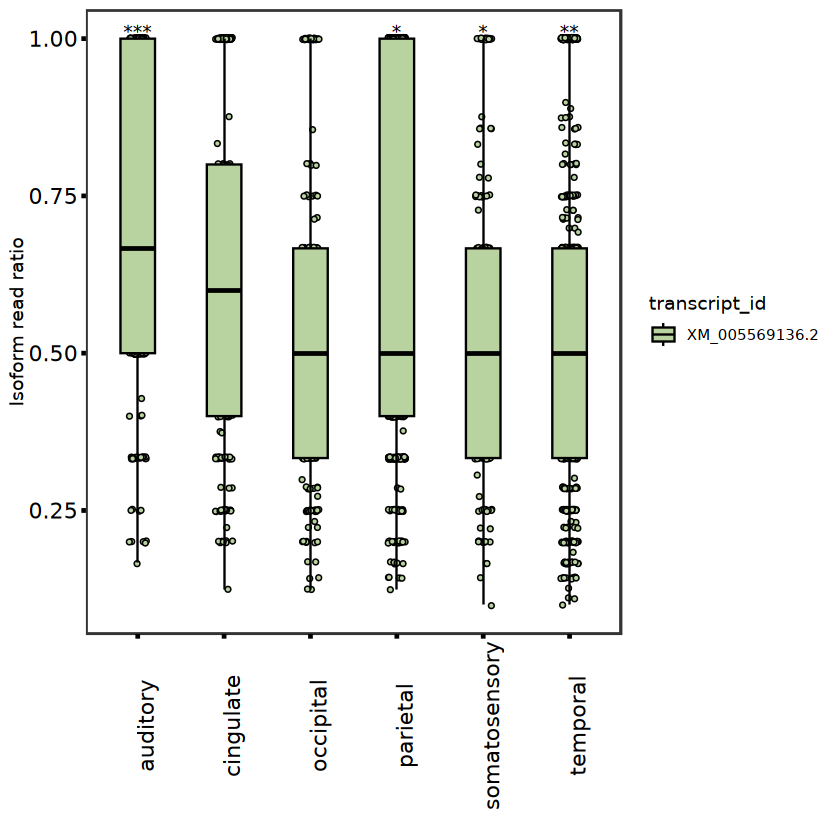

In [601]:
geneex = "DBNDD2"
ra = 400
npclfc = fsraw.cor[fsraw.cor$gene_id == geneex,]
npclfc$xid = as.integer(npclfc$x/(ra*2)) * ra * 2 + ra
npclfc$yid = as.integer(npclfc$y/(ra*2)) * ra * 2 + ra
npclfc$blockid = paste0(npclfc$xid,"_", npclfc$yid)

npclfc = npclfc %>% dplyr::group_by(lobe,region,blockid) %>% 
      dplyr::mutate(genecount = length(unique(readid))) %>%
      dplyr::group_by(lobe,region,blockid,transcript_id) %>% 
      dplyr::summarise(count = length(unique(readid)),genecount = genecount[1],
                       rate = count/genecount)
npclfcm2 = npclfc %>% group_by(lobe,transcript_id) %>% 
      summarise(mean = mean(rate),sd = sd(rate))
mycolors = distinctColorPalette(2)
pcbx2 = ggplot(npclfc[npclfc$transcript_id == "XM_005569136.2",],
                  aes(x = lobe, y = rate, fill = transcript_id)) +
      geom_jitter(shape=21,size=1,width=0.1) +
      geom_boxplot(width=0.4,size=0.5,color = "black") +
      # geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color = NA)+
      stat_compare_means(label = "p.signif",hide.ns = T,method = "t.test",ref.group = ".all.") + 
      scale_fill_manual(values = "#B8D39F") +
            theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
        xlab("") + ylab("Isoform read ratio")
pcbx2
ggexport(pcbx2,filename = "result/figure2/bambu_iso_case_DBNDD2_lobe_barplot_05_01.pdf",width = 5,height = 4)

In [540]:
isosigi = isosigls$layer[isosigls$layer$sig == "Up",]
isosigi = isosigi[order(-isosigi$genecount,-isosigi$dr),]
write.csv(isosigi,file = "result/figure2/layer_sigiso_rank.csv",quote = F, row.names = F)

isosigi = isosigls$lobe[isosigls$lobe$sig == "Up",]
isosigi = isosigi[order(-isosigi$genecount,-isosigi$dr),]
write.csv(isosigi,file = "result/figure2/lobe_sigiso_rank.csv",quote = F, row.names = F)

In [ ]:
gmks = c("MYL6","TLN1","NTRK2","DEGS2","PRDM11","MORN1")
geneex = "CAPRIN1"

pci3 = MarkerSpPlot(fsrawdp.cellf,fsrawdp.cellb,geneex,hubtrans = NULL)
pci3

[1] "#B9D3A1" "#BF7FC8"
# A tibble: 6 × 13
# Groups:   group [4]
  readid     seqnames start   end width strand score group transcript_id readord
  <chr>      <fct>    <int> <int> <int> <fct>  <dbl> <chr> <chr>         <chr>  
1 2fd4ca79-… NW_0050…   200   585   386 -          0 l2    XM_005581140… XM_005…
2 f809779f-… NW_0050…   376   699   324 -         60 l3    XM_005581140… XM_005…
3 f2ddd2a3-… NW_0050…   471  1903  1433 +          0 l6    XM_005581140… XM_005…
4 m84129_24… NW_0050…   779  1045   267 +          0 l5    XM_005581140… XM_005…
5 a0972e95-… NW_0050…   810  1315   506 +          0 l5    XM_005581140… XM_005…
6 7390aa6d-… NW_0050…   990  1699   710 +          0 l3    XM_005581140… XM_005…
# ℹ 3 more variables: orid <dbl>, oridnorm <dbl>, sig <chr>


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'areatr', 'chunk'. You can override using
the `.groups` argument.
Warning message:
"Removed 231 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 142 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 9 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 5 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 28 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 9 rows containing missing values or values outside the scale range
(`geom_segment()

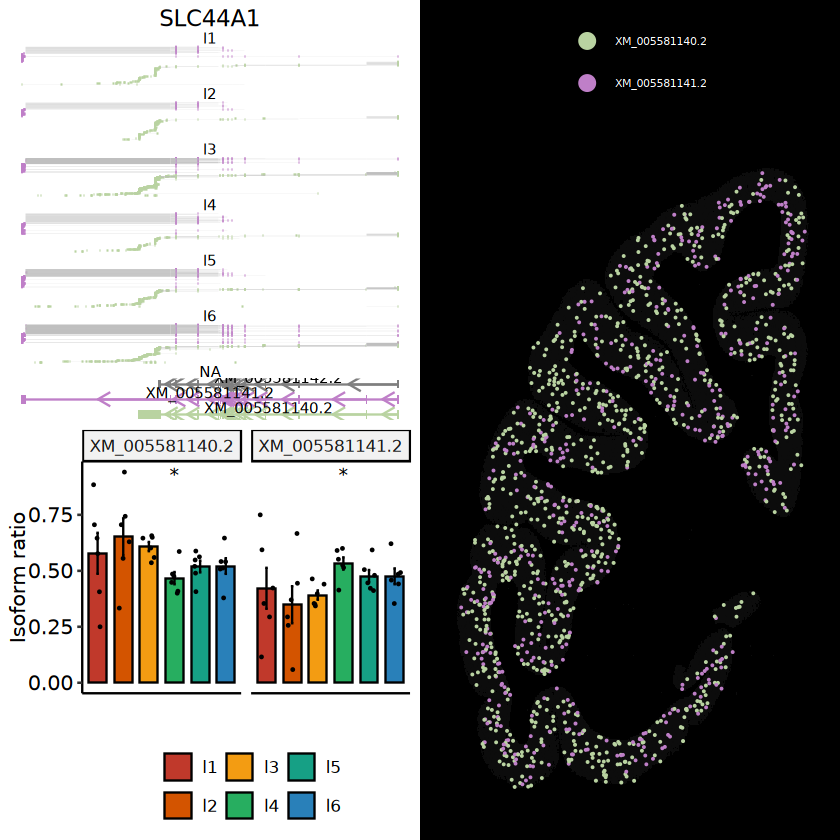

In [231]:
geneex = "SLC44A1"
fileid = paste0("result/figure2/",geneex,"_layer_case_24_04_29.pdf")
isosigi = isosigls$layer
fsraw.cor$areatr = fsraw.cor$layer
fsraw.cor$chunk = fsraw.cor$lobe
pc1 = CasePlotTotalClass(fsraw.cor,isosigi,gtf,geneex)
pc1
ggexport(pc1,filename = fileid,width = 8,height = 6)

#### DDRGK1 NGS case compare

In [241]:
longbedngs = import("data/reads_full_anotation/ngs_bed_file/DDRGK1_ngs.bed", format = "BED")
head(longbedngs)
#qsave(longbed,"ref/long_read_mapping_total_rawnano_pac2_24_03_29.qs")

GRanges object with 6 ranges and 2 metadata columns:
         seqnames            ranges strand |                   name     score
            <Rle>         <IRanges>  <Rle> |            <character> <numeric>
  [1] NC_022281.1 58561264-59376369      + | FP200002078L1C035R02..         0
  [2] NC_022281.1 58602518-59604441      + | FP200002078L1C061R03..       255
  [3] NC_022281.1 58603983-59454413      - | FP200002078L1C027R03..         0
  [4] NC_022281.1 58603983-59454413      - | FP200002078L1C010R03..         0
  [5] NC_022281.1 58604835-59323690      - | FP200002078L1C082R00..       255
  [6] NC_022281.1 58604835-59323690      - | FP200002078L1C008R00..       255
  -------
  seqinfo: 1 sequence from an unspecified genome; no seqlengths

In [281]:
refdf = qread("/cluster/home/liuhengxin/P1_brain_nanopore/ref/T44_dedup_with_cellan_23_03_23.qs")
head(refdf)

,x,y,cell_label,gene_area,rx,ry,CBZ,origin_name,global_region_id,no,cell_id,cell_type_id,cell_type,subclass,class,cell_type_color
,<int>,<int>,<int>,<int>,<int>,<int>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,10204,26115,0,0,56131,12632,CB:Z:10204_26115,background,0,NA,NA,NA,,,,
2,10205,26115,0,0,56130,12632,CB:Z:10205_26115,background,0,NA,NA,NA,,,,
3,10206,26116,0,0,56129,12633,CB:Z:10206_26116,background,0,NA,NA,NA,,,,
4,10199,26117,0,0,56136,12634,CB:Z:10199_26117,background,0,NA,NA,NA,,,,
5,10201,26117,0,0,56134,12634,CB:Z:10201_26117,background,0,NA,NA,NA,,,,
6,10203,26117,0,0,56132,12634,CB:Z:10203_26117,background,0,NA,NA,NA,,,,


In [284]:
longbedngs$CBZ = MySplit(longbedngs$name,"\\|\\|\\|",3)
longbedngs$origin_name = refdf[match(longbedngs$CBZ,refdf$CBZ),]$origin_name
length(longbedngs)

[1] 1102474

In [287]:
longbedngs = longbedngs[!is.na(longbedngs$origin_name)]
length(longbedngs)
longbedngs = longbedngs[longbedngs$origin_name != "background"]
length(longbedngs)
longbedngs$layer = MySplit(longbedngs$origin_name,"-",3)
longbedngs = longbedngs[longbedngs$layer %in% paste0("l",1:6)]
head(longbedngs)
length(longbedngs)
qsave(longbedngs,"data/reads_full_anotation/ngs_bed_file/DDRGK1_ngs_withan_fil.qs")

[1] 836709

[1] 675009

GRanges object with 6 ranges and 5 metadata columns:
         seqnames            ranges strand |                   name     score
            <Rle>         <IRanges>  <Rle> |            <character> <numeric>
  [1] NC_022281.1 58603983-59454413      - | FP200002078L1C010R03..         0
  [2] NC_022281.1 58604835-59323690      - | FP200002078L1C082R00..       255
  [3] NC_022281.1 58604835-59323690      - | FP200002078L1C008R00..       255
  [4] NC_022281.1 58679679-59435274      - | FP200002078L1C004R03..         3
  [5] NC_022281.1 58717539-59378520      - | FP200002078L1C044R05..         3
  [6] NC_022281.1 58744220-59343395      - | FP200002078L1C026R02..       255
                   CBZ origin_name       layer
           <character> <character> <character>
  [1]  CB:Z:8063_52027    L-23b-l5          l5
  [2] CB:Z:41617_90243   L-TEpv-l2          l2
  [3] CB:Z:41617_90243   L-TEpv-l2          l2
  [4] CB:Z:53388_76552    L-TEO-l2          l2
  [5] CB:Z:48325_58836    L-CPB-l4       

[1] 585667

In [242]:
longbedngs = qread("data/reads_full_anotation/ngs_bed_file/DDRGK1_ngs_withan_fil.qs")

In [293]:
gtfhub = gtf[gtf$gene_id == "DDRGK1",]
gtfhub = gtfhub[gtfhub$type == "exon",]
overlaps = findOverlaps(query = longbedngs, subject = gtfhub)
readgroup = data.frame(
  readid = longbedngs[queryHits(overlaps)]$name,
  transcript_id = gtfhub[subjectHits(overlaps)]$transcript_id
)
readgroup$gene_id = "DDRGK1"


,readid,transcript_id,gene_id
,<chr>,<chr>,<chr>
1,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,XM_005568473.2,DDRGK1
2,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,XM_005568473.2,DDRGK1
3,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,XM_005568473.2,DDRGK1
4,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,XM_005568473.2,DDRGK1
5,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,DDRGK1-WeiLab-1,DDRGK1
6,FP200002078L1C022R00603795428|||CB:S:TAGGGATCGTTTGCTTTCTTATCCT|||CB:Z:43619_89188|||UR:Z:TAGCATTATT|||UY:Z:CCGIAGF,DDRGK1-WeiLab-1,DDRGK1


[1] 1441623

In [299]:
readgroup = readgroup %>% group_by(readid) %>% mutate(transnum = length(unique(transcript_id)))
readgroup_rm = readgroup
readgroup_rm[readgroup_rm$transnum > 1,]$transcript_id = "ambitious"
readgroup_rm = unique(readgroup_rm)
nrow(readgroup_rm)

[1] 574774

In [300]:
readgroup_rm$CBZ = MySplit(readgroup_rm$readid,"\\|\\|\\|",3)
readgroup_rm$origin_name = refdf[match(readgroup_rm$CBZ,refdf$CBZ),]$origin_name
readgroup_rm = readgroup_rm[!is.na(readgroup_rm$origin_name),]
readgroup_rm = readgroup_rm[readgroup_rm$origin_name != "background",]
readgroup_rm$layer = MySplit(readgroup_rm$origin_name,"-",3)
readgroup_rm = readgroup_rm[readgroup_rm$layer %in% paste0("l",1:6),]
readgroup_rm$areatr = readgroup_rm$layer
qsave(readgroup_rm,"data/reads_full_anotation/ngs_bed_file/DDRGK1_ngs_readgroup.qs")

In [245]:
readgroup_rm = qread("data/reads_full_anotation/ngs_bed_file/DDRGK1_ngs_readgroup.qs")
readgroup_rm$transcript_id = "unknown"

In [257]:
IsoformReadPlotTotal

function(fsraw,isosigi,longbed,gtf,geneex,hubtrans = NULL,onlyhub = F){
    transname = unique(isosigi[isosigi$gene_id %in% geneex,]$transcript_id)
    if(!is.null(hubtrans)){
        transname = hubtrans
    }
    mycolors = distinctColorPalette(length(transname))
    names(mycolors) = transname
    grtdfl = BuildPlotBed(fsraw,longbed,'areatr',geneex,NULL)
    grtdfl = grtdfl[grtdfl$transcript_id %in% transname,]
    
    pci1 = IsoformReadPlot(gtf, grtdfl, geneex,onlyhub,mycolors)
    pci1
    return(pci1)
}
<bytecode: 0x55bd12e4eb38>

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 816 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 112 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 254 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 965 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 128 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 191 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 268 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 357 rows containing missing values or values outside the scale

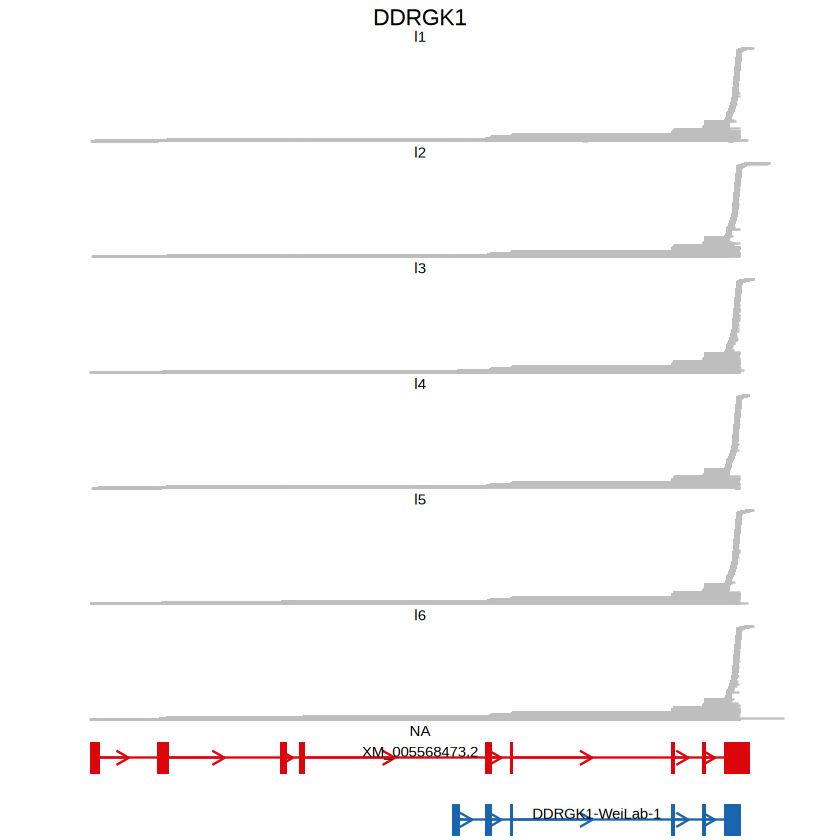

In [259]:
isosig_ngs = data.frame("gene_id" = rep("DDRGK1",3),"transcript_id" = c("DDRGK1-WeiLab-1","XM_005568473.2","unknown"))
mycolor = c('#DC050C','#1965B0','grey')
names(mycolor) = c("XM_005568473.2","DDRGK1-WeiLab-1","unknown")
pcngs = IsoformReadPlotTotal(readgroup_rm,isosig_ngs,longbedngs,gtf,"DDRGK1",NULL,FALSE,mycolor)
pcngs

In [260]:
fileid = paste0("result/figure2/","DDRGK1","_layer_case_readsplice_ngs_24_10_23.pdf")
ggexport(pcngs,filename = fileid,width = 4,height = 6)

Warning message:
"Removed 816 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 112 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 254 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 965 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 128 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 191 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 268 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 357 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values out

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 387 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 289 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 4 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 13 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 53 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 12 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 10 rows containing missing values or values outside the scale range
(

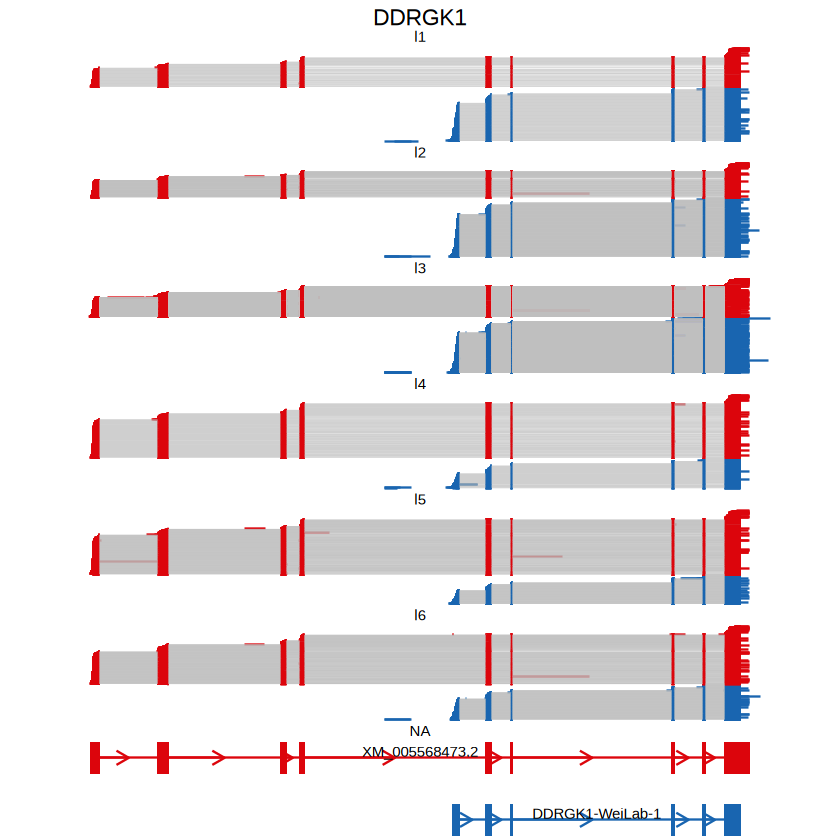

In [265]:
isosigi = isosigls$layer
mycolor = c('#DC050C','#1965B0')
names(mycolor) = c("XM_005568473.2","DDRGK1-WeiLab-1")
fsraw.cor$areatr = fsraw.cor$layer
pcr = IsoformReadPlotTotal(fsraw.cor,isosigi,longbed,gtf,"DDRGK1",c("XM_005568473.2","DDRGK1-WeiLab-1"),FALSE,mycolor)
pcr
fileid = paste0("result/figure2/","DDRGK1","_layer_case_readsplice_fullscope_24_10_23.pdf")
ggexport(pcr,filename = fileid,width = 4,height = 6)

#### DTU Case list plot

In [1]:
fsraw.cor$areatr = fsraw.cor$lobe
grtdfl = BuildPlotBed(fsraw.cor,longbed,"lobe","UBQLN1",NULL)
# pi = IsoformReadPlot(gtf, grtdfl, "UBQLN1",onlyhub = T)
pi

ERROR: Error in eval(expr, envir, enclos): object 'fsraw.cor' not found


In [168]:
pcmk1 = list()
for(i in 1:length(gmks)){
    grtdfl = BuildPlotBed(fsraw,longbed,"layer",gmks[i],NULL)
    pcmk1[[i]] = IsoformReadPlot(gtf, grtdfl, gmks[i],onlyhub = T)
}
pcmk1 = ggarrange(plotlist = pcmk1,ncol = 1)

`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Using the `size` aesthetic in this geom was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` in the `default_aes` field and elsewhere instead."
Warning message:
"Removed 20657 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Wa

In [170]:
ggexport(pcmk1,filename = "result/figure2/layer_dtu_marker_case_24_03_30.pdf",
           width = 8,height = 15)

file saved to result/figure2/layer_dtu_marker_case_24_03_30.pdf



In [222]:
fsraw.cor = fsrawdp[fsrawdp$layer %in% paste0("l",1:6),]

#layer
isosigi = isosigls$layer
isosighub = isosigi[isosigi$sig != "N" & isosigi$sig != "Y",]
gmksi = unique(isosighub$gene_id)
length(gmksi)
pcls.layer = list()
for(i in 1:length(gmksi)){
    print(i)
    grtdfl = BuildPlotBed(fsraw.cor,longbed,"layer",gmksi[i],NULL)
   
    pcls.layer[[i]] = tryCatch(IsoformReadPlot(gtf, grtdfl, gmksi[i],onlyhub = T), 
                                                  error = function(e) NULL)
                               
}
  # ggexport(parcl_casels

pdf("result/figure2/dtu_case_ls_layer_24_04_28.pdf",
           width = 10,height = 8)
for(i in 1:length(pcls.layer)){
     tryCatch(print(pcls.layer[[i]]), error = function(e) NULL)
}
dev.off()

[1] 796

[1] 1


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 2


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 3


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 4


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 5


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 6


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 7


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 8


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 9


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 10


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 11


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 12


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 13


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 14


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 15


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 16


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 17


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 18


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 19


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 20


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 21


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 22


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 23


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 24


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 25


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 26


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 27


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 28


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 29


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 30


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 31


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 32


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 33


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 34


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 35


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 36


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 37


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 38


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 39


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 40


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 41


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 42


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 43


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 44


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 45


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 46


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 47


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 48


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 49


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 50


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 51


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 52


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 53


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 54


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 55


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 56


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 57


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 58


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 59


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 60


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 61


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 62


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 63


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 64


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 65


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 66


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 67


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 68


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 69


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 70


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 71


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 72


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 73


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 74


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 75


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 76


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 77


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 78


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 79


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 80


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 81


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 82


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 83


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 84


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 85


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 86


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 87


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 88


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 89


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 90


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 91


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 92


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 93


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 94


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 95


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 96


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 97


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 98


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 99


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 100


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 101


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 102


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 103


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 104


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 105


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 106


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 107


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 108


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 109


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 110


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 111


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 112


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 113


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 114


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 115


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 116


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 117


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 118


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 119


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 120


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 121


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 122


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 123


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 124


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 125


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 126


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 127


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 128


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 129


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 130


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 131


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 132


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 133


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 134


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 135


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 136


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 137


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 138


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 139


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 140


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 141


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 142


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 143


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 144


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 145


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 146


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 147


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 148


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 149


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 150


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 151


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 152


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 153


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 154


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 155


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 156


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 157


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 158


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 159


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 160


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 161


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 162


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 163


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 164


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 165


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 166


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 167


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 168


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 169


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 170


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 171


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 172


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 173


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 174


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 175


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 176


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 177


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 178


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 179


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 180


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 181


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 182


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 183


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 184


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 185


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 186


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 187


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 188


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 189


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 190


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 191


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 192


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 193


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 194


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 195


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 196


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 197


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 198


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 199


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 200


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 201


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 202


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 203


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 204


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 205


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 206


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 207


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 208


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 209


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 210


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 211


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 212


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 213


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 214


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 215


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 216


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 217


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 218


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 219


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 220


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 221


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 222


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 223


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 224


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 225


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 226


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 227


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 228


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 229


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 230


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 231


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 232


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 233


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 234


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 235


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 236


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 237


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 238


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 239


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 240


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 241


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 242


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 243


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 244


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 245


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 246


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 247


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 248


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 249


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 250


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 251


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 252


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 253


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 254


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 255


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 256


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 257


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 258


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 259


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 260


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 261


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 262


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 263


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 264


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 265


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 266


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 267


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 268


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 269


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 270


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 271


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 272


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 273


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 274


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 275


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 276


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 277


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 278


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 279


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 280


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 281


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 282


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 283


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 284


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 285


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 286


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 287


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 288


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 289


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 290


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 291


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 292


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 293


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 294


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 295


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 296


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 297


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 298


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 299


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 300


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 301


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 302


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 303


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 304


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 305


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 306


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 307


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 308


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 309


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 310


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 311


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 312


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 313


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 314


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 315


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 316


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 317


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 318


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 319


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 320


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 321


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 322


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 323


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 324


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 325


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 326


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 327


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 328


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 329


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 330


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 331


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 332


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 333


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 334


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 335


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 336


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 337


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 338


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 339


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 340


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 341


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 342


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 343


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 344


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 345


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 346


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 347


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 348


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 349


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 350


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 351


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 352


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 353


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 354


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 355


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 356


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 357


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 358


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 359


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 360


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 361


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 362


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 363


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 364


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 365


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 366


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 367


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 368


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 369


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 370


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 371


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 372


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 373


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 374


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 375


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 376


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 377


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 378


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 379


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 380


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 381


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 382


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 383


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 384


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 385


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 386


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 387


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 388


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 389


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 390


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 391


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 392


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 393


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 394


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 395


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 396


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 397


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 398


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 399


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 400


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 401


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 402


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 403


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 404


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 405


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 406


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 407


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 408


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 409


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 410


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 411


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 412


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 413


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 414


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 415


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 416


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 417


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 418


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 419


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 420


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 421


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 422


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 423


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 424


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 425


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 426


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 427


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 428


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 429


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 430


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 431


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 432


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 433


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 434


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 435


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 436


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 437


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 438


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 439


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 440


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 441


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 442


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 443


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 444


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 445


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 446


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 447


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 448


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 449


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 450


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 451


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 452


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 453


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 454


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 455


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 456


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 457


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 458


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 459


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 460


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 461


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 462


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 463


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 464


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 465


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 466


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 467


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 468


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 469


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 470


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 471


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 472


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 473


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 474


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 475


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 476


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 477


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 478


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 479


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 480


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 481


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 482


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 483


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 484


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 485


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 486


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 487


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 488


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 489


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 490


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 491


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 492


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 493


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 494


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 495


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 496


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 497


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 498


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 499


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 500


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 501


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 502


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 503


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 504


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 505


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 506


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 507


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 508


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 509


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 510


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 511


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 512


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 513


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 514


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 515


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 516


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 517


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 518


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 519


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 520


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 521


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 522


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 523


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 524


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 525


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 526


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 527


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 528


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 529


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 530


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 531


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 532


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 533


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 534


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 535


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 536


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 537


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 538


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 539


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 540


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 541


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 542


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 543


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 544


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 545


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 546


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 547


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 548


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 549


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 550


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 551


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 552


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 553


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 554


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 555


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 556


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 557


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 558


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 559


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 560


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 561


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 562


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 563


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 564


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 565


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 566


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 567


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 568


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 569


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 570


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 571


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 572


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 573


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 574


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 575


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 576


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 577


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 578


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 579


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 580


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 581


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 582


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 583


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 584


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 585


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 586


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 587


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 588


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 589


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 590


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 591


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 592


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 593


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 594


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 595


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 596


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 597


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 598


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 599


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 600


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 601


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 602


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 603


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 604


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 605


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 606


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 607


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 608


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 609


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 610


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 611


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 612


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 613


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 614


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 615


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 616


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 617


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 618


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 619


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 620


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 621


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 622


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 623


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 624


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 625


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 626


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 627


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 628


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 629


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 630


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 631


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 632


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 633


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 634


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 635


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 636


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 637


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 638


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 639


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 640


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 641


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 642


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 643


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 644


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 645


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 646


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 647


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 648


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 649


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 650


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 651


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 652


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 653


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 654


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 655


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 656


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 657


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 658


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 659


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 660


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 661


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 662


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 663


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 664


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 665


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 666


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 667


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 668


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 669


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 670


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 671


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 672


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 673


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 674


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 675


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 676


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 677


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 678


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 679


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 680


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 681


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 682


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 683


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 684


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 685


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 686


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 687


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 688


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 689


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 690


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 691


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 692


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 693


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 694


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 695


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 696


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 697


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 698


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 699


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 700


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 701


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 702


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 703


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 704


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 705


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 706


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 707


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 708


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 709


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 710


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 711


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 712


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 713


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 714


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 715


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 716


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 717


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 718


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 719


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 720


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 721


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 722


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 723


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 724


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 725


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 726


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 727


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 728


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 729


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 730


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 731


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 732


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 733


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 734


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 735


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 736


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 737


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 738


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 739


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 740


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 741


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 742


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 743


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 744


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 745


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 746


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 747


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 748


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 749


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 750


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 751


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 752


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 753


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 754


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 755


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 756


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 757


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 758


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 759


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 760


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 761


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 762


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 763


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 764


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 765


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 766


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 767


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 768


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 769


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 770


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 771


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 772


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 773


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 774


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 775


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 776


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 777


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 778


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 779


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 780


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 781


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 782


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 783


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 784


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 785


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 786


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 787


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 788


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 789


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 790


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 791


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 792


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 793


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 794


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 795


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.


[1] 796


`summarise()` has grouped output by 'transcript_id'. You can override using the
`.groups` argument.
Warning message:
"Removed 128 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 85 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 6 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 4 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 3 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 18 rows containing missing values or values outside the scale range
(`geo

png 
  2

In [137]:
#lobe
isosigi = isosigls$lobe
isosighub = isosigi[isosigi$sig != "N" & isosigi$sig != "Y",]
gmksi = unique(isosighub$gene_id)
length(gmksi)
pcls.lobe = list()
for(i in 1:length(gmksi)){
    print(i)
    grtdfl = BuildPlotBed(fsraw.cor,longbed,"lobe",gmksi[i],NULL)
     strand = unique(gtf[gtf$gene_id == gmksi[i],]$strand)
    if(strand == "*"){
        pcls.lobe[[i]] = NULL
    }else{
        pcls.lobe[[i]] = tryCatch(IsoformReadPlot(gtf, grtdfl, gmksi[i],onlyhub = T), 
                                                  error = function(e) NULL)
    }

}


ERROR: Error in parse(text = x, srcfile = src): <text>:11:18: unexpected ')'
10:      strand = unique(gtf[gtf$gene_id == gmksi[i],]$strand)
11:     if(strand == )
                     ^


In [141]:
#ggexport(pcls.lobe,filename = "result/figure2/dtu_case_ls_lobe_24_04_28.pdf",
#           width = 10,height = 8)
pdf("result/figure2/dtu_case_ls_lobe_24_04_28.pdf",
           width = 10,height = 8)
for(i in 1:length(pcls.lobe)){
     tryCatch(print(pcls.lobe[[i]]), error = function(e) NULL)
}
dev.off()

Warning message:
"Removed 32 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 24 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 2 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 43 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 24 rows containing missing values or values outside the scale range
(`geom_segment()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale r

png 
  2

In [62]:
#Specific case plot
pref = qread("../ref/area_figure_an.qs")

fsrawdp.cell = fsrawdp[fsrawdp$class != "",] %>% 
    group_by(cell_id,gene_id,transcript_id,class,subclass) %>%
    summarise(x = mean(x),y = mean(y),
              readnum = length(unique(readid)))
fsrawdp.cellb = qread("data/reads_full_anotation/longread_cell_position_24_03_29.qs")


`summarise()` has grouped output by 'cell_id', 'gene_id', 'transcript_id',
'class'. You can override using the `.groups` argument.


In [194]:
install.packages("ggpointdensity")
library(ggpointdensity)

Installing package into '/cluster/home/liuhengxin/software/miniconda3_2/envs/r-kernel/lib/R/library'
(as 'lib' is unspecified)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



#### DTU vocalno plot

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
Warning message:
"Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead."
file saved to result/figure2/sigiso_basic_calculate_isoform_rate_point_layer_08_25.pdf



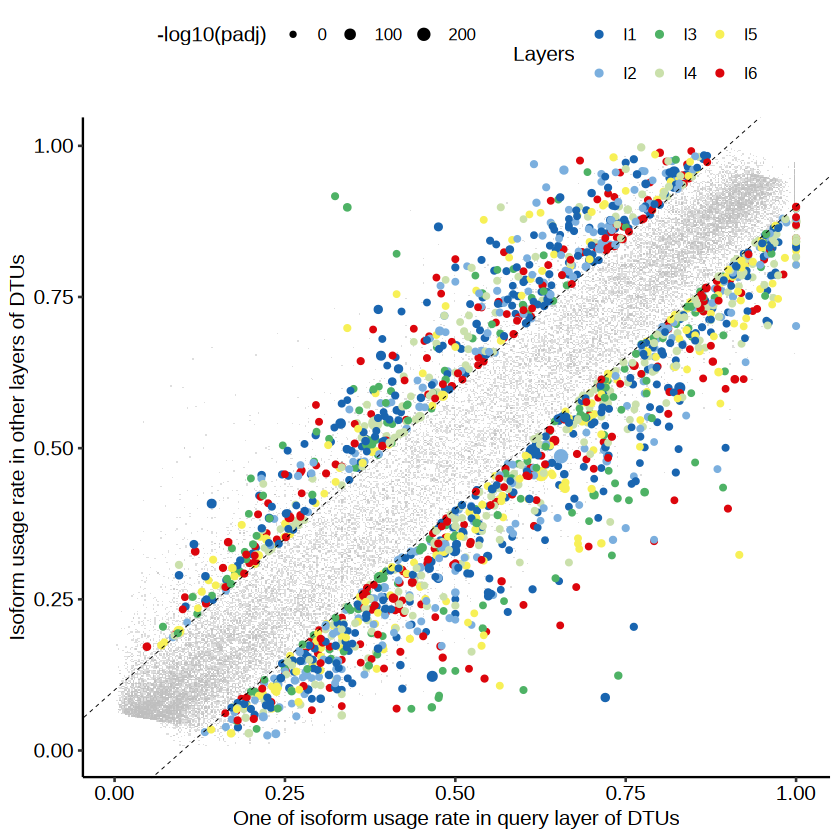

In [244]:
sigstl = isosigls$layer
sigstlb = sigstl[sigstl$sig == "N",]
sigstlb = sigstlb %>% group_by(gene_id,areatr) %>% 
    summarise(relative = relative[which.max(abs(dr))],
              transcript_id = transcript_id[which.max(abs(dr))],
              otherrelative = otherrelative[which.max(abs(dr))],
              padj = padj[which.max(abs(dr))],
              dr = dr[which.max(abs(dr))])

sigstls = sigstl[!(sigstl$sig == "N"|sigstl$sig == "Y"),]
sigstls = sigstls %>% group_by(gene_id,areatr) %>% 
    summarise(relative = relative[which.max(abs(dr))],
              transcript_id = transcript_id[which.max(abs(dr))],
              otherrelative = otherrelative[which.max(abs(dr))],
              padj = padj[which.max(abs(dr))],
              dr = dr[which.max(abs(dr))])
  
sigstlsf = sigstls[abs(sigstls$dr) > 0.2,]
pis3 = ggplot() + 
    scattermore::geom_scattermore(
        data = sigstlb,aes(x = relative, y = otherrelative,
                                  size = -log10(padj)),
         color = "grey",alpha = 0.5
      ) +
    geom_point(data = sigstls,aes(x = relative, y = otherrelative,color = areatr,
                                  size = -log10(padj))) +
    geom_abline(intercept = 0.1,linetype = 2,size = 0.2)+
    geom_abline(intercept = -0.1,linetype = 2,size = 0.2)+
    # ggrepel::geom_text_repel(
    #   data = sigstlsf,
    #   aes(label = paste0(gene_id,"-",transcript_id), x = relative, 
    #       y = otherrelative),
    #   size = 2,
    #   # direction = "x",
    #   segment.linetype = 6,
    #   segment.curvature = -1e-20,
    #   segment.size = 0.3,
    #   nudge_y = ifelse(sigstlsf$dr > 0,0.1,-0.1),
    #   max.overlaps = 20,
    #   segment.color = "black", show.legend = FALSE ) +
    scale_size(range = c(1,3)) + 
    labs(color = "Layers") +
    # scale_color_manual(values = c("red","blue")) +
    scale_color_discreterainbow() +
    xlab("One of isoform usage rate in query layer of DTUs") +
    ylab("Isoform usage rate in other layers of DTUs") +
    theme_pubr()
pis3
ggexport(pis3,filename = "result/figure2/sigiso_basic_calculate_isoform_rate_point_layer_08_25.pdf",
          width = 5,height = 5)

`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
`summarise()` has grouped output by 'gene_id'. You can override using the
`.groups` argument.
file saved to result/figure2/sigiso_basic_calculate_isoform_rate_point_lobe_08_25.pdf



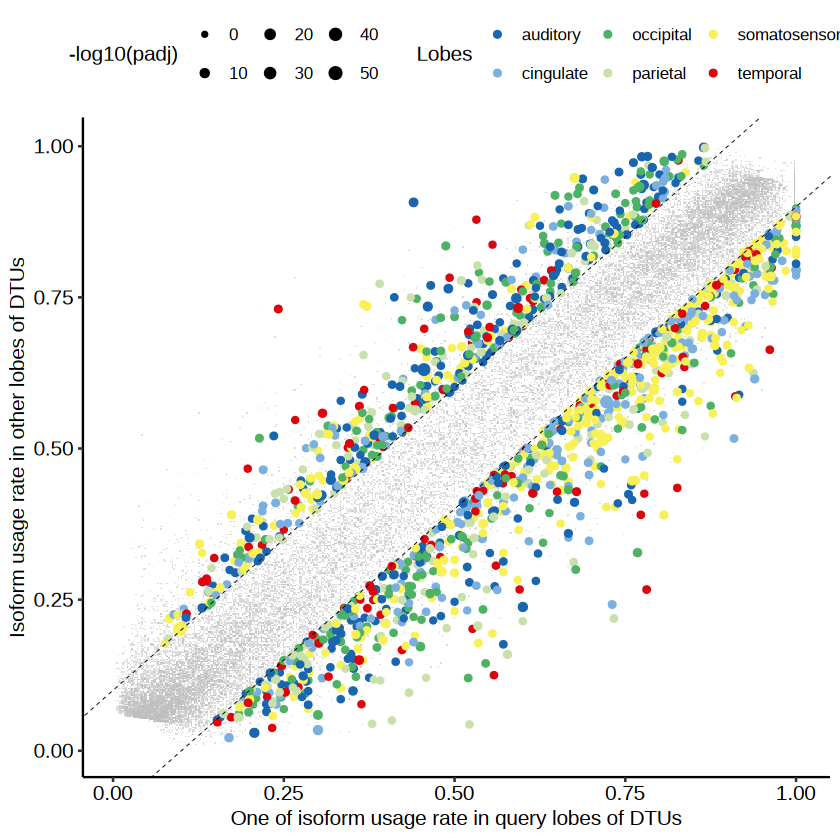

In [245]:
sigstl = isosigls$lobe
sigstlb = sigstl[sigstl$sig == "N",]
sigstlb = sigstlb %>% group_by(gene_id,areatr) %>% 
    summarise(relative = relative[which.max(abs(dr))],
              transcript_id = transcript_id[which.max(abs(dr))],
              otherrelative = otherrelative[which.max(abs(dr))],
              padj = padj[which.max(abs(dr))],
              dr = dr[which.max(abs(dr))])

sigstls = sigstl[!(sigstl$sig == "N"|sigstl$sig == "Y"),]
sigstls = sigstls %>% group_by(gene_id,areatr) %>% 
    summarise(relative = relative[which.max(abs(dr))],
              transcript_id = transcript_id[which.max(abs(dr))],
              otherrelative = otherrelative[which.max(abs(dr))],
              padj = padj[which.max(abs(dr))],
              dr = dr[which.max(abs(dr))])
  
sigstlsf = sigstls[abs(sigstls$dr) > 0.2,]
pis3 = ggplot() + 
    scattermore::geom_scattermore(
        data = sigstlb,aes(x = relative, y = otherrelative,
                                  size = -log10(padj)),
         color = "grey",alpha = 0.5
      ) +
    geom_point(data = sigstls,aes(x = relative, y = otherrelative,color = areatr,
                                  size = -log10(padj))) +
    geom_abline(intercept = 0.1,linetype = 2,size = 0.2)+
    geom_abline(intercept = -0.1,linetype = 2,size = 0.2)+
    # ggrepel::geom_text_repel(
    #   data = sigstlsf,
    #   aes(label = paste0(gene_id,"-",transcript_id), x = relative, 
    #       y = otherrelative),
    #   size = 2,
    #   # direction = "x",
    #   segment.linetype = 6,
    #   segment.curvature = -1e-20,
    #   segment.size = 0.3,
    #   nudge_y = ifelse(sigstlsf$dr > 0,0.1,-0.1),
    #   max.overlaps = 20,
    #   segment.color = "black", show.legend = FALSE ) +
    scale_size(range = c(1,3)) + 
    labs(color = "Lobes") +
    # scale_color_manual(values = c("red","blue")) +
    scale_color_discreterainbow() +
    xlab("One of isoform usage rate in query lobes of DTUs") +
    ylab("Isoform usage rate in other lobes of DTUs") +
    theme_pubr()
pis3
ggexport(pis3,filename = "result/figure2/sigiso_basic_calculate_isoform_rate_point_lobe_08_25.pdf",
          width = 5,height = 5)

#### Compare Layer and Lobe delta isoform usage

file saved to result/figure2/sigiso_delta_isr_lobe_layer_cmp_08_25.pdf



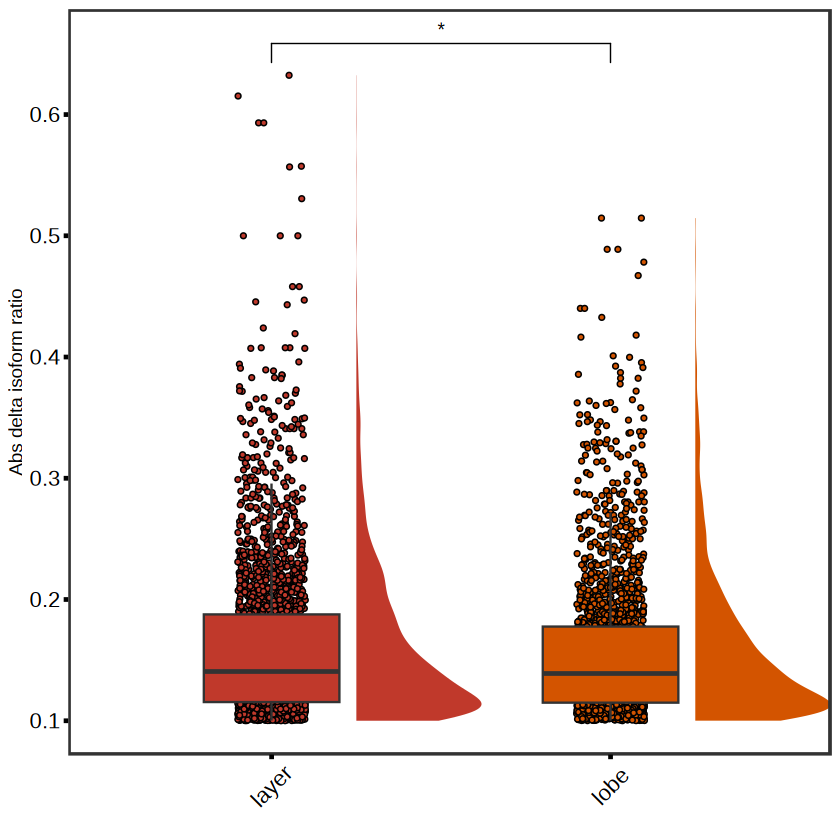

In [246]:
sigstlb = isosigls$lobe
sigstly = isosigls$layer
sigstlb = sigstlb[sigstlb$sig != "N",]
sigstly = sigstly[sigstly$sig != "N",]
sigstlb$group = "lobe"
sigstly$group = "layer"
sigstl = rbind(sigstlb,sigstly)
piscp = ggplot(sigstl,aes(x = group,y = abs(dr),fill = group)) + 
  geom_jitter(aes(fill=group),shape=21,size=1,width=0.1) +
  geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
  geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
  stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,comparison = list(c("layer","lobe")))  +
  theme_bw()+
  theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 45,vjust = 0.5),
        axis.text.y = element_text(color = "black",size = 13),
        legend.position = "none",
        axis.ticks = element_line(color="black",linewidth = 1)) +
  scale_fill_flatui() + ylab("Abs delta isoform ratio") + xlab("")
piscp
ggexport(piscp,filename = "result/figure2/sigiso_delta_isr_lobe_layer_cmp_08_25.pdf",
          width = 4,height = 5)

## Other analysis

### PCA Analysis

In [221]:
regioncst = fsraw.cor[fsraw.cor$class != "",] %>% group_by(region,class,subclass) %>% summarise(cellnum = length(unique(cell_id)))
regioncst = regioncst %>% group_by(region) %>% mutate(cellprop = cellnum/sum(cellnum))
head(regioncst)

`summarise()` has grouped output by 'region', 'class'. You can override using
the `.groups` argument.


region,class,subclass,cellnum,cellprop
<chr>,<chr>,<chr>,<int>,<dbl>
1|2,GABA,LAMP5,347,0.010940160
1|2,GABA,PVALB,1521,0.047953843
1|2,GABA,PV_CHC,96,0.003026673
1|2,GABA,RELN,496,0.015637808
1|2,GABA,SST,1578,0.049750930
1|2,GABA,VIP,272,0.008575572


In [254]:
#celltype
asl2 = dcast(regioncst,region~subclass)
asl2[is.na(asl2)] = 0
asl2 = merge(asl2, areaan, by.x = "region",by.y = "area")
rownames(asl2) = asl2$region;asl2 = asl2[-1]
colnames(asl2)[ncol(asl2)] = "group"


#isoform
exonsigmx = isosigls$region
#sigtrans = exonsigmx[exonsigmx$sig != "N",]$transcript_id
#exonsigmx = exonsigmx[exonsigmx$transcript_id %in% sigtrans,]
exonsigmx = dcast(exonsigmx, areatr~transcript_id,
                      value.var = "relative",fun.aggregate = sum)
exonsigmx[is.na(exonsigmx)] = 0
exonsigmx = merge(exonsigmx,areaan,by.x = "areatr",by.y = "area")
rownames(exonsigmx) = exonsigmx$areatr;exonsigmx = exonsigmx[-1]
colnames(exonsigmx)[ncol(exonsigmx)] = "group"
exonsigmxf = exonsigmx[-ncol(exonsigmx)]
exonsigmxf = exonsigmxf[,colSums(exonsigmxf > 0) > 29]
#exonsigmxf = exonsigmxf[,colSums(exonsigmxf == 1) != colSums(exonsigmxf > 0)]
exonsigmxf$group = exonsigmx$group
dim(exonsigmxf)
#gene
    # genexp = qread("ref/area_cell_gene_st_23_05_17.qs")
genexp = isosigls$region
genexp = genexp %>% group_by(areatr,gene_id) %>% 
      summarise(genecount = unique(genecount))
    # genexp = genexp[genexp$genecount > 100,]
    # genexp = genexp %>% group_by(areaid) %>% 
    # mutate(genenorm = rescale(genecount))
genexpmx = dcast(genexp, areatr~gene_id,
                     value.var = "genecount",fun.aggregate = sum)
genexpmx[is.na(genexpmx)] = 0
rownames(genexpmx) = genexpmx$areatr;genexpmx = genexpmx[-1]
    # genexpmxf = genexpmx[,colSums(genexpmx > 0) > 29]
library(Seurat)
genesrt = CreateSeuratObject(t(genexpmx))
#genesrt = ScaleData(genesrt)
genesrt = NormalizeData(genesrt)
genesrt = FindVariableFeatures(genesrt)
genexpmxf = as.data.frame(t(as.matrix(GetAssayData(genesrt, assay = "RNA"))))
genexpmxf = genexpmxf[,colSums(genexpmxf > 0) > 29]
genexpmxf = merge(genexpmxf,areaan,by.x = "row.names",by = "area")
rownames(genexpmxf) = genexpmxf$Row.names;genexpmxf = genexpmxf[-1]
colnames(genexpmxf)[ncol(genexpmxf)] = "group"
#genexpmxf = genexpmxf[,c(VariableFeatures(genesrt),"group")]
dim(genexpmxf)
    
armxls = list("cell" = asl2,"gene" = genexpmxf,"isoform" = exonsigmxf)
qsave(armxls,file = "result/figure2/areaid_matrix_for_pca_list_09_09.qs")

Using cellprop as value column: use value.var to override.



[1]   30 3292

`summarise()` has grouped output by 'areatr'. You can override using the
`.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class matrix. Coercing to dgCMatrix."
Normalizing layer: counts

Finding variable features for layer counts



[1]   30 1486

`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.
Warning message:
"Returning more (or less) than 1 row per `summarise()` group was deprecated in
dplyr 1.1.0.
ℹ Please use `reframe()` instead.
ℹ When switching from `summarise()` to `reframe()`, remember that `reframe()`
  always returns an ungrouped data frame and adjust accordingly."
`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.


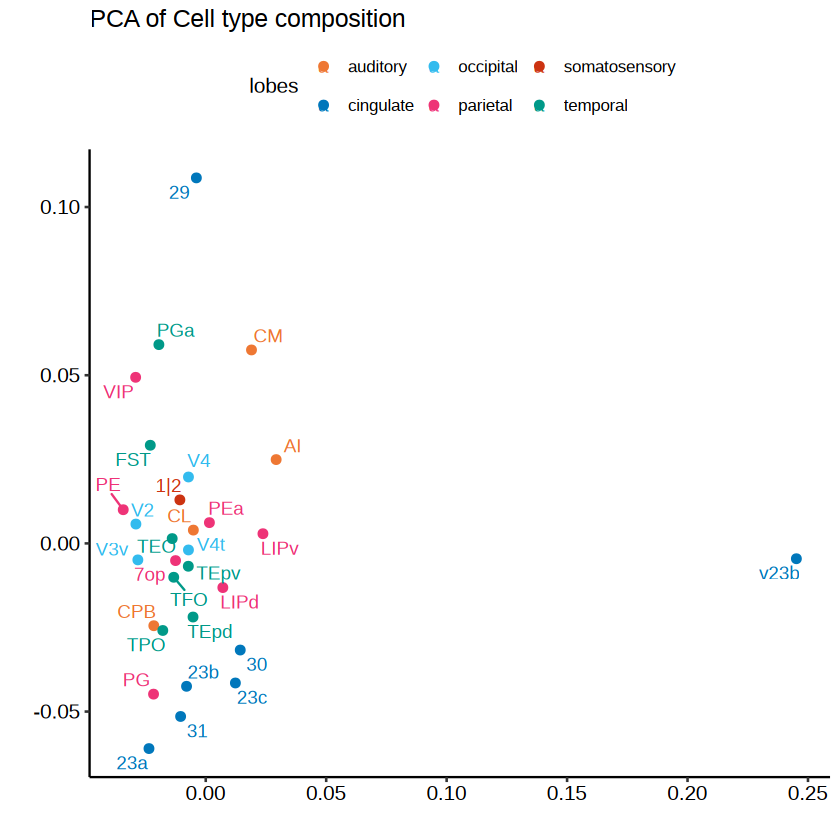

`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.
Warning message:
"Returning more (or less) than 1 row per `summarise()` group was deprecated in
dplyr 1.1.0.
ℹ Please use `reframe()` instead.
ℹ When switching from `summarise()` to `reframe()`, remember that `reframe()`
  always returns an ungrouped data frame and adjust accordingly."
`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.


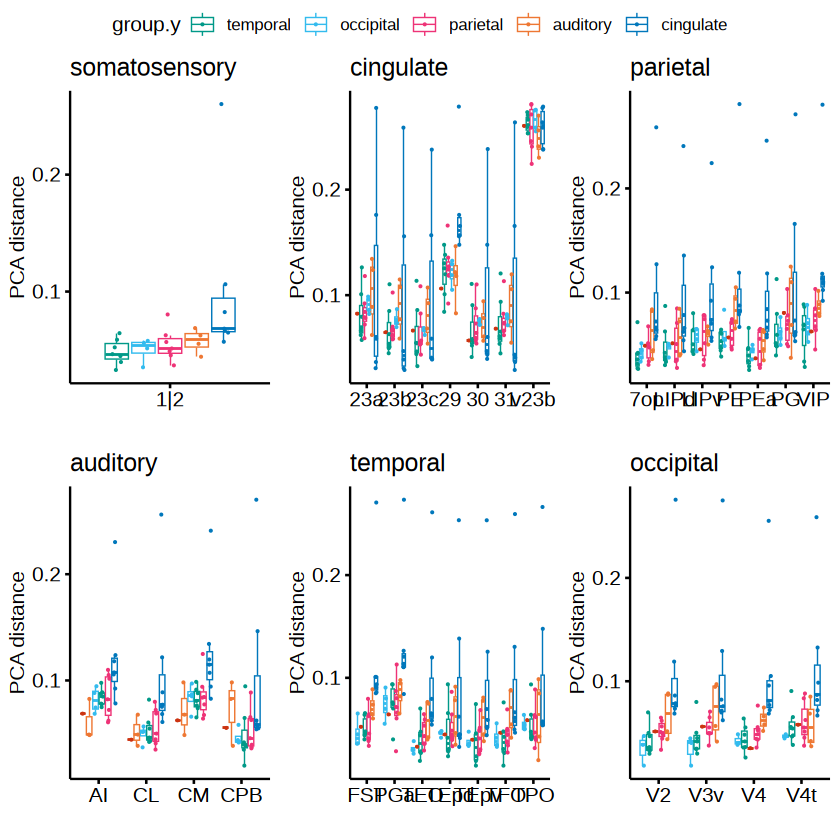

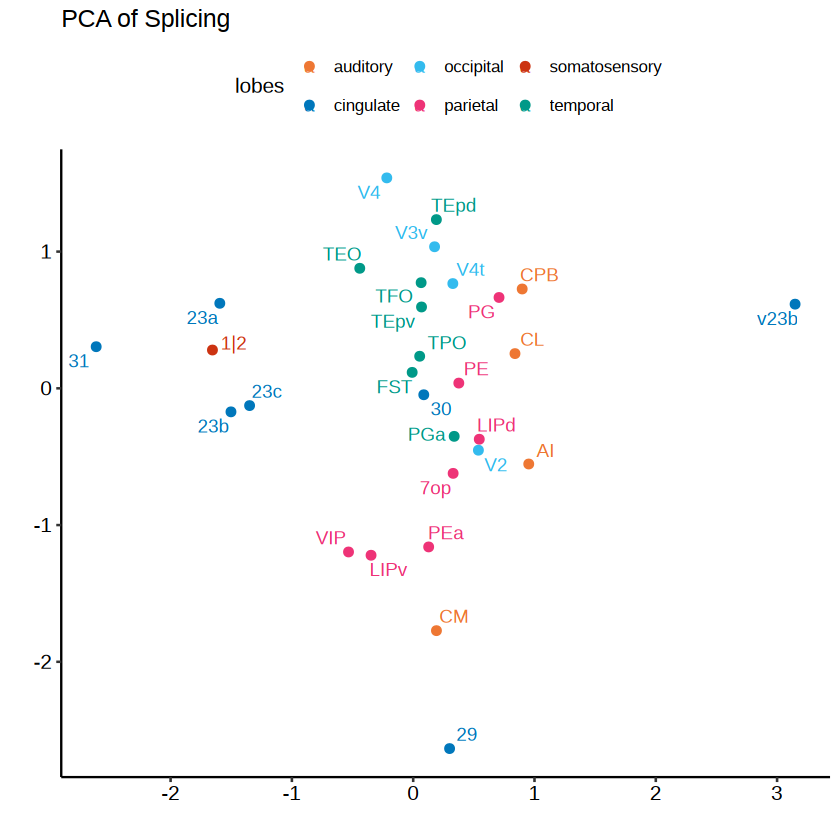

`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.
Warning message:
"Returning more (or less) than 1 row per `summarise()` group was deprecated in
dplyr 1.1.0.
ℹ Please use `reframe()` instead.
ℹ When switching from `summarise()` to `reframe()`, remember that `reframe()`
  always returns an ungrouped data frame and adjust accordingly."
`summarise()` has grouped output by 'true'. You can override using the
`.groups` argument.


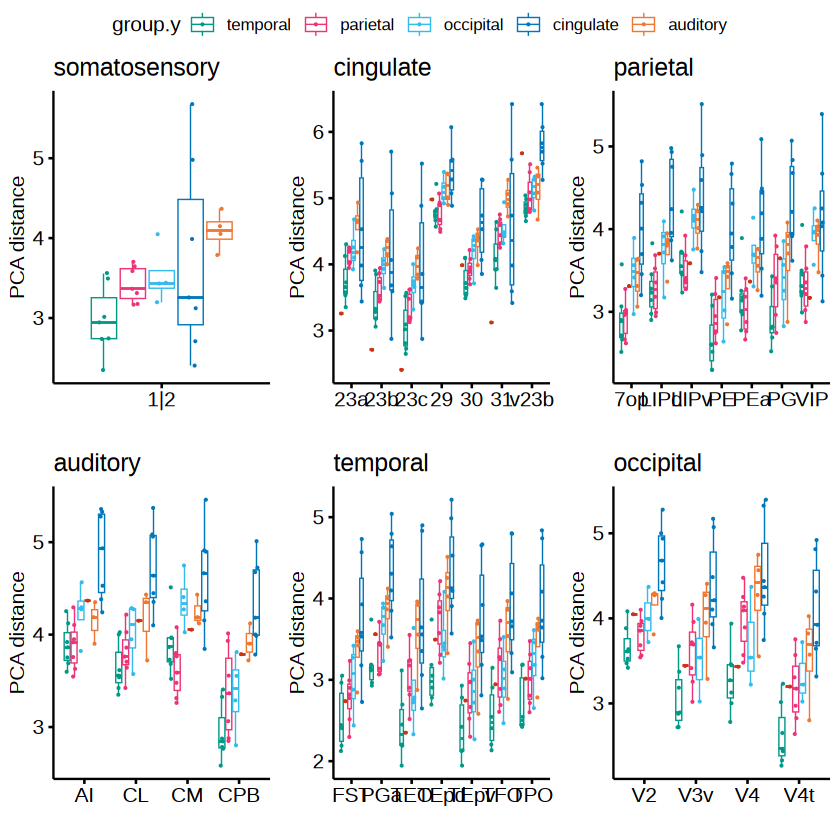

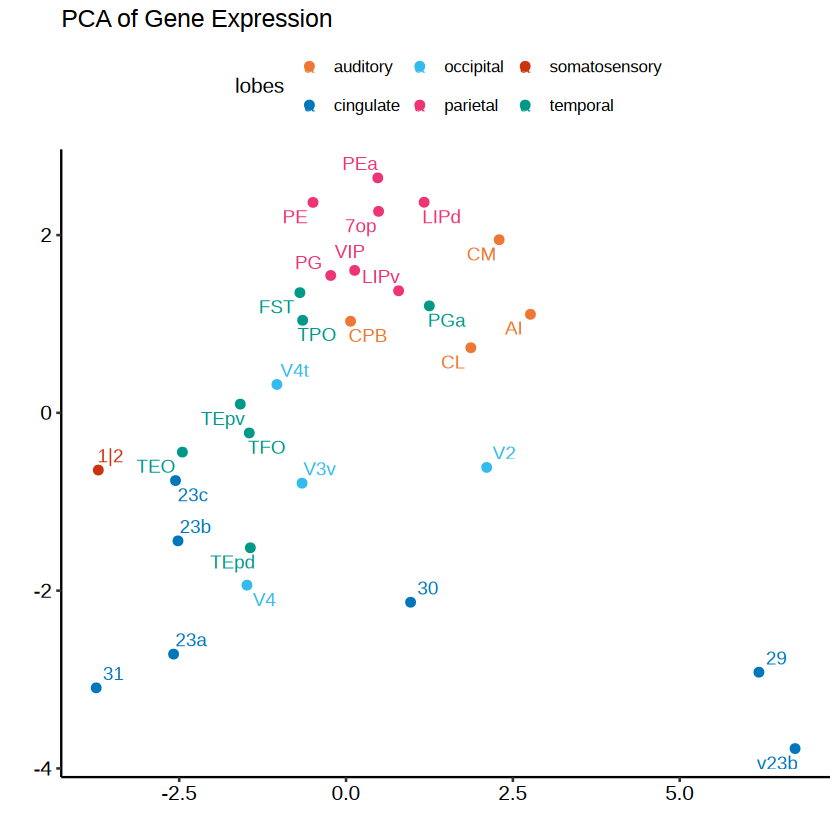

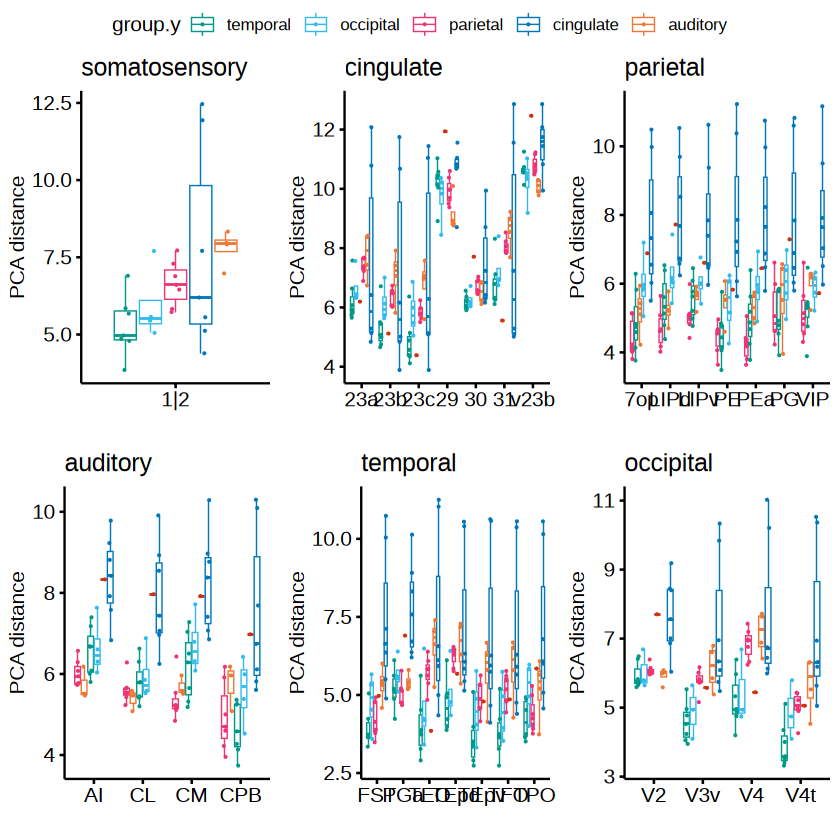

In [255]:
library(factoextra)
library(cluster)
library(mclust)
library(reshape2)
mycolor = c("auditory" = "#EE7733",
              "cingulate" = "#0077BB",
              "occipital" = "#33BBEE",
              "parietal" = "#EE3377",
              "somatosensory" = "#CC3311",
              "temporal" = "#009988")
  
  #build cell gene exon matrix
  MyPCAVerify = function(asl,mytitle){
    res.pca = prcomp(asl[-ncol(asl)])
    
    # res.pam = pam(asl[-ncol(asl)], 5,  metric = "euclidean", stand = FALSE)
    # fviz_cluster(res.pam, data = asl[-ncol(asl)],star.plot = TRUE,
    #              ellipse.type = "euclid",
    #              repel = TRUE)
    # fviz_silhouette(res.pam, palette = "jco", ggtheme = theme_classic())
    
    cl_pred = kmeans(asl[-ncol(asl)], centers=length(unique(asl$group)))$cluster
    cl_true = as.factor(asl$group)
    ShannonIndex = function(x){
      # return(-sum(x*log(x)))
      return(1/sum(x^2))
    }
    clscore = data.frame("pred" = cl_pred, "true" = cl_true)
    clscore1 = clscore %>% group_by(true,pred) %>% summarise(count = n()) 
    clscore1 = clscore1 %>% group_by(true) %>% summarise(prop = count/sum(count))
    clscore1 = clscore1 %>% group_by(true) %>% summarise(disp = ShannonIndex(prop))
    ari1 = adjustedRandIndex(cl_pred, cl_true)
    
    cormx = cor(t(asl[-ncol(asl)]))
    cormxl = melt(cormx)
    classid = unique(asl$group)
    classmx = data.frame("tr" = rownames(asl),"group" = asl$group)
    corst = NULL
    cormxl = cormxl[cormxl$Var1 != cormxl$Var2,]
    for (classg in classid) {
      classi = classmx[classmx$group == classg, ]$tr
      cori = cormxl[cormxl$Var1 %in% classi & cormxl$Var2 %in% classi, ]
      coro = cormxl[(cormxl$Var1 %in% classi & !(cormxl$Var2 %in% classi)) | 
                      (cormxl$Var2 %in% classi & !(cormxl$Var1 %in% classi)), ]
      # cori$group = "in"
      # coro$group = "out"
      # cort = rbind(cori,coro)
      # ggplot(cort,aes(x = group,y = value)) + geom_boxplot()
      # mean(cori$value)/mean(cort$value)
      corst = rbind(corst, 
                    data.frame("group" = classg, 
                               "corv" = mean(cori$value) - mean(coro$value)))
      
    }
    
    # kmerdata = as.data.frame(res.pca$x)
    # kmerdata$group = as.character(as.vector(cl_pred))
    # kmerdata$lobes = asl$group
    # ppca1 = ggplot(kmerdata,aes(x = PC1,y = PC2,color = lobes)) + geom_point() +
    #   stat_ellipse(aes(x = PC1,y = PC2,color = group,group=group)) + theme_pubr() +
    #   scale_color_discreterainbow()
    
    kmergroup = as.character(cl_pred)
    
    ppca1 = fviz_pca_ind(res.pca,
                         # col.ind = kmergroup,
                         fill.ind = asl$group,
                         pointshape = 21, pointsize = 2,
                         # habillage = cl_pred,
                         addEllipses = TRUE,ellipse.type = "convex",
                         repel = TRUE) + theme_pubr() +
      ggtitle(mytitle) +
      scale_color_viridis(discrete = T) +
      scale_fill_discreterainbow()
    
    ppca1 = fviz_pca_ind(res.pca,
                         # col.ind = kmergroup,
                         fill.ind = asl$group,
                         pointshape = 21, pointsize = 2,
                         # habillage = cl_pred,
                         addEllipses = TRUE,ellipse.type = "convex",
                         repel = TRUE) + theme_pubr() +
      ggtitle(mytitle) +
      scale_color_viridis(discrete = T) +
      scale_fill_discreterainbow()
    
    return(list("pcaf" = ppca1, "clscore" = clscore1,"corst" = corst,
                "ari" = ari1))
  }
  MyPCAVerify2 = function(asl,mytitle,mycolor = mycolor){
    cl_true = asl$group
    res.pca = prcomp(asl[-ncol(asl)])
    res.ds = dist(as.data.frame(res.pca$x))
    classid = unique(asl$group)
    classmx = data.frame("tr" = rownames(asl),"group" = asl$group)
    pcadis = melt(as.matrix(res.ds))
    pcadis = pcadis[pcadis$Var1 != pcadis$Var2,]
    pcadis = merge(pcadis,classmx,by.x = "Var1",by.y = "tr")
    pcadis = merge(pcadis,classmx,by.x = "Var2",by.y = "tr")
    corst = NULL
    
    pdisls = list()
    i = 1
    for (classg in classid) {
      cori = classmx[classmx$group %in% classg, ]
      corst = pcadis[(pcadis$Var1 %in% cori$tr),]
      corst = corst %>% group_by(group.x,group.y) %>% 
        mutate(meandis = mean(value))
      corst = corst[order(corst$meandis),]
      corst$group.y = factor(corst$group.y,levels = unique(corst$group.y))
      
      pdisls[[i]] = ggboxplot(
        corst, x = "Var1", y = "value", size = 0.3,
        add = c("jitter"),add.params = list(size = 0.1),
        color = "group.y"
      ) + 
        xlab("") + ylab("PCA distance") +
        ggtitle(classg) +
        scale_color_manual(values = mycolor) + theme(legend.position = "none")
      i = i +1 
    }
    
    pca.facet = ggarrange(plotlist = pdisls, 
                          nrow = 2,ncol = 3,common.legend = T)
    pca.facet
    
    # ppca1 = ggplot(umapdf,aes(x = x,y = y, color = group)) +
    #   geom_point() +
    #   ggtitle(mytitle) +
    #   theme_pubr() +
    #   scale_color_manual(values = mycolor)
    cl_pred = kmeans(res.pca$x, centers=length(unique(asl$group)))$cluster
    kmergroup = as.character(cl_pred)
    library(cluster)
    pcabasic = fviz_pca_ind(res.pca,label = "none") + 
      ggtitle(mytitle)
    
    pcabasic = pcabasic$data
    pcabasic$lobes = asl$group
    pcabasic$clusters = kmergroup
    pcabasic$name = as.character(pcabasic$name)
    ppca1 = ggplot(pcabasic,aes(x = x,y = y, color = lobes)) + 
      geom_point(size = 2) + 
      ggrepel::geom_text_repel(aes(label = name)) +
      theme_pubr() +
      ggtitle(mytitle) + xlab("") + ylab("") +
      scale_color_manual(values = mycolor)
    
    ShannonIndex = function(x){
      # return(-sum(x*log(x)))
      return(1/sum(x^2))
    }
    clscore = data.frame("pred" = cl_pred, "true" = cl_true)
    clscore1 = clscore %>% group_by(true,pred) %>% summarise(count = n()) 
    clscore1 = clscore1 %>% group_by(true) %>% summarise(prop = count/sum(count))
    clscore1 = clscore1 %>% group_by(true) %>% summarise(disp = ShannonIndex(prop))
    pcadist = pcadis %>% group_by(Var1) %>%
      summarise(disore = mean(value[group.x == group.y])/mean(value[group.x != group.y]),
                lobes = unique(group.x))
    
    return(list("pcaf" = ppca1, "pcafacet" = pca.facet,
                "pcadis" = pcadis,"shscore" = clscore1,
                "pcadist" = pcadist))
  }
  library(umap)
  library(ggpubr)
  asl = armxls$cell
  areaPcac = MyPCAVerify2(armxls$cell,"PCA of Cell type composition",mycolor = mycolor)
  areaPcac$pcaf
  areaPcac$pcafacet
  
  #PCA analysis for exon jaccard or gene express
  areaPcae = MyPCAVerify2(armxls$isoform,"PCA of Splicing",mycolor)
  areaPcae$pcaf
  areaPcae$pcafacet
  
  #for gene express
  areaPcag = MyPCAVerify2(armxls$gene,"PCA of Gene Expression",mycolor)
  areaPcag$pcaf
  areaPcag$pcafacet
  
  library(ggpubr)

  # fviz_cluster(genexpmx_cl, data = res.pca3$x[,1:2],shape = 16) +
  #   geom_point(aes(shape = genexpmx$L0), alpha = 0.5) + theme_nature()
  areapcals = list("cell" = areaPcac,
                   "gene" = areaPcag,
                   "exon" = areaPcae)
qsave(areapcals,file = "result/figure2/areaid_PCA_total_ls_09_09.qs")

In [222]:
#isoform
fsraw.cor$areatri = paste0(fsraw.cor$region,"-",fsraw.cor$layer)
isodf = fsraw.cor %>% group_by(areatri,gene_id) %>% mutate(genecount = length(readid)) %>%
group_by(areatri,gene_id,transcript_id) %>% summarise(count = length(readid),rate = count/genecount[1])
isomx = dcast(isodf, areatri~transcript_id,
                      value.var = "rate",fun.aggregate = sum)
isomx[is.na(isomx)] = 0
rownames(isomx) = isomx$areatri;isomx = isomx[-1]
head(isodf)
isomx = isomx[,colSums(isomx > 0) > 29]

`summarise()` has grouped output by 'areatri', 'gene_id'. You can override
using the `.groups` argument.


areatri,gene_id,transcript_id,count,rate
<chr>,<chr>,<chr>,<int>,<dbl>
1|2-l1,A4GALT,XM_015457101.1,2,1.00
1|2-l1,AAAS,AAAS-WeiLab-1,1,0.25
1|2-l1,AAAS,XM_005571000.2,3,0.75
1|2-l1,AACS,NM_001284010.1,10,1.00
1|2-l1,AADAT,AADAT-WeiLab-1,1,0.50
1|2-l1,AADAT,XM_005556303.2,1,0.50


In [271]:
transhub = NULL
isosigi = isosigls$layer
#[isosigi$sig != "N",]
transhub = c(transhub,unique(isosigi$transcript_id))
isosigi = isosigls$lobe
transhub = unique(c(transhub,unique(isosigi$transcript_id)))
#isomxf = isomx[,colSums(isomx > 0) > 174*0.9]
isomxf = isomx[,transhub]
dim(isomxf)

library(cluster)
library(factoextra)
res.pca = prcomp(isomxf)
pcabasic = fviz_pca_ind(res.pca,label = "none")
pcabasic = pcabasic$data
head(pcabasic)
pcabasic$name = as.character(pcabasic$name)
pcabasic$region = MySplit(pcabasic$name,"-",1)
pcabasic$layer = MySplit(pcabasic$name,"-",2)
ppca1 = ggplot(pcabasic,aes(x = x,y = y, color = region)) + 
      geom_point(size = 2) + 
      #ggrepel::geom_text_repel(aes(label = name)) +
      theme_pubr() + xlab("") + ylab("") + theme()
ppca1
ppca2 = ggplot(pcabasic,aes(x = x,y = y, color = layer)) + 
      geom_point(size = 2) + 
      #ggrepel::geom_text_repel(aes(label = name)) +
      theme_pubr() + xlab("") + ylab("")
ggexport(ppca2,filename = "result/figure2/pca_compare_layer_lobe_09_12.pdf",width = 4,height = 4)

[1]   174 18733

,name,x,y,coord,cos2,contrib
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1|2-l1,1|2-l1,-1.737503,0.3145211,3.11784,0.002415175,0.01087024
1|2-l2,1|2-l2,-10.709069,0.5489275,114.98547,0.102742984,0.40089276
1|2-l3,1|2-l3,-19.733874,5.5451951,420.17497,0.503706119,1.46492513
1|2-l4,1|2-l4,-10.348863,-1.3017768,108.79358,0.095954510,0.37930496
1|2-l5,1|2-l5,-15.691831,2.2688560,251.38125,0.251162974,0.87643183
1|2-l6,1|2-l6,-16.828207,4.3771616,302.34808,0.310014432,1.05412587


Warning message in grid.newpage():
"Cannot open temporary file '/tmp/Rtmpo61LC0/pdf13df71905c08c' for compression (reason: No space left on device); compression has been turned off for this device"
file saved to result/figure2/pca_compare_layer_lobe_09_12.pdf



ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

`summarise()` has grouped output by 'areatri'. You can override using the
`.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class matrix. Coercing to dgCMatrix."
Normalizing layer: counts

Finding variable features for layer counts



,name,x,y,coord,cos2,contrib
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1|2-l1,1|2-l1,-13.0587459,-2.5722348,177.14724,0.4825731,1.7215049
1|2-l2,1|2-l2,-0.0684524,-7.0481193,49.68067,0.3881735,0.4827934
1|2-l3,1|2-l3,4.4334762,-4.6184919,40.98618,0.4750131,0.3983009
1|2-l4,1|2-l4,4.1770938,0.1193028,17.46235,0.1336103,0.1696979
1|2-l5,1|2-l5,4.5511907,1.3015520,22.40737,0.2413316,0.2177533
1|2-l6,1|2-l6,2.6862916,3.2452924,17.74808,0.2066198,0.1724747


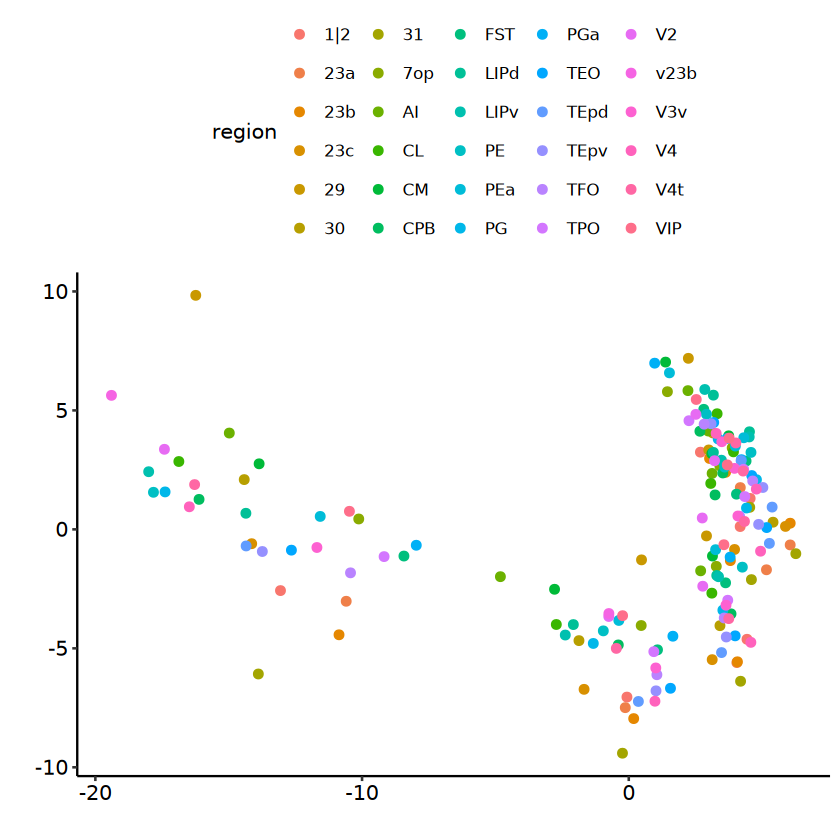

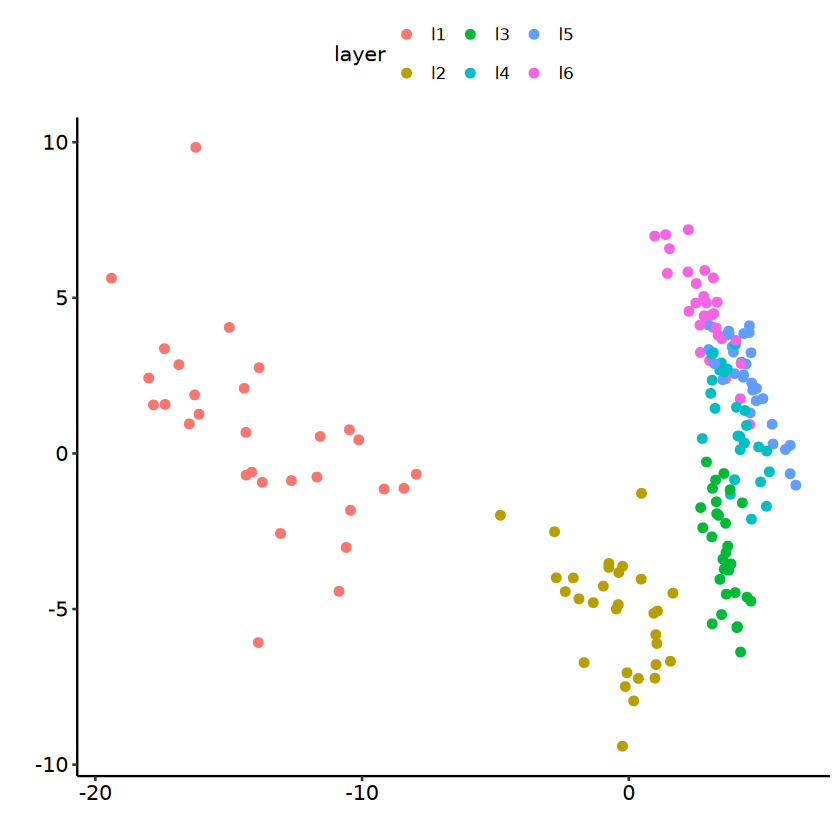

In [249]:
genedf = fsraw.cor %>% group_by(areatri,gene_id) %>% summarise(genecount = length(readid))
genexpmx = dcast(genedf, areatri~gene_id,
                     value.var = "genecount",fun.aggregate = sum)
genexpmx[is.na(genexpmx)] = 0
rownames(genexpmx) = genexpmx$areatri;genexpmx = genexpmx[-1]
library(Seurat)
genesrt = CreateSeuratObject(t(genexpmx))
#genesrt = ScaleData(genesrt)
genesrt = NormalizeData(genesrt)
genesrt = FindVariableFeatures(genesrt)
genexpmx = as.data.frame(t(as.matrix(GetAssayData(genesrt, assay = "RNA"))))
genexpmxf = genexpmx[,colSums(genexpmx > 0) > 174*0.5]

res.pca = prcomp(genexpmxf)
pcabasic = fviz_pca_ind(res.pca,label = "none")
pcabasic = pcabasic$data
head(pcabasic)
pcabasic$name = as.character(pcabasic$name)
pcabasic$region = MySplit(pcabasic$name,"-",1)
pcabasic$layer = MySplit(pcabasic$name,"-",2)
ppca1 = ggplot(pcabasic,aes(x = x,y = y, color = region)) + 
      geom_point(size = 2) + 
      #ggrepel::geom_text_repel(aes(label = name)) +
      theme_pubr() + xlab("") + ylab("")
ppca1
ppca2 = ggplot(pcabasic,aes(x = x,y = y, color = layer)) + 
      geom_point(size = 2) + 
      #ggrepel::geom_text_repel(aes(label = name)) +
      theme_pubr() + xlab("") + ylab("")
ppca2


In [256]:
  pt = ggarrange(areaPcac$pcaf, areaPcag$pcaf,areaPcae$pcaf,nrow = 1,common.legend = T)
ggexport(pt,filename = "result/figure2/f5b.areaid_PCA_total_09_09.pdf",width = 10,height = 4)

Warning message:
"ggrepel: 13 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"
file saved to result/figure2/f5b.areaid_PCA_total_09_09.pdf



In [ ]:
#PCA analysis
{
  
  areapcals = qread("processed/figures/f5/areaid_PCA_total_ls_06_22.qs")
  qsave(areapcals,file = "processed/figures/f2/areaid_PCA_total_ls_12_26.qs")
  ggsave(ggarrange(areaPcac$pcaf, areaPcag$pcaf,areaPcae$pcaf,nrow = 1,common.legend = T),
         filename = "processed/figures/f2/f5b.areaid_PCA_total_12_26.pdf",
         width = 9,height = 4,units = "in")
  
  areapcals = qread("processed/figures/f2/areaid_PCA_total_ls_12_26.qs")
  clscore1 = areapcals$cell$shscore
  clscore2 = areapcals$exon$shscore
  clscore3 = areapcals$gene$shscore
  clscore1$group = "celltype"
  clscore2$group = "exon"
  clscore3$group = "gene"
  clscore = rbind(clscore1,clscore2,clscore3)
  
  clscore$group = factor(clscore$group,levels = c("celltype","gene","exon"))
  library(fmsb)
  data <- as.data.frame(matrix( sample( 0:20 , 15 , replace=F) , ncol=5))
  colnames(data) <- c("math" , "english" , "biology" , "music" , "R-coding" )
  rownames(data) <- paste("mister" , letters[1:3] , sep="-")
  
  clscoret = dcast(clscore,group~true,value.var = "disp",fun.aggregate = sum)
  rownames(clscoret) = clscoret$group;clscoret = clscoret[-1]
  clscoret = rbind(rep(3,5) , rep(1,5) , clscoret)
  
  # To use the fmsb package, I have to add 2 lines to the dataframe: the max and min of each variable to show on the plot!
  # data <- rbind(rep(20,5) , rep(0,5) , data)
  library(RColorBrewer)
  coul <- brewer.pal(3, "Set2")
  colors_border <- coul
  library(scales)
  colors_in <- alpha(coul,0.2)
  pdf(file = "processed/figures/f2/areaid_PCA_dispersion_stat_radar_24_09_09.pdf",
      width = 5,height = 4)
  
  radarchart( clscoret  , axistype=1 , 
              #custom polygon
              pcol=colors_border , pfcol=colors_in ,
              # pcol=colors_border , 
              plwd=2 , plty=2,
              #custom the grid
              cglcol="grey", cglty=1, axislabcol="grey",
              caxislabels=seq(1,3,0.5), cglwd=1,
              #custom labels
              vlcex=1 
  )
  legend(x=1, y=1.3, legend = rownames(clscoret[-c(1,2),]), 
         bty = "n", pch=20 , col=colors_border ,  cex=0.8, pt.cex=0.8)
  dev.off()
  
  pdisp1 = ggplot(clscore,aes(x = true, y = disp, color = true,fill = group)) +
    geom_bar(stat = "identity",position = position_dodge(0.8),
             width = 0.7) +
    theme_pubr() +
    # scale_color_manual(values = mycolor) +
    xlab("") + ylab("Cluster Shannon Index")
  pdisp1
  my_comparisons <- list( c("celltype", "exon"), c("celltype", "gene"), c("exon", "gene") )
  pdisp2 = ggboxplot(clscore,x = "group",
                     y = "disp",add = "jitter",
                     width = 0.5) +
    stat_compare_means(method = "t.test",
                       comparisons = my_comparisons,paired = T) +
    xlab("") + ylab("Shannon Index") + theme_pubr()
  pdisp2
  
  
  # clscore = clscore[!is.na(clscore$disore),]
  # pdisp1 = ggboxplot(clscore, x = "group",y = "disore",
  #                   fill = "group",
  #                   add = c("jitter"))+
  #   facet_wrap(~lobes,scales = "free",nrow = 1) + 
  #   stat_compare_means(method = "t.test",comparisons = list(c("celltype","exon"),
  #                                         c("celltype","gene"),
  #                                         c("exon","gene"))) +
  #     xlab("") + ylab("Relative Distance Score") +
  #   scale_color_manual(values = c(celltype = "black",
  #                                 exon = "black",
  #                      gene = "black")) +
  #   scale_fill_aaas()
  # pdisp1
  
  ggsave(pdisp1, filename = "processed/figures/f5/areaid_PCA_dispersion_stat_06_19.pdf",
         width = 6,height = 3,units = "in")
  ggsave(pdisp2, filename = "processed/figures/f5/areaid_PCA_dispersion_stat_boxplot_06_19.pdf",
         width = 4,height = 3,units = "in")
  
  # clscorel = dcast(clscore, true~group,value.var = "disp")
  # t.test(clscorel$exon,clscorel$gene,paired = T)
  # t.test(clscorel$celltype,clscorel$exon,paired = T)
  library(ggstatsplot)
  pdisp2 = ggwithinstats(clscore[clscore$group %in% c("gene","exon"),],x = "group", y = "disp",
                         type = "parametric") +
    xlab("") + ylab("Shannon Index") 
  pdisp2
  
  #dist stat
  areaorder = c("29","30","23a","23b","31","23c","1|2","PE","PEa",
                "VIP","LIPv","LIPd","PG","7op","CM","AI","CL",
                "CPB","TPO","PGa","FST","V4t","V4","TEO","TEpd",
                "TEpv","TFO","V3v","V2","v23b")
  SpdisVsPCAdis = function(pcadis1){
    pcadis1$Var1ord = as.numeric(factor(pcadis1$Var1,levels = areaorder))
    pcadis1$Var2ord = as.numeric(factor(pcadis1$Var2,levels = areaorder))
    pcadis1$phsdist = abs(pcadis1$Var1ord - pcadis1$Var2ord)
    corst = pcadis1 %>% group_by(phsdist) %>% 
      summarise(value = mean(value))
    print(cor(corst$phsdist,corst$value))
    return(pcadis1)
  }
  
  SpdisVsPCAdis2 = function(pcadis1){
    pcadis1$Var1ord = as.numeric(factor(pcadis1$Var1,levels = areaorder))
    pcadis1$Var2ord = as.numeric(factor(pcadis1$Var2,levels = areaorder))
    pcadis1$phsdist = abs(pcadis1$Var1ord - pcadis1$Var2ord)
    pcadis1 = pcadis1 %>% group_by(Var2) %>% arrange(value) %>%
      mutate(caldisti = 1:n())
    pcadis1 = pcadis1[order(pcadis1$Var2),]
    corst = pcadis1 %>% group_by(phsdist) %>% 
      summarise(value = mean(caldisti))
    print(cor(corst$phsdist,corst$value))
    return(pcadis1)
  }
  
  spdvpcadc = SpdisVsPCAdis2(areapcals$cell$pcadis)
  spdvpcadg = SpdisVsPCAdis2(areapcals$gene$pcadis)
  spdvpcade = SpdisVsPCAdis2(areapcals$exon$pcadis)
  spdvpcadc$group = "Cell"
  spdvpcadg$group = "Gene"
  spdvpcade$group = "Exon"
  spdvpcad = rbind(spdvpcadc,spdvpcadg,spdvpcade)
  
  spdvpcad$group = factor(spdvpcad$group,levels = c("Cell","Gene","Exon"))
  p5b = ggplot(spdvpcad,aes(x = as.factor(phsdist),y = caldisti)) + 
    geom_boxplot() + theme_pubr() + 
    facet_grid(group~.,scales = "free") +
    xlab("Spatial Distance") + ylab("PCA distance")
  p5b
  ggarrange(p5b,p5b3,ncol = 1)
  ggsave(p5b, filename = "processed/figures/f5/f5b.areaid_spatialdist_vs_pcadist_06_19.pdf",
         width = 6, height = 4,units = "in")
  
  #build a network plot
  pref = qread("processed/spatial_basic_plot/area_figure_an.qs")
  myedges = pref$areaedges
  myedges[myedges$areaid == "1/2",]$areaid = "1|2"
  myedges = myedges[myedges$areaid %in% spdvpcad$Var2,]
  myedges = merge(myedges,areaan,by = "areaid")
  mypoint = myedges %>% group_by(areaid) %>% summarise(x = (mean(x1) + mean(x2))/2,
                                                       y = (mean(y1) + mean(y2))/2)
  mypoint = merge(mypoint,areaan,by = "areaid")
  
  gcountst = exonstls.ngs$areaid
  gcountst = gcountst %>% group_by(areatr) %>% 
    summarise(count = sum(genecount[!duplicated(gene)]))
  gcountst$areatr = factor(gcountst$areatr,levels = areaorder)
  
  areaPcag$pcaf
  areaPcae$pcaf
  disdf = areaPcae$pcadis
  AreaDisNetwork = function(disdf,mn,mypoint,gcountst){
    # disdf = core[core$Var1 != core$Var2, ]
    disdf = disdf[c(1:3)]
    disdf$groupcmb = apply(disdf, 1, function(x){vect = c(x[1],x[2]);
    vect = vect[order(vect)];return(paste0(vect,collapse = "-"))})
    disdf = merge(disdf,mypoint,by.x = "Var1",by.y = "areaid")
    disdf = merge(disdf,mypoint,by.x = "Var2",by.y = "areaid")
    colnames(disdf) = c("Var2","Var1","dist",
                        "groupcmb","x1","y1","L0","x2","y2","group2")
    # disdf = disdf[!disdf$Var1 %in% c("29","v23b") & 
    #                 !disdf$Var2 %in% c("29","v23b"),]
    disdf = disdf %>% group_by(Var1) %>% mutate(norm = rescale(-dist))
    # disdf$norm = -disdf$dist
    # disdf$norm = rescale(disdf$dist)
    # disdf = disdf[!duplicated(disdf$groupcmb),]
    # disdf$norm = rescale(-disdf$dist)
    disdf = disdf %>% group_by(Var1) %>% arrange(desc(norm)) %>%
      top_n(n = mn, wt=norm)
    
    
    # disdf = merge(disdf,areaan,by.x = "Var1",by.y = "areaid")
    
    mypointp = merge(mypoint,gcountst,by.x = "areaid",by.y = "areatr")
    pt = ggplot() +
      geom_curve(data = disdf, aes(x = x1,xend = x2,
                                   y = y1, yend = y2,
                                   alpha = norm,
                                   size = norm,
                                   color = L0),
                 arrow = arrow(length = unit(0.03, "npc"), type="closed"),
                 angle = 15,size = 0.5,
                 lineend = "square") +
      geom_segment(data = myedges, 
                   aes(x = x1, y = y1, xend = x2, yend = y2),
                   size = 0.2,
                   color = "grey") + theme_void() +
      # scale_size(range = c(2,8),name = "point") +
      # scale_size(range = c(0.1,3)) +
      geom_point(data = mypointp, 
                 aes(x,y,fill = L0,size = log(count)),
                 shape = 21,color = "white",alpha = 0.7) +
      geom_text(data = mypointp, aes(x,y,label = areaid)) +
      # scale_size(range = c(1,3)) +
      scale_alpha(range = c(0,1)) +
      scale_color_manual(values = mycolor) +
      scale_fill_manual(values = mycolor) +
      scale_y_reverse() + scale_x_reverse()
    pt
    return(pt)
  }
  p5ic = AreaDisNetwork(areaPcac$pcadis,1,mypoint,gcountst)
  p5ic
  
  p5ig = AreaDisNetwork(areaPcag$pcadis,1,mypoint,gcountst)
  p5ig
  
  p5ie = AreaDisNetwork(areaPcae$pcadis,1,mypoint,gcountst)
  p5ie
  
  p5i = ggarrange(p5ic,p5ig,p5ie,common.legend = T,nrow = 1,
                  labels = c("Cell","Gene","Exon"))
  ggsave(p5i,filename = "processed/figures/f5/f5b.areaid_PCA_distance_network_06_22.pdf",
         width = 9,height = 4,units = "in")
  
  
  #for layer
  {
    
    SpdisVsPCAdisLayer = function(asl,mytitle){
      layerorder = paste0("l",1:6)
      res.pca = prcomp(asl)
      res.ds = dist(as.data.frame(res.pca$x))
      pcadis = melt(as.matrix(res.ds))
      pcadis = pcadis[pcadis$Var1 != pcadis$Var2,]
      pcadis = pcadis[pcadis$Var1 %in% layerorder & 
                        pcadis$Var2 %in% layerorder,]
      pcadis$Var1ord = as.numeric(factor(pcadis$Var1,levels = layerorder))
      pcadis$Var2ord = as.numeric(factor(pcadis$Var2,levels = layerorder))
      pcadis$phsdist = abs(pcadis$Var1ord - pcadis$Var2ord)
      corst = pcadis %>% group_by(phsdist) %>% summarise(value = mean(value))
      corst = cor(corst$phsdist,corst$value)
      print(corst)
      
      ppca1 = fviz_pca_ind(res.pca,
                           col.ind = rownames(asl),
                           pointshape = 21, pointsize = 2,
                           repel = TRUE) + theme_pubr() +
        ggtitle(mytitle) +
        scale_color_discreterainbow()
      
      return(list("pca" = ppca1,"pcadis" = pcadis, "corst" = corst))
    } 
    asll = arclst$ls %>% group_by(arealayer) %>% 
      summarise(subclass = subclass,cellnorm = cellnum/sum(cellnum))
    asll = dcast(asll,arealayer~subclass)
    asll[is.na(asll)] = 0
    rownames(asll) = asll$arealayer;asll = asll[-1]
    
    exonsigmxl = finalsig$layer$finalsig
    exonsigmxl = dcast(exonsigmxl, areatr~exoname,
                       value.var = "relative",fun.aggregate = sum)
    exonsigmxl[is.na(exonsigmxl)] = 0
    rownames(exonsigmxl) = exonsigmxl$areatr;exonsigmxl= exonsigmxl[-1]
    
    genexpl = finalsig$layer$finalsig
    genexpl = genexpl %>% group_by(areatr) %>% mutate(genenorm = scale(genecount))
    genexpmxl = dcast(genexpl, areatr~gene,
                      value.var = "genenorm",fun.aggregate = mean)
    genexpmxl[is.na(genexpmxl)] = 0
    rownames(genexpmxl) = genexpmxl$areatr;genexpmxl = genexpmxl[-1]
    
    spdvpcadclsl = SpdisVsPCAdisLayer(asll,"Cell")
    spdvpcadglsl = SpdisVsPCAdisLayer(genexpmxl,"Gene")
    spdvpcadelsl = SpdisVsPCAdisLayer(exonsigmxl,"Exon")
    spdvpcadelsl$pca
    spdvpcadelsl$pca
    spdvpcadcl = spdvpcadclsl$pcadis
    spdvpcadgl = spdvpcadglsl$pcadis
    spdvpcadel = spdvpcadelsl$pcadis
    spdvpcadcl$group = "Cell"
    spdvpcadgl$group = "Gene"
    spdvpcadel$group = "Exon"
    spdvpcadl = rbind(spdvpcadcl,spdvpcadgl,spdvpcadel)
    
    
    spdvpcadcl$Var1 = factor(spdvpcadcl$Var1,levels = layerorder)
    spdvpcadcl$Var2 = factor(spdvpcadcl$Var2,levels = layerorder)
    
    
    p5b2 = ggplot(spdvpcadl,aes(x = as.factor(phsdist),y = value)) + 
      geom_boxplot() + theme_pubr() + 
      facet_grid(group~.,scales = "free") +
      xlab("Spatial Distance") + ylab("PCA distance")
    p5b2
    
    gcountst = finalsig$areaid$finalsig
    gcountst = gcountst %>% group_by(areatr) %>% 
      summarise(count = sum(genecount[!duplicated(gene)]))
    gcountst$areatr = factor(gcountst$areatr,levels = areaorder)
    gcountmx = NULL
    for (i in 1:nrow(gcountst)) {
      idi = gcountst$areatr[i]
      counti = abs(gcountst[i,]$count - gcountst[-i,]$count)
      disti = abs(as.numeric(gcountst[i,]$areatr) - 
                    as.numeric(gcountst[-i,]$areatr))
      gcountmx = rbind(gcountmx, data.frame("areaid" = idi,
                                            "countdis" = counti,
                                            "spdis" = disti))
    }
    p5b3 = ggplot(gcountmx,aes(x = as.factor(spdis), y = countdis)) + 
      geom_boxplot()
    ggarrange(p5b,p5b3,nrow = 2)
    
    
  }
  
  areaPcac = areapcals$cell
  areaPcag = areapcals$gene
  areaPcae = areapcals$exon
  #gene cell exon cor compare
  {
    cmpcor = merge(areaPcac$pcadis[1:3],areaPcag$pcadis[1:3],
                   by = c("Var2","Var1"))
    cmpcor = merge(cmpcor,areaPcae$pcadis[c(1:3,5)],
                   by = c("Var2","Var1"))
    colnames(cmpcor)[3:6] = c("cell","gene","exon","group")
    cmpcor %>% group_by(group) %>% summarise(cor(cell,exon))
    cmpcor %>% group_by(group) %>% summarise(cor(cell,gene))
    cmpcor %>% group_by(group) %>% summarise(cor(gene,exon))
    cor(cmpcor$cell,cmpcor$gene)
    cor(cmpcor$cell,cmpcor$exon)
    cor(cmpcor$gene,cmpcor$exon)
    cmpcor$groupcmb = apply(cmpcor, 1, function(x){vect = c(x[1],x[2]);
    vect = vect[order(vect)];return(paste0(vect,collapse = "-"))})
    
    # cmpcorf = cmpcor[!duplicated(cmpcor$groupcmb),]
    cmpcorf = cmpcor
    cmpcorf = cmpcorf[!cmpcorf$Var1 %in% c("29","v23b") & 
                        !cmpcorf$Var2 %in% c("29","v23b"),]
    ggplot(cmpcorf,
           aes(x = exon, y = gene,color = Var2)) +
      geom_point()
    # geom_text(aes(label = groupcmb),size = 3,color = "black")
    # geom_smooth(aes(x = gene, y = exon,color = Var1),se = F) +
    
    
    #correlation
    corc = melt(cor(t(asl[-ncol(asl)])))
    core = melt(cor(t(exonsigmx[-ncol(exonsigmx)])))
    corg = melt(cor(t(genexpmx[-ncol(genexpmx)])))
    cmpcor = merge(corc[1:3],corg[1:3],
                   by = c("Var2","Var1"))
    cmpcor = merge(cmpcor,core[1:3],
                   by = c("Var2","Var1"))
    colnames(cmpcor)[3:5] = c("cell","gene","exon")
    cor(cmpcor$cell,cmpcor$gene)
    cor(cmpcor$cell,cmpcor$exon)
    cor(cmpcor$gene,cmpcor$exon)
    spdvcorc = SpdisVsPCAdis(corc)
    spdvcorg = SpdisVsPCAdis(corg)
    spdvcore = SpdisVsPCAdis(core)
    spdvcorc$group = "Cell"
    spdvcorg$group = "Gene"
    spdvcore$group = "Exon"
    spdvcor = rbind(spdvcorc,spdvcorg,spdvcore)
    
    spdvcorc$Var1 = factor(spdvcorc$Var1,levels = areaorder)
    spdvcorc$Var2 = factor(spdvcorc$Var2,levels = areaorder)
    spdvcorg$Var1 = factor(spdvcorg$Var1,levels = areaorder)
    spdvcorg$Var2 = factor(spdvcorg$Var2,levels = areaorder)
    spdvcore$Var1 = factor(spdvcore$Var1,levels = areaorder)
    spdvcore$Var2 = factor(spdvcore$Var2,levels = areaorder)
    
    ggplot(spdvcorc[spdvcorc$Var1 != "v23b" &
                      spdvcorc$Var2 != "v23b",],aes(x = Var1, y = Var2,fill = value)) + 
      geom_tile() + scale_fill_YlOrBr()
    ggplot(spdvcorg[spdvcorg$Var1 != "v23b" &
                      spdvcorg$Var2 != "v23b",],aes(x = Var1, y = Var2,fill = value)) + 
      geom_tile() + scale_fill_YlOrBr()
    ggplot(spdvcore[spdvcore$Var1 != "v23b" &
                      spdvcore$Var2 != "v23b",],aes(x = Var1, y = Var2,fill = value)) + 
      geom_tile() + scale_fill_YlOrBr()
    
    
    spdvpcade$Var1 = factor(spdvpcade$Var1,levels = areaorder)
    spdvpcade$Var2 = factor(spdvpcade$Var2,levels = areaorder)
    spdvpcadg$Var1 = factor(spdvpcadg$Var1,levels = areaorder)
    spdvpcadg$Var2 = factor(spdvpcadg$Var2,levels = areaorder)
    spdvpcadc$Var1 = factor(spdvpcadc$Var1,levels = areaorder)
    spdvpcadc$Var2 = factor(spdvpcadc$Var2,levels = areaorder)
    ggplot(spdvpcade[spdvpcadc$Var1 != "v23b" &
                       spdvpcadc$Var2 != "v23b",],aes(x = Var1, y = Var2,fill = -value)) + 
      geom_tile() + scale_fill_YlOrBr()
    
    spdvcor$group = factor(spdvcor$group,levels = c("Cell","Gene","Exon"))
    p5b = ggplot(spdvcor,aes(x = as.factor(phsdist),y = value)) + 
      geom_boxplot() + theme_pubr() + 
      facet_grid(group~.,scales = "free") +
      xlab("Spatial Distance") + ylab("PCA distance")
    p5b
    
  }
  
}


### Hierachy level stat

In [251]:
regionid = unique(fsraw.cor$region)
regionid = regionid[order(regionid)]
regionid

[1] "1|2"  "23a"  "23b"  "23c"  "29"   "30"   "31"   "7op"  "AI"   "CL"  
[11] "CM"   "CPB"  "FST"  "LIPd" "LIPv" "PE"   "PEa"  "PG"   "PGa"  "TEO" 
[21] "TEpd" "TEpv" "TFO"  "TPO"  "V2"   "v23b" "V3v"  "V4"   "V4t"  "VIP"

In [15]:
regionlvv = data.frame("region" = c('V2','V3v','V4t','TEO',
                                   'TEpd','TEpv','FST','LIPd','LIPv','VIP',
                                  'PG','TPO','TFO'),
                     "level" = c(2,3,4,6,
                                 7,7,7,7,7,7,
                                8,9,10))
regionlvv$group = "Visual"
regionlvs = data.frame("region" = c('1|2','PE','PEa','PG'),
                     "level" = c(2,4,4,7))
regionlvs$group = "Somatosensory"
regionlv = rbind(regionlvv,regionlvs)
head(regionlv)

,region,level,group
,<chr>,<dbl>,<chr>
1,V2,2,Visual
2,V3v,3,Visual
3,V4t,4,Visual
4,TEO,6,Visual
5,TEpd,7,Visual
6,TEpv,7,Visual


In [315]:
#isoform diversity calculate
ra = 200
fsraw.cor$xid = as.integer(fsraw.cor$x/(ra*2)) * ra * 2 + ra
fsraw.cor$yid = as.integer(fsraw.cor$y/(ra*2)) * ra * 2 + ra
fsraw.cor$blockid = paste0(fsraw.cor$xid,"_", fsraw.cor$yid)
isodiv.rg = fsraw.cor %>% group_by(blockid,region) %>% 
      summarise(genenum = length(unique(gene_id)),
                transnum = length(unique(transcript_id)),
                readnum = length(unique(readid)))
isodiv.rg$isodiv = isodiv.rg$transnum/isodiv.rg$genenum
qsave(isodiv.rg,file = "result/figure2/region_iso_diversity_stat_bin200.qs")


`summarise()` has grouped output by 'blockid'. You can override using the
`.groups` argument.


In [17]:
isodiv.rg = qread("result/figure2/region_iso_diversity_stat_bin200.qs")
isodiv.rg$isodiv = isodiv.rg$transnum/isodiv.rg$genenum
isodiv.rg.st = isodiv.rg %>% group_by(region) %>% summarise(genenum = mean(genenum),
                                                           transnum = mean(transnum),
                                                           readnum = mean(readnum),
                                                           isodiv = mean(isodiv))
isodiv.rg.st = merge(isodiv.rg.st,regionlv,by = "region")

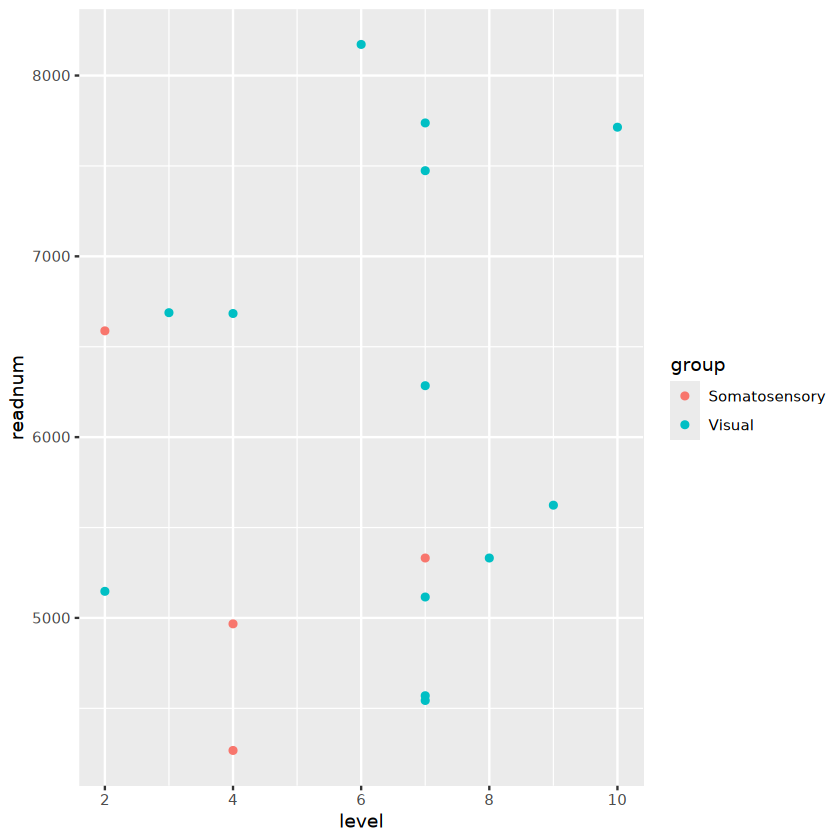

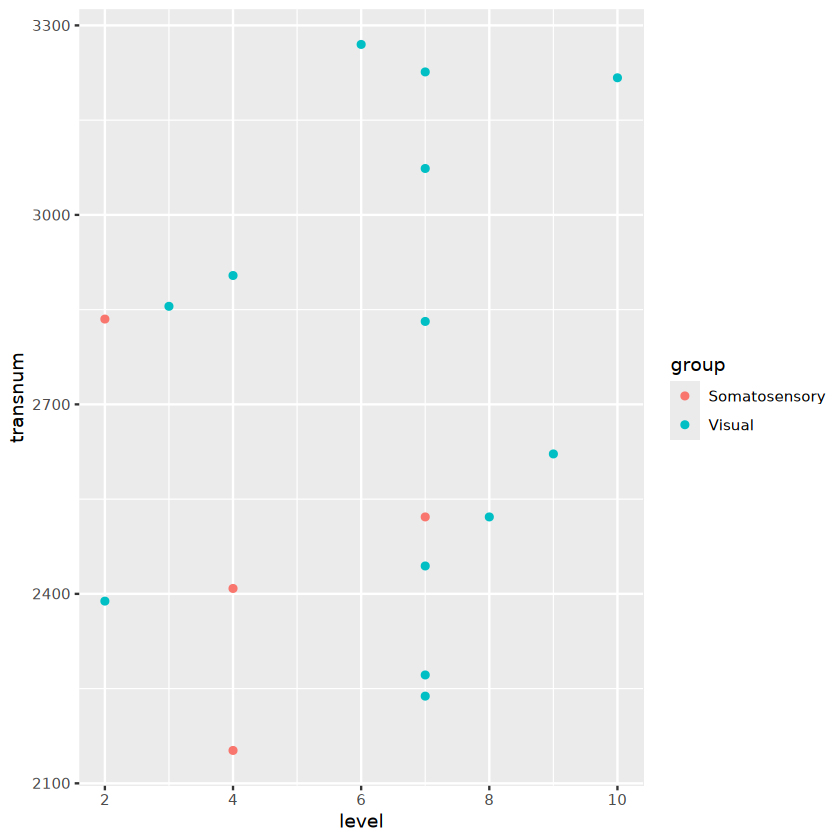

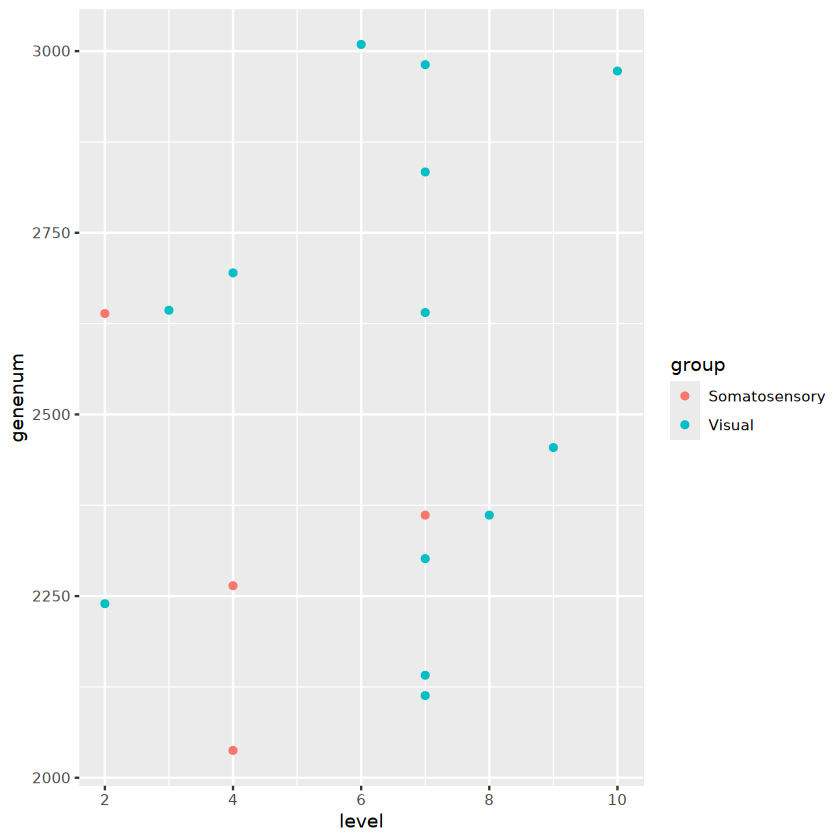

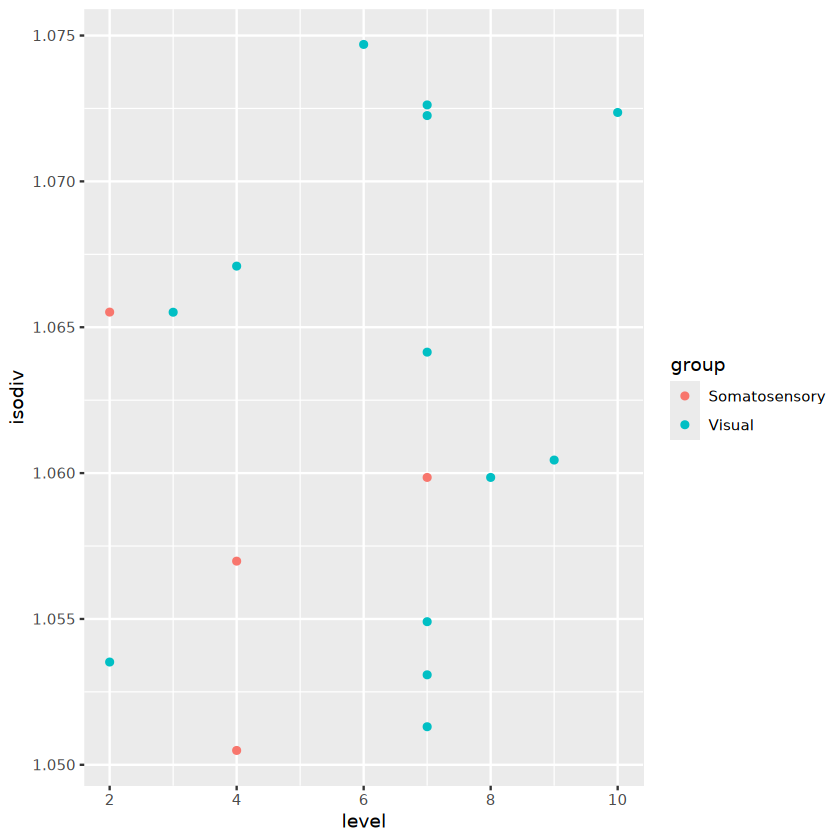

In [18]:
ggplot(isodiv.rg.st,aes(x = level, y = readnum,color = group)) + geom_point()
ggplot(isodiv.rg.st,aes(x = level, y = transnum,color = group)) + geom_point()
ggplot(isodiv.rg.st,aes(x = level, y = genenum,color = group)) + geom_point()
ggplot(isodiv.rg.st,aes(x = level, y = isodiv,color = group)) + geom_point()

### PSI calculate

In [77]:
bedids = longbed$name
bedids.st = as.data.frame(table(bedids))
head(bedids.st)

,bedids,Freq
,<fct>,<int>
1,00000002-74f0-4aac-b5f1-5300962f10fd-5;st_ed:A:1346-1985;AD:A:adapterD-adapterE;AP:A:Correct_596-620:+,1
2,00000121-40ec-4dc9-95e5-ea968476950d,1
3,00000123-b996-4a15-b62d-6431b9f9d71c,1
4,00000171-20c2-47d1-9b51-6d4e2eb79ae4-8;st_ed:A:3249-3730;AD:A:adapterG-adapterH;AP:A:Correct_439-463:+,1
5,000001ad-e76b-4469-b180-861402dd01c9-4;st_ed:A:920-1489;AD:A:adapterO.rc-adapterN.rc;AP:A:Correct_21-45:-,1
6,00000241-73cd-4089-a983-55b344b448ae,1


In [79]:
summary(bedids.st$Freq)
nrow(bedids.st)
qsave(bedids.st,file = "data/reads_full_anotation/fullscope_bed_read_block_stat_09_11.qs")

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  1.000   1.000   1.000   2.357   3.000 161.000 

[1] 89189390

In [ ]:
bedids.st = qread("data/reads_full_anotation/fullscope_bed_read_block_stat_09_11.qs")
fsraw = qread("data/reads_full_anotation/main_data_read_total_annotation_24_09_04.qs")
head(fsraw)

In [5]:
fsraw$rblockn = bedids.st[match(fsraw$readid,bedids.st$bedids),]$Freq
bedids.info = fsraw[!is.na(fsraw$rblockn),c("readid","origin_name","gene_id","x","y","layer","region","lobe","subcortical","cell_id","subclass","class","rblockn")]
bedids.info = bedids.info[!duplicated(bedids.info$readid),]
nrow(bedids.info)
qsave(bedids.info,file = "data/reads_full_anotation/fullscope_bed_read_block_info_09_11.qs")
head(bedids.info)

[1] 59344528

readid,origin_name,gene_id,x,y,layer,region,lobe,subcortical,subclass,class,rblockn
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>
00000121-40ec-4dc9-95e5-ea968476950d,L-PE-l6,GPAT4,16655,34225,l6,PE,parietal,Cortex,,,1
00000123-b996-4a15-b62d-6431b9f9d71c,L-CL-l3,VPRBP,43392,53179,l3,CL,auditory,Cortex,L3/4,GLU,1
00000171-20c2-47d1-9b51-6d4e2eb79ae4-8;st_ed:A:3249-3730;AD:A:adapterG-adapterH;AP:A:Correct_439-463:+,L-CPB-l3,PHYHIP,50029,60308,l3,CPB,auditory,Cortex,,,1
000001ad-e76b-4469-b180-861402dd01c9-4;st_ed:A:920-1489;AD:A:adapterO.rc-adapterN.rc;AP:A:Correct_21-45:-,L-23c-l6,UBB,10425,45990,l6,23c,cingulate,Cortex,,,1
00000241-73cd-4089-a983-55b344b448ae,L-V4t-l3,SLC7A14,50518,67496,l3,V4t,occipital,Cortex,,,1
000002ea-3ef4-41ed-a644-1e69f9784dac-3;st_ed:A:1568-2369;AD:A:adapterI-adapterJ;AP:A:Correct_757-781:+,L-SC-mb,LOC107128653,6446,77230,mb,SC,NA,Midbrain,,,1


In [5]:
bedids.info = qread("data/reads_full_anotation/fullscope_bed_read_block_info_09_11.qs")

In [23]:
bedids.infof = bedids.info[bedids.info$layer %in% paste0("l",1:6) & !is.na(bedids.info$subclass),]
bedids.infof$splice = "unspliced"
bedids.infof[bedids.infof$rblockn > 1,]$splice = "spliced"

In [13]:
splice.st = bedids.infof %>% group_by(layer, lobe, region, splice) %>% summarise(count = length(readid))
splice.st = splice.st %>% group_by(layer, lobe, region) %>% mutate(tcount = sum(count),rate = count/tcount)
head(splice.st)

`summarise()` has grouped output by 'layer', 'lobe', 'region'. You can override
using the `.groups` argument.


layer,lobe,region,splice,count,tcount,rate
<chr>,<chr>,<chr>,<chr>,<int>,<int>,<dbl>
l1,auditory,AI,spliced,15890,34517,0.4603529
l1,auditory,AI,unspliced,18627,34517,0.5396471
l1,auditory,CL,spliced,15266,31943,0.4779138
l1,auditory,CL,unspliced,16677,31943,0.5220862
l1,auditory,CM,spliced,11589,25964,0.4463488
l1,auditory,CM,unspliced,14375,25964,0.5536512


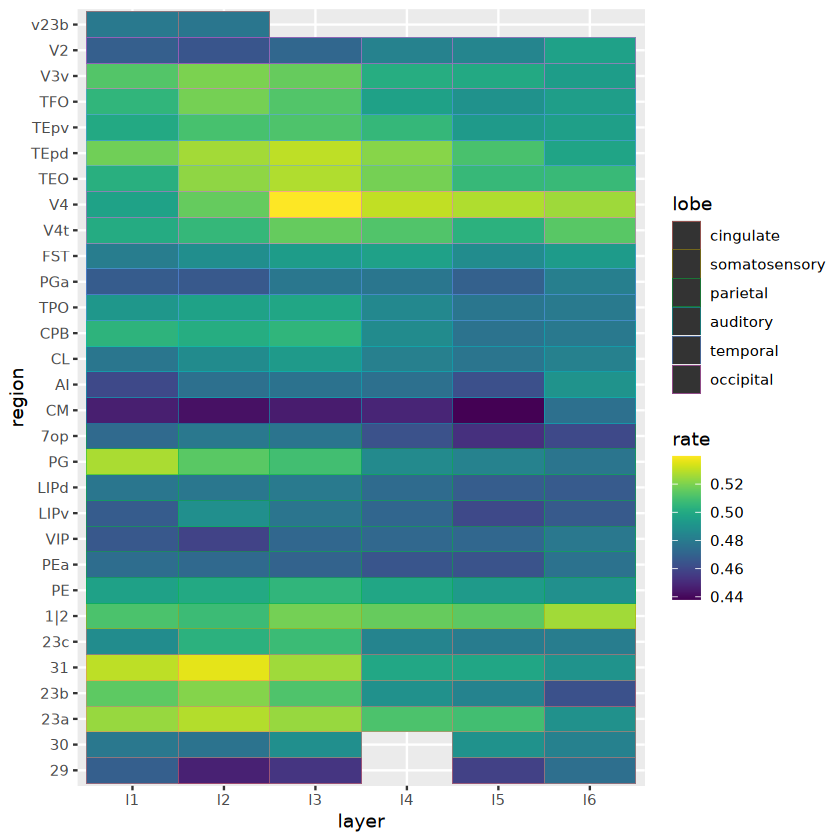

In [14]:
splice.st$lobe = factor(splice.st$lobe,levels = c('cingulate','somatosensory','parietal','auditory','temporal','occipital'))
splice.st$region = factor(splice.st$region,levels = c('29','30','23a','23b','31','23c','1|2','PE','PEa','VIP','LIPv','LIPd',
                                                    'PG','7op','CM','AI','CL','CPB','TPO','PGa','FST','V4t','V4','TEO','TEpd',
                                                    'TEpv','TFO','V3v','V2','v23b'))
splice.st = splice.st[order(splice.st$lobe,splice.st$region),]


file saved to result/figure2/splice_rate_spatial_stat_24_09_11.pdf



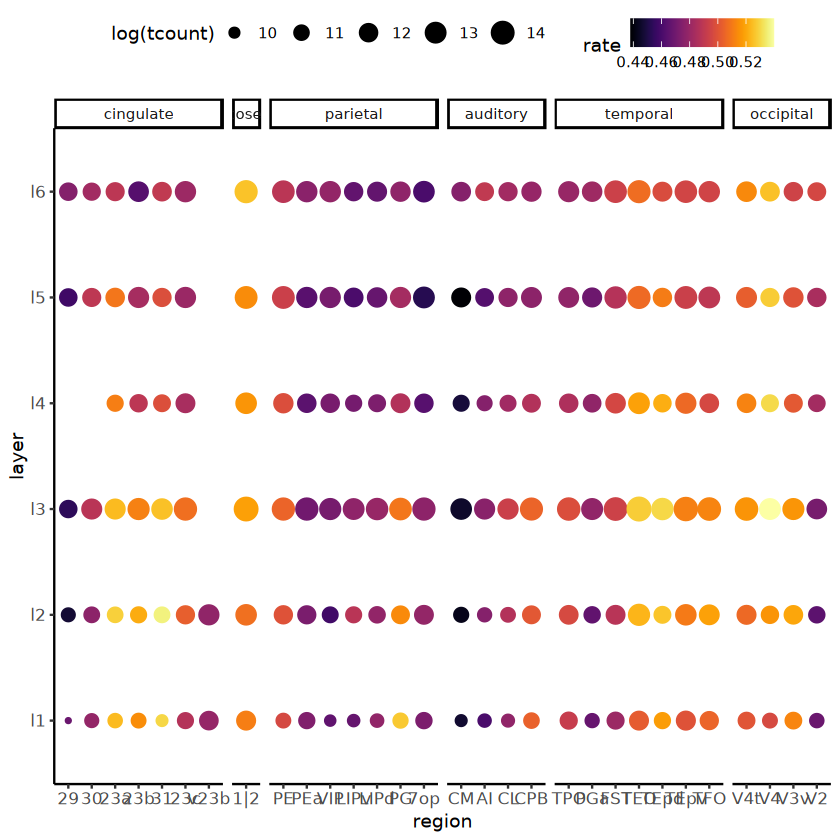

In [75]:
pspl1 = ggplot(splice.st[splice.st$splice == "spliced",],aes(y = layer,x = region,color = rate,size = log(tcount))) + geom_point() +
    facet_grid(~lobe,scales = "free",space = "free") +
    scale_color_viridis(option = "B") + theme_classic() + theme(axis.text = element_text(size = 10),legend.position = "top")
pspl1
ggexport(pspl1,filename = "result/figure2/splice_rate_spatial_stat_24_09_11.pdf",width = 10,height = 3)

In [ ]:
## splice.st.cl = bedids.infof %>% group_by(lobe,class, subclass, splice) %>% summarise(count = length(readid))
splice.st.cl = splice.st.cl %>% group_by(lobe,class, subclass) %>% mutate(tcount = sum(count),rate = count/tcount)
splice.st.cl = splice.st.cl[!is.na(splice.st.cl$class),]
splice.st.cl$class = as.factor(splice.st.cl$class)
splice.st.cl = splice.st.cl[order(splice.st.cl$class),]
splice.st.cl$subclass = factor(splice.st.cl$subclass,levels = unique(splice.st.cl$subclass))
pspl2 = ggplot(splice.st.cl[splice.st.cl$splice == "spliced",],aes(x = lobe,y = subclass,color = rate,size = log(tcount))) + geom_point() +
    #facet_grid(lobe~.,scales = "free",space = "free") +
    scale_color_viridis(option = "B") + theme_classic() + theme(axis.text = element_text(size = 10),legend.position = "top")
pspl2

`summarise()` has grouped output by 'lobe', 'region'. You can override using
the `.groups` argument.


[1] 0.4156494

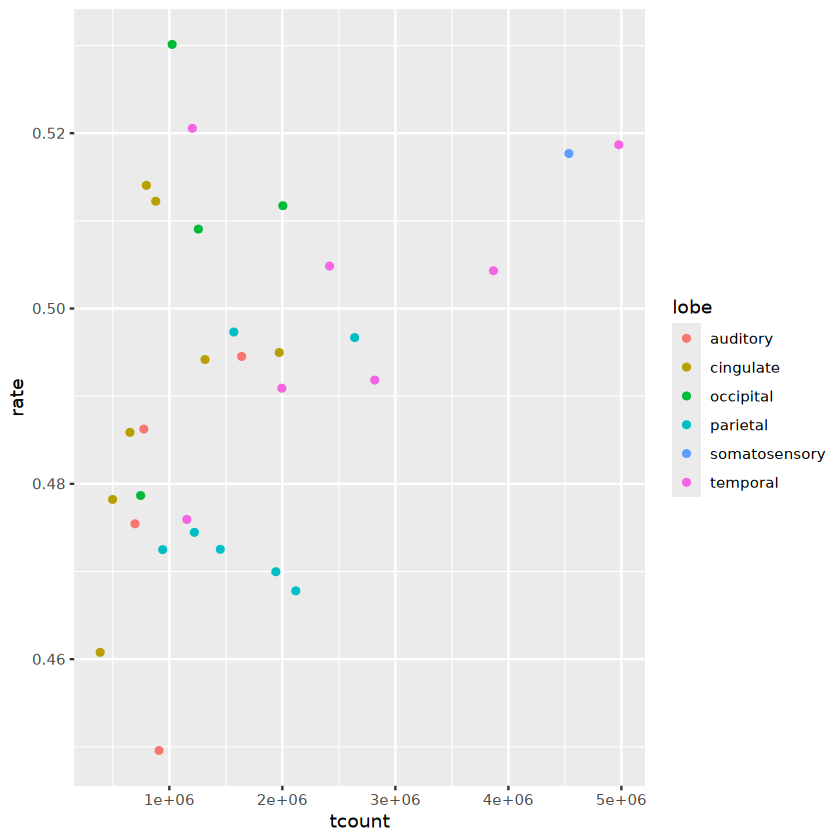

In [23]:
splice.region = bedids.infof %>% group_by(lobe, region, splice) %>% summarise(count = length(readid))
splice.region = splice.region %>% group_by(lobe, region) %>% mutate(tcount = sum(count),rate = count/tcount)
splice.region = splice.region[splice.region$splice == "spliced",]
#splice.region.lv = merge(splice.region,regionlv,by = "region")
ggplot(splice.region,aes(x = tcount, y = rate,color = lobe)) + geom_point()
cor(splice.region$rate,splice.region$tcount)

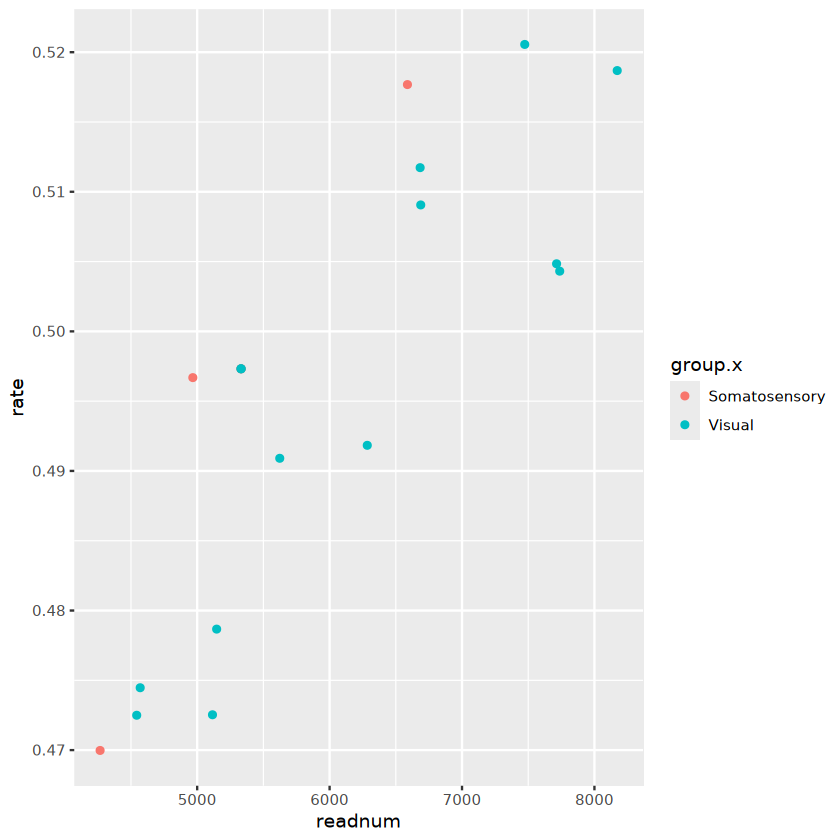

In [22]:
splice.region.lv2 = merge(splice.region.lv,isodiv.rg.st,by = "region")
ggplot(splice.region.lv2,aes(x = readnum, y = rate,color = group.x)) + geom_point()

In [8]:
fsraw.cor$areatri = paste0(fsraw.cor$region,"-",fsraw.cor$layer)
genedf = fsraw.cor %>% group_by(areatri,gene_id) %>% summarise(genecount = length(readid))
genexpmx = dcast(genedf, areatri~gene_id,
                     value.var = "genecount",fun.aggregate = sum)
genexpmx[is.na(genexpmx)] = 0
rownames(genexpmx) = genexpmx$areatri;genexpmx = genexpmx[-1]
library(Seurat)
genesrt = CreateSeuratObject(t(genexpmx))
#genesrt = ScaleData(genesrt)
genesrt = NormalizeData(genesrt)
genesrt = FindVariableFeatures(genesrt)
genesrt = ScaleData(genesrt)
genesrt <- RunPCA(genesrt,
                   # assay =  "SCT_GENE",
                   features = VariableFeatures(object = genesrt))


`summarise()` has grouped output by 'areatri'. You can override using the
`.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class matrix. Coercing to dgCMatrix."
Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix

PC_ 1 
Positive:  KRT17, LOC107128656, SEMA3E, SEMA3A, BMP5, FILIP1L, HTR2C, NXPH4, LOC102141173, CLCA2 
	   ISLR, S1PR5, LOC102145490, OLFML2B, LOC102124371, BambuGene89628, BambuGene92463, CPLX3, SLN, LOC102131644 
	   LOC102124997, CXCL1L, COL24A1, GFRA1, SNTB1, BambuGene119253, MYH13, RHBDL2, CCDC102B, DACH1 
Negative:  CALB1, PCDH8, HS6ST3, MEPE, YJEFN3, TWIST1, HOPX, SERPINE2, RBP4, CARTPT 
	   CBLN4, SPON2, TESPA1, C1QL2, FAM84A, WFDC2, RCN1, CUX2, PENK, CST6 
	   ADCYAP1, TPM1, FREM3, APOC1, LOC102140307, HAMP, HPCAL1, CDH22, KITLG, EMILIN3 
PC_ 2 
Positive:  CABP1, NDUFV2, BambuGene141830, ARPC5L, LOC102122149, PSMA3, NAPA, 

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
13:03:28 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

13:03:28 Read 174 rows and found 5 numeric columns

13:03:28 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

13:03:28 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:03:28 Writing NN index file to tem

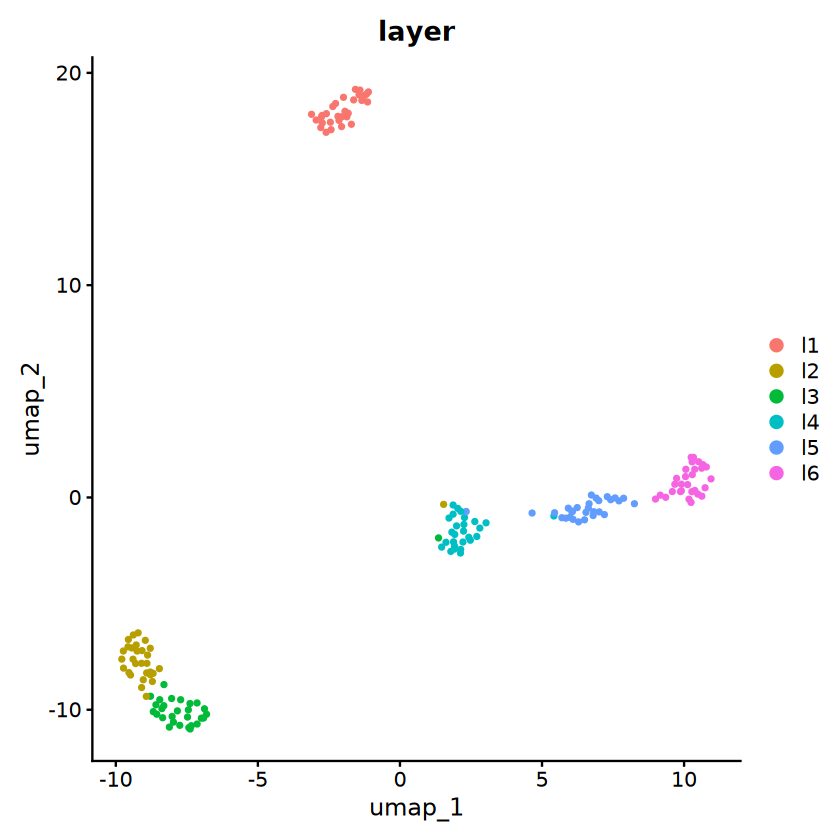

In [9]:
#genesrt <- FindNeighbors(genesrt, dims = 1:20)
#genesrt <- FindClusters(genesrt, resolution = 0.5)
genesrt <- RunUMAP(genesrt, dims = 1:5)
layerids = MySplit(colnames(genesrt),"-",2)
regionids = MySplit(colnames(genesrt),"-",1)
names(regionids) = names(layerids) = colnames(genesrt)
genesrt$region = regionids
genesrt$layer = layerids
Idents(genesrt) = genesrt$layer 
DimPlot(genesrt,group.by = "layer")

In [17]:
library(slingshot)
sds <- slingshot(Embeddings(genesrt, "umap"), clusterLabels = genesrt$layer, 
                       start.clus = 4, stretch = 0)
pt <- slingPseudotime(sds)
pt

,Lineage1
1|2-l1,2.3891783
1|2-l2,29.2280567
1|2-l3,30.6028373
1|2-l4,42.5539561
1|2-l5,46.8819795
1|2-l6,50.1536187
23a-l1,1.2141130
23a-l2,28.7985464
23a-l3,30.1347005
23a-l4,46.2854332


,umap_1,umap_2
,<dbl>,<dbl>
1|2-l1,-2.599061,17.2011299
1|2-l2,-8.466243,-8.0639844
1|2-l3,-7.430927,-10.8429289
1|2-l4,1.884716,-2.0906213
1|2-l5,5.924900,-0.5052175
1|2-l6,9.160834,0.1077335


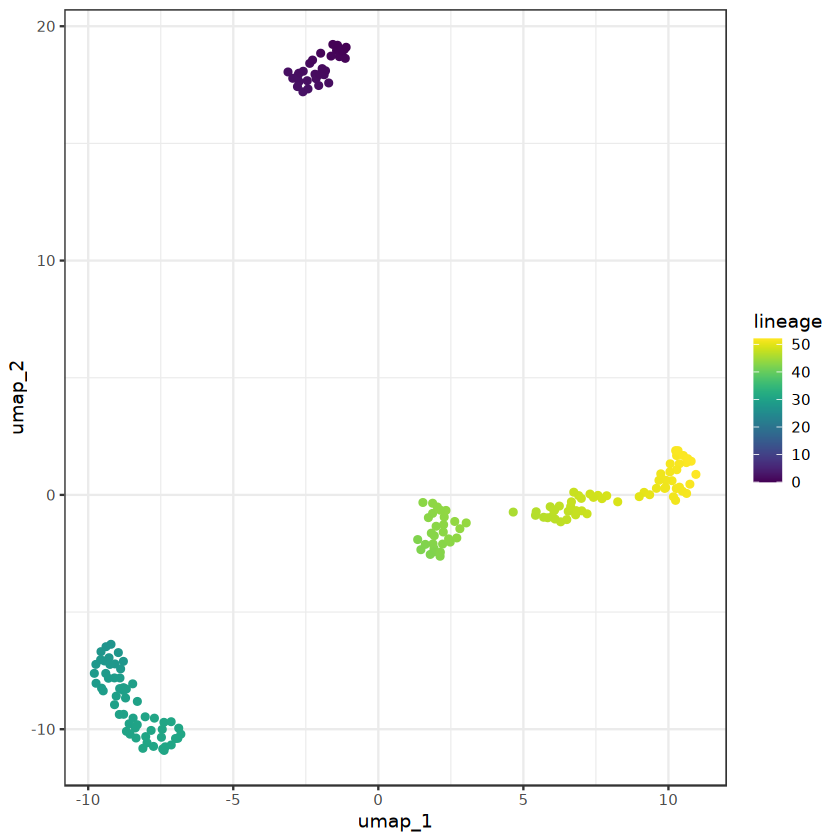

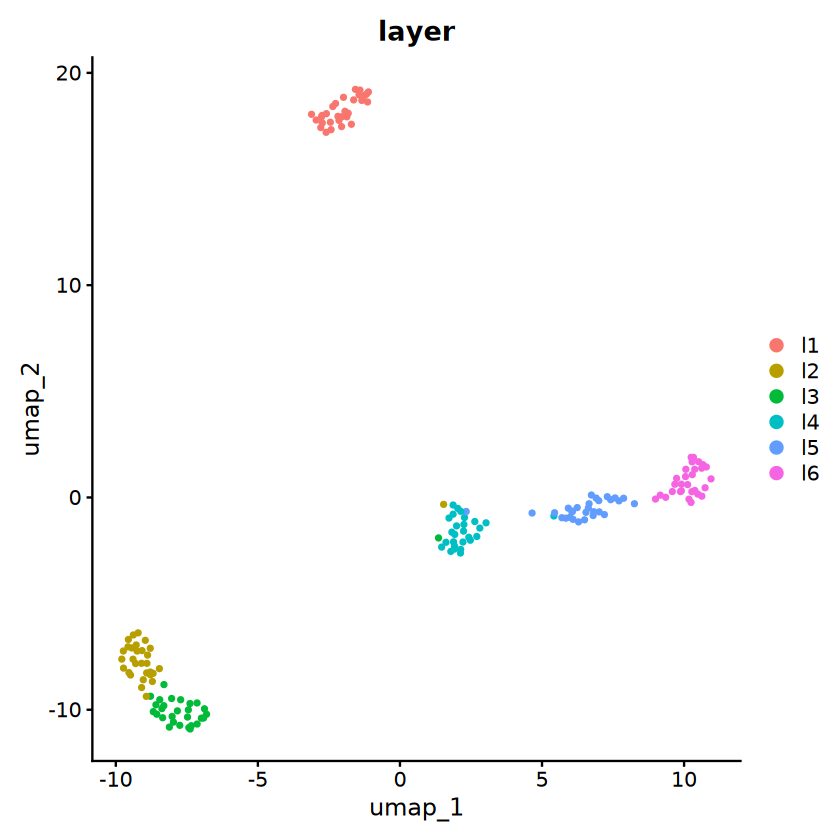

In [20]:
umapdf = as.data.frame(Embeddings(genesrt, "umap"))
head(umapdf)
pt = as.data.frame(pt)
umapdf$lineage = pt$Lineage1
ggplot(umapdf,aes(x = umap_1,y = umap_2,color = lineage)) + geom_point() + scale_color_viridis() + theme_bw()
DimPlot(genesrt,group.by = "layer")

In [21]:
sce <- slingshot(genesrt, clusterLabels = 'layer', reducedDim = 'PCA')
summary(sce$slingPseudotime_1)

ERROR: Error in (function (classes, fdef, mtable) : unable to find an inherited method for function 'slingshot' for signature '"Seurat", "character"'


`summarise()` has grouped output by 'layer', 'lobe', 'region', 'gene_id'. You
can override using the `.groups` argument.
Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
Warning message:
"Data is of class matrix. Coercing to dgCMatrix."
Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix

PC_ 1 
Positive:  PSMB3, EIF3D, FRG1, EBNA1BP2, IMPDH2, SNRPC, MRPL37, TSTD1, MRPS15, YIF1A 
	   LOC102135846, PSMA6, MCTS1, DYNLRB2, PSMA2, VARS, ITGAE, CPLX2, MRPL24, NELFE 
	   LOC102132295, LOC102132179, POLR2J, ILK, LOC101925848, CHCHD6, NDUFV2, PDCD5, USE1, ADH5 
Negative:  SH3BP5, LOC102138641, EFHC1, PHLDA2, LOC107129939, LOC102141168, LOC102143932, BambuGene110140, XRCC1, CCNA1 
	   SCGB3A1, MORN5, STK32C, LOC102144059, COL24A1, LOC102125512, LOC102129025, BambuGene1324, CCDC64B, BambuGene21747 
	   BambuGene95671, MYH13, NPM2, BambuGene115210, LOC107131083, DHRS7C, C13H2orf42, TRUB1, LOC102116746,

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 174
Number of edges: 4496

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7292
Number of communities: 3
Elapsed time: 0 seconds


16:33:25 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

16:33:25 Read 174 rows and found 10 numeric columns

16:33:25 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

16:33:25 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:33:25 Writing NN index file to temp file /tmp/RtmpIxTazC/file300c5952338b

16:33:25 Searching Annoy index using 1 thread, search_k = 3000

16:33:25 Annoy recall = 100%

16:33:52 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:34:35 Initializing from normalized Laplacian + no

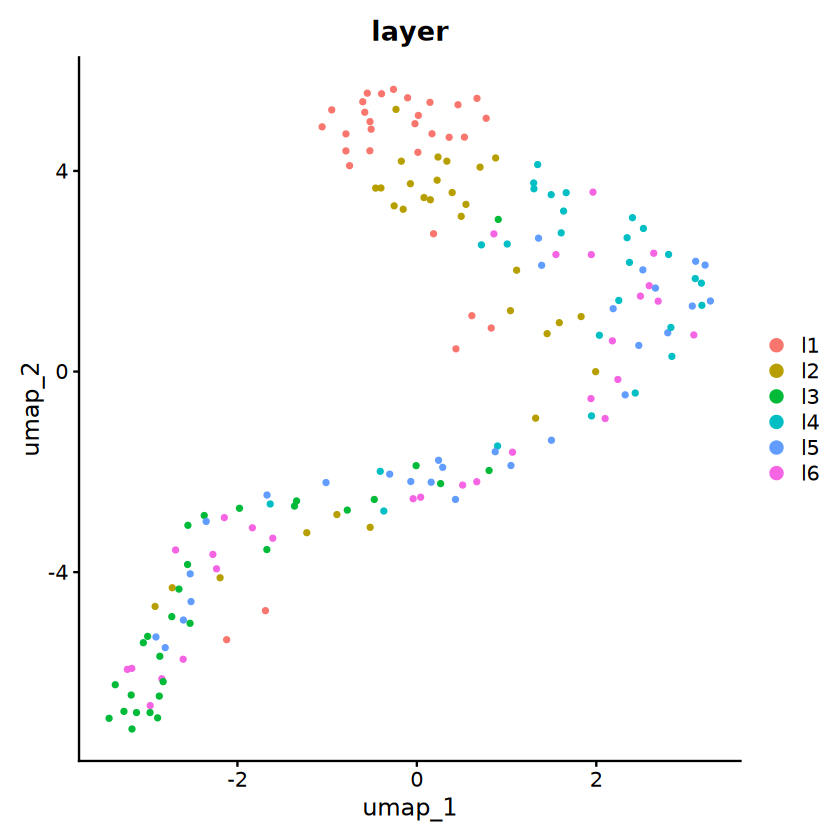

In [22]:
splice.st = bedids.infof %>% group_by(layer, lobe, region,gene_id, splice) %>% summarise(count = length(readid))
splice.st = splice.st %>% group_by(layer, lobe, region,gene_id) %>% mutate(tcount = sum(count),rate = count/tcount)
splice.st = splice.st[splice.st$splice == "spliced",]
splice.st$areatri = paste0(splice.st$region,"-",splice.st$layer)
splicemx = dcast(splice.st, areatri~gene_id,
                     value.var = "rate",fun.aggregate = sum)

splicemx[is.na(splicemx)] = 0
rownames(splicemx) = splicemx$areatri;splicemx = splicemx[-1]
library(Seurat)
spsrt = CreateSeuratObject(t(splicemx))
#genesrt = ScaleData(genesrt)
spsrt = NormalizeData(spsrt)
spsrt = FindVariableFeatures(spsrt)
spsrt = ScaleData(spsrt)
spsrt <- RunPCA(spsrt,
                   # assay =  "SCT_GENE",
                   features = VariableFeatures(object = spsrt))
spsrt <- FindNeighbors(spsrt, dims = 1:20)
spsrt <- FindClusters(spsrt, resolution = 0.5)
spsrt <- RunUMAP(spsrt, dims = 1:10)

layerids = MySplit(colnames(spsrt),"-",2)
regionids = MySplit(colnames(spsrt),"-",1)
names(regionids) = names(layerids) = colnames(spsrt)
spsrt$region = regionids
spsrt$layer = layerids
Idents(spsrt) = spsrt$layer 
DimPlot(spsrt,group.by = "layer")

### Meta Cell UMAP using ngs data

In [10]:
dir.create("data/meta_cell_ngs")

In [ ]:
dir.create("result/figure2")

In [220]:
#build meta cell
cellan = qread("../ref/T44_cell_pos_type_area_annotation_nobackground_23_08_16.qs")
cellanuq = cellan[!is.na(cellan$cell_id),] %>% group_by(cell_id, class, subclass, cell_type, areaid,layer) %>% summarise(x = mean(x),y = mean(y))

n = 10
CellBallCluster = function(n,x,y){
    data = data.frame("x" = x, "y" = y)
    num_clusters <- ceiling(nrow(data) / n)
    # 使用k-means进行聚类
    kmeans_result <- kmeans(data[c("x","y")], centers = num_clusters)
    # 将每个点的分组分配到data中
    return(kmeans_result$cluster)
}
cellanuq$metacell = paste0(cellanuq$class,"-",cellanuq$subclass,"-",cellanuq$layer,"-",cellanuq$areaid,"-",cellanuq$cluster)
cellanuq = cellanuq  %>% group_by(areaid,layer,class,subclass) %>% mutate(cluster = CellBallCluster(n,x,y))

qsave(cellanuq,file = "ref/cellball_annotation_n10_24_04_03.qs")


`summarise()` has grouped output by 'cell_id', 'class', 'subclass',
'cell_type', 'areaid'. You can override using the `.groups` argument.
Warning message:
"Unknown or uninitialised column: `metacell`."


[1] 0

In [222]:
cellanuq.old = qread("ref/cellball_annotation_n10_24_01_08.qs")
cellanuq.old$metacell = paste0(cellanuq.old$class,"-",cellanuq.old$subclass,"-",cellanuq.old$layer,"-",cellanuq.old$areaid,"-",cellanuq.old$cluster)
length(unique(cellanuq$metacell))

[1] 41002

In [6]:
#filter cell annotation(option)
cellanuq = qread("ref/cellball_annotation_n10_24_04_03.qs")

length(unique(cellanuq$metacell))
cellanuq = cellanuq %>% group_by(metacell) %>% 
      mutate(cellnum = length(unique(cell_id)))
length(unique(cellanuq$metacell))

#cellanuqglu = cellanuq[cellanuq$class == "GLU",]
#cellanuqglu = cellanuqglu %>% group_by(areaid,subclass) %>% 
#      mutate(cellnumt = length(unique(cell_id)))
#cellanuqglu = cellanuqglu %>% group_by(areaid,subclass,layer) %>% 
#      mutate(cellnuml = length(unique(cell_id)))
#cellanuqglu$cellrate = cellanuqglu$cellnuml/cellanuqglu$cellnumt
#cellanuqgluf = cellanuqglu[cellanuqglu$cellrate > 0.1,]
#length(unique(cellanuqgluf$metacell))
#length(unique(cellanuqglu$metacell))
#cellanuqf = rbind(cellanuq[cellanuq$class != "GLU",],cellanuqgluf)

[1] 41002

[1] 41002

In [7]:
genedfcl = qread("/cluster/home/liuhengxin/P1_brain_nanopore/ref/total_gene_T44.type20230503-macaque1-contour2.round_withan_06_09.qs")
head(genedfcl)

,chip,gene,x,y,cell_id,gene_area,rx,ry,expr,area,subcell,class,areaid,arealayer,areaclass
,<chr>,<chr>,<int>,<int>,<dbl>,<int>,<int>,<int>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
440,T44,ABI2,22794,52852,2,996,44215,39690,1.61,L-VIP-l6,L5/6,GLU,VIP,l6,parietal
441,T44,AHNAK,22794,52852,2,996,44215,39690,0.69,L-VIP-l6,L5/6,GLU,VIP,l6,parietal
442,T44,AK5,22794,52852,2,996,44215,39690,0.69,L-VIP-l6,L5/6,GLU,VIP,l6,parietal
443,T44,AKIRIN2,22794,52852,2,996,44215,39690,0.69,L-VIP-l6,L5/6,GLU,VIP,l6,parietal
444,T44,ALDOC,22794,52852,2,996,44215,39690,0.69,L-VIP-l6,L5/6,GLU,VIP,l6,parietal
445,T44,ALK,22794,52852,2,996,44215,39690,0.69,L-VIP-l6,L5/6,GLU,VIP,l6,parietal


In [8]:
#ngs metacell stat
genedfcl$metacell = cellanuq[match(genedfcl$cell_id,cellanuq$cell_id),]$metacell
genedfcl = genedfcl[!is.na(genedfcl$metacell),]
genedfcl = genedfcl %>% group_by(metacell,gene) %>% 
    summarise(genecount = sum(expr))
qsave(genedfcl,file = "data/meta_cell_ngs/ngs_gene_metacell_n10_st_24_03_28.qs")
 #   genedfcl = qread("processed_data/cellball_group/gene_cell_st_metacell_100_24_01_07.qs")

#annotation
cellidan = data.frame("metacell" = unique(genedfcl$metacell))
cellidan$class = MySplit(cellidan$metacell,"-",1)
cellidan$subclass = MySplit(cellidan$metacell,"-",2)
cellidan$layer = MySplit(cellidan$metacell,"-",3)
cellidan$areaid = MySplit(cellidan$metacell,"-",4)
colnames(cellidan)[1] = "cell_id"
qsave(cellidan,file = "data/meta_cell_ngs/metacell_annotation_n10_24_03_28.qs")
head(genedfcl)


`summarise()` has grouped output by 'metacell'. You can override using the
`.groups` argument.


metacell,gene,genecount
<chr>,<chr>,<dbl>
GABA-LAMP5-c-IG-1,AASDH,0.69
GABA-LAMP5-c-IG-1,AASDHPPT,0.69
GABA-LAMP5-c-IG-1,ABHD17A,1.61
GABA-LAMP5-c-IG-1,ACSL6,0.69
GABA-LAMP5-c-IG-1,ACTR3B,1.10
GABA-LAMP5-c-IG-1,ACVR2A,0.69


In [9]:
genemx = tidyr::spread(genedfcl[c("gene","metacell","genecount")], key = metacell, value = genecount, fill = 0)
genemx = as.data.frame(genemx)
rownames(genemx) = genemx$gene;genemx = genemx[-1]
qsave(genemx,file = "data/meta_cell_ngs/ngs_gene_cell_st_metacell_n10_mx_24_03_28.qs")

In [10]:
#build UMAP cluster
#genemx = qread("data/meta_cell_ngs/ngs_gene_cell_st_metacell_n10_mx_24_03_28.qs")
nrow(cellidan)
cellidanf = cellidan[cellidan$layer %in% paste0("l",1:6),]
nrow(cellidanf)
genemx = genemx[,cellidanf$cell_id]
dim(genemx)


[1] 40986

[1] 40955

[1] 15608 40955

Warning message:
"Data is of class data.frame. Coercing to dgCMatrix."
Normalizing layer: counts

Centering and scaling data matrix

Finding variable features for layer counts

PC_ 1 
Positive:  ADGRV1, NKAIN3, SLC1A2, MSI2, ATP13A4, PREX2, GPC5, NPAS3, PRKCQ, TNIK 
	   NFIA, NHSL1, PITPNC1, NCKAP5, SLC4A4, GRAMD2B, SLC15A2, ETNPPL, MAML2, CDH20 
	   CARMIL1, TRPS1, FOXO1, PARD3, SLC1A3, CADM1, ZNRF3, NTM, PARD3B, LSAMP 
Negative:  SNAP25, CALM2, VSNL1, SYT1, RTN1, STMN1, OLFM1, UCHL1, CHN1, RGS4 
	   STMN2, TMSB10, KCNIP4, LMO4, MDH1, TAGLN3, GAP43, CCK, RBFOX1, NEFL 
	   ATP2B1, SNCA, ARPP19, NRN1, CHGA, PPP3CA, NGEF, IQCJ-SCHIP1, SV2B, NRXN3 
PC_ 2 
Positive:  COX3, APOE, CST3, MBP, GLUL, SPARCL1, SLC1A3, PTGDS, CLU, PLP1 
	   CPE, PMP22, ATP1A4, PTN, CRYAB, FGFR3, GPR37L1, AGT, WIF1, RGCC 
	   SLC1A2, TSC22D4, CSRP1, CXCL14, MFGE8, FOLH1, GPRC5B, FGFR2, ETNPPL, TTYH2 
Negative:  RIMS2, NRXN3, FGF14, KCNIP4, OPCML, STXBP5L, RBFOX1, NRG3, CSMD1, DSCAM 
	   KCNMA1, NEGR1, ADGRB3, KHDR

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 37022
Number of edges: 1234546

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9136
Number of communities: 14
Elapsed time: 6 seconds


16:03:29 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

16:03:29 Read 37022 rows and found 10 numeric columns

16:03:29 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by 'spam'

16:03:29 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:03:34 Writing NN index file to temp file /tmp/RtmpJHjE4e/file7a72b3f7e20

16:03:34 Searching Annoy index using 1 thread, search_k = 3000

16:03:48 Annoy recall = 100%

16:03:50 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:03:54 Initializing from normalized Laplacian + n

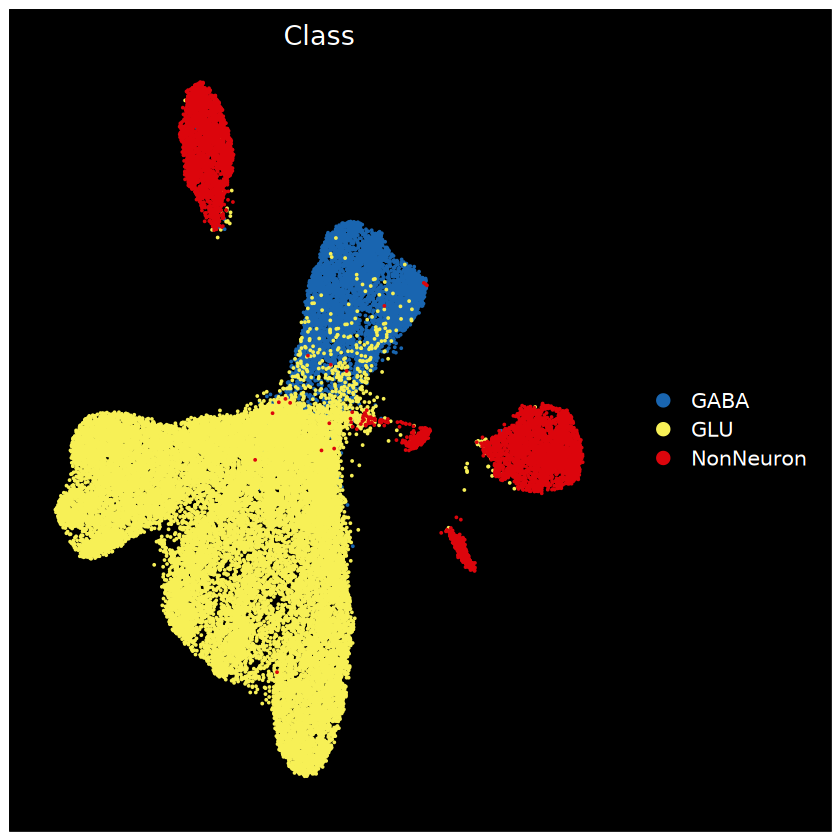

In [13]:
 ProcessSrtUmapSingle = function(genemx,cellidan){
    srtt = CreateSeuratObject(genemx)
    srtt = NormalizeData(srtt)
    # srtt = SCTransform(srtt,new.assay.name = "SCT_GENE")
    srtt = ScaleData(srtt)
    areaan = cellidan$areaid
    names(areaan) = cellidan$cell_id
    layeran = cellidan$layer
    names(layeran) = cellidan$cell_id
    subclassan = cellidan$subclass
    names(subclassan) = cellidan$cell_id
    classan = cellidan$class
    names(classan) = cellidan$cell_id
    
    srtt$subclass = subclassan
    srtt$class = classan
    srtt$layer = layeran
    srtt$area = areaan
    # srtt$region = MySplit(colnames(srtt),"-",1)
    # names(srtt$region) = colnames(srtt)
    # srtt$layer = MySplit(colnames(srtt),"-",2)
    # names(srtt$layer) = colnames(srtt)
    # srtt$class = MySplit(colnames(srtt),"-",3)
    # names(srtt$class) = colnames(srtt)
    # srtt$subclass = MySplit(colnames(srtt),"-",4)
    # names(srtt$subclass) = colnames(srtt)
    
    # VariableFeatures(srtt) = c(VariableFeatures(srtg),sigtrangroup)
    srtt <- FindVariableFeatures(srtt, selection.method = "vst",
                                 nfeatures = 2000)
    VariableFeatures(srtt) = c(VariableFeatures(srtt))
    srtt <- RunPCA(srtt,
                   # assay =  "SCT_GENE",
                   features = VariableFeatures(object = srtt))
    srtt <- FindNeighbors(srtt, dims = 1:20)
    srtt <- FindClusters(srtt, resolution = 0.5)
    srtt <- RunUMAP(srtt, dims = 1:10)
    Idents(srtt) = srtt$subclass
    DimPlot(srtt)
    
    return(srtt)
  }
  library(Seurat)
  genemxf = genemx[rowSums(genemx > 0 )>(ncol(genemx)/10),
                   colSums(genemx > 0) > 1000]
  srtt = ProcessSrtUmapSingle(genemxf,cellidan)
 # rownames(isomx) = paste0(rownames(isomx),"-long")
 # srtt[['ISOFORM']] = CreateAssayObject(isomx[colnames(srtt)])
  qsave(srtt,file = "data/meta_cell_ngs/umap_srt_combined_24_03_28.qs")
  
  psrtg1 = DimPlot(srtt,reduction = 'umap',label = T,
                   label.color = "white",
                   group.by = 'subclass',pt.size = 0.01) +
    # group.by = 'wsnn_res.0.3') + 
    ggtitle("Subclass") +
    theme_presentation() +
    scale_color_discreterainbow()
  
  psrtg2 = DimPlot(srtt,reduction = 'umap',
                   group.by = 'layer',pt.size = 0.01) +
    # group.by = 'wsnn_res.0.3') + 
    ggtitle("Layer") +
    theme_presentation() +
    scale_color_discreterainbow()
  
  psrtg3 = DimPlot(srtt,reduction = 'umap',
                   group.by = 'class',pt.size = 0.01) +
    # group.by = 'wsnn_res.0.3') + 
    ggtitle("Class") +
    theme_presentation() +
scale_color_discreterainbow()
  psrtg3
  ggexport(psrtg1+psrtg2+psrtg3,filename = "result/figure2/metacell_n10_umap_cluster_genecounts_24_03_28.pdf",
           width = 15, height = 4)

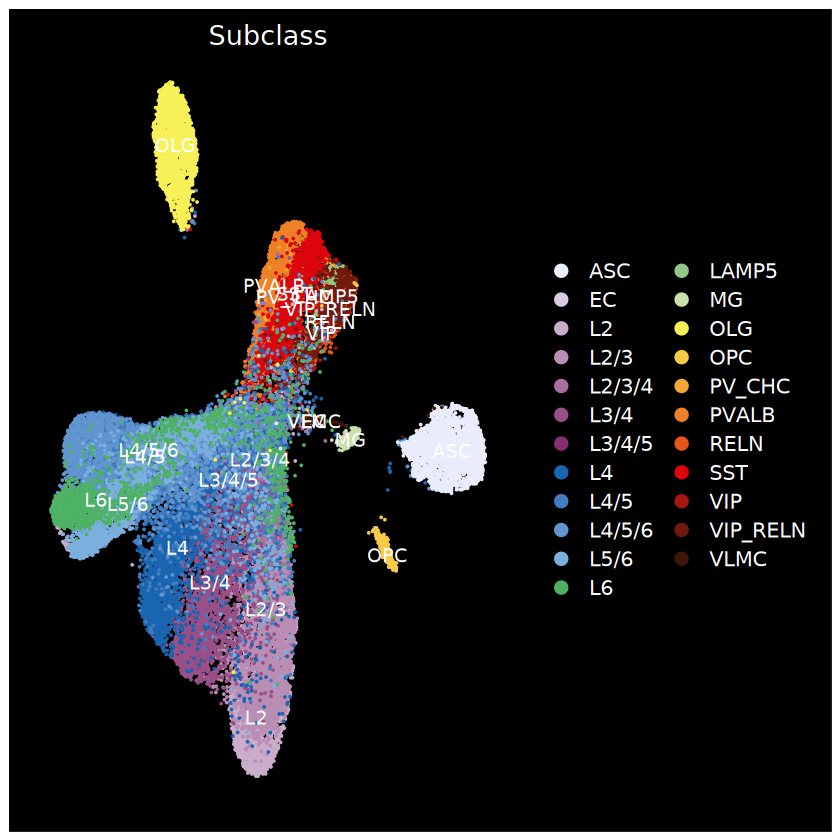

In [14]:
psrtg1

### Gene distance Compare to Isoform distance

In [35]:
mkls.layer = mkls$layer
colnames(mkls.layer)[6:7] = c("layer","gene_id")
mkls.layer = mkls.layer[mkls.layer$avg_log2FC > 0.5 & mkls.layer$p_val_adj < 0.05 & mkls.layer$pct.1 > 0.25, ]
head(mkls.layer)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,layer,gene_id
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
GFAP,1.988980e-250,3.325589,0.962,0.791,1.128667e-245,l1,GFAP
LOC102130415,5.406137e-250,3.319324,0.962,0.796,3.067766e-245,l1,LOC102130415
FABP7,2.304516e-203,3.671088,0.736,0.298,1.307721e-198,l1,FABP7
ID3,5.101582e-146,4.446690,0.403,0.102,2.894944e-141,l1,ID3
LOC102116355,7.527035e-135,1.388900,0.990,0.986,4.271291e-130,l1,LOC102116355
CST3,8.527759e-135,1.386591,0.990,0.987,4.839162e-130,l1,CST3


In [38]:
genedf = fsrawdp %>% group_by(layer,gene_id) %>% summarise(count = length(unique(readid)))
genedf = genedf[genedf$layer %in% paste0("l",1:6),]
genedf = genedf[genedf$gene_id %in% mkls.layer$gene_id,]
length(unique(genedf$gene_id))
genedf = genedf %>% group_by(gene_id) %>% filter(length(layer) == 6)
length(unique(genedf$gene_id))
genemx = dcast(genedf,gene_id~layer,value.var = "count",fun.aggregate = sum)
rownames(genemx) = as.character(genemx$gene_id);genemx = genemx[,-1]
head(genemx)
genemx.cor = cor(genemx)
dim(genemx.cor)

`summarise()` has grouped output by 'layer'. You can override using the
`.groups` argument.


[1] 1309

[1] 1168

,l1,l2,l3,l4,l5,l6
,<int>,<int>,<int>,<int>,<int>,<int>
AADAT,14,51,186,95,80,70
ABCA2,136,320,1521,297,684,817
ABCA8,56,22,155,59,128,232
ABCD4,38,47,208,53,115,122
ABHD17B,54,92,474,119,259,305
ABLIM1,138,226,827,211,394,361


[1] 6 6

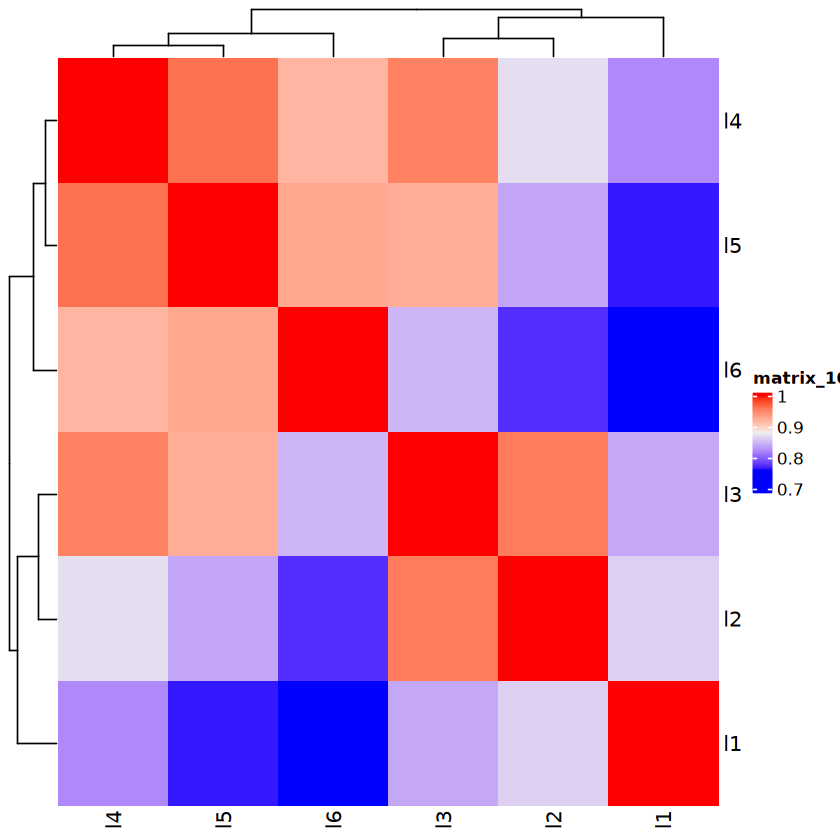

In [39]:
library(ComplexHeatmap)
Heatmap(as.matrix(genemx.cor))

[1] 982

[1] 629

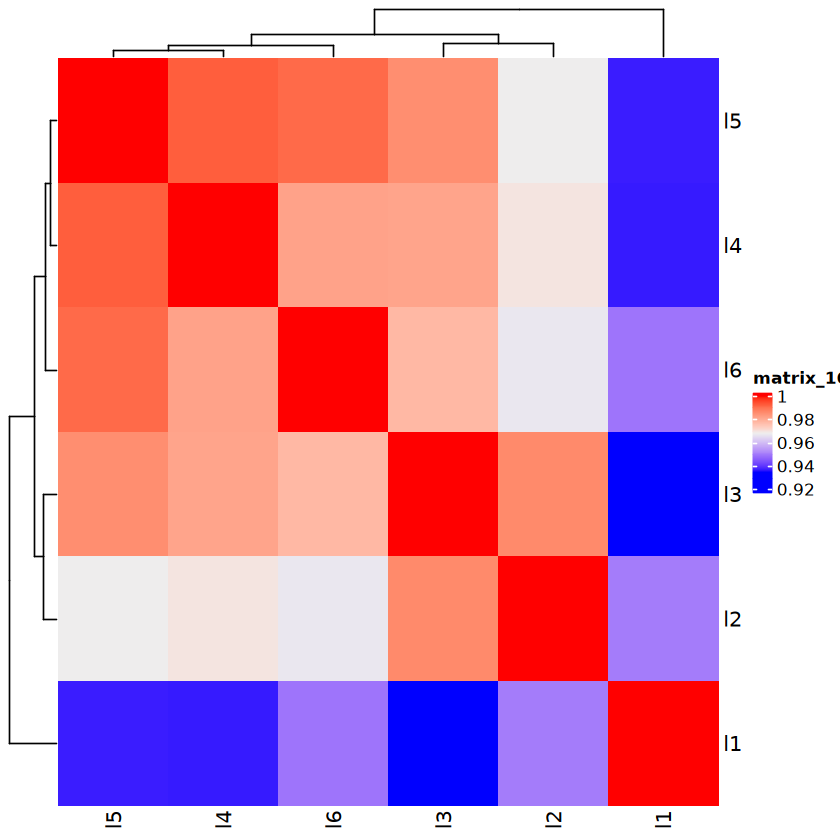

In [46]:
isodf = isosigls$layer
isodff = isodf[isodf$sig != "N",]
isodf = isodf[isodf$transcript_id %in% isodff$transcript_id,]
isodf = isodf[isodf$count > 50,]
length(unique(isodf$transcript_id))
isodf = isodf %>% group_by(transcript_id) %>% filter(length(areatr) == 6)
length(unique(isodf$transcript_id))
isomx = dcast(isodf,transcript_id~areatr,value.var = "relative",fun.aggregate = sum)
rownames(isomx) = isomx$transcript_id;isomx = isomx[,-1]
isomx.cor = cor(isomx)
Heatmap(isomx.cor)

In [32]:
head(isodf)

gene_id,transcript_id,areatr,count,genecount,relative,meanrelative,otherrelative,dr,sig,pvalue,padj
<chr>,<chr>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>
AAAS,AAAS-WeiLab-1,l1,26,28,0.9285714,0.9137841,0.9108267,0.017744766,N,0.9999998,1
AAAS,AAAS-WeiLab-1,l2,37,39,0.9487179,0.9137841,0.9067974,0.041920590,N,0.9999998,1
AAAS,AAAS-WeiLab-1,l3,239,268,0.8917910,0.9137841,0.9181827,-0.026391695,N,0.9999998,1
AAAS,AAAS-WeiLab-1,l4,45,53,0.8490566,0.9137841,0.9267296,-0.077673024,N,0.9999998,1
AAAS,AAAS-WeiLab-1,l5,110,115,0.9565217,0.9137841,0.9052366,0.051285139,N,0.9999998,1
AAAS,AAAS-WeiLab-1,l6,79,87,0.9080460,0.9137841,0.9149318,-0.006885776,N,0.9999998,1


`summarise()` has grouped output by 'lobe'. You can override using the
`.groups` argument.


[1] 457

[1] 394

,auditory,cingulate,occipital,parietal,somatosensory,temporal
,<int>,<int>,<int>,<int>,<int>,<int>
ACD,41,30,35,73,28,114
ADCYAP1,260,195,146,277,148,670
ADIRF,532,1405,843,1527,745,3216
ADO,98,153,106,226,123,430
AGT,460,1028,682,1264,547,2471
ALDOA,1264,2385,1883,3638,1916,6664


[1] 6 6

[1] 969

[1] 769

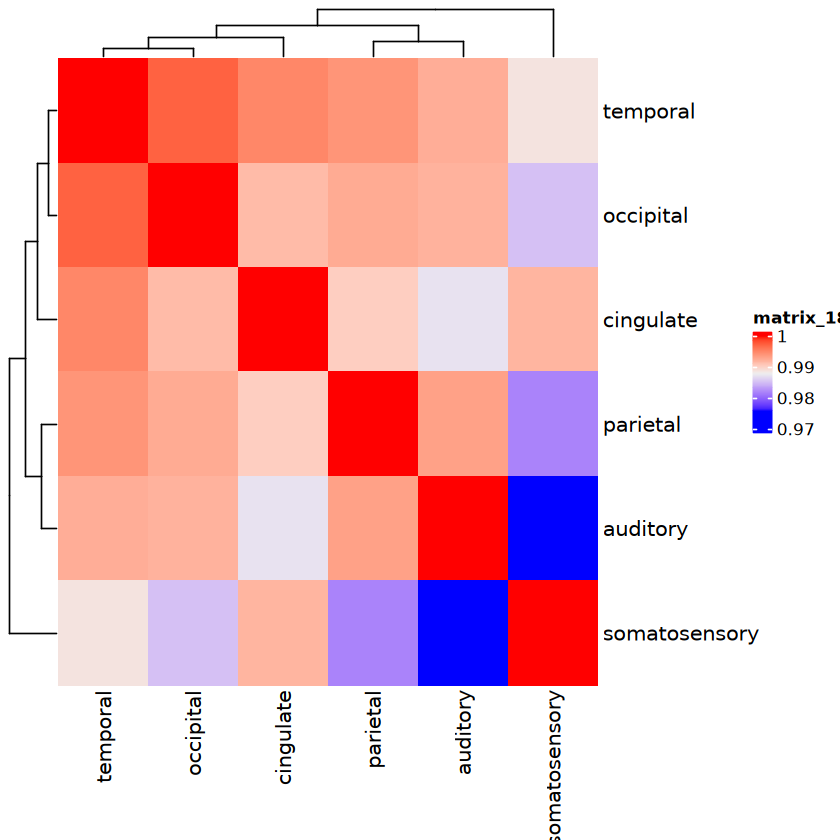

In [47]:
mkls.lobe = mkls$lobe
colnames(mkls.lobe)[6:7] = c("lobe","gene_id")
mkls.lobe = mkls.lobe[mkls.lobe$avg_log2FC > 0.5 & mkls.lobe$p_val_adj < 0.05 & mkls.lobe$pct.1 > 0.25, ]
genedf = fsrawdp %>% group_by(lobe,gene_id) %>% summarise(count = length(unique(readid)))
genedf = genedf[!is.na(genedf$lobe),]
genedf = genedf[genedf$gene_id %in% mkls.lobe$gene_id,]
length(unique(genedf$gene_id))
genedf = genedf %>% group_by(gene_id) %>% filter(length(lobe) == 6)
length(unique(genedf$gene_id))
genemx = dcast(genedf,gene_id~lobe,value.var = "count",fun.aggregate = sum)
rownames(genemx) = as.character(genemx$gene_id);genemx = genemx[,-1]
head(genemx)
genemx.cor = cor(genemx)
dim(genemx.cor)
Heatmap(as.matrix(genemx.cor))

isodf = isosigls$lobe
isodff = isodf[isodf$sig != "N",]
isodf = isodf[isodf$transcript_id %in% isodff$transcript_id,]
isodf = isodf[isodf$count > 50,]
length(unique(isodf$transcript_id))
isodf = isodf %>% group_by(transcript_id) %>% filter(length(areatr) == 6)
length(unique(isodf$transcript_id))
isomx = dcast(isodf,transcript_id~areatr,value.var = "relative",fun.aggregate = sum)
rownames(isomx) = isomx$transcript_id;isomx = isomx[,-1]
isomx.cor = cor(isomx)
Heatmap(as.matrix(isomx.cor))

In [51]:
isomx.cor
genemx.cor

,auditory,cingulate,occipital,parietal,somatosensory,temporal
auditory,1.0000000,0.9870229,0.9919450,0.9931009,0.9753904,0.9922699
cingulate,0.9870229,1.0000000,0.9913428,0.9900079,0.9917528,0.9948130
occipital,0.9919450,0.9913428,1.0000000,0.9924423,0.9850906,0.9970178
parietal,0.9931009,0.9900079,0.9924423,1.0000000,0.9815069,0.9939207
somatosensory,0.9753904,0.9917528,0.9850906,0.9815069,1.0000000,0.9884801
temporal,0.9922699,0.9948130,0.9970178,0.9939207,0.9884801,1.0000000


,auditory,cingulate,occipital,parietal,somatosensory,temporal
auditory,1.0000000,0.9560528,0.9787126,0.9927004,0.9444274,0.9766905
cingulate,0.9560528,1.0000000,0.9728997,0.9701181,0.9722185,0.9750636
occipital,0.9787126,0.9728997,1.0000000,0.9835381,0.9788292,0.9983451
parietal,0.9927004,0.9701181,0.9835381,1.0000000,0.9662887,0.9827713
somatosensory,0.9444274,0.9722185,0.9788292,0.9662887,1.0000000,0.9778105
temporal,0.9766905,0.9750636,0.9983451,0.9827713,0.9778105,1.0000000


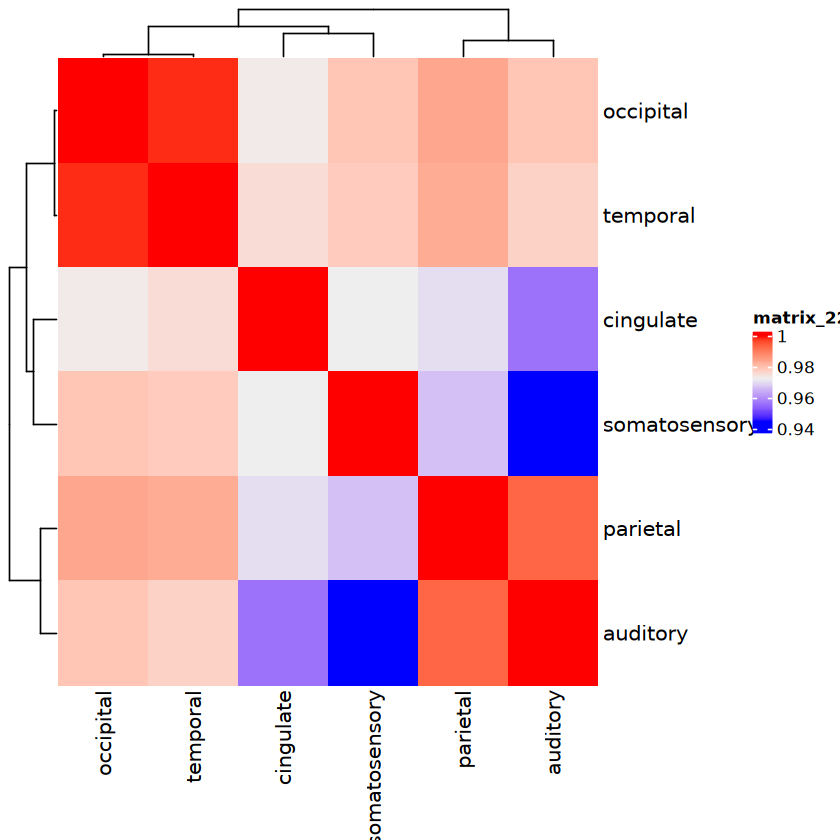

In [50]:
Heatmap(as.matrix(genemx.cor))

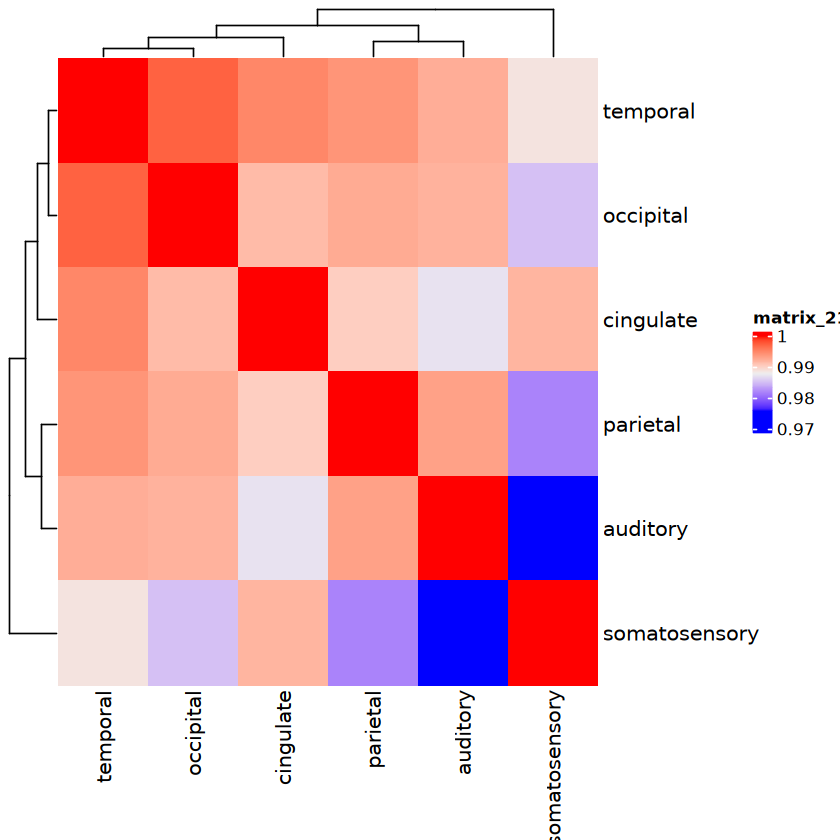

In [49]:
Heatmap(as.matrix(isomx.cor))

### Isoform diversity stat

In [35]:
isodiv.rg = fsraw %>% group_by(layer,region,lobe) %>% 
      summarise(genenum = length(unique(gene_id)),
                transnum = length(unique(transcript_id)),
                readnum = length(unique(readid)))
isodiv.rg$isodiv = isodiv.rg$transnum/isodiv.rg$genenum
head(isodiv.rg)

`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.


layer,region,lobe,genenum,transnum,readnum,isodiv
<chr>,<chr>,<chr>,<int>,<int>,<int>,<dbl>
HC,CA1,NA,20226,48415,889241,2.393701
HC,CA2,NA,11457,24507,108347,2.139042
HC,CA3,NA,15817,36819,310522,2.327812
HC,CA4,NA,5520,10097,18332,1.829167
HC,DG,NA,19596,46540,637585,2.374974
HC,Sub,NA,16040,37137,278170,2.315274


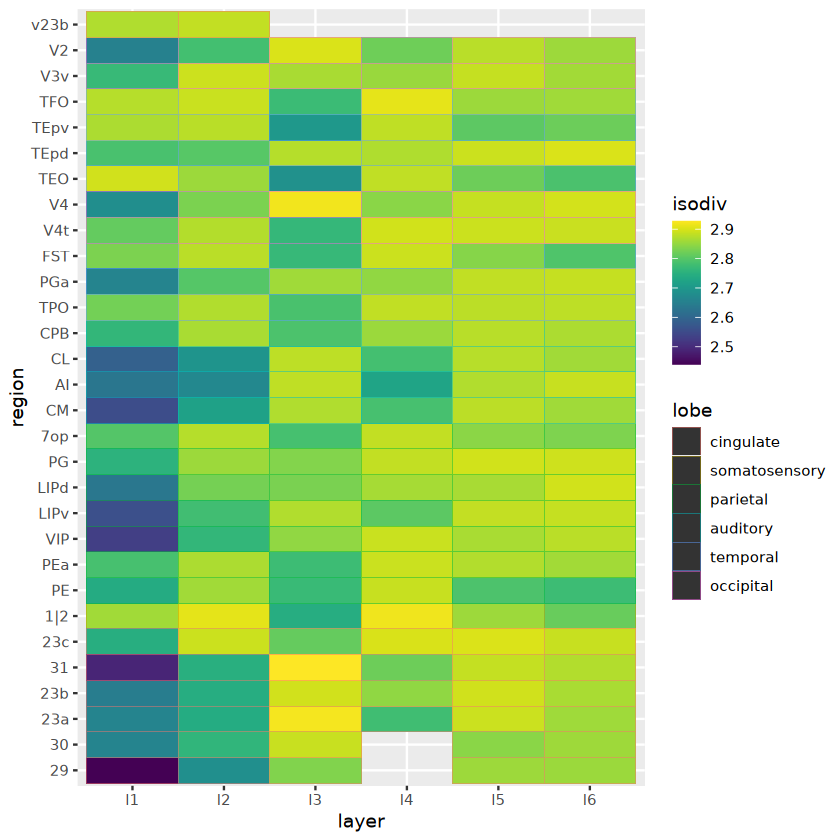

In [38]:
isodiv.rg$lobe = factor(isodiv.rg$lobe,levels = c('cingulate','somatosensory','parietal','auditory','temporal','occipital'))
isodiv.rg$region = factor(isodiv.rg$region,levels = c('29','30','23a','23b','31','23c','1|2','PE','PEa','VIP','LIPv','LIPd',
                                                    'PG','7op','CM','AI','CL','CPB','TPO','PGa','FST','V4t','V4','TEO','TEpd',
                                                    'TEpv','TFO','V3v','V2','v23b'))
isodiv.rg = isodiv.rg[!is.na(isodiv.rg$lobe),]
ggplot(isodiv.rg,aes(x = layer,y = region,color = lobe,fill = isodiv)) + geom_tile() +
scale_fill_viridis()

In [229]:
ReadIsoNumRandom = function(npclfglu,n = 500,mygroup){
    readids = unique(npclfglu$readid)
    readid1 = readids[sample(1:length(readids),n)]
    transt1 = npclfglu[npclfglu$readid %in% readid1,]
    transt1 = transt1[order(transt1$readid,transt1$gene_id,
                            transt1$transcript_id),]
    transt1 = transt1[!duplicated(transt1[c("readid","gene_id")]),]
    
    transt1 = transt1 %>% group_by(gene_id) %>% 
      summarise(transnum = length(unique(transcript_id)),
                readnum = length(unique(readid)))
    transt1f = transt1[transt1$readnum > 1,]
    median(transt1f$transnum)
    
    resdf = data.frame("mison" = mean(transt1f$transnum),
                       "isot" = sum(transt1$transnum),
                       "genet" = nrow(transt1),
                       "readnum" = n,
                       "group" = mygroup)
    
    return(resdf)
  }

groupanid = paste0("l",1:6)
fsrawdpls = list()
for (i in 1:length(groupanid)) {
    fsrawdpls[[i]] = fsrawdp[fsrawdp$layer == groupanid[i],]
}
names(fsrawdpls) = groupanid
  
k = 100000
cellrdsto = NULL
for (i in 1:100) {
    print(i)
    for (j in 1:length(fsrawdpls)) {
      cellrdti = ReadIsoNumRandom(fsrawdpls[[j]],k,names(fsrawdpls)[j])
      cellrdsto = rbind(cellrdsto,cellrdti)
    }
}
qsave(cellrdsto,"result/figure2/bambu_layer_isoform_diversity_cmp_24_04_28.qs")



[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10
[1] 11
[1] 12
[1] 13
[1] 14
[1] 15
[1] 16
[1] 17
[1] 18
[1] 19
[1] 20
[1] 21
[1] 22
[1] 23
[1] 24
[1] 25
[1] 26
[1] 27
[1] 28
[1] 29
[1] 30
[1] 31
[1] 32
[1] 33
[1] 34
[1] 35
[1] 36
[1] 37
[1] 38
[1] 39
[1] 40
[1] 41
[1] 42
[1] 43
[1] 44
[1] 45
[1] 46
[1] 47
[1] 48
[1] 49
[1] 50
[1] 51
[1] 52
[1] 53
[1] 54
[1] 55
[1] 56
[1] 57
[1] 58
[1] 59
[1] 60
[1] 61
[1] 62
[1] 63
[1] 64
[1] 65
[1] 66
[1] 67
[1] 68
[1] 69
[1] 70
[1] 71
[1] 72
[1] 73
[1] 74
[1] 75
[1] 76
[1] 77
[1] 78
[1] 79
[1] 80
[1] 81
[1] 82
[1] 83
[1] 84
[1] 85
[1] 86
[1] 87
[1] 88
[1] 89
[1] 90
[1] 91
[1] 92
[1] 93
[1] 94
[1] 95
[1] 96
[1] 97
[1] 98
[1] 99
[1] 100


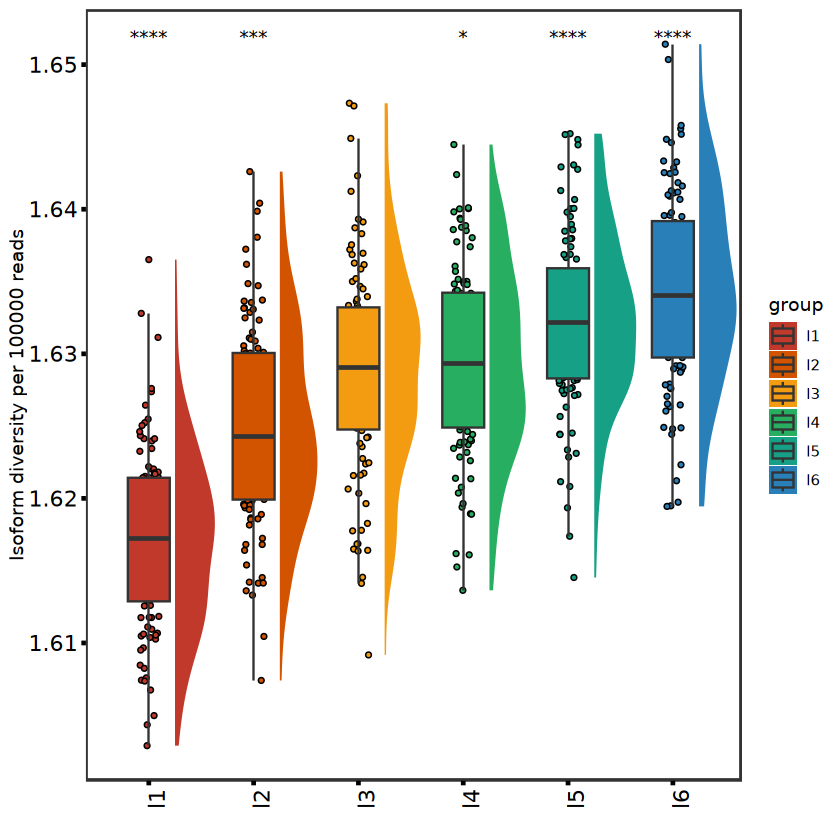

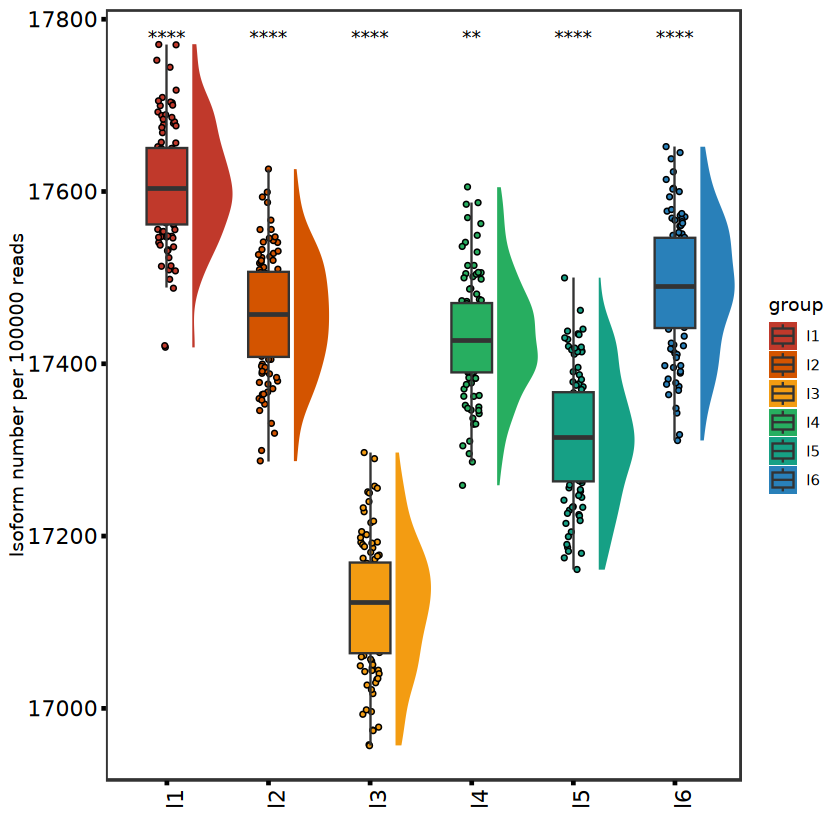

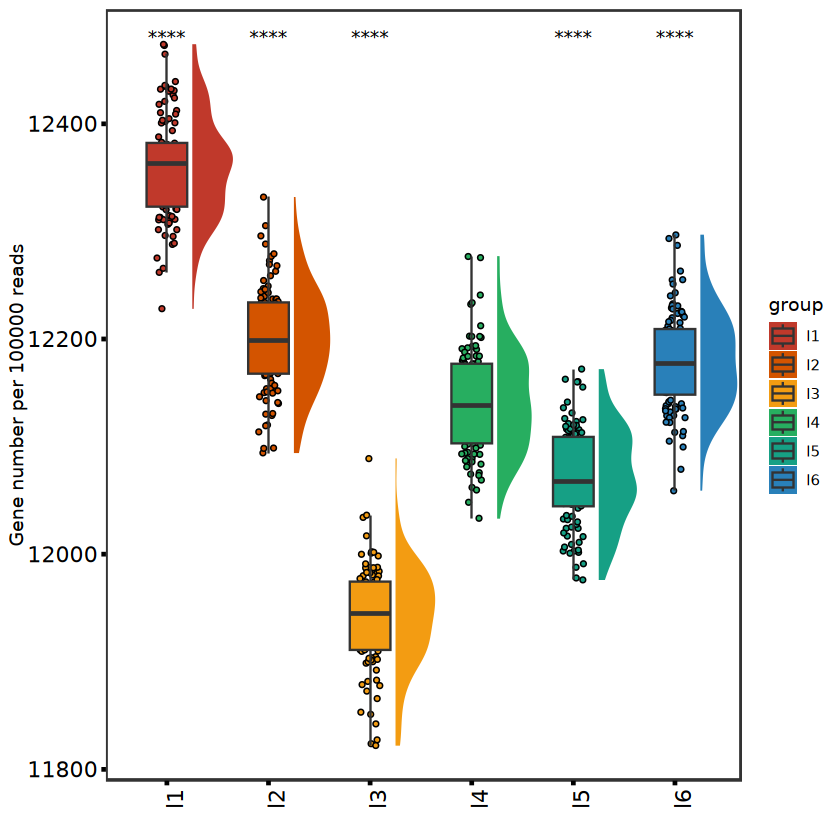

In [231]:
#cellrdsto$class = cellan[match(cellrdsto$group,cellan$subclass),]$class
#cellrdsto = cellrdsto[order(cellrdsto$class),]
#cellrdsto$group = factor(cellrdsto$group,levels = unique(cellrdsto$group))
pt1 = ggplot(cellrdsto,aes(x = group, y = mison,fill = group))+
      geom_jitter(shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Isoform diversity per 100000 reads") + xlab("")
pt1
  
pt2 = ggplot(cellrdsto,aes(x = group, y = isot,fill = group))+
      geom_jitter(shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Isoform number per 100000 reads") + xlab("")
pt2
  
pt3 = ggplot(cellrdsto,aes(x = group, y = genet,fill = group))+
      geom_jitter(shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Gene number per 100000 reads") + xlab("")
pt3

file saved to result/figure2/layer_isoform_diversity_cmp_box.pdf



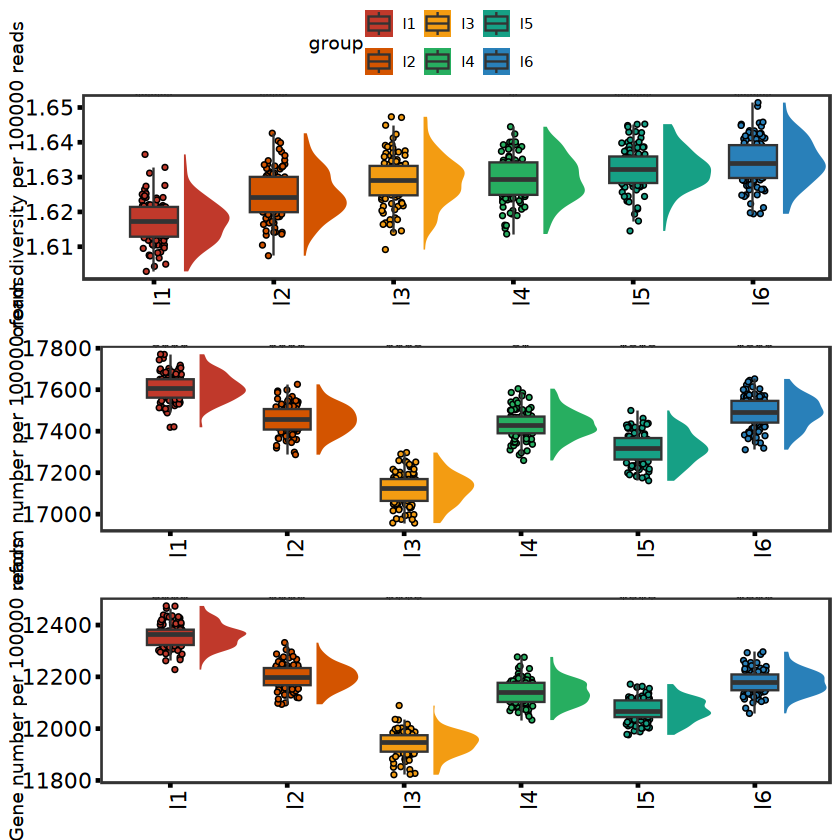

In [234]:
p1.2 = ggarrange(pt1,pt2,pt3,common.legend = T,ncol = 1)
p1.2
ggexport(p1.2,filename = "result/figure2/layer_isoform_diversity_cmp_box.pdf", width = 4,height = 10)

In [235]:
groupanid = unique(fsrawdp$lobe)
fsrawdpls = list()
for (i in 1:length(groupanid)) {
    fsrawdpls[[i]] = fsrawdp[fsrawdp$lobe == groupanid[i],]
}
names(fsrawdpls) = groupanid
  
k = 100000
cellrdsto2 = NULL
for (i in 1:100) {
    print(i)
    for (j in 1:length(fsrawdpls)) {
      cellrdti = ReadIsoNumRandom(fsrawdpls[[j]],k,names(fsrawdpls)[j])
      cellrdsto2 = rbind(cellrdsto2,cellrdti)
    }
}
qsave(cellrdsto2,"result/figure2/bambu_lobe_isoform_diversity_cmp_24_04_28.qs")


[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10
[1] 11
[1] 12
[1] 13
[1] 14
[1] 15
[1] 16
[1] 17
[1] 18
[1] 19
[1] 20
[1] 21
[1] 22
[1] 23
[1] 24
[1] 25
[1] 26
[1] 27
[1] 28
[1] 29
[1] 30
[1] 31
[1] 32
[1] 33
[1] 34
[1] 35
[1] 36
[1] 37
[1] 38
[1] 39
[1] 40
[1] 41
[1] 42
[1] 43
[1] 44
[1] 45
[1] 46
[1] 47
[1] 48
[1] 49
[1] 50
[1] 51
[1] 52
[1] 53
[1] 54
[1] 55
[1] 56
[1] 57
[1] 58
[1] 59
[1] 60
[1] 61
[1] 62
[1] 63
[1] 64
[1] 65
[1] 66
[1] 67
[1] 68
[1] 69
[1] 70
[1] 71
[1] 72
[1] 73
[1] 74
[1] 75
[1] 76
[1] 77
[1] 78
[1] 79
[1] 80
[1] 81
[1] 82
[1] 83
[1] 84
[1] 85
[1] 86
[1] 87
[1] 88
[1] 89
[1] 90
[1] 91
[1] 92
[1] 93
[1] 94
[1] 95
[1] 96
[1] 97
[1] 98
[1] 99
[1] 100


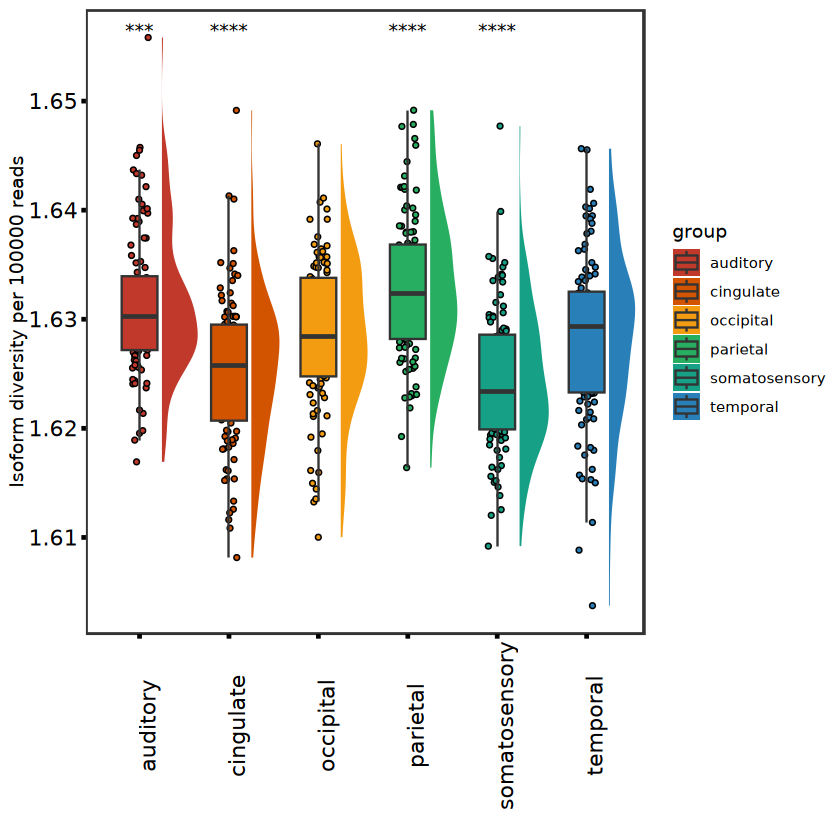

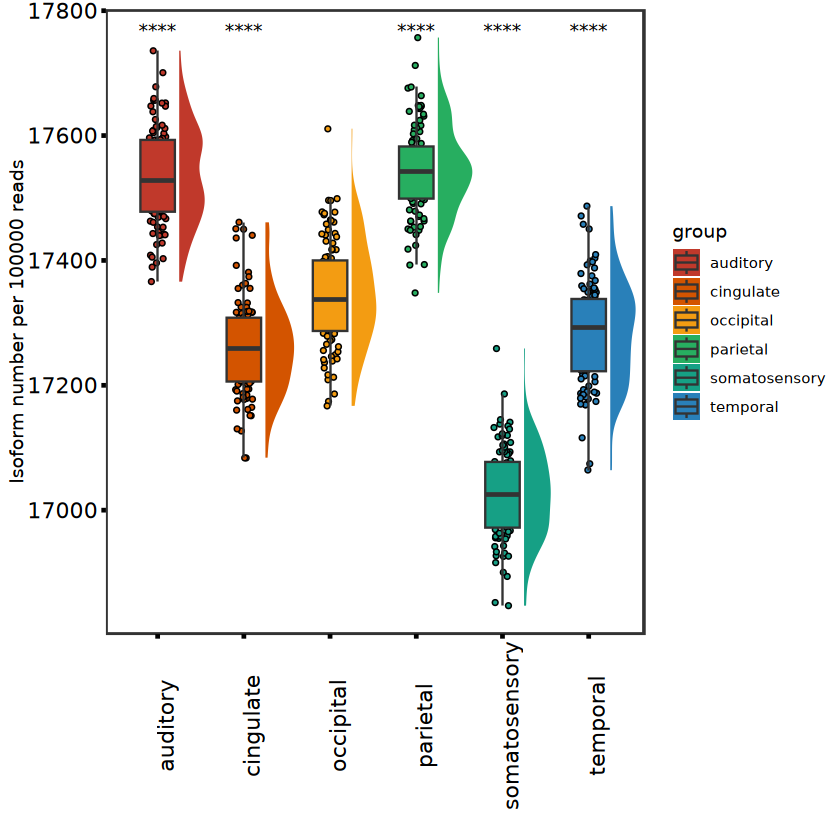

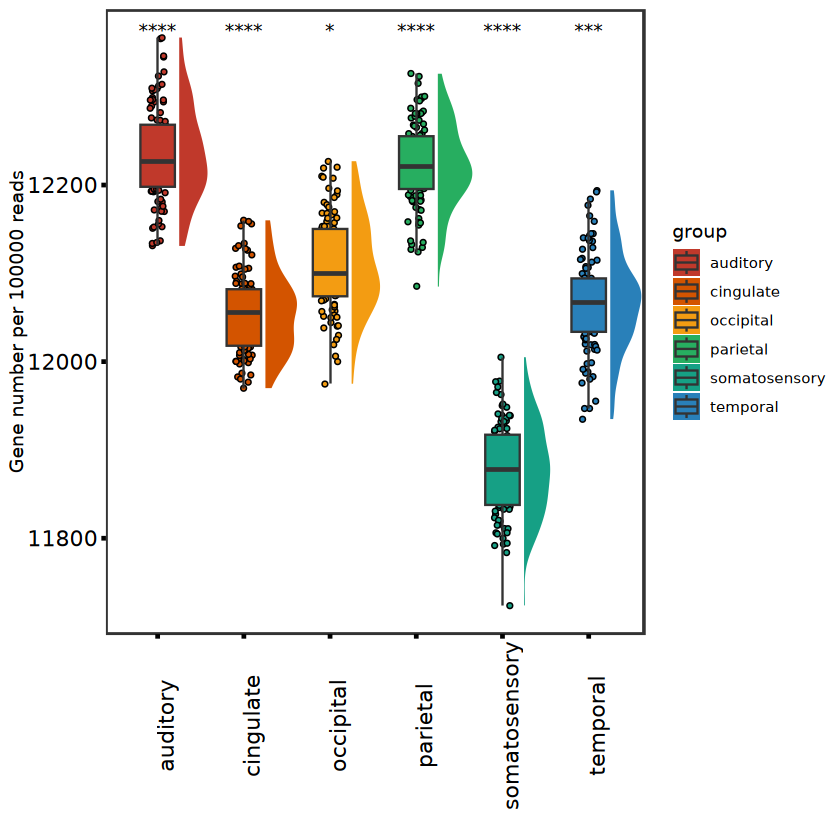

In [247]:
pt1 = ggplot(cellrdsto2,aes(x = group, y = mison, fill = group))+
      geom_jitter(aes(fill = group),shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Isoform diversity per 100000 reads") + xlab("")
pt1
  
pt2 = ggplot(cellrdsto2,aes(x = group, y = isot, fill = group))+
      geom_jitter(aes(fill = group),shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Isoform number per 100000 reads") + xlab("")
pt2
  
pt3 = ggplot(cellrdsto2,aes(x = group, y = genet, fill = group))+
      geom_jitter(aes(fill = group),shape=21,size=1,width=0.1) +
      geom_half_violin(position = position_nudge(x=0.25),side = "r",width=0.8,color=NA)+
      geom_boxplot(width=0.4,size=0.5, outlier.color =NA) +
      stat_compare_means(label = "p.signif", method = "t.test",hide.ns = T,
                     ref.group = ".all.")  +
      theme_bw()+
      theme(panel.grid = element_blank(),
        panel.border = element_rect(size = 1),
        axis.text.x = element_text(color = "black", size = 13,angle = 90),
        axis.text.y = element_text(color = "black",size = 13),
        axis.ticks = element_line(color="black",linewidth = 1)) +
      scale_fill_flatui() + ylab("Gene number per 100000 reads") + xlab("")
pt3

file saved to result/figure2/lobe_isoform_diversity_cmp_box.pdf



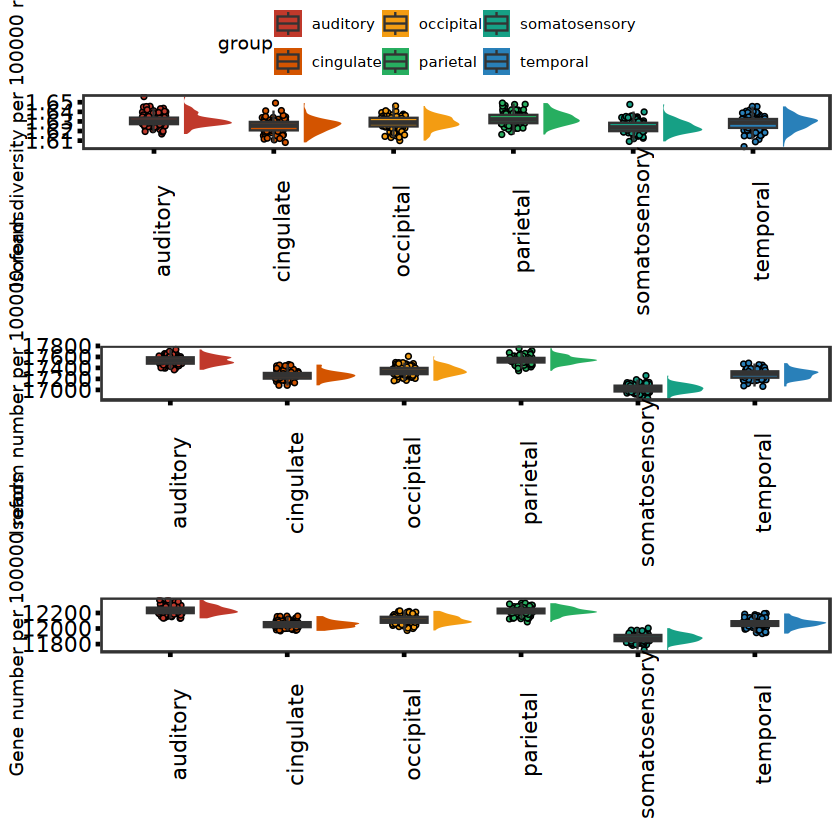

In [248]:
p1.2 = ggarrange(pt1,pt2,pt3,common.legend = T,ncol = 1)
p1.2
ggexport(p1.2,filename = "result/figure2/lobe_isoform_diversity_cmp_box.pdf", width = 4,height = 10)

In [10]:
ra = 200
fsrawdp$xid = as.integer(fsrawdp$x/(ra*2)) * ra * 2 + ra
fsrawdp$yid = as.integer(fsrawdp$y/(ra*2)) * ra * 2 + ra
fsrawdp$blockid = paste0(fsrawdp$xid,"_", fsrawdp$yid)
fsrawdp.st = fsrawdp %>% group_by(layer,region,blockid) %>% 
    summarise(readnum = length(readid))
summary(fsrawdp.st$readnum)

`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
      1    1372    4396    5142    8157   24889 

In [54]:
fsrawdp.bl = fsrawdp %>% group_by(layer,region,blockid) %>% 
    mutate(readnum = length(readid))
fsrawdp.bl = fsrawdp.bl[fsrawdp.bl$readnum > 10000,]
fsrawdp.blt = NULL
for(i in 1:2){
    fsrawdp.bli = fsrawdp.bl %>% group_by(layer,region,blockid) %>% filter(readid %in% readid[sample(1:length(readid),10000)])
    fsrawdp.bli = fsrawdp.bli %>% group_by(layer,region,blockid,gene_id) %>% 
    summarise(transnum = length(unique(transcript_id)),readnum = length(readid),x = mean(x),y = mean(y))
    fsrawdp.bli = fsrawdp.bli %>% group_by(layer,region,blockid) %>% 
    summarise(mtrans = mean(transnum),readnum = sum(readnum),x = mean(x),y = mean(y))
    fsrawdp.bli$group = i
    fsrawdp.blt = rbind(fsrawdp.blt,fsrawdp.bli)
}                                                      
fsrawdp.blt = fsrawdp.blt %>% group_by(layer,region,blockid) %>% summarise(mtrans = mean(mtrans),x = mean(x),y = mean(y))
# fsrawdp.blt$x = as.numeric(MySplit(fsrawdp.blt$blockid,"_",1))
# fsrawdp.blt$y = as.numeric(MySplit(fsrawdp.blt$blockid,"_",2))


`summarise()` has grouped output by 'layer', 'region', 'blockid'. You can
override using the `.groups` argument.
`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'layer', 'region', 'blockid'. You can
override using the `.groups` argument.
`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.
`summarise()` has grouped output by 'layer', 'region'. You can override using
the `.groups` argument.


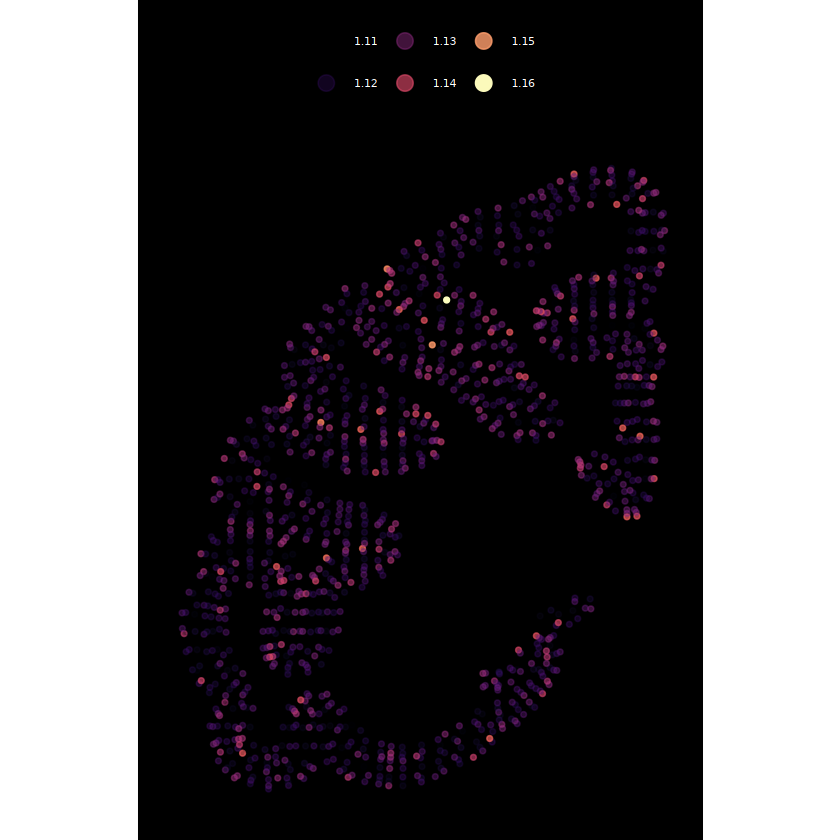

In [56]:
pmkpti1 = ggplot(fsrawdp.blt,aes(x = x, y = y,color = mtrans,
                                 #color = layer,
                                 alpha = mtrans)) +
      geom_point(size = 1) +
      theme_void() + 
      scale_color_viridis(option = "A") +
      theme_presentation() + 
      theme(legend.position = "top",legend.title = element_blank(),
            legend.text = element_text(size = 6)) +
      guides(color = guide_legend(override.aes = list(size=4),
                                  nrow = 2),
            size = "none") +
      scale_y_reverse() + scale_x_reverse() +
        coord_fixed()
pmkpti1

In [213]:
mkcor = fsraw.cor[fsraw.cor$gene_id == "DDRGK1",]
mkcor = mkcor[mkcor$layer == "l4",]
mkcor.st = mkcor %>% group_by(lobe,class,subclass) %>% mutate(genecount = length(readid)) %>%
group_by(lobe,class,subclass,transcript_id) %>% summarise(count = length(readid),rate = count/genecount[1])
mkcor.st

`summarise()` has grouped output by 'lobe', 'class', 'subclass'. You can
override using the `.groups` argument.


lobe,class,subclass,transcript_id,count,rate
<chr>,<chr>,<chr>,<chr>,<int>,<dbl>
auditory,,,DDRGK1-WeiLab-1,36,0.4285714
auditory,,,XM_005568473.2,48,0.5714286
auditory,GABA,PVALB,XM_005568473.2,1,1.0000000
auditory,GABA,SST,XM_005568473.2,1,1.0000000
auditory,GABA,VIP,XM_005568473.2,4,1.0000000
auditory,GABA,VIP_RELN,DDRGK1-WeiLab-1,1,1.0000000
auditory,GLU,L2,XM_005568473.2,1,1.0000000
auditory,GLU,L2/3,XM_005568473.2,1,1.0000000
auditory,GLU,L2/3/4,DDRGK1-WeiLab-1,1,0.2000000


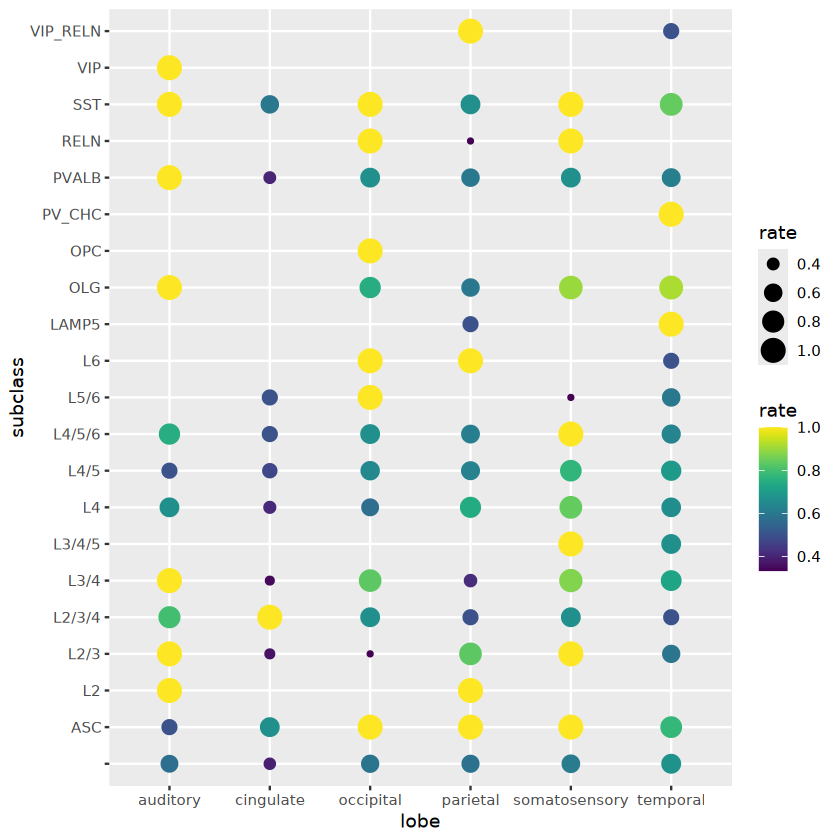

In [217]:
mkcor.st = mkcor.st[mkcor.st$transcript_id == "XM_005568473.2",]
ggplot(mkcor.st,aes(x = lobe,y = subclass,color = rate,size = rate)) + geom_point() +
scale_color_viridis()

In [219]:
mkcor.st[mkcor.st$subclass %in% c("L4/5","L4"),]

lobe,class,subclass,transcript_id,count,rate
<chr>,<chr>,<chr>,<chr>,<int>,<dbl>
auditory,GLU,L4,XM_005568473.2,14,0.6666667
auditory,GLU,L4/5,XM_005568473.2,2,0.5000000
cingulate,GLU,L4,XM_005568473.2,13,0.4062500
cingulate,GLU,L4/5,XM_005568473.2,9,0.4736842
occipital,GLU,L4,XM_005568473.2,28,0.5714286
occipital,GLU,L4/5,XM_005568473.2,11,0.6470588
parietal,GLU,L4,XM_005568473.2,40,0.7407407
parietal,GLU,L4/5,XM_005568473.2,25,0.6250000
somatosensory,GLU,L4,XM_005568473.2,16,0.8421053


In [ ]:
library(writexl)
write_xlsx(isosigls,"result/figure2/table_s2_dtu_total.xlsx")


### ARPP19 diger

In [ ]:
isosigls = qread(file = "data/dtu_analysis/dtu_isoform_ls_fsraw_cor_24_09_04.qs")